## US,UK COVID-19 & FTSE,SPY Project

#### Predicting economic performance of US, UK using Time Series Forecast and using FTSE and SPY as indicators of economic performance.
#### Predicitng the impact of COVID-19 pandemic on US and UK economies using various regression models.

Dataset Size: 439 rows × 18 columns

In [1]:
## import os

import math
import numpy as np
import pandas as pd
import time
import matplotlib.pyplot as plt
%matplotlib inline
from sklearn import metrics
from scipy import stats as st
from scipy.stats import linregress
import scipy.optimize as optimize
import scipy.sparse as sparse
import scipy.special as special
import scipy.stats
from sklearn.model_selection import train_test_split
from sklearn import datasets, linear_model
import warnings
warnings.filterwarnings('ignore')  #suppress warning messages (those with peach background)
import statsmodels.api as sm
from statsmodels.formula.api import ols

## Read CSV File to Data Frame

In [2]:
#read csv file as a pandas dataframe
df = pd.read_csv('Covid-19-UK.csv', index_col=None) #read csv file

print('Imported Dataset from Covid-19-UK.csv:')
df #show dataframe

Imported Dataset from Covid-19-UK.csv:


,date,cumCasesByPublishDate,cumVirusTests,cumDailyNsoDeathsByDeathDate,cumPeopleVaccinatedCompleteByPublishDate,cumAdmissions,FTSE100 Open Price,Close Price,High Price,Low Price,Volume,temperature max degC,tmin degC,rain mm,sun hours,U.S. cases,U.S. deaths,https://coronavirus.data.gov.uk/details/download
0,2020-01-21,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,0.0,https://sharecast.com/index/FTSE_100/prices/do...
1,2020-01-22,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,0.0,https://www.metoffice.gov.uk/pub/data/weather/...
2,2020-01-23,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,0.0,https://github.com/nytimes/covid-19-data/blob/...
3,2020-01-24,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.0,0.0,NaN
4,2020-01-25,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3.0,0.0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
434,2021-03-30,4341736.0,122824208.0,NaN,4125884.0,NaN,6736.17,6772.12,6792.23,6729.46,654363968.0,NaN,NaN,NaN,NaN,30416970.0,550500.0,NaN
435,2021-03-31,4345788.0,124147198.0,NaN,4513458.0,NaN,6772.12,6713.63,6775.67,6713.63,837940608.0,12.1,2.8,37.0,116.3,30485232.0,551638.0,NaN
436,2021-04-01,4350266.0,NaN,NaN,4958874.0,NaN,6713.63,6737.30,6766.52,6713.63,588526528.0,NaN,NaN,NaN,NaN,30562856.0,552593.0,NaN
437,2021-04-02,4353668.0,NaN,NaN,5205505.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,30631700.0,553554.0,NaN


In [3]:
#we remove last column of hyperlinks
df = df.iloc[:, :-1]

df1 = df.copy()

df

,date,cumCasesByPublishDate,cumVirusTests,cumDailyNsoDeathsByDeathDate,cumPeopleVaccinatedCompleteByPublishDate,cumAdmissions,FTSE100 Open Price,Close Price,High Price,Low Price,Volume,temperature max degC,tmin degC,rain mm,sun hours,U.S. cases,U.S. deaths
0,2020-01-21,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,0.0
1,2020-01-22,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,0.0
2,2020-01-23,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,0.0
3,2020-01-24,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.0,0.0
4,2020-01-25,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
434,2021-03-30,4341736.0,122824208.0,NaN,4125884.0,NaN,6736.17,6772.12,6792.23,6729.46,654363968.0,NaN,NaN,NaN,NaN,30416970.0,550500.0
435,2021-03-31,4345788.0,124147198.0,NaN,4513458.0,NaN,6772.12,6713.63,6775.67,6713.63,837940608.0,12.1,2.8,37.0,116.3,30485232.0,551638.0
436,2021-04-01,4350266.0,NaN,NaN,4958874.0,NaN,6713.63,6737.30,6766.52,6713.63,588526528.0,NaN,NaN,NaN,NaN,30562856.0,552593.0
437,2021-04-02,4353668.0,NaN,NaN,5205505.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,30631700.0,553554.0


In [4]:
# Import SPY ETF Data for time range
spy = pd.read_csv("SPY.csv")

# Introduce 3 new columns, as per limit issued by Prof
spy = spy[["Date", "Open", "Close"]] # Drop the extra columns
spy.columns = ["date", "Open", "Close"] # Rename
spy.head(20)

,date,Open,Close
0,2020-01-21,330.899994,331.299988
1,2020-01-22,332.239990,331.339996
2,2020-01-23,330.630005,331.720001
3,2020-01-24,332.440002,328.769989
4,2020-01-27,323.029999,323.500000
5,2020-01-28,325.059998,326.890015
6,2020-01-29,328.380005,326.619995
7,2020-01-30,324.359985,327.679993
8,2020-01-31,327.000000,321.730011
9,2020-02-03,323.350006,324.119995


In [5]:
# Join df and spy on date

# Convert to suitable type
spy["date"] = spy["date"].astype('datetime64[ns]')
df["date"] = df['date'].astype('datetime64[ns]')

# Merge on column date
df = df.merge(spy, on="date", how="left")

# Print final data frame
df

,date,cumCasesByPublishDate,cumVirusTests,cumDailyNsoDeathsByDeathDate,cumPeopleVaccinatedCompleteByPublishDate,cumAdmissions,FTSE100 Open Price,Close Price,High Price,Low Price,Volume,temperature max degC,tmin degC,rain mm,sun hours,U.S. cases,U.S. deaths,Open,Close
0,2020-01-21,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,0.0,330.899994,331.299988
1,2020-01-22,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,0.0,332.239990,331.339996
2,2020-01-23,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,0.0,330.630005,331.720001
3,2020-01-24,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.0,0.0,332.440002,328.769989
4,2020-01-25,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3.0,0.0,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
434,2021-03-30,4341736.0,122824208.0,NaN,4125884.0,NaN,6736.17,6772.12,6792.23,6729.46,654363968.0,NaN,NaN,NaN,NaN,30416970.0,550500.0,394.420013,394.730011
435,2021-03-31,4345788.0,124147198.0,NaN,4513458.0,NaN,6772.12,6713.63,6775.67,6713.63,837940608.0,12.1,2.8,37.0,116.3,30485232.0,551638.0,395.339996,396.329987
436,2021-04-01,4350266.0,NaN,NaN,4958874.0,NaN,6713.63,6737.30,6766.52,6713.63,588526528.0,NaN,NaN,NaN,NaN,30562856.0,552593.0,398.399994,400.609985
437,2021-04-02,4353668.0,NaN,NaN,5205505.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,30631700.0,553554.0,NaN,NaN


## Data Visualisation of Numerical Features

array([[<AxesSubplot:title={'center':'date'}>,
        <AxesSubplot:title={'center':'cumCasesByPublishDate'}>,
        <AxesSubplot:title={'center':'cumVirusTests'}>,
        <AxesSubplot:title={'center':'cumDailyNsoDeathsByDeathDate'}>],
       [<AxesSubplot:title={'center':'cumPeopleVaccinatedCompleteByPublishDate'}>,
        <AxesSubplot:title={'center':'cumAdmissions'}>,
        <AxesSubplot:title={'center':'FTSE100 Open Price'}>,
        <AxesSubplot:title={'center':'Close Price'}>],
       [<AxesSubplot:title={'center':'High Price'}>,
        <AxesSubplot:title={'center':'Low Price'}>,
        <AxesSubplot:title={'center':'Volume'}>,
        <AxesSubplot:title={'center':'temperature max degC'}>],
       [<AxesSubplot:title={'center':'tmin degC'}>,
        <AxesSubplot:title={'center':'rain mm'}>,
        <AxesSubplot:title={'center':'sun hours'}>,
        <AxesSubplot:title={'center':'U.S. cases'}>],
       [<AxesSubplot:title={'center':'U.S. deaths'}>,
        <AxesSubplot:title

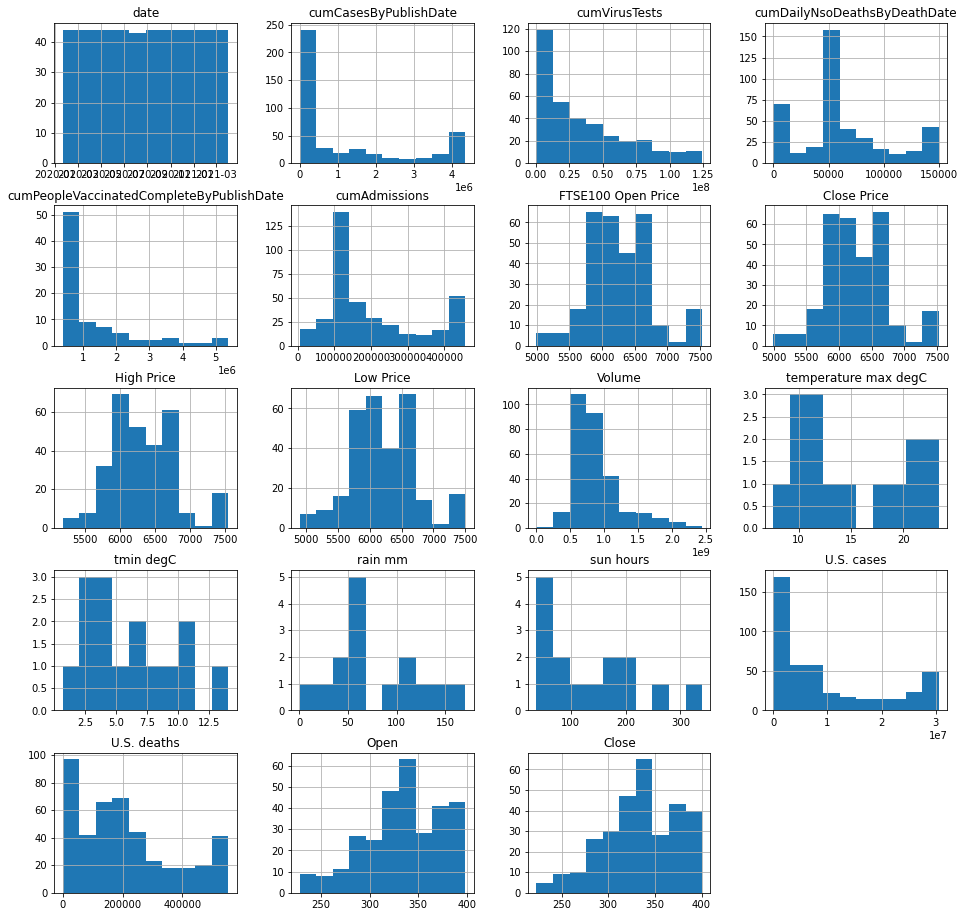

In [6]:
#Show the distribution of numerical features in the dataset
df.hist(figsize=(16,16))

In [7]:
# Breakdown of Total missing values (Null values) for each feature
# Count total NaN at each column in a DataFrame
print(" \nCount total missing values (NaN) at each column in cleaned dataFrame :")
df.isnull().sum()

 
Count total missing values (NaN) at each column in cleaned dataFrame :


date                                          0
cumCasesByPublishDate                        10
cumVirusTests                                93
cumDailyNsoDeathsByDeathDate                 24
cumPeopleVaccinatedCompleteByPublishDate    355
cumAdmissions                                68
FTSE100 Open Price                          142
Close Price                                 142
High Price                                  142
Low Price                                   142
Volume                                      142
temperature max degC                        424
tmin degC                                   424
rain mm                                     424
sun hours                                   424
U.S. cases                                    1
U.S. deaths                                   1
Open                                        136
Close                                       136
dtype: int64

In [8]:
# Identify Columns That Contain a Single Value and delete those columns
# summarize the number of unique values in each column
print(" \nsummarize the number of unique values in each column of dataframe:")
print(df.nunique())

 
summarize the number of unique values in each column of dataframe:
date                                        439
cumCasesByPublishDate                       407
cumVirusTests                               346
cumDailyNsoDeathsByDeathDate                384
cumPeopleVaccinatedCompleteByPublishDate     84
cumAdmissions                               371
FTSE100 Open Price                          296
Close Price                                 297
High Price                                  294
Low Price                                   292
Volume                                      297
temperature max degC                         14
tmin degC                                    15
rain mm                                      15
sun hours                                    15
U.S. cases                                  418
U.S. deaths                                 399
Open                                        299
Close                                       298
dtype: int64


## Checking for Duplicates

In [9]:
# calculate duplicates
dups = df.duplicated()
# report if there are any duplicates
print("Are there any duplicates: ",dups.any())
# list all duplicate rows
print("\nList all duplicate rows: \n",df[dups])

Are there any duplicates:  False

List all duplicate rows: 
 Empty DataFrame
Columns: [date, cumCasesByPublishDate, cumVirusTests, cumDailyNsoDeathsByDeathDate, cumPeopleVaccinatedCompleteByPublishDate, cumAdmissions, FTSE100 Open Price, Close Price, High Price, Low Price, Volume, temperature max degC, tmin degC, rain mm, sun hours, U.S. cases, U.S. deaths, Open, Close]
Index: []


In [10]:
print('Dataframe shape before drop duplicates: ', df.shape)
# delete duplicate rows
df.drop_duplicates(inplace=True)
print('Dataframe shape after drop duplicates: ', df.shape)

Dataframe shape before drop duplicates:  (439, 19)
Dataframe shape after drop duplicates:  (439, 19)


## Replacing Missing Values

In [11]:
# Breakdown of Total missing values (Null values) for each feature
# Count total NaN at each column in a DataFrame
print(" \nCount total missing values (NaN) at each column in cleaned dataFrame :")
df.isnull().sum()

 
Count total missing values (NaN) at each column in cleaned dataFrame :


date                                          0
cumCasesByPublishDate                        10
cumVirusTests                                93
cumDailyNsoDeathsByDeathDate                 24
cumPeopleVaccinatedCompleteByPublishDate    355
cumAdmissions                                68
FTSE100 Open Price                          142
Close Price                                 142
High Price                                  142
Low Price                                   142
Volume                                      142
temperature max degC                        424
tmin degC                                   424
rain mm                                     424
sun hours                                   424
U.S. cases                                    1
U.S. deaths                                   1
Open                                        136
Close                                       136
dtype: int64

## Replacing NaNs using Mean of the column

In [12]:
# using mean to replace NaN for weather related data
df['temperature max degC'].fillna(int(df['temperature max degC'].mean()), inplace=True)
df['tmin degC'].fillna(int(df['tmin degC'].mean()), inplace=True)
df['rain mm'].fillna(int(df['rain mm'].mean()), inplace=True)
df['sun hours'].fillna(int(df['sun hours'].mean()), inplace=True)
df.isnull().sum()

date                                          0
cumCasesByPublishDate                        10
cumVirusTests                                93
cumDailyNsoDeathsByDeathDate                 24
cumPeopleVaccinatedCompleteByPublishDate    355
cumAdmissions                                68
FTSE100 Open Price                          142
Close Price                                 142
High Price                                  142
Low Price                                   142
Volume                                      142
temperature max degC                          0
tmin degC                                     0
rain mm                                       0
sun hours                                     0
U.S. cases                                    1
U.S. deaths                                   1
Open                                        136
Close                                       136
dtype: int64

## Replacing NaNs with the value from the previous row or the next row

In [13]:
#Take value from previous row
df['FTSE100 Open Price'].fillna(method='ffill', inplace=True)
df['Close Price'].fillna(method='ffill', inplace=True)
df['High Price'].fillna(method='ffill', inplace=True)
df['Low Price'].fillna(method='ffill', inplace=True)
df['Volume'].fillna(method='ffill', inplace=True)
df["Open"].fillna(method='ffill', inplace=True)
df["Close"].fillna(method='ffill', inplace=True)

# U.S. cases and death: Covid19 outbreak started in 21 Jan 2020, last row (last day) missing value use previous row method
# df['U.S. cases'].fillna(method='ffill', inplace=True)
# df['U.S. deaths'].fillna(method='ffill', inplace=True)

# #Take value from next row
# df['FTSE100 Open Price'].fillna(method='bfill', inplace=True)
# df['Close Price'].fillna(method='bfill', inplace=True)
# df['High Price'].fillna(method='bfill', inplace=True)
# df['Low Price'].fillna(method='bfill', inplace=True)
# df['Volume'].fillna(method='bfill', inplace=True)

# print(" \nCount total missing values (NaN) at each column in cleaned dataFrame :")
df.isnull().sum()

# #use this method for
#     #FTSE datasets
    #covid Cases

date                                          0
cumCasesByPublishDate                        10
cumVirusTests                                93
cumDailyNsoDeathsByDeathDate                 24
cumPeopleVaccinatedCompleteByPublishDate    355
cumAdmissions                                68
FTSE100 Open Price                            9
Close Price                                   9
High Price                                    9
Low Price                                     9
Volume                                        9
temperature max degC                          0
tmin degC                                     0
rain mm                                       0
sun hours                                     0
U.S. cases                                    1
U.S. deaths                                   1
Open                                          0
Close                                         0
dtype: int64

In [14]:
# The FTSE data has missing values at the start, which is why we can't forward fill. Thus, we backfill
print("First few rows of FTSE data\n", df[["FTSE100 Open Price", "Close Price","High Price","Low Price"]].head(15))

df['FTSE100 Open Price'].fillna(method='bfill', inplace=True)
df['Close Price'].fillna(method='bfill', inplace=True)
df['High Price'].fillna(method='bfill', inplace=True)
df['Low Price'].fillna(method='bfill', inplace=True)
df['Volume'].fillna(method='bfill', inplace=True)
df["Open"].fillna(method='bfill', inplace=True)
df["Close"].fillna(method='bfill', inplace=True)
df.isnull().sum()

First few rows of FTSE data
     FTSE100 Open Price  Close Price  High Price  Low Price
0                  NaN          NaN         NaN        NaN
1                  NaN          NaN         NaN        NaN
2                  NaN          NaN         NaN        NaN
3                  NaN          NaN         NaN        NaN
4                  NaN          NaN         NaN        NaN
5                  NaN          NaN         NaN        NaN
6                  NaN          NaN         NaN        NaN
7                  NaN          NaN         NaN        NaN
8                  NaN          NaN         NaN        NaN
9              7483.57      7381.96     7483.57    7357.62
10             7381.96      7286.01     7398.34    7275.03
11             7381.96      7286.01     7398.34    7275.03
12             7381.96      7286.01     7398.34    7275.03
13             7286.01      7326.31     7359.98    7285.16
14             7326.31      7439.82     7442.08    7326.31


date                                          0
cumCasesByPublishDate                        10
cumVirusTests                                93
cumDailyNsoDeathsByDeathDate                 24
cumPeopleVaccinatedCompleteByPublishDate    355
cumAdmissions                                68
FTSE100 Open Price                            0
Close Price                                   0
High Price                                    0
Low Price                                     0
Volume                                        0
temperature max degC                          0
tmin degC                                     0
rain mm                                       0
sun hours                                     0
U.S. cases                                    1
U.S. deaths                                   1
Open                                          0
Close                                         0
dtype: int64

## Replacing NaNs with the specific values

In [15]:
# cumCasesByPublishDate: Covid19 outbreak in UK started in 31 Jan 2020 , first 10 NaN values are 0 Covid19 cases.

df['cumCasesByPublishDate'] = df['cumCasesByPublishDate'].fillna(0, limit=10)
# cumDailyNsoDeathsByDeathDate: First Covid19 death report in started in 31 Jan 2020 , first 10 NaN values are 0 Covid19 cases.
df['cumDailyNsoDeathsByDeathDate'] = df['cumDailyNsoDeathsByDeathDate'].fillna(0, limit=9)
df["cumVirusTests"] = df["cumVirusTests"].fillna(0, limit=1)
df["cumPeopleVaccinatedCompleteByPublishDate"] = df["cumPeopleVaccinatedCompleteByPublishDate"].fillna(0, limit=1)
df["cumAdmissions"] = df["cumAdmissions"].fillna(0, limit=1)


df.isnull().sum()

date                                          0
cumCasesByPublishDate                         0
cumVirusTests                                92
cumDailyNsoDeathsByDeathDate                 15
cumPeopleVaccinatedCompleteByPublishDate    354
cumAdmissions                                67
FTSE100 Open Price                            0
Close Price                                   0
High Price                                    0
Low Price                                     0
Volume                                        0
temperature max degC                          0
tmin degC                                     0
rain mm                                       0
sun hours                                     0
U.S. cases                                    1
U.S. deaths                                   1
Open                                          0
Close                                         0
dtype: int64

In [16]:
df.head(10)

,date,cumCasesByPublishDate,cumVirusTests,cumDailyNsoDeathsByDeathDate,cumPeopleVaccinatedCompleteByPublishDate,cumAdmissions,FTSE100 Open Price,Close Price,High Price,Low Price,Volume,temperature max degC,tmin degC,rain mm,sun hours,U.S. cases,U.S. deaths,Open,Close
0,2020-01-21,0.0,0.0,0.0,0.0,0.0,7483.57,7381.96,7483.57,7357.62,672044352.0,14.0,6.0,76.0,135.0,1.0,0.0,330.899994,331.299988
1,2020-01-22,0.0,NaN,0.0,NaN,NaN,7483.57,7381.96,7483.57,7357.62,672044352.0,14.0,6.0,76.0,135.0,1.0,0.0,332.239990,331.339996
2,2020-01-23,0.0,NaN,0.0,NaN,NaN,7483.57,7381.96,7483.57,7357.62,672044352.0,14.0,6.0,76.0,135.0,1.0,0.0,330.630005,331.720001
3,2020-01-24,0.0,NaN,0.0,NaN,NaN,7483.57,7381.96,7483.57,7357.62,672044352.0,14.0,6.0,76.0,135.0,2.0,0.0,332.440002,328.769989
4,2020-01-25,0.0,NaN,0.0,NaN,NaN,7483.57,7381.96,7483.57,7357.62,672044352.0,14.0,6.0,76.0,135.0,3.0,0.0,332.440002,328.769989
5,2020-01-26,0.0,NaN,0.0,NaN,NaN,7483.57,7381.96,7483.57,7357.62,672044352.0,14.0,6.0,76.0,135.0,5.0,0.0,332.440002,328.769989
6,2020-01-27,0.0,NaN,0.0,NaN,NaN,7483.57,7381.96,7483.57,7357.62,672044352.0,14.0,6.0,76.0,135.0,5.0,0.0,323.029999,323.500000
7,2020-01-28,0.0,NaN,0.0,NaN,NaN,7483.57,7381.96,7483.57,7357.62,672044352.0,14.0,6.0,76.0,135.0,5.0,0.0,325.059998,326.890015
8,2020-01-29,0.0,NaN,0.0,NaN,NaN,7483.57,7381.96,7483.57,7357.62,672044352.0,14.0,6.0,76.0,135.0,5.0,0.0,328.380005,326.619995
9,2020-01-30,0.0,NaN,1.0,NaN,NaN,7483.57,7381.96,7483.57,7357.62,672044352.0,14.0,6.0,76.0,135.0,6.0,0.0,324.359985,327.679993


In [17]:
df['date'] = df['date'].astype('str')

## Interpolation for COVID related data

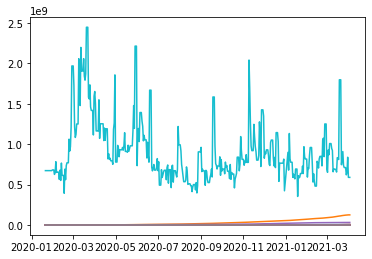

In [18]:
# Make a copy
mdf = df.copy()
mdf['date'] = pd.to_datetime(mdf['date'])
mdf.index = mdf['date']
mdf["Volume"] = mdf["Volume"].replace(0, np.nan)
del mdf['date']

# Interpolate
qqdf = mdf.interpolate(axis=0, limit_direction="both")

plt.plot(qqdf)

df = qqdf
df.reset_index(inplace=True)

## Detect and Drop Outliers

In [19]:
# Automatic Outliers Detection

#https://scikit-learn.org/stable/auto_examples/miscellaneous/plot_anomaly_comparison.html

st0 = time.time()
stm = st0

# Must remove date as it is of a type that cannot be interpreted by SKLearn
d = df.drop("date", axis=1)

cn = list(d)
#change any non-numeric y value to NaN
#delete any row where all x-variables are missing
d = d[cn].dropna(how='all')
#delete any column of constant values:
d = d[d.columns[d.nunique() > 1]]
#delete any non-numeric column and any column with any missing value:
for i in list(d):
    if pd.to_numeric(d[i], errors='coerce').isnull().any():
        del d[i]

# #random subsetting of rows: #only for demo purposes
# d = d.sample(10000)

r = len(d)

import warnings 
warnings.filterwarnings('ignore')
warnings.simplefilter('ignore')

print('Preparing data of', r, 'rows &', d.shape[1], 'columns took',
      '%.2f' % ((time.time() - stm) / 60), 'mins.')
stm = time.time()

#Isolation Forest

#https://scikit-learn.org/stable/modules/generated/sklearn.ensemble.IsolationForest.html
from sklearn.ensemble import IsolationForest
g = IsolationForest(n_jobs=-1).fit_predict(d).tolist()
print('\nNumber of IsolationForest outliers:', g.count(-1))
print('... took', '%.2f' % ((time.time() - stm) / 60), 'mins.')
stm = time.time()

#Local Outlier Factor

#https://scikit-learn.org/stable/modules/generated/sklearn.neighbors.LocalOutlierFactor.html
from sklearn.neighbors import LocalOutlierFactor
a0 = LocalOutlierFactor(n_jobs=-1)
a = a0.fit_predict(d).tolist()
ac = a.count(-1) #keep for EllipticEnvelope
an = a0.negative_outlier_factor_ #use this size info to rank outliers later
print('\nNumber of LocalOutlierFactor outliers:', ac)
print('... took', '%.2f' % ((time.time() - stm) / 60), 'mins.')
stm = time.time()

#Elliptic Envelope for Gaussian distribution

#https://scikit-learn.org/stable/modules/generated/sklearn.covariance.EllipticEnvelope.html
from sklearn.covariance import EllipticEnvelope
#-1 in 'e' identifies an outlier position:
e = EllipticEnvelope(contamination=min(0.1,ac/r)).fit_predict(d).tolist()
print('\nNumber of EllipticEnvelope outliers:', e.count(-1))
print('... took', '%.2f' % ((time.time() - stm) / 60), 'mins.')
stm = time.time()


#find shared outliers

# f = [-1 if s==-1 and t==-1 and u==-1 and v==-1 else 1 for s, t, u, v in zip(a, b, c, e)]
f = [-1 if s==-1 and t==-1 and u==-1 else 1 for s, t, u in zip(a, g, e)]
p = f.count(-1)

if p > 0:
    common = [i for i, z in enumerate(f) if z == -1] #indices of outliers
    q = [z for _, z in sorted(zip(an[common], common))][:100] #indices of sorted worst outliers
    print('\nNumber of outliers common to all lists:', p,
          '\nIndices of up to 100 sorted outliers with the worst first:', q,
          'from [0 to', str(r - 1) + '].')
    print('\nProportion of data outlying:', '%.5f' % (p / r))
else:
    print('\nNo outlier common to all lists.')
print('\nOutliers detection took', '%.2f' % ((time.time() - st0) / 60), 'mins.')

Preparing data of 439 rows & 18 columns took 0.00 mins.

Number of IsolationForest outliers: 49
... took 0.01 mins.

Number of LocalOutlierFactor outliers: 21
... took 0.00 mins.

Number of EllipticEnvelope outliers: 21
... took 0.00 mins.

No outlier common to all lists.

Outliers detection took 0.01 mins.


In [20]:
# Instead of dropping, we convert to NaNs so that the missing values can be interpolated.
try:
    df.loc[common, 1:] = np.nan
except:
    pass; # No common outliers
df

,date,cumCasesByPublishDate,cumVirusTests,cumDailyNsoDeathsByDeathDate,cumPeopleVaccinatedCompleteByPublishDate,cumAdmissions,FTSE100 Open Price,Close Price,High Price,Low Price,Volume,temperature max degC,tmin degC,rain mm,sun hours,U.S. cases,U.S. deaths,Open,Close
0,2020-01-21,0.0,0.000000e+00,0.0,0.000000e+00,0.000000,7483.57,7381.96,7483.57,7357.62,672044352.0,14.0,6.0,76.0,135.0,1.0,0.0,330.899994,331.299988
1,2020-01-22,0.0,5.913656e+03,0.0,1.102532e+03,78.612903,7483.57,7381.96,7483.57,7357.62,672044352.0,14.0,6.0,76.0,135.0,1.0,0.0,332.239990,331.339996
2,2020-01-23,0.0,1.182731e+04,0.0,2.205065e+03,157.225806,7483.57,7381.96,7483.57,7357.62,672044352.0,14.0,6.0,76.0,135.0,1.0,0.0,330.630005,331.720001
3,2020-01-24,0.0,1.774097e+04,0.0,3.307597e+03,235.838710,7483.57,7381.96,7483.57,7357.62,672044352.0,14.0,6.0,76.0,135.0,2.0,0.0,332.440002,328.769989
4,2020-01-25,0.0,2.365462e+04,0.0,4.410130e+03,314.451613,7483.57,7381.96,7483.57,7357.62,672044352.0,14.0,6.0,76.0,135.0,3.0,0.0,332.440002,328.769989
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
434,2021-03-30,4341736.0,1.228242e+08,150116.0,4.125884e+06,457398.000000,6736.17,6772.12,6792.23,6729.46,654363968.0,14.0,6.0,76.0,135.0,30416970.0,550500.0,394.420013,394.730011
435,2021-03-31,4345788.0,1.241472e+08,150116.0,4.513458e+06,457398.000000,6772.12,6713.63,6775.67,6713.63,837940608.0,12.1,2.8,37.0,116.3,30485232.0,551638.0,395.339996,396.329987
436,2021-04-01,4350266.0,1.241472e+08,150116.0,4.958874e+06,457398.000000,6713.63,6737.30,6766.52,6713.63,588526528.0,14.0,6.0,76.0,135.0,30562856.0,552593.0,398.399994,400.609985
437,2021-04-02,4353668.0,1.241472e+08,150116.0,5.205505e+06,457398.000000,6713.63,6737.30,6766.52,6713.63,588526528.0,14.0,6.0,76.0,135.0,30631700.0,553554.0,398.399994,400.609985


In [21]:
df['date'] = df['date'].astype('str')

In [22]:
#Rename Columns to be more readable
df.rename(columns={'FTSE100 Open Price': 'FTSE_Open_Price', 
                   'Close Price': 'FTSE_Close_Price',
                   'High Price': 'FTSE_High_Price',
                  'Low Price': 'FTSE_Low_Price',
                  'Volume': 'FTSE_Volume',
                  'temperature max degC': 'Max_Temperature_DegC',
                  'tmin degC':'Min_Temperature_DegC',
                  'rain mm':'Rainfall_mm',
                  'sun hours':'Sun_Hours',
                  'U.S. cases':'US_Covid_Cases',
                  'U.S. deaths':'US_Covid_Deaths',
                  'Open':'SPY_Open_Price',
                  'Close':'SPY_Close_Price'}, inplace=True)

## Save clean data to csv file

In [23]:
df.to_csv('cleaned_data.csv')
df.shape

(439, 19)

In [24]:
df

,date,cumCasesByPublishDate,cumVirusTests,cumDailyNsoDeathsByDeathDate,cumPeopleVaccinatedCompleteByPublishDate,cumAdmissions,FTSE_Open_Price,FTSE_Close_Price,FTSE_High_Price,FTSE_Low_Price,FTSE_Volume,Max_Temperature_DegC,Min_Temperature_DegC,Rainfall_mm,Sun_Hours,US_Covid_Cases,US_Covid_Deaths,SPY_Open_Price,SPY_Close_Price
0,2020-01-21,0.0,0.000000e+00,0.0,0.000000e+00,0.000000,7483.57,7381.96,7483.57,7357.62,672044352.0,14.0,6.0,76.0,135.0,1.0,0.0,330.899994,331.299988
1,2020-01-22,0.0,5.913656e+03,0.0,1.102532e+03,78.612903,7483.57,7381.96,7483.57,7357.62,672044352.0,14.0,6.0,76.0,135.0,1.0,0.0,332.239990,331.339996
2,2020-01-23,0.0,1.182731e+04,0.0,2.205065e+03,157.225806,7483.57,7381.96,7483.57,7357.62,672044352.0,14.0,6.0,76.0,135.0,1.0,0.0,330.630005,331.720001
3,2020-01-24,0.0,1.774097e+04,0.0,3.307597e+03,235.838710,7483.57,7381.96,7483.57,7357.62,672044352.0,14.0,6.0,76.0,135.0,2.0,0.0,332.440002,328.769989
4,2020-01-25,0.0,2.365462e+04,0.0,4.410130e+03,314.451613,7483.57,7381.96,7483.57,7357.62,672044352.0,14.0,6.0,76.0,135.0,3.0,0.0,332.440002,328.769989
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
434,2021-03-30,4341736.0,1.228242e+08,150116.0,4.125884e+06,457398.000000,6736.17,6772.12,6792.23,6729.46,654363968.0,14.0,6.0,76.0,135.0,30416970.0,550500.0,394.420013,394.730011
435,2021-03-31,4345788.0,1.241472e+08,150116.0,4.513458e+06,457398.000000,6772.12,6713.63,6775.67,6713.63,837940608.0,12.1,2.8,37.0,116.3,30485232.0,551638.0,395.339996,396.329987
436,2021-04-01,4350266.0,1.241472e+08,150116.0,4.958874e+06,457398.000000,6713.63,6737.30,6766.52,6713.63,588526528.0,14.0,6.0,76.0,135.0,30562856.0,552593.0,398.399994,400.609985
437,2021-04-02,4353668.0,1.241472e+08,150116.0,5.205505e+06,457398.000000,6713.63,6737.30,6766.52,6713.63,588526528.0,14.0,6.0,76.0,135.0,30631700.0,553554.0,398.399994,400.609985


## Import Cleaned Data CSV

In [25]:
#read csv file as a pandas dataframe
df_clean = pd.read_csv('cleaned_data.csv') #read csv file

print('Imported Dataset from cleaned_data.csv:')
df_clean #show dataframe

Imported Dataset from cleaned_data.csv:


,Unnamed: 0,date,cumCasesByPublishDate,cumVirusTests,cumDailyNsoDeathsByDeathDate,cumPeopleVaccinatedCompleteByPublishDate,cumAdmissions,FTSE_Open_Price,FTSE_Close_Price,FTSE_High_Price,FTSE_Low_Price,FTSE_Volume,Max_Temperature_DegC,Min_Temperature_DegC,Rainfall_mm,Sun_Hours,US_Covid_Cases,US_Covid_Deaths,SPY_Open_Price,SPY_Close_Price
0,0,2020-01-21,0.0,0.000000e+00,0.0,0.000000e+00,0.000000,7483.57,7381.96,7483.57,7357.62,672044352.0,14.0,6.0,76.0,135.0,1.0,0.0,330.899994,331.299988
1,1,2020-01-22,0.0,5.913656e+03,0.0,1.102532e+03,78.612903,7483.57,7381.96,7483.57,7357.62,672044352.0,14.0,6.0,76.0,135.0,1.0,0.0,332.239990,331.339996
2,2,2020-01-23,0.0,1.182731e+04,0.0,2.205065e+03,157.225806,7483.57,7381.96,7483.57,7357.62,672044352.0,14.0,6.0,76.0,135.0,1.0,0.0,330.630005,331.720001
3,3,2020-01-24,0.0,1.774097e+04,0.0,3.307597e+03,235.838710,7483.57,7381.96,7483.57,7357.62,672044352.0,14.0,6.0,76.0,135.0,2.0,0.0,332.440002,328.769989
4,4,2020-01-25,0.0,2.365462e+04,0.0,4.410130e+03,314.451613,7483.57,7381.96,7483.57,7357.62,672044352.0,14.0,6.0,76.0,135.0,3.0,0.0,332.440002,328.769989
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
434,434,2021-03-30,4341736.0,1.228242e+08,150116.0,4.125884e+06,457398.000000,6736.17,6772.12,6792.23,6729.46,654363968.0,14.0,6.0,76.0,135.0,30416970.0,550500.0,394.420013,394.730011
435,435,2021-03-31,4345788.0,1.241472e+08,150116.0,4.513458e+06,457398.000000,6772.12,6713.63,6775.67,6713.63,837940608.0,12.1,2.8,37.0,116.3,30485232.0,551638.0,395.339996,396.329987
436,436,2021-04-01,4350266.0,1.241472e+08,150116.0,4.958874e+06,457398.000000,6713.63,6737.30,6766.52,6713.63,588526528.0,14.0,6.0,76.0,135.0,30562856.0,552593.0,398.399994,400.609985
437,437,2021-04-02,4353668.0,1.241472e+08,150116.0,5.205505e+06,457398.000000,6713.63,6737.30,6766.52,6713.63,588526528.0,14.0,6.0,76.0,135.0,30631700.0,553554.0,398.399994,400.609985


## General Linear Models (GLM) for FTSE Close Price


 
 
 
 
 
========================================================== Next GLM Model ==============================================================

 
 
 
 
 
counter =  1
GLM Model Fitted =  Normal
1 entered.

Assuming Normal error distribution.

X pairs with correlations > 0.995 :
SPY_Close_Price , SPY_Open_Price

1 variables considered for deletion:
SPY_Close_Price

X pairs with correlations > 0.995 :
(no more)

1 variables deleted.

X pairs with correlations > 0.995 :
FTSE_Open_Price_sqar , FTSE_Open_Price_sqrt
FTSE_Open_Price_sqrt , FTSE_Open_Price
FTSE_High_Price_sqar , FTSE_High_Price
FTSE_High_Price , FTSE_High_Price_sqrt
FTSE_Low_Price_sqrt , FTSE_Low_Price_sqar
FTSE_Low_Price_sqar , FTSE_Low_Price

6 variables considered for deletion:
FTSE_Open_Price_sqar
FTSE_Open_Price_sqrt
FTSE_High_Price_sqar
FTSE_High_Price_sqrt
FTSE_Low_Price_sqrt
FTSE_Low_Price_sqar

X pairs with correlations > 0.995 :
(no more)

6 transformed variables deleted.

Fit using reproducible random 80% (x_tr


Adjusted R² = 0.9927629131652195 , max(X p-value) = 0.7794559846361968 , rank deficiency = 6 , for 21 Xs.
Variable to drop: cumPeopleVaccinatedCompleteByPublishDate_sqrt

Adjusted R² = 0.9927827033435752 , max(X p-value) = 0.8029367283925661 , rank deficiency = 6 , for 20 Xs.
Variable to drop: Min_Temperature_DegC_sqrt

Adjusted R² = 0.9927826907031152 , max(X p-value) = 0.6837597313876718 , rank deficiency = 5 , for 19 Xs.
Variable to drop: SPY_Open_Price_sqrt

Adjusted R² = 0.9927827986446083 , max(X p-value) = 0.5377814072605769 , rank deficiency = 4 , for 18 Xs.
Variable to drop: Min_Temperature_DegC_sqar

Adjusted R² = 0.9927971661141927 , max(X p-value) = 0.7002303075176355 , rank deficiency = 4 , for 17 Xs.
Variable to drop: Max_Temperature_DegC_sqar

Adjusted R² = 0.9928166356235602 , max(X p-value) = 0.7651969475410724 , rank deficiency = 4 , for 16 Xs.
Variable to drop: Min_Temperature_DegC

Adjusted R² = 0.9928147317440645 , max(X p-value) = 0.4528238909384099 , rank defici

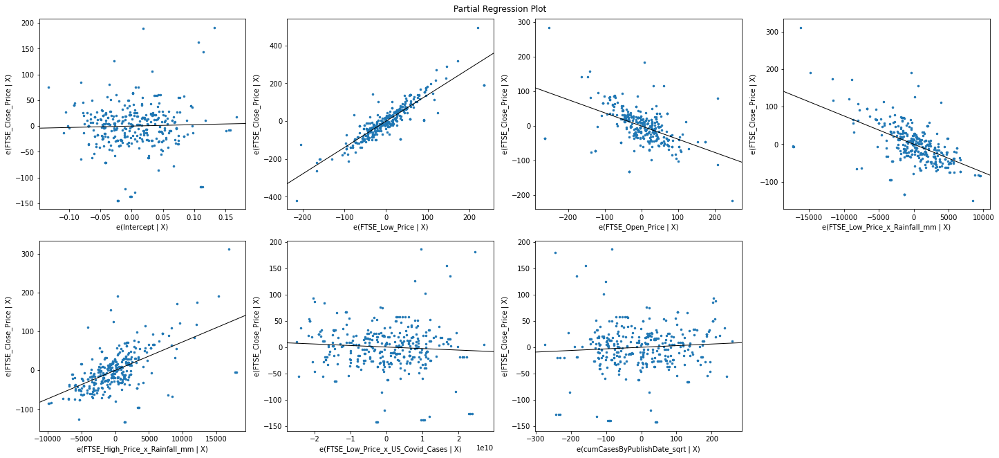


Normal fit using reproducible random 80% (x_train & y_train) of data rows:

    Mean Absolute Residual = 29.066173911422652
Root Mean Squared Residual = 42.34393381042232
                        R² = 0.9928903218733488

Normal prediction using remaining 20% (x_test & y_test) of data rows:

    Mean Absolute Error = 26.7707801761965
Root Mean Squared Error = 38.27870342033717
                     R² = 0.9944462291696584

Plots of train-set fit & test-set predict:


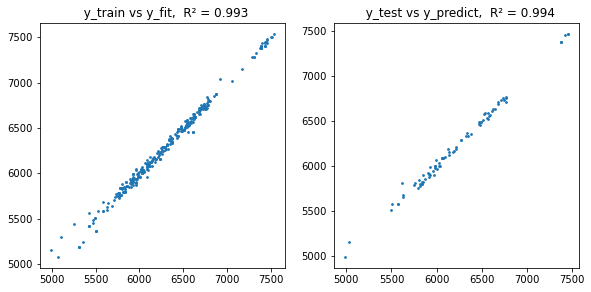


 
 
 
 
 
========================================================== Next GLM Model ==============================================================

 
 
 
 
 
counter =  2
GLM Model Fitted =  Poisson
1 entered.

Assuming Poisson error distribution.

X pairs with correlations > 0.995 :
SPY_Close_Price , SPY_Open_Price

1 variables considered for deletion:
SPY_Close_Price

X pairs with correlations > 0.995 :
(no more)

1 variables deleted.

X pairs with correlations > 0.995 :
FTSE_Open_Price_sqar , FTSE_Open_Price_sqrt
FTSE_Open_Price_sqrt , FTSE_Open_Price
FTSE_High_Price_sqar , FTSE_High_Price
FTSE_High_Price , FTSE_High_Price_sqrt
FTSE_Low_Price_sqrt , FTSE_Low_Price_sqar
FTSE_Low_Price_sqar , FTSE_Low_Price

6 variables considered for deletion:
FTSE_Open_Price_sqar
FTSE_Open_Price_sqrt
FTSE_High_Price_sqar
FTSE_High_Price_sqrt
FTSE_Low_Price_sqrt
FTSE_Low_Price_sqar

X pairs with correlations > 0.995 :
(no more)

6 transformed variables deleted.

Fit using reproducible random 80% (x_


Adjusted R² = 0.9876326291645541 , max(X p-value) = 0.28380461479496333 , rank deficiency = 0 , for 17 Xs.
Variable to drop: cumVirusTests

Adjusted R² = 0.9875847905050127 , max(X p-value) = 0.38145099224074586 , rank deficiency = 0 , for 16 Xs.
Variable to drop: US_Covid_Cases

Adjusted R² = 0.9875745583040226 , max(X p-value) = 0.3033212061119781 , rank deficiency = 0 , for 15 Xs.
Variable to drop: cumAdmissions

Adjusted R² = 0.9875351150834836 , max(X p-value) = 0.5257591380669193 , rank deficiency = 0 , for 14 Xs.
Variable to drop: Unnamed__0_sqrt

Adjusted R² = 0.9875308732800098 , max(X p-value) = 0.3648158501903497 , rank deficiency = 0 , for 13 Xs.
Variable to drop: US_Covid_Deaths_sqar

Adjusted R² = 0.9875019210130457 , max(X p-value) = 0.16374274349453577 , rank deficiency = 0 , for 12 Xs.
Variable to drop: Rainfall_mm

Adjusted R² = 0.9874039959044038 , max(X p-value) = 0.5576411141784767 , rank deficiency = 0 , for 11 Xs.
Variable to drop: Rainfall_mm_sqrt

Adjusted R² 

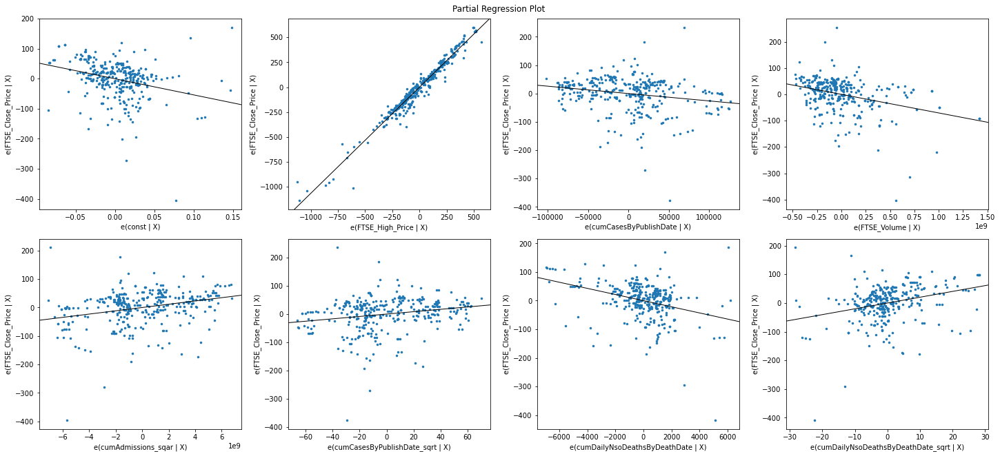


Poisson fit using reproducible random 80% (x_train & y_train) of data rows:

    Mean Absolute Residual = 39.820736739086556
Root Mean Squared Residual = 56.29580283329556
                        R² = 0.9874333548944321

Poisson prediction using remaining 20% (x_test & y_test) of data rows:

    Mean Absolute Error = 38.13094713264823
Root Mean Squared Error = 49.21581604415208
                     R² = 0.9899814663214543

Plots of train-set fit & test-set predict:


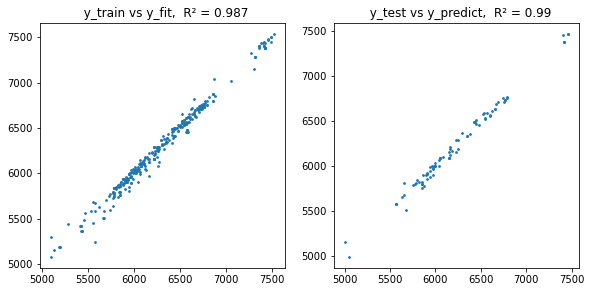


 
 
 
 
 
========================================================== Next GLM Model ==============================================================

 
 
 
 
 
counter =  3
GLM Model Fitted =  Logit
1 entered.

Assuming Logit error distribution.

X pairs with correlations > 0.995 :
SPY_Close_Price , SPY_Open_Price

1 variables considered for deletion:
SPY_Close_Price

X pairs with correlations > 0.995 :
(no more)

1 variables deleted.

X pairs with correlations > 0.995 :
FTSE_Open_Price_sqar , FTSE_Open_Price_sqrt
FTSE_Open_Price_sqrt , FTSE_Open_Price
FTSE_High_Price_sqar , FTSE_High_Price
FTSE_High_Price , FTSE_High_Price_sqrt
FTSE_Low_Price_sqrt , FTSE_Low_Price_sqar
FTSE_Low_Price_sqar , FTSE_Low_Price

6 variables considered for deletion:
FTSE_Open_Price_sqar
FTSE_Open_Price_sqrt
FTSE_High_Price_sqar
FTSE_High_Price_sqrt
FTSE_Low_Price_sqrt
FTSE_Low_Price_sqar

X pairs with correlations > 0.995 :
(no more)

6 transformed variables deleted.

Fit using reproducible random 80% (x_trai

FTSE_Low_Price_x_Min_Temperature_DegC
FTSE_High_Price_x_FTSE_Open_Price
FTSE_High_Price_x_SPY_Open_Price
FTSE_High_Price_x_US_Covid_Deaths
FTSE_High_Price_x_Unnamed__0
FTSE_High_Price_x_Sun_Hours
FTSE_High_Price_x_Max_Temperature_DegC
FTSE_High_Price_x_Rainfall_mm
FTSE_High_Price_x_Min_Temperature_DegC
FTSE_Open_Price_x_SPY_Open_Price
FTSE_Open_Price_x_US_Covid_Deaths
FTSE_Open_Price_x_Unnamed__0
FTSE_Open_Price_x_Sun_Hours
FTSE_Open_Price_x_Max_Temperature_DegC
FTSE_Open_Price_x_Rainfall_mm
FTSE_Open_Price_x_Min_Temperature_DegC
SPY_Open_Price_x_US_Covid_Deaths
SPY_Open_Price_x_Unnamed__0
SPY_Open_Price_x_Sun_Hours
SPY_Open_Price_x_Max_Temperature_DegC
SPY_Open_Price_x_Rainfall_mm
SPY_Open_Price_x_Min_Temperature_DegC
US_Covid_Deaths_x_Unnamed__0
US_Covid_Deaths_x_Sun_Hours
US_Covid_Deaths_x_Max_Temperature_DegC
US_Covid_Deaths_x_Rainfall_mm
US_Covid_Deaths_x_Min_Temperature_DegC
Unnamed__0_x_Sun_Hours
Unnamed__0_x_Max_Temperature_DegC
Unnamed__0_x_Rainfall_mm
Unnamed__0_x_Min_Tempera


Adjusted R² = -inf , max(X p-value) = 0.0 , rank deficiency = 0 , for 3 Xs.
Variable to drop: FTSE_Open_Price_x_Sun_Hours

Adjusted R² = -inf , max(X p-value) = 0.0 , rank deficiency = 0 , for 2 Xs.
Variable to drop: FTSE_Low_Price_x_Sun_Hours

Adjusted R² = -inf , max(X p-value) = 0.0 , rank deficiency = 0 , for 1 Xs.
Variable left: FTSE_Open_Price

Best model has 21 Xs (Adjusted R² = -inf , rank deficiency = 0):

                                                              Results: Generalized linear model
Model:                                            GLM                                            AIC:                                          nan           
Link Function:                                    logit                                          BIC:                                          198184550.8735
Dependent Variable:                               FTSE_Close_Price                               Log-Likelihood:                               nan           
Date:     

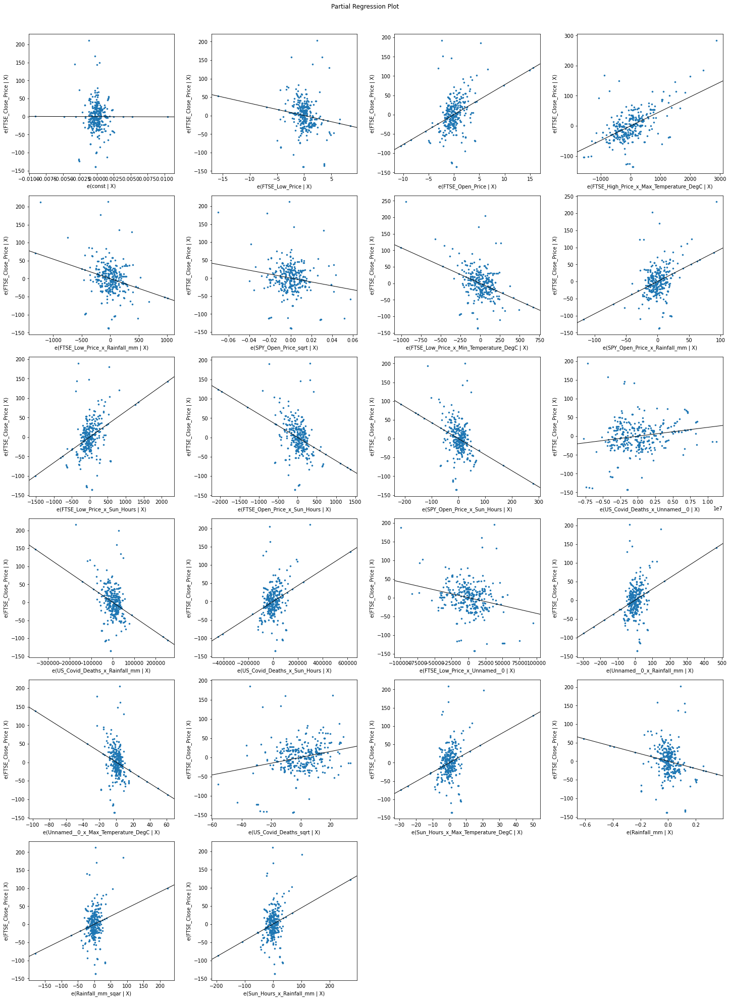


Logit fit using reproducible random 80% (x_train & y_train) of data rows:

    Mean Absolute Residual = 6302.139515669511
Root Mean Squared Residual = 6322.116350393164
                        R² = nan

Logit prediction using remaining 20% (x_test & y_test) of data rows:

    Mean Absolute Error = 6223.950000000001
Root Mean Squared Error = 6243.163068116265
                     R² = nan

Plots of train-set fit & test-set predict:


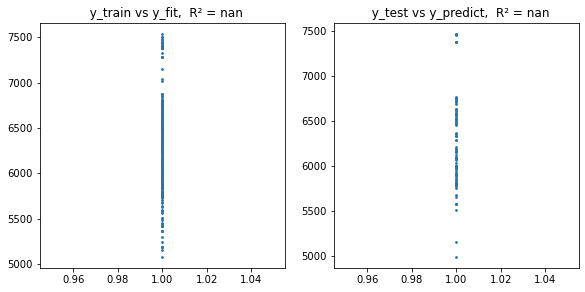


 
 
 
 
 
========================================================== Next GLM Model ==============================================================

 
 
 
 
 
counter =  4
GLM Model Fitted =  Probit
1 entered.

Assuming Probit error distribution.

X pairs with correlations > 0.995 :
SPY_Close_Price , SPY_Open_Price

1 variables considered for deletion:
SPY_Close_Price

X pairs with correlations > 0.995 :
(no more)

1 variables deleted.

X pairs with correlations > 0.995 :
FTSE_Open_Price_sqar , FTSE_Open_Price_sqrt
FTSE_Open_Price_sqrt , FTSE_Open_Price
FTSE_High_Price_sqar , FTSE_High_Price
FTSE_High_Price , FTSE_High_Price_sqrt
FTSE_Low_Price_sqrt , FTSE_Low_Price_sqar
FTSE_Low_Price_sqar , FTSE_Low_Price

6 variables considered for deletion:
FTSE_Open_Price_sqar
FTSE_Open_Price_sqrt
FTSE_High_Price_sqar
FTSE_High_Price_sqrt
FTSE_Low_Price_sqrt
FTSE_Low_Price_sqar

X pairs with correlations > 0.995 :
(no more)

6 transformed variables deleted.

Fit using reproducible random 80% (x_tr


Adjusted R² = -inf , max(X p-value) = 0.0 , rank deficiency = 8 , for 17 Xs.
Variable to drop: Unnamed__0

Adjusted R² = -inf , max(X p-value) = 0.0 , rank deficiency = 7 , for 16 Xs.
Variable to drop: SPY_Open_Price

Adjusted R² = -inf , max(X p-value) = 0.0 , rank deficiency = 6 , for 15 Xs.
Variable to drop: FTSE_Volume_sqrt

Adjusted R² = -inf , max(X p-value) = 0.0 , rank deficiency = 6 , for 14 Xs.
Variable to drop: Sun_Hours_sqrt

Adjusted R² = -inf , max(X p-value) = 0.0 , rank deficiency = 5 , for 13 Xs.
Variable to drop: Min_Temperature_DegC_sqar

Adjusted R² = -inf , max(X p-value) = 0.0 , rank deficiency = 5 , for 12 Xs.
Variable to drop: Min_Temperature_DegC

Adjusted R² = -inf , max(X p-value) = 0.0 , rank deficiency = 4 , for 11 Xs.
Variable to drop: Max_Temperature_DegC_sqar

Adjusted R² = -inf , max(X p-value) = 0.0 , rank deficiency = 3 , for 10 Xs.
Variable to drop: Rainfall_mm_sqar

Adjusted R² = -inf , max(X p-value) = 0.0 , rank deficiency = 3 , for 9 Xs.
Variabl

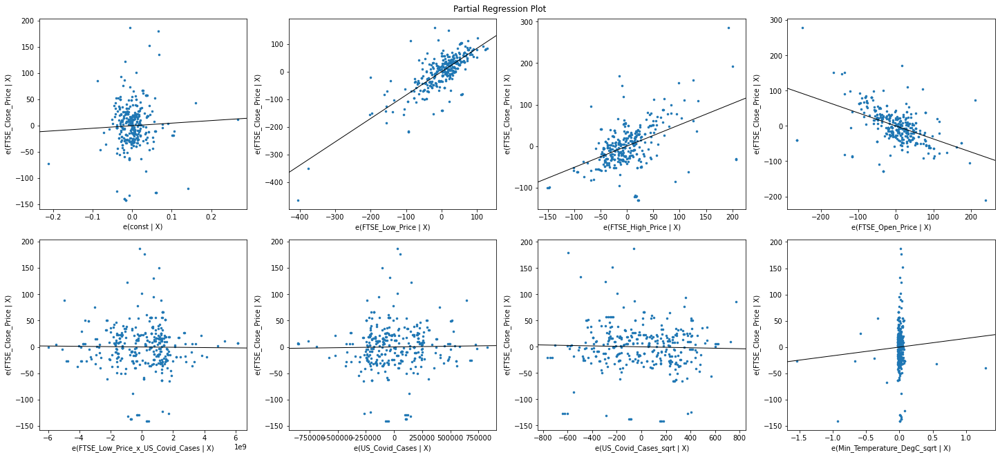


Probit fit using reproducible random 80% (x_train & y_train) of data rows:

    Mean Absolute Residual = 6302.139515669511
Root Mean Squared Residual = 6322.116350393164
                        R² = nan

Probit prediction using remaining 20% (x_test & y_test) of data rows:

    Mean Absolute Error = 6223.950000000001
Root Mean Squared Error = 6243.163068116265
                     R² = nan

Plots of train-set fit & test-set predict:


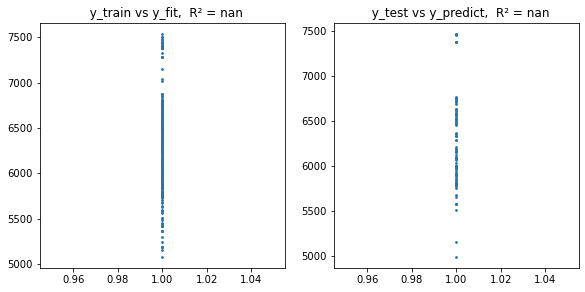


 
 
 
 
 
========================================================== Next GLM Model ==============================================================

 
 
 
 
 
counter =  5
GLM Model Fitted =  Gamma
1 entered.

Assuming Gamma error distribution.

X pairs with correlations > 0.995 :
SPY_Close_Price , SPY_Open_Price

1 variables considered for deletion:
SPY_Close_Price

X pairs with correlations > 0.995 :
(no more)

1 variables deleted.

X pairs with correlations > 0.995 :
FTSE_Open_Price_sqar , FTSE_Open_Price_sqrt
FTSE_Open_Price_sqrt , FTSE_Open_Price
FTSE_High_Price_sqar , FTSE_High_Price
FTSE_High_Price , FTSE_High_Price_sqrt
FTSE_Low_Price_sqrt , FTSE_Low_Price_sqar
FTSE_Low_Price_sqar , FTSE_Low_Price

6 variables considered for deletion:
FTSE_Open_Price_sqar
FTSE_Open_Price_sqrt
FTSE_High_Price_sqar
FTSE_High_Price_sqrt
FTSE_Low_Price_sqrt
FTSE_Low_Price_sqar

X pairs with correlations > 0.995 :
(no more)

6 transformed variables deleted.

Fit using reproducible random 80% (x_trai


Adjusted R² = 0.9599453439015769 , max(X p-value) = 0.9537680921989193 , rank deficiency = 11 , for 20 Xs.
Variable to drop: cumAdmissions

Adjusted R² = 0.9599536068334957 , max(X p-value) = 0.28556533593804123 , rank deficiency = 10 , for 19 Xs.
Variable to drop: US_Covid_Deaths_sqar

Adjusted R² = 0.960050414842225 , max(X p-value) = 0.09222365313644462 , rank deficiency = 10 , for 18 Xs.
Variable to drop: Unnamed__0_sqrt

Adjusted R² = 0.9600470577853288 , max(X p-value) = 0.0021745127640017117 , rank deficiency = 9 , for 17 Xs.
Variable to drop: Rainfall_mm

Adjusted R² = 0.959372209820619 , max(X p-value) = 0.024706459334142634 , rank deficiency = 8 , for 16 Xs.
Variable to drop: Sun_Hours

Adjusted R² = 0.9592490639627856 , max(X p-value) = 0.9976293599041667 , rank deficiency = 7 , for 15 Xs.
Variable to drop: Rainfall_mm_sqrt

Adjusted R² = 0.9593139649926342 , max(X p-value) = 0.004285264635151392 , rank deficiency = 6 , for 14 Xs.
Variable to drop: Sun_Hours_sqrt

Adjusted 

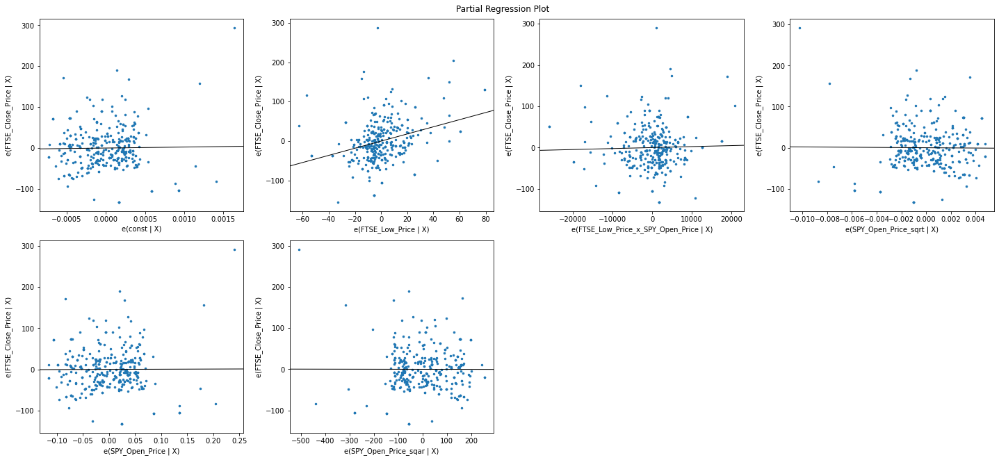


Gamma fit using reproducible random 80% (x_train & y_train) of data rows:

    Mean Absolute Residual = 43.918281573122556
Root Mean Squared Residual = 56.73677274645222
                        R² = 0.9872432075973453

Gamma prediction using remaining 20% (x_test & y_test) of data rows:

    Mean Absolute Error = 42.0210908171442
Root Mean Squared Error = 55.371810541037576
                     R² = 0.9875464090867117

Plots of train-set fit & test-set predict:


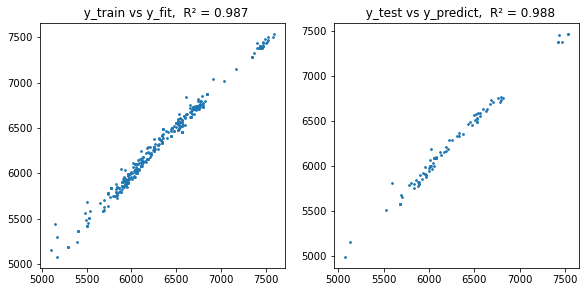


 
 
 
 
 
========================================================== Next GLM Model ==============================================================

 
 
 
 
 
counter =  6
GLM Model Fitted =  InverseGaussian
1 entered.

Assuming InverseGaussian error distribution.

X pairs with correlations > 0.995 :
SPY_Close_Price , SPY_Open_Price

1 variables considered for deletion:
SPY_Close_Price

X pairs with correlations > 0.995 :
(no more)

1 variables deleted.

X pairs with correlations > 0.995 :
FTSE_Open_Price_sqar , FTSE_Open_Price_sqrt
FTSE_Open_Price_sqrt , FTSE_Open_Price
FTSE_High_Price_sqar , FTSE_High_Price
FTSE_High_Price , FTSE_High_Price_sqrt
FTSE_Low_Price_sqrt , FTSE_Low_Price_sqar
FTSE_Low_Price_sqar , FTSE_Low_Price

6 variables considered for deletion:
FTSE_Open_Price_sqar
FTSE_Open_Price_sqrt
FTSE_High_Price_sqar
FTSE_High_Price_sqrt
FTSE_Low_Price_sqrt
FTSE_Low_Price_sqar

X pairs with correlations > 0.995 :
(no more)

6 transformed variables deleted.

Fit using reproducibl


Adjusted R² = 0.9649906267828705 , max(X p-value) = 0.458670713942413 , rank deficiency = 10 , for 21 Xs.
Variable to drop: Min_Temperature_DegC

Adjusted R² = 0.9649611961492371 , max(X p-value) = 0.11787277690399688 , rank deficiency = 9 , for 20 Xs.
Variable to drop: cumDailyNsoDeathsByDeathDate_sqrt

Adjusted R² = 0.9648985867806816 , max(X p-value) = 0.00971556497859933 , rank deficiency = 8 , for 19 Xs.
Variable to drop: cumCasesByPublishDate_sqar

Adjusted R² = 0.9640767786533951 , max(X p-value) = 0.06734088040760255 , rank deficiency = 7 , for 18 Xs.
Variable to drop: US_Covid_Cases

Adjusted R² = 0.9634740343354187 , max(X p-value) = 0.0006946929376341227 , rank deficiency = 7 , for 17 Xs.
Variable to drop: US_Covid_Deaths_sqar

Adjusted R² = 0.9626638281611359 , max(X p-value) = 0.0018351166943530923 , rank deficiency = 7 , for 16 Xs.
Variable to drop: US_Covid_Cases_sqar

Adjusted R² = 0.9840954192858459 , max(X p-value) = 0.6398126408364406 , rank deficiency = 1 , for 15 

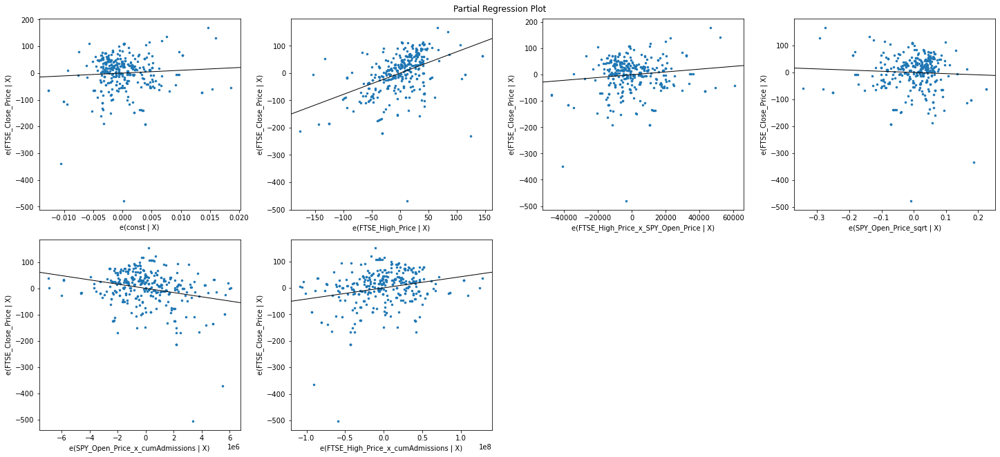


InverseGaussian fit using reproducible random 80% (x_train & y_train) of data rows:

    Mean Absolute Residual = 50.255959989669996
Root Mean Squared Residual = 67.30867198529681
                        R² = 0.9820390584432482

InverseGaussian prediction using remaining 20% (x_test & y_test) of data rows:

    Mean Absolute Error = 42.84020035436302
Root Mean Squared Error = 55.431801899440806
                     R² = 0.9873544647627023

Plots of train-set fit & test-set predict:


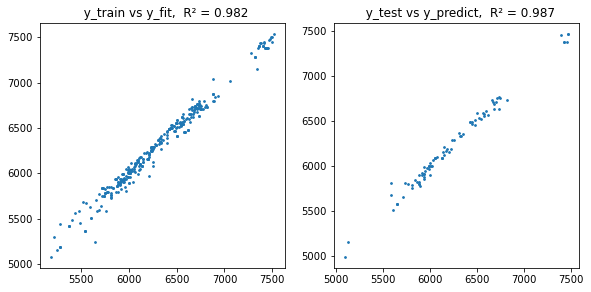


 
 
 
 
 
========================================================== Next GLM Model ==============================================================

 
 
 
 
 
counter =  7
GLM Model Fitted =  NegativeBinomial
1 entered.

Assuming NegativeBinomial error distribution.

X pairs with correlations > 0.995 :
SPY_Close_Price , SPY_Open_Price

1 variables considered for deletion:
SPY_Close_Price

X pairs with correlations > 0.995 :
(no more)

1 variables deleted.

X pairs with correlations > 0.995 :
FTSE_Open_Price_sqar , FTSE_Open_Price_sqrt
FTSE_Open_Price_sqrt , FTSE_Open_Price
FTSE_High_Price_sqar , FTSE_High_Price
FTSE_High_Price , FTSE_High_Price_sqrt
FTSE_Low_Price_sqrt , FTSE_Low_Price_sqar
FTSE_Low_Price_sqar , FTSE_Low_Price

6 variables considered for deletion:
FTSE_Open_Price_sqar
FTSE_Open_Price_sqrt
FTSE_High_Price_sqar
FTSE_High_Price_sqrt
FTSE_Low_Price_sqrt
FTSE_Low_Price_sqar

X pairs with correlations > 0.995 :
(no more)

6 transformed variables deleted.

Fit using reproduci


Adjusted R² = 0.9868162410403454 , max(X p-value) = 0.9907495752625315 , rank deficiency = 1 , for 15 Xs.
Variable to drop: US_Covid_Cases_sqrt

Adjusted R² = 0.9868003538219083 , max(X p-value) = 0.9851379820962101 , rank deficiency = 1 , for 14 Xs.
Variable to drop: cumPeopleVaccinatedCompleteByPublishDate

Adjusted R² = 0.9867193043091383 , max(X p-value) = 0.9835476321433216 , rank deficiency = 1 , for 13 Xs.
Variable to drop: cumPeopleVaccinatedCompleteByPublishDate_sqrt

Adjusted R² = 0.9865918193036649 , max(X p-value) = 0.9891356808637602 , rank deficiency = 1 , for 12 Xs.
Variable to drop: Unnamed__0

Adjusted R² = 0.9865283795571441 , max(X p-value) = 0.9951479446884365 , rank deficiency = 1 , for 11 Xs.
Variable to drop: cumVirusTests_sqrt

Adjusted R² = 0.986549952375931 , max(X p-value) = 0.9806679900434531 , rank deficiency = 1 , for 10 Xs.
Variable to drop: Max_Temperature_DegC

Adjusted R² = 0.9863421703339775 , max(X p-value) = 0.992874255712171 , rank deficiency = 1 

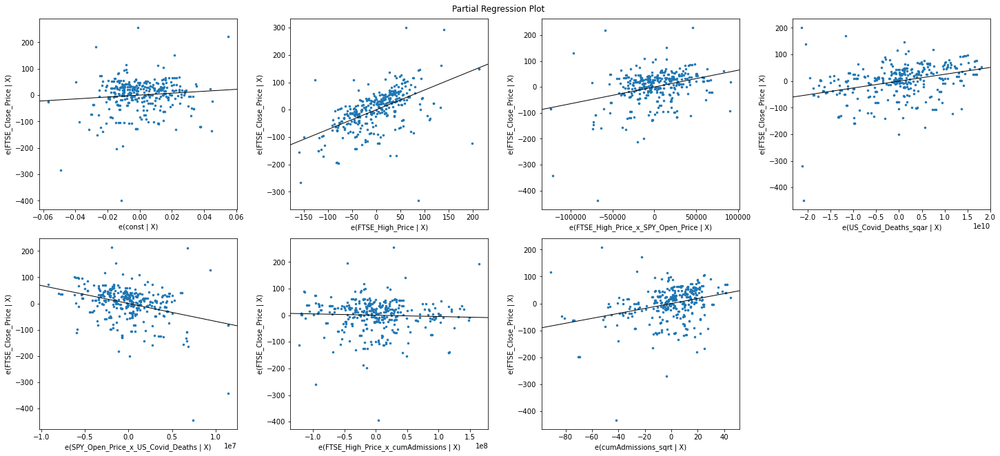


NegativeBinomial fit using reproducible random 80% (x_train & y_train) of data rows:

    Mean Absolute Residual = 40.568278576941594
Root Mean Squared Residual = 57.987066282689405
                        R² = 0.9866678808463315

NegativeBinomial prediction using remaining 20% (x_test & y_test) of data rows:

    Mean Absolute Error = 33.88302071770381
Root Mean Squared Error = 47.724854685168026
                     R² = 0.9905446302957932

Plots of train-set fit & test-set predict:


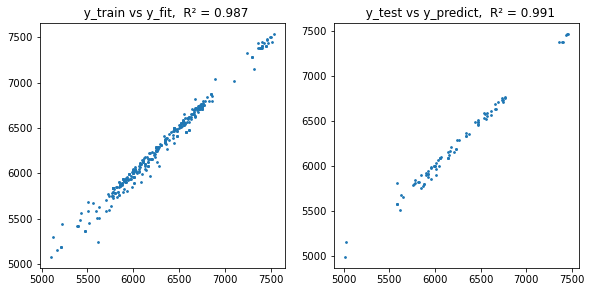


 
 
 
 
 
========================================================== Next GLM Model ==============================================================

 
 
 
 
 
counter =  8
GLM Model Fitted =  Tweedie
1 entered.

Assuming Tweedie error distribution.

X pairs with correlations > 0.995 :
SPY_Close_Price , SPY_Open_Price

1 variables considered for deletion:
SPY_Close_Price

X pairs with correlations > 0.995 :
(no more)

1 variables deleted.

X pairs with correlations > 0.995 :
FTSE_Open_Price_sqar , FTSE_Open_Price_sqrt
FTSE_Open_Price_sqrt , FTSE_Open_Price
FTSE_High_Price_sqar , FTSE_High_Price
FTSE_High_Price , FTSE_High_Price_sqrt
FTSE_Low_Price_sqrt , FTSE_Low_Price_sqar
FTSE_Low_Price_sqar , FTSE_Low_Price

6 variables considered for deletion:
FTSE_Open_Price_sqar
FTSE_Open_Price_sqrt
FTSE_High_Price_sqar
FTSE_High_Price_sqrt
FTSE_Low_Price_sqrt
FTSE_Low_Price_sqar

X pairs with correlations > 0.995 :
(no more)

6 transformed variables deleted.

Fit using reproducible random 80% (x_


Adjusted R² = 0.955443911976678 , max(X p-value) = 1.7003891957415975e-07 , rank deficiency = 5 , for 22 Xs.
Variable to drop: cumPeopleVaccinatedCompleteByPublishDate_sqar

Adjusted R² = 0.9874287103619765 , max(X p-value) = 0.9609615783054877 , rank deficiency = 2 , for 21 Xs.
Variable to drop: cumPeopleVaccinatedCompleteByPublishDate

Adjusted R² = 0.9874667097960268 , max(X p-value) = 0.8535196896733284 , rank deficiency = 2 , for 20 Xs.
Variable to drop: SPY_Open_Price_sqar

Adjusted R² = 0.9875000670289629 , max(X p-value) = 0.5584428421346406 , rank deficiency = 2 , for 19 Xs.
Variable to drop: cumAdmissions_sqrt

Adjusted R² = 0.9875322275646254 , max(X p-value) = 0.5056610951671816 , rank deficiency = 2 , for 18 Xs.
Variable to drop: Max_Temperature_DegC_sqrt

Adjusted R² = 0.9875086166047718 , max(X p-value) = 0.21466738839120048 , rank deficiency = 1 , for 17 Xs.
Variable to drop: Max_Temperature_DegC

Adjusted R² = 0.98749402903174 , max(X p-value) = 0.32480285657356434 , 


Descending order of 12 X's significance, assuming Tweedie error distribution:
                                    Coefficient      z-stat
const                              7.607540e+00  181.936645
FTSE_High_Price                    1.523792e-04   47.886397
cumDailyNsoDeathsByDeathDate_sqrt  2.280805e-04   10.008548
US_Covid_Deaths                   -3.371130e-07   -6.098835
US_Covid_Deaths_sqar               4.959323e-13    4.858586
FTSE_Volume                       -7.723129e-12   -4.353649
SPY_Open_Price_sqrt                1.229833e-02    4.336866
cumAdmissions_sqar                -5.194551e-13   -3.897708
cumCasesByPublishDate              1.196678e-08    3.597816
Sun_Hours_sqar                    -1.767046e-06   -3.186599
Sun_Hours                          4.451579e-04    3.068001
Rainfall_mm_sqrt                  -1.717203e-02   -2.480151
Rainfall_mm                        8.849442e-04    2.213690

Rank deficiency = 0: Df Model (12) is same as number of Xs (12).

Partial Levera

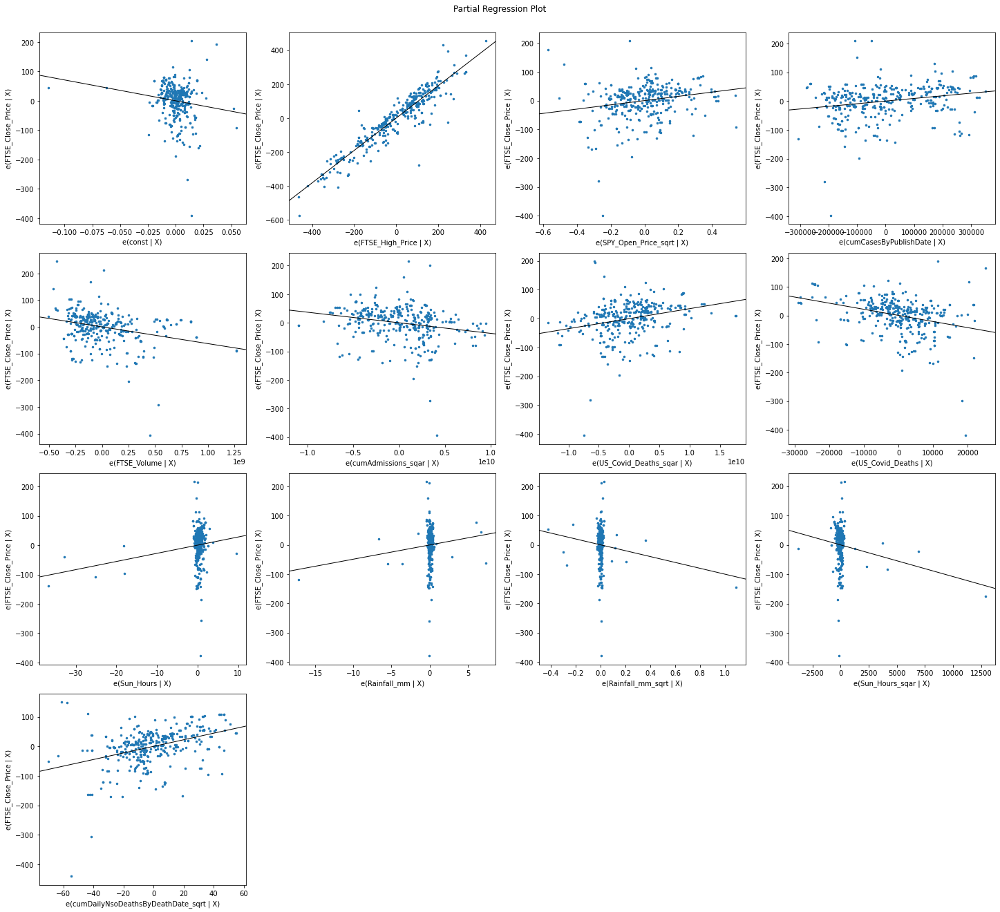


Tweedie fit using reproducible random 80% (x_train & y_train) of data rows:

    Mean Absolute Residual = 39.49322540480849
Root Mean Squared Residual = 55.53603953998394
                        R² = 0.987770257107481

Tweedie prediction using remaining 20% (x_test & y_test) of data rows:

    Mean Absolute Error = 40.23066289626135
Root Mean Squared Error = 52.62934342455948
                     R² = 0.9886616964974738

Plots of train-set fit & test-set predict:


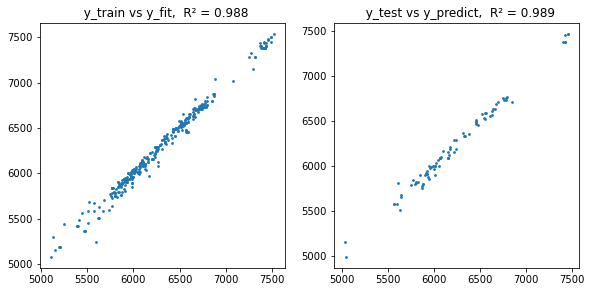


 
 
 
 
 
========================================================== Next GLM Model ==============================================================

 
 
 
 
 
counter =  9
GLM Model Fitted =  GLM Gaussian
1 entered.

Assuming GLM Gaussian error distribution.

X pairs with correlations > 0.995 :
SPY_Close_Price , SPY_Open_Price

1 variables considered for deletion:
SPY_Close_Price

X pairs with correlations > 0.995 :
(no more)

1 variables deleted.

X pairs with correlations > 0.995 :
FTSE_Open_Price_sqar , FTSE_Open_Price_sqrt
FTSE_Open_Price_sqrt , FTSE_Open_Price
FTSE_High_Price_sqar , FTSE_High_Price
FTSE_High_Price , FTSE_High_Price_sqrt
FTSE_Low_Price_sqrt , FTSE_Low_Price_sqar
FTSE_Low_Price_sqar , FTSE_Low_Price

6 variables considered for deletion:
FTSE_Open_Price_sqar
FTSE_Open_Price_sqrt
FTSE_High_Price_sqar
FTSE_High_Price_sqrt
FTSE_Low_Price_sqrt
FTSE_Low_Price_sqar

X pairs with correlations > 0.995 :
(no more)

6 transformed variables deleted.

Fit using reproducible rand


Adjusted R² = 0.9926646717577661 , max(X p-value) = 0.07734271652895466 , rank deficiency = 0 , for 5 Xs.
Variable to drop: Rainfall_mm

Adjusted R² = 0.9926197296220952 , max(X p-value) = 0.18707146930160945 , rank deficiency = 0 , for 4 Xs.
Variable to drop: Rainfall_mm_sqar

Adjusted R² = 0.9926039794080767 , max(X p-value) = 1.2130206336483614e-24 , rank deficiency = 0 , for 3 Xs.
Variable to drop: FTSE_Open_Price

Adjusted R² = 0.9903933859344677 , max(X p-value) = 1.769075275572336e-14 , rank deficiency = 0 , for 2 Xs.
Variable to drop: FTSE_High_Price

Adjusted R² = 0.9888031058125417 , max(X p-value) = 0.0 , rank deficiency = 0 , for 1 Xs.
Variable left: FTSE_Low_Price

Restarting from best model (with 8 Xs & Adjusted R² = 0.9926792969907646) found so far...

Adding 10 2-way interactions among 5 untransformed variables in best model found so far:
FTSE_Low_Price_x_FTSE_High_Price
FTSE_Low_Price_x_FTSE_Open_Price
FTSE_Low_Price_x_US_Covid_Cases
FTSE_Low_Price_x_Rainfall_mm
FTSE_

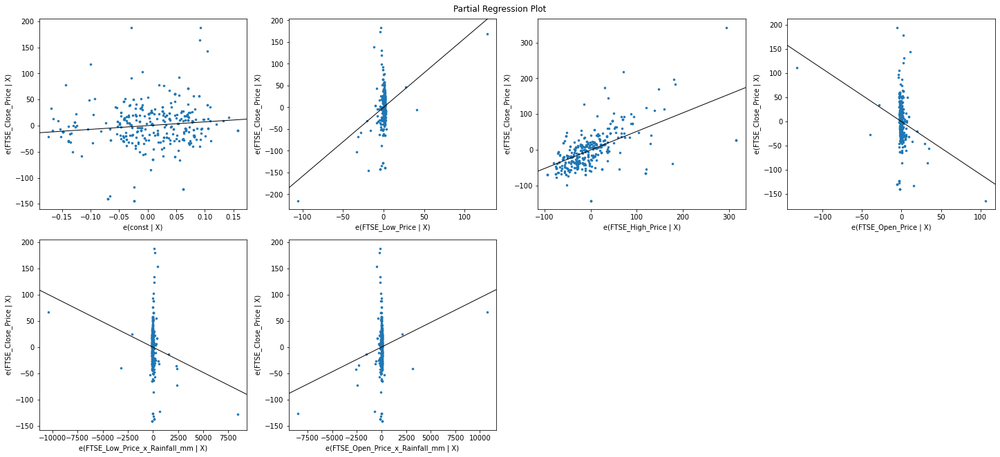


GLM Gaussian fit using reproducible random 80% (x_train & y_train) of data rows:

    Mean Absolute Residual = 29.146367997189703
Root Mean Squared Residual = 42.31173159530557
                        R² = 0.9929011314655393

GLM Gaussian prediction using remaining 20% (x_test & y_test) of data rows:

    Mean Absolute Error = 27.01758016799927
Root Mean Squared Error = 38.869443002350124
                     R² = 0.9942506743907702

Plots of train-set fit & test-set predict:


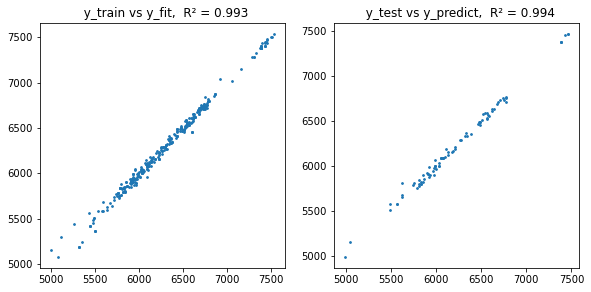


 
 
 
 
 
========================================================== Next GLM Model ==============================================================

 
 
 
 
 
counter =  10
GLM Model Fitted =  Normal
1 entered.

Assuming Normal error distribution.

X pairs with correlations > 0.995 :
SPY_Close_Price , SPY_Open_Price

1 variables considered for deletion:
SPY_Close_Price

X pairs with correlations > 0.995 :
(no more)

1 variables deleted.

X pairs with correlations > 0.995 :
FTSE_Open_Price_sqar , FTSE_Open_Price_sqrt
FTSE_Open_Price_sqrt , FTSE_Open_Price
FTSE_High_Price_sqar , FTSE_High_Price
FTSE_High_Price , FTSE_High_Price_sqrt
FTSE_Low_Price_sqrt , FTSE_Low_Price_sqar
FTSE_Low_Price_sqar , FTSE_Low_Price

6 variables considered for deletion:
FTSE_Open_Price_sqar
FTSE_Open_Price_sqrt
FTSE_High_Price_sqar
FTSE_High_Price_sqrt
FTSE_Low_Price_sqrt
FTSE_Low_Price_sqar

X pairs with correlations > 0.995 :
(no more)

6 transformed variables deleted.

Fit using reproducible random 80% (x_t

Adjusted R² = 0.9927628460234671 , max(X p-value) = 0.9908434757602849 , rank deficiency = 8 , for 23 Xs.
Variable to drop: Max_Temperature_DegC

Adjusted R² = 0.9927628965373916 , max(X p-value) = 0.8595330448970508 , rank deficiency = 7 , for 22 Xs.
Variable to drop: Max_Temperature_DegC_sqrt

Adjusted R² = 0.9927629131652195 , max(X p-value) = 0.7794559846361968 , rank deficiency = 6 , for 21 Xs.
Variable to drop: cumPeopleVaccinatedCompleteByPublishDate_sqrt

Adjusted R² = 0.9927827033435752 , max(X p-value) = 0.8029367283925661 , rank deficiency = 6 , for 20 Xs.
Variable to drop: Min_Temperature_DegC_sqrt

Adjusted R² = 0.9927826907031152 , max(X p-value) = 0.6837597313876718 , rank deficiency = 5 , for 19 Xs.
Variable to drop: SPY_Open_Price_sqrt

Adjusted R² = 0.9927827986446083 , max(X p-value) = 0.5377814072605769 , rank deficiency = 4 , for 18 Xs.
Variable to drop: Min_Temperature_DegC_sqar

Adjusted R² = 0.9927971661141927 , max(X p-value) = 0.7002303075176355 , rank deficie

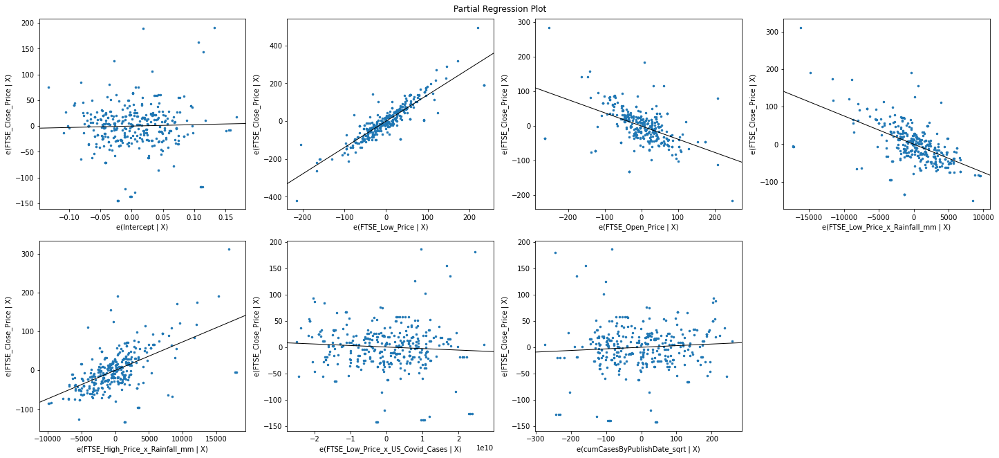


Normal fit using reproducible random 80% (x_train & y_train) of data rows:

    Mean Absolute Residual = 29.066173911422652
Root Mean Squared Residual = 42.34393381042232
                        R² = 0.9928903218733488

Normal prediction using remaining 20% (x_test & y_test) of data rows:

    Mean Absolute Error = 26.7707801761965
Root Mean Squared Error = 38.27870342033717
                     R² = 0.9944462291696584

Plots of train-set fit & test-set predict:


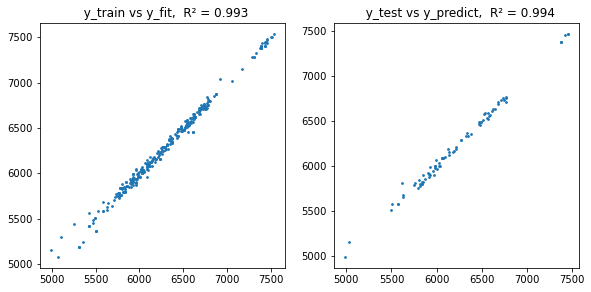

In [26]:
## Generalized Linear Model (GLM) with transformed variables & interaction variables (collinearity issue considered)

#For comparing Normal & GLM error distributions.

#algorithm is inefficient but clearer for instructional purposes
#favors fit with Xs' p-values < 0.05, and smaller rank-deficiency (number_of_Xs - Df_Model)

import warnings
warnings.filterwarnings('ignore')

import statsmodels.api as sm
import pandas as pd

#set maximum window width
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>")) #change code window width to max
pd.options.display.max_columns = 0 #change output window width to max

counter = 1

#Iterate through 0 to 10, iterate through the GLM models
for i in range(0,10):  
    
    print("\n \n \n \n \n ")
    print("========================================================== Next GLM Model ==============================================================")
    print("\n \n \n \n \n ")
    print("counter = ",counter)
    
    m2 = str(counter)
    counter += 1  
    
    # 1 out of the 2 following lines should be active:
    # d = '' #means nanes96 will be used
    d = 1 #means use specified dataset instead of the default nanes96: d=''

    if d == '':
        pass
    else:
        #d = 1 case:
        
        #Use cleaned_data
        dt = df_clean.copy() #specifying 1st column as row labels (called 'index')
        #handle special variabes

        yname = 'FTSE_Close_Price' #target variable FTSE CLose Price

        import regex as re
        dt.rename(columns=lambda x: re.sub('\W', '_', x), inplace=True) #replace ' ' by '_' in variable names
        yname = re.sub('\W', '_', yname)

        #delete any row with any missing value
        dt.dropna(how='any', inplace=True)
        if yname != dt.columns[0]:
            dt = dt[[yname] + list(dt.columns.drop(yname))]

        #m2 = input('1: OLS (default), 2: Poisson, 3: Logit, 4: Probit, 5: Gamma, 6: InverseGaussian, 7: NegativeBinomial,' +
                   #' 8: Tweedie, 9: Gaussian? ').strip()
        if m2 == '2':
            #https://www.statsmodels.org/stable/glm.html
            m = 'Poisson'
            dist = sm.families.Poisson()
        elif m2 == '3':
            m = 'Logit'
            dist = sm.families.Binomial()
        elif m2 == '4':
            m = 'Probit'
            #http://web.pdx.edu/~crkl/ceR/Python/example8_1.py
            dist = sm.families.Binomial(sm.genmod.families.links.probit)
        elif m2 == '5':
            m = 'Gamma'
            dist = sm.families.Gamma()
        elif m2 == '6':
            m = 'InverseGaussian'
            dist = sm.families.InverseGaussian()
        elif m2 == '7':
            m = 'NegativeBinomial'
            dist = sm.families.NegativeBinomial()
        elif m2 == '8':
            m = 'Tweedie'
            dist = sm.families.Tweedie()
        elif m2 == '9':
            m = 'GLM Gaussian'
            dist = sm.families.Gaussian()
        else:
            # m2 == 1 or ''
            m = 'Normal'
            
        print('GLM Model Fitted = ',m)

    ytype = type('a')
    if m == 'Normal':
        #there is a version of OLS that also requires endog and exog like GLM:
        #http://statsmodels.org/dev/generated/statsmodels.regression.linear_model.OLS.html
        #df has y followed by Xs:
        if d == '':
            df = pd.concat([dt.endog, dt.exog], axis=1) #a DataFrame
        else:
            df = dt
        y = yname
    else:
        #df will not have y, but a column of 1s:
        if d == '':
            df = sm.add_constant(dt.exog) #add column of 1 to the left of dt.exog to form DataFrame
            y = dt.endog #PID: 0 to 6: Party IDentification of respondent (shades of Democrat or Republican)
        else:
            df = sm.add_constant(dt.iloc[:, 1:])
            y = dt.iloc[:, 0]
        ytype = type(y)

    #m3 = input('1: Reproducible output (input any integer except 2), 2: Random train-test data split [default: 1]? ').strip()
    m3 = 1
    if m3 != '2':
        try:
            if m3 == '':
                m3 = 1
            else:
                m3 = int(m3)
            print(m3, 'entered.')
        except:
            m3 = 1 #can be changed to any integer for reproducible randomization
            print(m3, 'assumed.')

    print('\nAssuming', m, 'error distribution.')

    def delcorr(df):
        #delete any x too highly correlated with another x, to avoid collinearity

        #corr(Xs, y) ranked:

    #     corv = pd.DataFrame() #start empty dataframe for corr(Xs, y) to come
    #     for x in list(df)[1:]:
    #         #during 1st time thru loop: new column, with label, created in empty dataframe:
    #         #during subsequent time thru loop: new row, with row label, added to dataframe:
    #         corv.loc[x, yname] = df[x].corr(df[yname] if m == 'Normal' else y)

    #     corv = corv.loc[abs(corv).sort_values([yname]).index, :] #corr(Xs, y) ranked

        corv = df.iloc[:, 1:].corrwith(df[yname] if m == 'Normal' else y).rename(yname).sort_values(key=abs).to_frame()

        delta = 0.005 #corr difference lower limit
        dl2 = []
        icorr = True
        while icorr:
            a = abs(corv).diff() <= delta #adjacent rows with similar abs(corr(Xs, y))
            colname = list(df)[1:]
            dl = []
            print('\nX pairs with correlations >', 1 - delta, ':')
            for b in range(1, a.shape[0]):
                if a.iloc[b, 0]:
                    if abs(df[a.index[b - 1]].corr(df[a.index[b]])) > 1 - delta:
                        #deleting 1 X from correlated pair:
                        dv0 = a.index[b - 1]
                        dv1 = a.index[b]

                        #neither should already be deleted:
                        if not (dv0 in dl) and not (dv1 in dl):
                            #delete x with rather lower corr(x, y):
                            if abs(corv.loc[dv0, y if type(y) == type('a') else y.name]
                                  ) - abs(corv.loc[dv1, y if type(y) == type('a') else y.name]) >= delta:
                                d = dv1
                            elif len(dv0) < len(dv1): #delete x with longer name:
                                d = dv1
                            else:
                                d = dv0

                            dl.append(d) #for en masse deletion later
                            corv.drop([d], axis=0, inplace=True) #delete from column of corr with y

                            print(dv0,',',dv1)

            if len(dl) > 0:
                df.drop(axis=1, columns=dl, inplace=True) #variables deleted en masse
                dl2 = dl2 + dl #keep for real deletion later
                print('\n' + str(len(dl)), 'variables considered for deletion:')
                print('\n'.join([str(x) for x in dl]))
            else:
                print('(no more)')
                icorr = False
        return dl2

    #delete collinear Xs:
    dl2 = delcorr(df)
    #df.drop(axis=1, columns=dl2, inplace=True) #collinear Xs deleted en masse #not necessary since df operated on directly
    if len(dl2) > 0:
        print('\n' + str(len(dl2)) + ' variables deleted.')

    #transform all Xs into either square & square-root or cube & cube-root using np.cbrt()

    trf = ['_sqar', '_sqrt', '_cube', '_cbrt']

    import numpy as np

    for i in list(df)[1:]:
        #excluded either y or column of 1s
        failed = False
        try:
            #searching for -ve values:
            df[i + trf[1]] = np.sqrt(df[i])
            if df[i + trf[1]].isnull().any():
                #bug reported by Sharifah
                failed = True
                del df[i + trf[1]]
            else:    
                df[i + trf[0]] = df[i] ** 2.
        except:
            failed = True
        if failed:
            try:
                #searching for non-numeric
                df[i + trf[2]] = df[i] ** 3.
                df[i + trf[3]] = np.cbrt(df[i])
            except:
                #column cannot be transformed
                #delete non-numeric column (with no questions asked!):
                df.drop(i, axis=1, inplace=True) #remove any row with any NaN

    #only numeric columns left

    #delete collinear Xs:
    df0 = df.copy()
    dl2 = delcorr(df0)
    dl2 = [x for x in dl2 if x[-5:] in trf]
    if len(dl2) > 0:
        df.drop(axis=1, columns=dl2, inplace=True) #collinear transformed variables deleted en masse
        print('\n' + str(len(dl2)) + ' transformed variables deleted.')

    from sklearn.model_selection import train_test_split
    #split into training & testing sets
    x_train, x_test, y_train, y_test = train_test_split(df.iloc[:, 1:] if m == 'Normal' else df,
                df[y] if m == 'Normal' else y, test_size=.2,
                random_state=(None if m3=='2' else m3)) #set to an integer (here m3) to get reproducible output

    #sort columns by absolute correlation with y, so may preferably delete last column if regression fails:
    x_train = x_train[x_train.corrwith(y_train).sort_values(ascending=False, na_position='first', key=abs).index]

    print('\nFit using', ('' if m3 == '2' else 'reproducible ') + 'random 80% (x_train & y_train) of data rows:')

    #first do OLS on untransformed Xs:
    df = pd.concat([y_train, x_train if m == 'Normal' else x_train.iloc[:, 1:]], axis=1)
    xpure = [x for x in list(df) if x[-5:] not in trf]
    numx = len(xpure) - 1
    print('\nOLS fit including only', numx, 'untransformed Xs:')

    #initialize for adj-R2:
    ddf = np.inf #deficiency in degree of freedom = rank deficiency
    maxR2 = -np.inf
    bmodeleq = ''

    bic0 = np.inf #bic kept by lowest overall rank deficiency
    bic5 = bic0   #bic kept by best model with p-values < 0.05
    bicd = bic0   #bic kept by lowest rank deficiency
    bbic = bic0   #best bic kept by adj-R2

    p05 = False #once found all Xs' p-values < 0.05

    modeleq = ' + '.join(list(xpure)).replace('+', '~', 1)
    from statsmodels.formula.api import ols
    try:
        out = ols(modeleq, df).fit()
        print(out.summary2())
        if numx > 1:
            print("\nDescending order of", numx, "X's significance, assuming Normal error distribution:")
            print('\n'.join(list(abs(out.tvalues[1:]).sort_values(0, ascending=False).index)))
            #if the single best variable isn't high in above ranking, collinearity might be an issue

        dfm = int(out.df_model)

        ddf = numx - dfm #rank deficiency
        maxR2 = out.rsquared_adj
        bmodeleq = modeleq
        print('\n' + 'Rank deficiency =', str(ddf) + ': Df Model (' + str(dfm) + ') is',
              ('less than' if ddf > 0 else 'same as'), 'number of Xs (' + str(numx) + ').')
    except:
        pass

    print('\n'+ m, 'fit including transformed Xs:')

    if m != 'Normal':
        #undo above ols:
        ddf = np.inf
        maxR2 = -np.inf
        bmodeleq = ''

        df = x_train
        y = y_train

    #initialize for rank deficiency:
    ddfd = ddf #best rank deficiency
    R2df = maxR2 #R2 for best rank deficiency
    modeleqdf = bmodeleq #modeleq for best rank deficiency

    #initialize for overall rank deficiency
    ddf0 = ddfd
    R2df0 = R2df
    modeleqdf0 = modeleqdf

    bddf = ddfd #rank deficiency for best adj-R2 model

    #initialize for z-stat p-values < 0.05:
    ddf5 = np.inf #rank deficiency for best model with p-values < 0.05
    R205 = -np.inf #adj-R2 for best model with p-values < 0.05
    modeleq05 = '' #modeleq for best model with p-values < 0.05

    df0 = df.copy() #kept for inclusion of interaction variables later

    #perform feature selection using adjusted R2

    #model equation actually not used by GLM:
    modeleq = ' + '.join(list(df)).replace('+', '~', 1)
    #print(modeleq)
    numx = df.shape[1] - 1

    x1x2 = False #interaction variables not yet included

    while True:
        if m == 'Normal':
            #https://www.statsmodels.org/stable/generated/statsmodels.formula.api.ols.html
            out = ols(modeleq, df).fit()
            R2 = out.rsquared_adj
        else:
            #GLM distribution
            try:
                #https://www.statsmodels.org/stable/generated/statsmodels.genmod.generalized_linear_model.GLM.html
                out = sm.GLM(y, df, family=dist).fit()
                R2 = 1 - (1 - y.corr(out.fittedvalues)**2) * (out.nobs - 1) / out.df_resid #pseudo adjusted r2
                if R2 != R2 and out.fittedvalues.isna().sum() == 0:
                    R2 = -np.inf
                    #R2 = -out.bic
            except:
                #GLM failed!  do ols for this round, just to delete 1 x:
                try:
                    out = ols(' + '.join(list(df)).replace('+', '~', 1), df).fit() #do OLS instead
                except:
                    pass
                R2 = -np.inf

        try:
            maxp = max(out.pvalues[1:])
            dfm = int(out.df_model)
        except:
            maxp = 1
            dfm = 0
        ddf = numx - dfm #rank deficiency

        #see if a better model is found:
        try:
            if R2 >= maxR2 and out.fittedvalues.isna().sum() == 0:
                maxR2 = R2
                bmodeleq = modeleq
                bddf = min(bddf, ddf)

                ddf0 = ddf #best overall rank deficiency

                if maxR2 == -np.inf:
                    bbic = out.bic

                if maxp >= 0.05 and not p05:
                    #reset z-stat p-value criterion:
                    R205 = -np.inf
                    modeleq05 = ''

                    #reset rank deficiency criterion:
                    R2df = R205
                    modeleqdf = ''
                    ddfd = bddf #reset deficient df
                else:
                    p05 = True
                #if m != 'Normal':
                #    df1 = df.copy()

            #see if a model is found with reduced overall rank deficiency:
            if ddf < ddf0 or (ddf == ddf0 and R2 > R2df0):
                R2df0 = R2
                modeleqdf0 = modeleq
                ddf0 = ddf #best overall rank deficiency
                if maxR2 == -np.inf:
                    bic0 = out.bic

            #see if a better model is found with max(z-stat p-value) < .05:
            if maxp < .05 and (R2 > R205 or modeleq05 == ''):
                R205 = R2
                modeleq05 = modeleq
                ddf5 = min(ddf5, ddf) #rank deficiency for best model with p-values < .05
                if maxR2 == -np.inf:
                    bic5 = out.bic

            #see if a model is found with reduced rank-deficiency:
            if ddf < ddfd or (ddf == ddfd and R2 > R2df):
                R2df = R2
                modeleqdf = modeleq
                ddfd = min(ddfd, ddf) #best rank deficiency
                if maxR2 == -np.inf:
                    bicd = out.bic
        except:
            pass

        print('\nAdjusted R² =', R2, ', max(X p-value) =', maxp, ', rank deficiency =', ddf, ', for', numx, 'Xs.')

        if numx == 1:
            print('Variable left:', modeleq[modeleq.find('~') + 2 :])
            if x1x2:
                #one xvar left
                #get out of 'while' loop:
                break

            else:
                if maxR2 == -np.inf and out.fittedvalues.isna().sum() > 0:
                    print('\n*** Y variable', yname if m == 'Normal' else y.name, 'might not work with', m, 'distribution.')
                    #use all Xs before deletion:
                    bmodeleq = ' + '.join(list(df0)).replace('+', '~', 1)
                else:
                    #see if best model with all z-stat p-values < 0.05 is smaller than best model by adjusted R2:
                    if (R205 > -np.inf and len(modeleq05) < len(bmodeleq)) or (
                        R205 == -np.inf and (maxR2 == -np.inf or (len(modeleq05) > 0 and len(modeleq05) < len(bmodeleq)))):
                        bmodeleq = modeleq05
                        maxR2 = R205
                        #bddf = min(bddf, ddf5)
                        bddf = ddf5

                        if maxR2 == -np.inf:
                            bmodeleq0 = bmodeleq
                            bddf0 = bddf
                            bbic = bic5 #best bic
                            bic5 = np.inf #re-initialize

                    #see if model with smallest rank-deficiency is smaller than best model so far:
                    if (R2df > -np.inf and len(modeleqdf) < len(bmodeleq)) or (
                        R2df == -np.inf and (maxR2 == -np.inf or (len(modeleqdf) > 0 and len(modeleqdf) < len(bmodeleq)))):
                        bmodeleq = modeleqdf
                        maxR2 = R2df
                        #bddf = min(bddf, ddfd)
                        bddf = ddfd

                        if maxR2 == -np.inf:
                            bmodeleq0 = bmodeleq
                            bddf0 = bddf
                            bbic = bicd #best bic
                            bicd = np.inf #re-initialize

                    if maxR2 == -np.inf:
                        #reset z-stat p-value criterion:
                        R205 = -np.inf
                        modeleq05 = ''

                        #reset rank deficiency criterion:
                        R2df = R205
                        modeleqdf = ''
                        ddfd = np.inf #reset deficient df

                #add interaction variables for original untransformed variables in best model so far

                numx = bmodeleq.count('+') + 1
                if numx == 1:
                    bmodeleq = ' + '.join(list(df0)).replace('+', '~', 1)
                    numx = bmodeleq.count('+') + 1
                print('\nRestarting from best model (with', numx, 'Xs & Adjusted R² =', str(maxR2) + ') found so far...')

                colname = bmodeleq.replace('~', '+').split(' + ')
                df = df0[colname]
                colname = colname[1:] #remove y or 'const'
                x_test = x_test[colname]

    #             for i in range(numx):
    #                 #look for 1st transformed variable:
    #                 if colname[i][-5:] in trf:
    #                     i = i - 1
    #                     #colname[i] is the last untransformed x
    #                     break

    #             #actually, nothing to do if i<=0
    #             print('\nAdding', int((i + 1) * i / 2), '2-way interactions among', i + 1,
    #                   'untransformed variables in best model found so far:')
    #             for j in range(i):
    #                 #untransformed x in colname up to [i]
    #                 for k in range(j + 1, i + 1):
    #                     a = colname[j] + '_x_' + colname[k]
    #                     print(a)
    #                     df[a] = df[colname[j]] * df[colname[k]]
    #                     x_test[a] = x_test[colname[j]] * x_test[colname[k]]

                xpure = [x for x in colname if x[-5:] not in trf] #untransformed x names
                i = len(xpure) - 1

                #actually, nothing to do if i<=0
                print('\nAdding', int((i + 1) * i / 2), '2-way interactions among', i + 1,
                      'untransformed variables in best model found so far:')
                for j in range(i):
                    #untransformed x in colname up to [i]
                    for k in range(j + 1, i + 1):
                        a = xpure[j] + '_x_' + xpure[k]
                        print(a)
                        df[a] = df[xpure[j]] * df[xpure[k]]
                        x_test[a] = x_test[xpure[j]] * x_test[xpure[k]]

                df0 = df.copy()

                #delete collinear Xs introduced:
                dl2 = delcorr(df)
                dl2 = [x for x in dl2 if x.find('_x_') != -1] #only interaction variables kept
                if len(dl2) > 0:
                    df0.drop(axis=1, columns=dl2, inplace=True) #collinear interaction variables deleted en masse, for real
                    x_test.drop(axis=1, columns=dl2, inplace=True)
                    #remaining Xs may be collinear
                    print('\n' + str(len(dl2)) + ' interaction variables deleted.')

                #potential collinearity issues handled

                #sort columns by absolute correlation with y, so may delete last column if regression fails:
                #df0 = df0[df0.corrwith(y_train).sort_values(ascending=False, na_position='first', key=abs).index]
                df0 = df0[[df0.columns[0]] + list(df0.iloc[:, 1:].corrwith(y_train)
                                                  .sort_values(ascending=False, na_position='first', key=abs).index)]

                modeleq = ' + '.join(list(df0)).replace('+', '~', 1)
                numx = df0.shape[1] - 1
                if maxR2 == -np.inf:
                    bddf = np.inf
                    ddf5 = bddf
                    ddfd = bddf
                    p05 = False
                x1x2 = True #interaction variables already included

                #beyond-pairwise collinearity may still be introduced with the interaction variables

                df = df0.copy() #ready for continuing deletion
                continue

        #identify X variable to delete by finding the one with smallest abs(t-stat):
        t = out.tvalues[1:]
        try:
            xdrop = list(t[abs(t) == min(abs(t))].index)[-1]
        except:
            xdrop = list(t.index)[-1]
        print('Variable to drop:', xdrop)

        try:
            df.drop(xdrop, axis=1, inplace=True)

        except:
            pass

        modeleq = ' + '.join(list(df)).replace('+', '~', 1)

        numx = numx - 1

    #see if best model with all z-stat p-values < 0.05 is smaller than best model by adjusted R2:
    if (R205 > -np.inf and len(modeleq05) < len(bmodeleq)) or (
        R205 == -np.inf and (maxR2 == -np.inf or (len(modeleq05) > 0 and len(modeleq05) < len(bmodeleq)))):
        bmodeleq = modeleq05
        maxR2 = R205
        bddf = ddf5

    #see if model with smallest rank-deficiency is smaller than best model so far:
    if (R2df > -np.inf and len(modeleqdf) < len(bmodeleq)) or (
        R2df == -np.inf and (maxR2 == -np.inf or (len(modeleqdf) > 0 and len(modeleqdf) < len(bmodeleq)))):
        bmodeleq = modeleqdf
        maxR2 = R2df
        bddf = ddfd

    if maxR2 == -np.inf and out.fittedvalues.isna().any():
        #some nan in y fit
        print('\n*** Y variable', yname if m == 'Normal' else y.name, 'might not work with', m, 'distribution.')
    else:
        try:
            if bddf >= ddf0 and ((maxR2 > -np.inf and R2df0 >= maxR2) or (maxR2 == -np.inf and bic0 <= bbic)):
                bmodeleq_0 = bmodeleq
                maxR2_0 = maxR2
                bddf_0 = bddf

                #prefer smaller rank deficiency
                if m == 'Normal':
                    out = ols(modeleqdf0, df0).fit()
                else:
                    out = sm.GLM(y, df0[modeleqdf0.replace('~', '+').split(' + ')], family=dist).fit()
                if max(out.pvalues[1:]) < 0.05:
                    #Xs' p-values < 0.05
                    bmodeleq = modeleqdf0
                    maxR2 = R2df0
                    bddf = ddf0
        except:
            bmodeleq = bmodeleq_0
            maxR2 = maxR2_0
            bddf = bddf_0

        try:
            if m == 'Normal':
                out = ols(bmodeleq, df0).fit()
                #collinearity is still entirely possible at this stage
                x_test = x_test[df0.columns[1:]]
            else:
                #out = sm.GLM(y, df1, family=dist).fit()
                #x_test = sm.add_constant(x_test)[df1.columns]
                df0 = df0[bmodeleq.replace('~', '+').split(' + ')]
                out = sm.GLM(y, df0, family=dist).fit()
                x_test = sm.add_constant(x_test)[df0.columns]

            numx = bmodeleq.count('+') + 1
            print('\nBest model has', numx, 'Xs (Adjusted R² =', str(maxR2), ', rank deficiency =', str(bddf) + '):\n')
            print(out.summary2())

            if m == 'Normal':
                print()

            if numx > 1:
                print("Descending order of", numx, "X's significance, assuming", m, 'error distribution:')
                #print('\n'.join(list(abs(out.tvalues[1:]).sort_values(0, ascending=False).index)))
                print(pd.concat([pd.concat([out.params[:1], out.tvalues[:1]], 1), pd.concat([out.params[1:], out.tvalues[1:]], 1
                       ).sort_values(1, key=abs, ascending=False)]).rename(columns={0:"Coefficient", 1:"z-stat"}))
                #if the single best variable isn't high in above ranking, collinearity might be an issue

            dfm = int(out.df_model)
            print('\n' + 'Rank deficiency =', str(bddf) + ': Df Model (' + str(dfm) + ') is',
                  ('less than' if bddf > 0 else 'same as'), 'number of Xs (' + str(numx) + ').')

            import matplotlib.pyplot as pl
            %matplotlib inline
            pl.rcParams['lines.markersize'] = 2.5
            pl.rcParams['lines.linewidth'] = 1

    #         if m == 'Normal':
            #partial leverage plots, partial regression plots, added-variable plots
            #https://r-bloggers.com/2021/03/partial-regression-plots-in-julia-python-and-r
            #https://www.statsmodels.org/stable/generated/statsmodels.graphics.regressionplots.plot_partregress.html
            #https://www.statsmodels.org/stable/generated/statsmodels.graphics.regressionplots.plot_partregress_grid.html

            from statsmodels.graphics.regressionplots import plot_partregress_grid
            import math
            #includes intercept; 4 plots to a row:
            nr = math.ceil((numx + 1) / 4) #number of rows of plots
            pl.rcParams["figure.figsize"] = (20.2, 14 / 3 * nr) #plot height depends on number of rows of plots
            print('\nPartial Leverage (or Partial Regression, or Added-Variable) diagnostic plots for fit:')
            #grid(rows, columns) for plots; fixed at 4 columns of plots per row:
            plot_partregress_grid(out, grid=(nr, 4))
            pl.show()

            y_fit = out.fittedvalues
            y_train = df.iloc[:, 0] if m == 'Normal' else y
            print('\n'+ m, 'fit using', ('' if m3 == '2' else 'reproducible ') + 'random 80% (x_train & y_train) of data rows:\n')
            print('    Mean Absolute Residual =', abs(y_train - y_fit).mean())
            print('Root Mean Squared Residual =', np.sqrt(((y_train - y_fit) ** 2.).mean()))
            r2_train = y_train.corr(y_fit) ** 2.
            print('                        R² =', r2_train)

            y_predict = out.predict(x_test) #forecast
            print('\n' + m, 'prediction using remaining 20% (x_test & y_test) of data rows:\n')
            print('    Mean Absolute Error =', abs(y_test - y_predict).mean())
            print('Root Mean Squared Error =', np.sqrt(((y_test - y_predict) ** 2.).mean()))
            r2_test = y_test.corr(y_predict) ** 2.
            print('                     R² =', r2_test)

            print('\nPlots of train-set fit & test-set predict:')

            #plot y_train vs y_fit
            #https://stackoverflow.com/questions/42818361/how-to-make-two-plots-side-by-side-using-python
    #         pl.rcParams["figure.figsize"] = (4.04, 4.04)
            pl.rcParams["figure.figsize"] = (20.2, 4.5)
    #         pl.rcParams['lines.markersize'] = 3
            pl.subplot(1, 4, 1) #1 row, 4 columns, plot 1
            pl.title('  y_train vs y_fit,  R² = ' + str(round(r2_train, 3)))
            pl.scatter(y_fit, y_train, s=3)
    #         pl.show()

            #plot y_test vs y_predict
            pl.subplot(1, 4, 2) #1 row, 4 columns, plot 2
            pl.title('  y_test vs y_predict,  R² = ' + str(round(r2_test, 3)))
    #         pl.scatter(y_predict, y_test, s=3);
            pl.scatter(y_predict, y_test, s=3)
            pl.show()
        except:
            print('\n*** Y variable', yname if m == 'Normal' else y.name, 'might not work with', m, 'distribution.')

## General Linear Models (GLM) for SPY Close Price


 
 
 
 
 
========================================================== Next GLM Model ==============================================================

 
 
 
 
 
counter =  1
GLM Model Fitted =  Normal
1 entered.

Assuming Normal error distribution.

X pairs with correlations > 0.995 :
(no more)

X pairs with correlations > 0.995 :
US_Covid_Cases_sqar , cumAdmissions_sqar
SPY_Open_Price_sqrt , SPY_Open_Price

2 variables considered for deletion:
US_Covid_Cases_sqar
SPY_Open_Price_sqrt

X pairs with correlations > 0.995 :
SPY_Open_Price_sqar , SPY_Open_Price

1 variables considered for deletion:
SPY_Open_Price_sqar

X pairs with correlations > 0.995 :
(no more)

3 transformed variables deleted.

Fit using reproducible random 80% (x_train & y_train) of data rows:

OLS fit including only 18 untransformed Xs:
                             Results: Ordinary least squares
Model:                      OLS                      Adj. R-squared:             0.994    
Dependent Variable:         SPY_Cl


Adjusted R² = 0.9924005797407535 , max(X p-value) = 0.7460978702217127 , rank deficiency = 16 , for 27 Xs.
Variable to drop: Unnamed__0_sqar

Adjusted R² = 0.993329535996961 , max(X p-value) = 0.6035926731095812 , rank deficiency = 16 , for 26 Xs.
Variable to drop: FTSE_Open_Price

Adjusted R² = 0.9933387650872868 , max(X p-value) = 0.14398956469623952 , rank deficiency = 16 , for 25 Xs.
Variable to drop: FTSE_High_Price_sqar

Adjusted R² = 0.9934605156544192 , max(X p-value) = 0.3820228006915348 , rank deficiency = 16 , for 24 Xs.
Variable to drop: cumCasesByPublishDate_sqrt

Adjusted R² = 0.9929343040310185 , max(X p-value) = 0.6648212615623568 , rank deficiency = 16 , for 23 Xs.
Variable to drop: cumDailyNsoDeathsByDeathDate_sqrt

Adjusted R² = 0.9934190055744618 , max(X p-value) = 0.6902162438139163 , rank deficiency = 15 , for 22 Xs.
Variable to drop: Sun_Hours

Adjusted R² = 0.9934831128429907 , max(X p-value) = 0.8638430454200229 , rank deficiency = 14 , for 21 Xs.
Variable to 

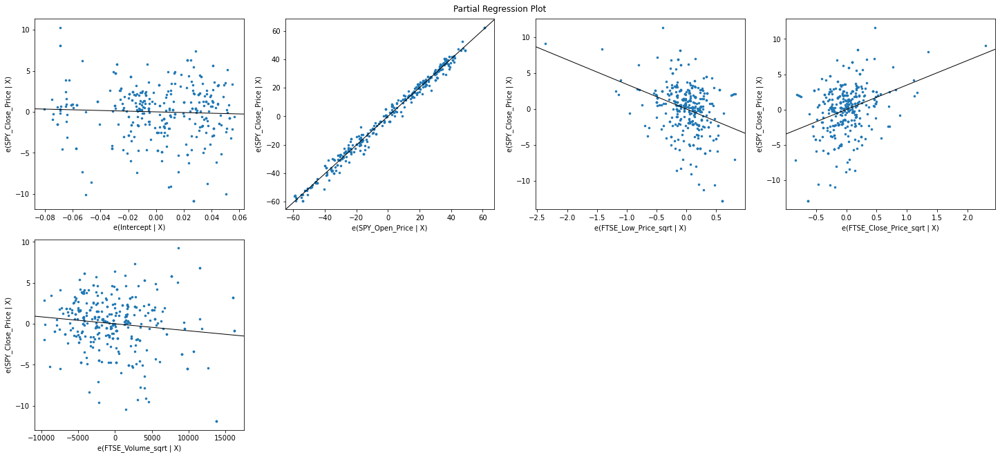


Normal fit using reproducible random 80% (x_train & y_train) of data rows:

    Mean Absolute Residual = 2.437777470045315
Root Mean Squared Residual = 3.2637168743878178
                        R² = 0.9933669533575931

Normal prediction using remaining 20% (x_test & y_test) of data rows:

    Mean Absolute Error = 2.278512896432442
Root Mean Squared Error = 3.282785931543249
                     R² = 0.9922985759558204

Plots of train-set fit & test-set predict:


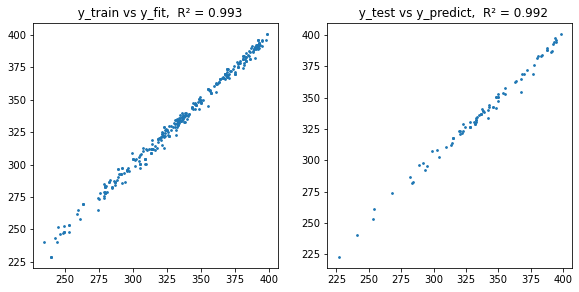


 
 
 
 
 
========================================================== Next GLM Model ==============================================================

 
 
 
 
 
counter =  2
GLM Model Fitted =  Poisson
1 entered.

Assuming Poisson error distribution.

X pairs with correlations > 0.995 :
(no more)

X pairs with correlations > 0.995 :
US_Covid_Cases_sqar , cumAdmissions_sqar
SPY_Open_Price_sqrt , SPY_Open_Price

2 variables considered for deletion:
US_Covid_Cases_sqar
SPY_Open_Price_sqrt

X pairs with correlations > 0.995 :
SPY_Open_Price_sqar , SPY_Open_Price

1 variables considered for deletion:
SPY_Open_Price_sqar

X pairs with correlations > 0.995 :
(no more)

3 transformed variables deleted.

Fit using reproducible random 80% (x_train & y_train) of data rows:

OLS fit including only 18 untransformed Xs:
                             Results: Ordinary least squares
Model:                      OLS                      Adj. R-squared:             0.994    
Dependent Variable:         SPY_


Adjusted R² = 0.9825253297036338 , max(X p-value) = 0.46379931979762645 , rank deficiency = 1 , for 17 Xs.
Variable to drop: FTSE_Low_Price

Adjusted R² = 0.9821602151850062 , max(X p-value) = 0.33856218846538777 , rank deficiency = 1 , for 16 Xs.
Variable to drop: FTSE_Open_Price

Adjusted R² = 0.9818126125393816 , max(X p-value) = 0.06291141778970835 , rank deficiency = 1 , for 15 Xs.
Variable to drop: Unnamed__0_sqrt

Adjusted R² = 0.9798595546818034 , max(X p-value) = 0.0926956227464959 , rank deficiency = 1 , for 14 Xs.
Variable to drop: FTSE_Close_Price_sqar

Adjusted R² = 0.979648522140971 , max(X p-value) = 0.9319497473919178 , rank deficiency = 1 , for 13 Xs.
Variable to drop: FTSE_Close_Price

Adjusted R² = 0.9796413153064171 , max(X p-value) = 0.004764051906131865 , rank deficiency = 0 , for 12 Xs.
Variable to drop: cumDailyNsoDeathsByDeathDate_sqar

Adjusted R² = 0.9752992862734469 , max(X p-value) = 0.13108018749321337 , rank deficiency = 0 , for 11 Xs.
Variable to drop: 

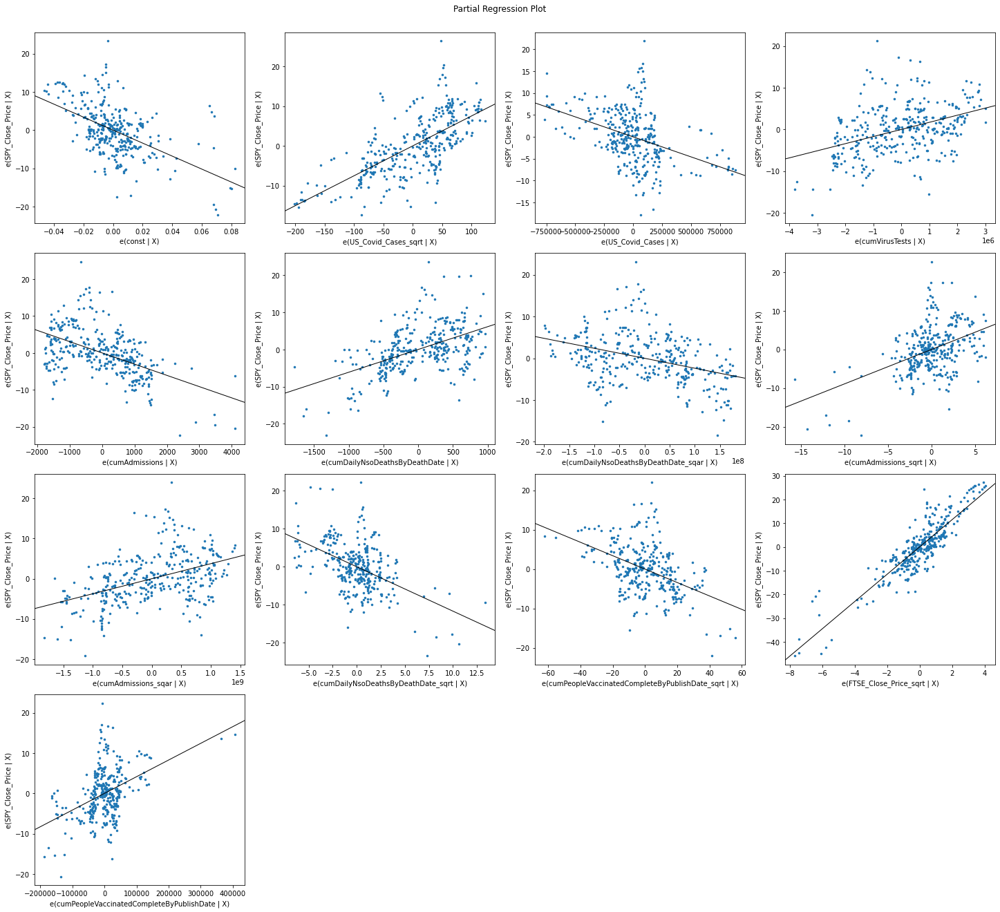


Poisson fit using reproducible random 80% (x_train & y_train) of data rows:

    Mean Absolute Residual = 4.2709955736092295
Root Mean Squared Residual = 5.619089179801603
                        R² = 0.9803393273530542

Poisson prediction using remaining 20% (x_test & y_test) of data rows:

    Mean Absolute Error = 4.5821337762598064
Root Mean Squared Error = 6.019701414661133
                     R² = 0.972949613814438

Plots of train-set fit & test-set predict:


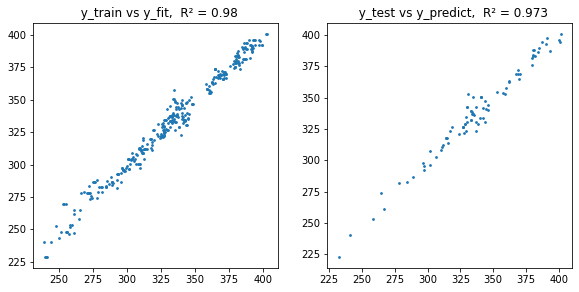


 
 
 
 
 
========================================================== Next GLM Model ==============================================================

 
 
 
 
 
counter =  3
GLM Model Fitted =  Logit
1 entered.

Assuming Logit error distribution.

X pairs with correlations > 0.995 :
(no more)

X pairs with correlations > 0.995 :
US_Covid_Cases_sqar , cumAdmissions_sqar
SPY_Open_Price_sqrt , SPY_Open_Price

2 variables considered for deletion:
US_Covid_Cases_sqar
SPY_Open_Price_sqrt

X pairs with correlations > 0.995 :
SPY_Open_Price_sqar , SPY_Open_Price

1 variables considered for deletion:
SPY_Open_Price_sqar

X pairs with correlations > 0.995 :
(no more)

3 transformed variables deleted.

Fit using reproducible random 80% (x_train & y_train) of data rows:

OLS fit including only 18 untransformed Xs:
                             Results: Ordinary least squares
Model:                      OLS                      Adj. R-squared:             0.994    
Dependent Variable:         SPY_Clos


Adjusted R² = -inf , max(X p-value) = 0.0 , rank deficiency = 1 , for 16 Xs.
Variable to drop: cumCasesByPublishDate

Adjusted R² = -inf , max(X p-value) = 0.0 , rank deficiency = 1 , for 15 Xs.
Variable to drop: FTSE_Low_Price_sqar

Adjusted R² = -inf , max(X p-value) = 0.0 , rank deficiency = 0 , for 14 Xs.
Variable to drop: Unnamed__0

Adjusted R² = -inf , max(X p-value) = 0.0 , rank deficiency = 0 , for 13 Xs.
Variable to drop: cumAdmissions_sqar

Adjusted R² = -inf , max(X p-value) = 0.0 , rank deficiency = 0 , for 12 Xs.
Variable to drop: cumAdmissions

Adjusted R² = -inf , max(X p-value) = 0.0 , rank deficiency = 0 , for 11 Xs.
Variable to drop: Unnamed__0_sqrt

Adjusted R² = -inf , max(X p-value) = 0.0 , rank deficiency = 0 , for 10 Xs.
Variable to drop: cumAdmissions_sqrt

Adjusted R² = -inf , max(X p-value) = 0.0 , rank deficiency = 0 , for 9 Xs.
Variable to drop: cumDailyNsoDeathsByDeathDate

Adjusted R² = -inf , max(X p-value) = 0.0 , rank deficiency = 0 , for 8 Xs.
Variab

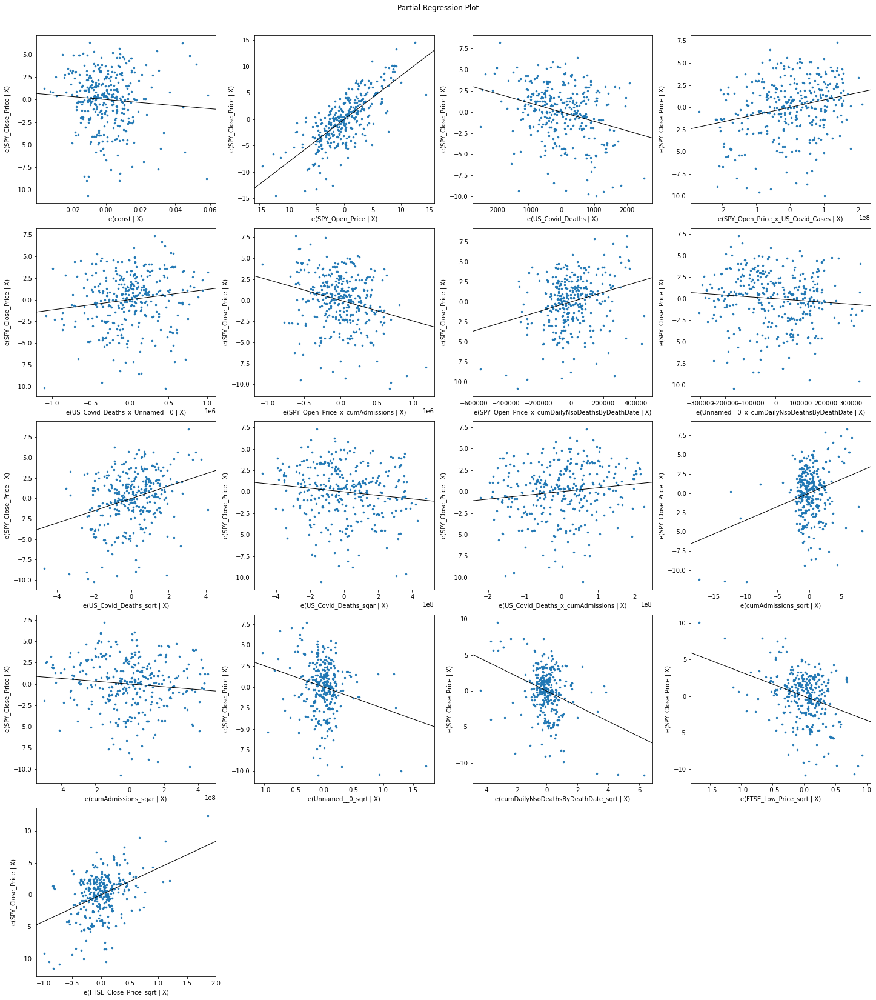


Logit fit using reproducible random 80% (x_train & y_train) of data rows:

    Mean Absolute Residual = 332.78726633903125
Root Mean Squared Residual = 335.19134870903906
                        R² = nan

Logit prediction using remaining 20% (x_test & y_test) of data rows:

    Mean Absolute Error = 336.8010238522727
Root Mean Squared Error = 338.73646660574445
                     R² = nan

Plots of train-set fit & test-set predict:


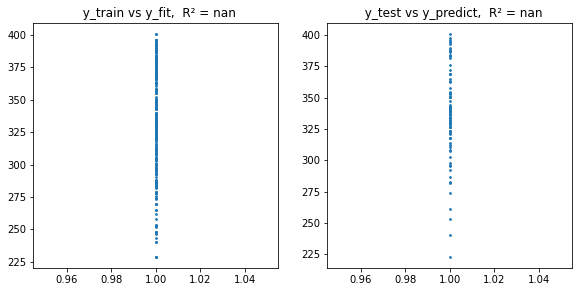


 
 
 
 
 
========================================================== Next GLM Model ==============================================================

 
 
 
 
 
counter =  4
GLM Model Fitted =  Probit
1 entered.

Assuming Probit error distribution.

X pairs with correlations > 0.995 :
(no more)

X pairs with correlations > 0.995 :
US_Covid_Cases_sqar , cumAdmissions_sqar
SPY_Open_Price_sqrt , SPY_Open_Price

2 variables considered for deletion:
US_Covid_Cases_sqar
SPY_Open_Price_sqrt

X pairs with correlations > 0.995 :
SPY_Open_Price_sqar , SPY_Open_Price

1 variables considered for deletion:
SPY_Open_Price_sqar

X pairs with correlations > 0.995 :
(no more)

3 transformed variables deleted.

Fit using reproducible random 80% (x_train & y_train) of data rows:

OLS fit including only 18 untransformed Xs:
                             Results: Ordinary least squares
Model:                      OLS                      Adj. R-squared:             0.994    
Dependent Variable:         SPY_Cl


Adjusted R² = -inf , max(X p-value) = 0.0 , rank deficiency = 6 , for 11 Xs.
Variable to drop: cumCasesByPublishDate_sqrt

Adjusted R² = -inf , max(X p-value) = 0.0 , rank deficiency = 5 , for 10 Xs.
Variable to drop: FTSE_High_Price_sqar

Adjusted R² = -inf , max(X p-value) = 0.0 , rank deficiency = 4 , for 9 Xs.
Variable to drop: FTSE_Volume_sqrt

Adjusted R² = -inf , max(X p-value) = 0.0 , rank deficiency = 4 , for 8 Xs.
Variable to drop: cumAdmissions

Adjusted R² = -inf , max(X p-value) = 0.0 , rank deficiency = 4 , for 7 Xs.
Variable to drop: cumCasesByPublishDate

Adjusted R² = -inf , max(X p-value) = 0.0 , rank deficiency = 4 , for 6 Xs.
Variable to drop: cumVirusTests_sqar

Adjusted R² = -inf , max(X p-value) = 0.0 , rank deficiency = 0 , for 5 Xs.
Variable to drop: Max_Temperature_DegC

Adjusted R² = -inf , max(X p-value) = 0.0 , rank deficiency = 0 , for 4 Xs.
Variable to drop: Sun_Hours_sqrt

Adjusted R² = -inf , max(X p-value) = 0.0 , rank deficiency = 0 , for 3 Xs.
Varia

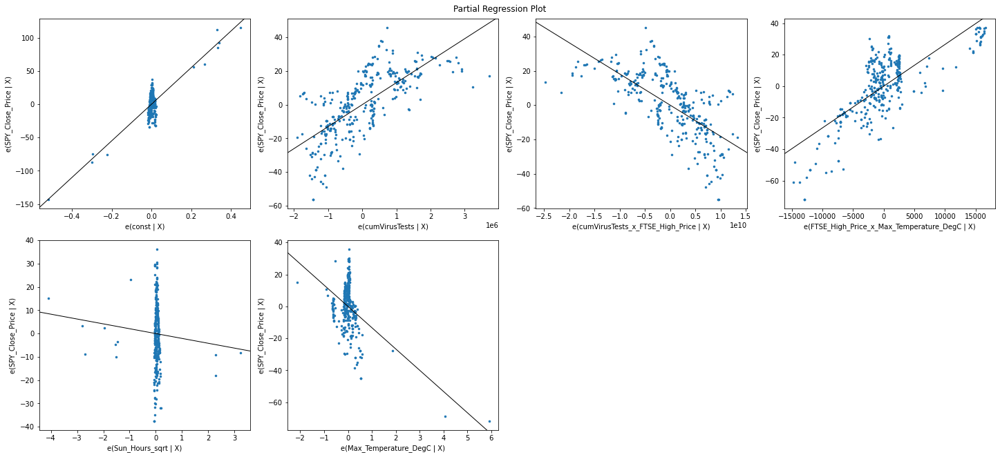


Probit fit using reproducible random 80% (x_train & y_train) of data rows:

    Mean Absolute Residual = 332.78726633903125
Root Mean Squared Residual = 335.19134870903906
                        R² = nan

Probit prediction using remaining 20% (x_test & y_test) of data rows:

    Mean Absolute Error = 336.8010238522727
Root Mean Squared Error = 338.73646660574445
                     R² = nan

Plots of train-set fit & test-set predict:


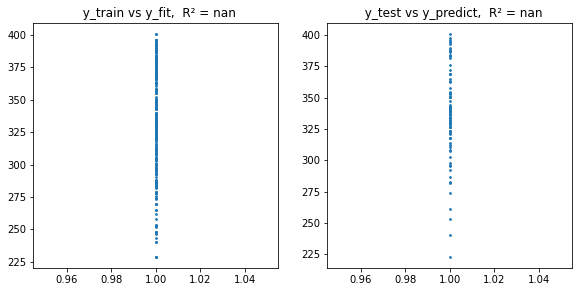


 
 
 
 
 
========================================================== Next GLM Model ==============================================================

 
 
 
 
 
counter =  5
GLM Model Fitted =  Gamma
1 entered.

Assuming Gamma error distribution.

X pairs with correlations > 0.995 :
(no more)

X pairs with correlations > 0.995 :
US_Covid_Cases_sqar , cumAdmissions_sqar
SPY_Open_Price_sqrt , SPY_Open_Price

2 variables considered for deletion:
US_Covid_Cases_sqar
SPY_Open_Price_sqrt

X pairs with correlations > 0.995 :
SPY_Open_Price_sqar , SPY_Open_Price

1 variables considered for deletion:
SPY_Open_Price_sqar

X pairs with correlations > 0.995 :
(no more)

3 transformed variables deleted.

Fit using reproducible random 80% (x_train & y_train) of data rows:

OLS fit including only 18 untransformed Xs:
                             Results: Ordinary least squares
Model:                      OLS                      Adj. R-squared:             0.994    
Dependent Variable:         SPY_Clos


Adjusted R² = 0.9808098226475256 , max(X p-value) = 0.31663913633790863 , rank deficiency = 17 , for 28 Xs.
Variable to drop: FTSE_Low_Price

Adjusted R² = 0.9807059617680441 , max(X p-value) = 0.10575555372038138 , rank deficiency = 17 , for 27 Xs.
Variable to drop: cumAdmissions_sqrt

Adjusted R² = 0.9803087092740599 , max(X p-value) = 0.05203334963436798 , rank deficiency = 16 , for 26 Xs.
Variable to drop: FTSE_Close_Price

Adjusted R² = 0.9809908674538582 , max(X p-value) = 0.01850669614315132 , rank deficiency = 15 , for 25 Xs.
Variable to drop: cumPeopleVaccinatedCompleteByPublishDate

Adjusted R² = 0.9810075260525963 , max(X p-value) = 0.30600034082255256 , rank deficiency = 15 , for 24 Xs.
Variable to drop: cumAdmissions

Adjusted R² = 0.9822890953445761 , max(X p-value) = 0.7868907950700005 , rank deficiency = 15 , for 23 Xs.
Variable to drop: FTSE_High_Price_sqrt

Adjusted R² = 0.9825428346450511 , max(X p-value) = 0.6814075557028385 , rank deficiency = 14 , for 22 Xs.
Vari

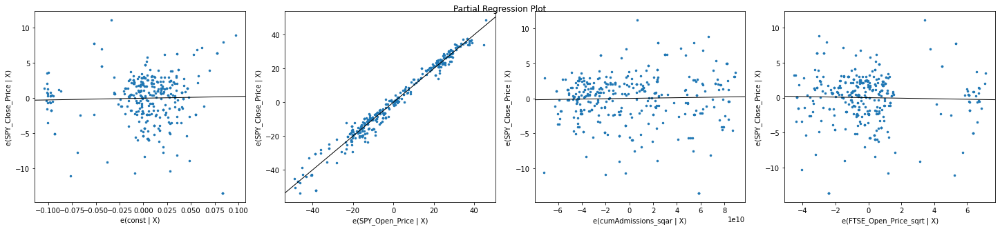


Gamma fit using reproducible random 80% (x_train & y_train) of data rows:

    Mean Absolute Residual = 3.5313688027259356
Root Mean Squared Residual = 4.676660400588652
                        R² = 0.9864201092967394

Gamma prediction using remaining 20% (x_test & y_test) of data rows:

    Mean Absolute Error = 4.0059024059427735
Root Mean Squared Error = 5.233511402040004
                     R² = 0.9801846278903824

Plots of train-set fit & test-set predict:


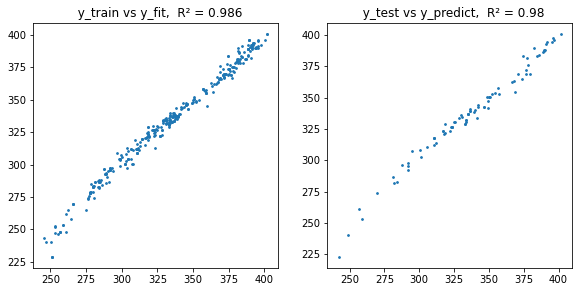


 
 
 
 
 
========================================================== Next GLM Model ==============================================================

 
 
 
 
 
counter =  6
GLM Model Fitted =  InverseGaussian
1 entered.

Assuming InverseGaussian error distribution.

X pairs with correlations > 0.995 :
(no more)

X pairs with correlations > 0.995 :
US_Covid_Cases_sqar , cumAdmissions_sqar
SPY_Open_Price_sqrt , SPY_Open_Price

2 variables considered for deletion:
US_Covid_Cases_sqar
SPY_Open_Price_sqrt

X pairs with correlations > 0.995 :
SPY_Open_Price_sqar , SPY_Open_Price

1 variables considered for deletion:
SPY_Open_Price_sqar

X pairs with correlations > 0.995 :
(no more)

3 transformed variables deleted.

Fit using reproducible random 80% (x_train & y_train) of data rows:

OLS fit including only 18 untransformed Xs:
                             Results: Ordinary least squares
Model:                      OLS                      Adj. R-squared:             0.994    
Dependent Variab


Adjusted R² = 0.9637639305806475 , max(X p-value) = 0.18276031615064936 , rank deficiency = 14 , for 24 Xs.
Variable to drop: FTSE_Open_Price

Adjusted R² = 0.9637596057315688 , max(X p-value) = 0.015666054083568647 , rank deficiency = 13 , for 23 Xs.
Variable to drop: Max_Temperature_DegC

Adjusted R² = 0.9637598558690957 , max(X p-value) = 0.00965337666659057 , rank deficiency = 12 , for 22 Xs.
Variable to drop: FTSE_Close_Price

Adjusted R² = 0.9632839547247531 , max(X p-value) = 0.01565071185329206 , rank deficiency = 11 , for 21 Xs.
Variable to drop: US_Covid_Deaths

Adjusted R² = 0.9616711380923312 , max(X p-value) = 0.4617674097985578 , rank deficiency = 11 , for 20 Xs.
Variable to drop: Rainfall_mm_sqrt

Adjusted R² = 0.9616710026139755 , max(X p-value) = 0.30037564577409637 , rank deficiency = 10 , for 19 Xs.
Variable to drop: Max_Temperature_DegC_sqrt

Adjusted R² = 0.9616710012993169 , max(X p-value) = 0.030509818821458885 , rank deficiency = 9 , for 18 Xs.
Variable to drop

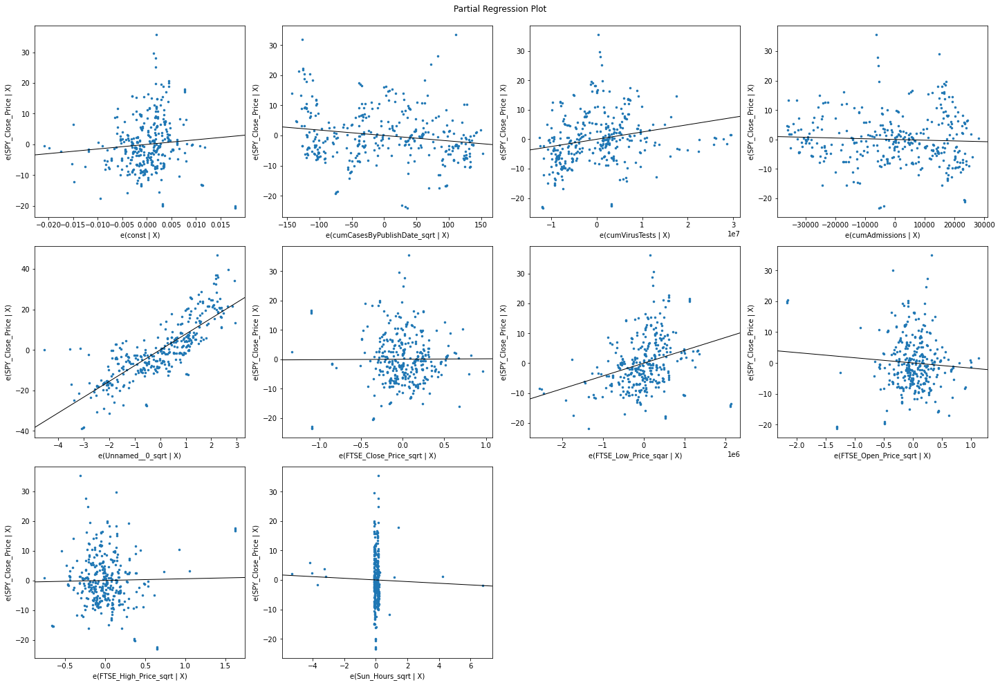


InverseGaussian fit using reproducible random 80% (x_train & y_train) of data rows:

    Mean Absolute Residual = 8.169597701299095
Root Mean Squared Residual = 10.631463358061604
                        R² = 0.9299605783060463

InverseGaussian prediction using remaining 20% (x_test & y_test) of data rows:

    Mean Absolute Error = 9.412586038800576
Root Mean Squared Error = 12.100419968372714
                     R² = 0.8969264877456589

Plots of train-set fit & test-set predict:


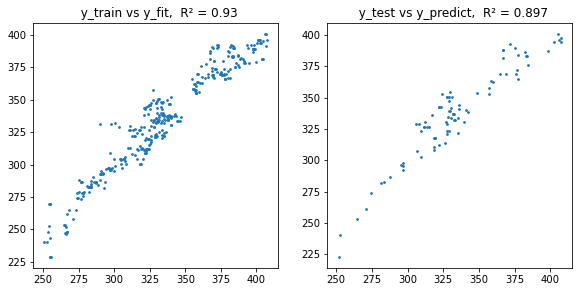


 
 
 
 
 
========================================================== Next GLM Model ==============================================================

 
 
 
 
 
counter =  7
GLM Model Fitted =  NegativeBinomial
1 entered.

Assuming NegativeBinomial error distribution.

X pairs with correlations > 0.995 :
(no more)

X pairs with correlations > 0.995 :
US_Covid_Cases_sqar , cumAdmissions_sqar
SPY_Open_Price_sqrt , SPY_Open_Price

2 variables considered for deletion:
US_Covid_Cases_sqar
SPY_Open_Price_sqrt

X pairs with correlations > 0.995 :
SPY_Open_Price_sqar , SPY_Open_Price

1 variables considered for deletion:
SPY_Open_Price_sqar

X pairs with correlations > 0.995 :
(no more)

3 transformed variables deleted.

Fit using reproducible random 80% (x_train & y_train) of data rows:

OLS fit including only 18 untransformed Xs:
                             Results: Ordinary least squares
Model:                      OLS                      Adj. R-squared:             0.994    
Dependent Vari

Adjusted R² = 0.9757514736577624 , max(X p-value) = 0.9684389832323271 , rank deficiency = 1 , for 13 Xs.
Variable to drop: Min_Temperature_DegC

Adjusted R² = 0.9755543674409409 , max(X p-value) = 0.9588921423126838 , rank deficiency = 1 , for 12 Xs.
Variable to drop: FTSE_High_Price

Adjusted R² = 0.9755351857664977 , max(X p-value) = 0.9685492806999143 , rank deficiency = 1 , for 11 Xs.
Variable to drop: FTSE_Open_Price_sqrt

Adjusted R² = 0.9752872967710653 , max(X p-value) = 0.9647552463670731 , rank deficiency = 1 , for 10 Xs.
Variable to drop: FTSE_Low_Price_sqar

Adjusted R² = 0.9748501389293323 , max(X p-value) = 0.9616272010893153 , rank deficiency = 1 , for 9 Xs.
Variable to drop: FTSE_Close_Price

Adjusted R² = 0.9746231689951188 , max(X p-value) = 0.9226021263361994 , rank deficiency = 0 , for 8 Xs.
Variable to drop: Unnamed__0

Adjusted R² = 0.973234550814783 , max(X p-value) = 0.933743877637395 , rank deficiency = 0 , for 7 Xs.
Variable to drop: Unnamed__0_sqar

Adjusted

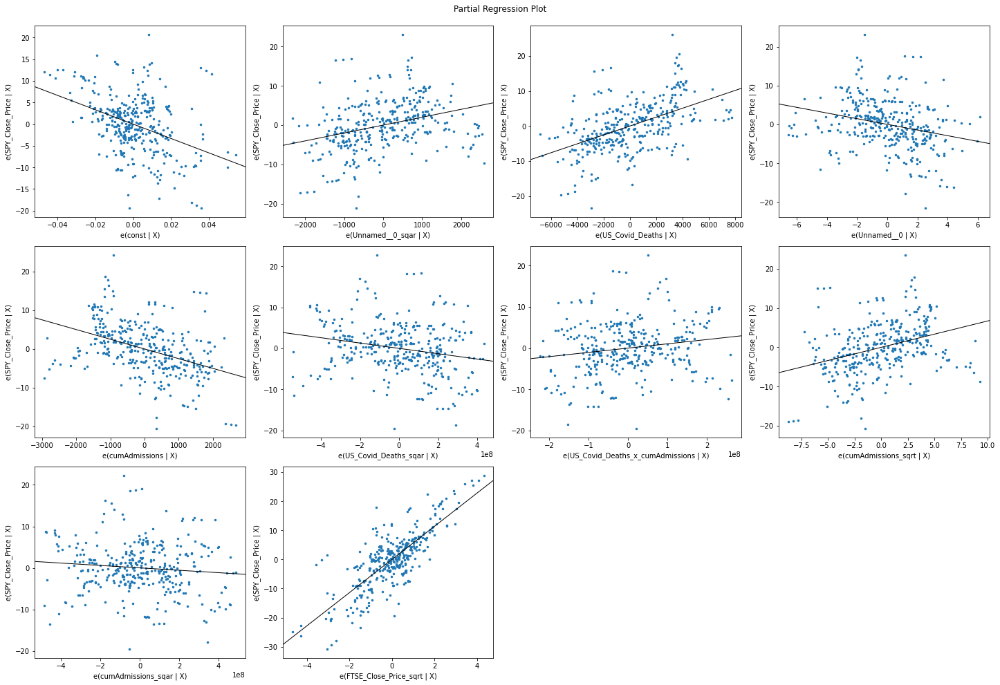


NegativeBinomial fit using reproducible random 80% (x_train & y_train) of data rows:

    Mean Absolute Residual = 4.633597811653204
Root Mean Squared Residual = 6.162924235322751
                        R² = 0.9763540821149091

NegativeBinomial prediction using remaining 20% (x_test & y_test) of data rows:

    Mean Absolute Error = 4.92380417012546
Root Mean Squared Error = 6.339034050842144
                     R² = 0.9700938531436452

Plots of train-set fit & test-set predict:


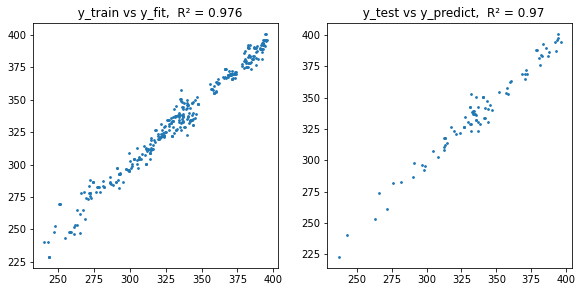


 
 
 
 
 
========================================================== Next GLM Model ==============================================================

 
 
 
 
 
counter =  8
GLM Model Fitted =  Tweedie
1 entered.

Assuming Tweedie error distribution.

X pairs with correlations > 0.995 :
(no more)

X pairs with correlations > 0.995 :
US_Covid_Cases_sqar , cumAdmissions_sqar
SPY_Open_Price_sqrt , SPY_Open_Price

2 variables considered for deletion:
US_Covid_Cases_sqar
SPY_Open_Price_sqrt

X pairs with correlations > 0.995 :
SPY_Open_Price_sqar , SPY_Open_Price

1 variables considered for deletion:
SPY_Open_Price_sqar

X pairs with correlations > 0.995 :
(no more)

3 transformed variables deleted.

Fit using reproducible random 80% (x_train & y_train) of data rows:

OLS fit including only 18 untransformed Xs:
                             Results: Ordinary least squares
Model:                      OLS                      Adj. R-squared:             0.994    
Dependent Variable:         SPY_


Adjusted R² = 0.979611991207814 , max(X p-value) = 0.9976340301154789 , rank deficiency = 9 , for 25 Xs.
Variable to drop: FTSE_High_Price_sqar

Adjusted R² = 0.9797473308925067 , max(X p-value) = 0.9188655981308715 , rank deficiency = 9 , for 24 Xs.
Variable to drop: Max_Temperature_DegC

Adjusted R² = 0.979746789741994 , max(X p-value) = 0.8420767651177772 , rank deficiency = 8 , for 23 Xs.
Variable to drop: FTSE_Close_Price_sqar

Adjusted R² = 0.9797459276627567 , max(X p-value) = 0.8234145262640392 , rank deficiency = 7 , for 22 Xs.
Variable to drop: Max_Temperature_DegC_sqrt

Adjusted R² = 0.9797397232492825 , max(X p-value) = 0.4367566441080295 , rank deficiency = 6 , for 21 Xs.
Variable to drop: Min_Temperature_DegC_sqrt

Adjusted R² = 0.9796952183485478 , max(X p-value) = 0.36403110713713693 , rank deficiency = 5 , for 20 Xs.
Variable to drop: FTSE_High_Price

Adjusted R² = 0.9796924259748909 , max(X p-value) = 0.3231163902357249 , rank deficiency = 5 , for 19 Xs.
Variable to 

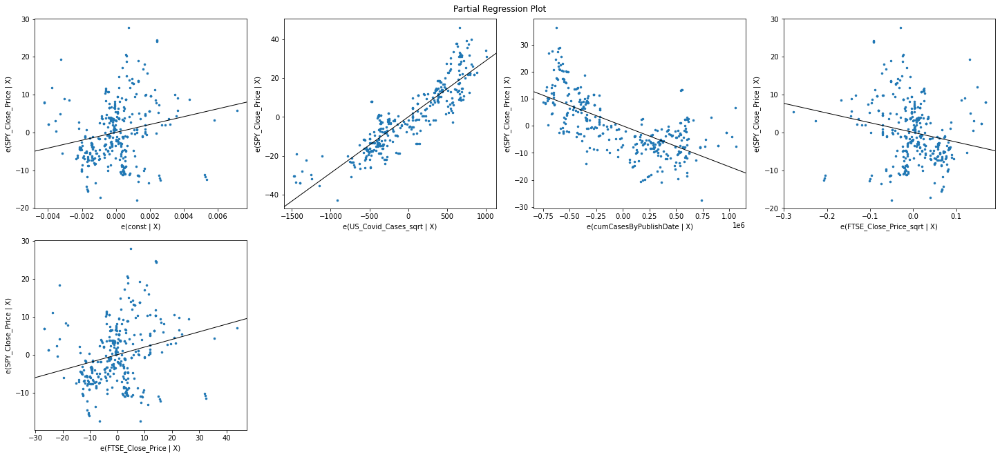


Tweedie fit using reproducible random 80% (x_train & y_train) of data rows:

    Mean Absolute Residual = 6.522954856507443
Root Mean Squared Residual = 8.425833338411111
                        R² = 0.955808583741463

Tweedie prediction using remaining 20% (x_test & y_test) of data rows:

    Mean Absolute Error = 6.772154464555934
Root Mean Squared Error = 8.798627262724867
                     R² = 0.9454408645798134

Plots of train-set fit & test-set predict:


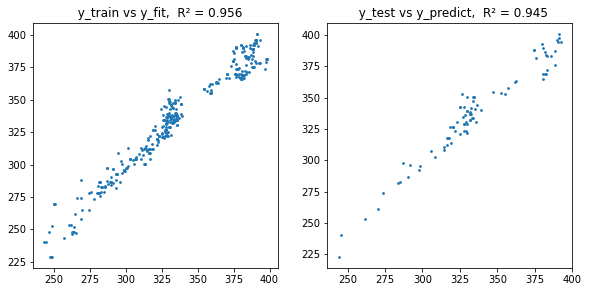


 
 
 
 
 
========================================================== Next GLM Model ==============================================================

 
 
 
 
 
counter =  9
GLM Model Fitted =  GLM Gaussian
1 entered.

Assuming GLM Gaussian error distribution.

X pairs with correlations > 0.995 :
(no more)

X pairs with correlations > 0.995 :
US_Covid_Cases_sqar , cumAdmissions_sqar
SPY_Open_Price_sqrt , SPY_Open_Price

2 variables considered for deletion:
US_Covid_Cases_sqar
SPY_Open_Price_sqrt

X pairs with correlations > 0.995 :
SPY_Open_Price_sqar , SPY_Open_Price

1 variables considered for deletion:
SPY_Open_Price_sqar

X pairs with correlations > 0.995 :
(no more)

3 transformed variables deleted.

Fit using reproducible random 80% (x_train & y_train) of data rows:

OLS fit including only 18 untransformed Xs:
                             Results: Ordinary least squares
Model:                      OLS                      Adj. R-squared:             0.994    
Dependent Variable:   


Adjusted R² = 0.9931351192617246 , max(X p-value) = 0.017808503553657953 , rank deficiency = 12 , for 15 Xs.
Variable to drop: cumVirusTests_sqar

Adjusted R² = 0.9933930706265588 , max(X p-value) = 0.5280589901321804 , rank deficiency = 0 , for 14 Xs.
Variable to drop: Sun_Hours_sqrt

Adjusted R² = 0.9934048704581153 , max(X p-value) = 0.584014354377572 , rank deficiency = 0 , for 13 Xs.
Variable to drop: Max_Temperature_DegC

Adjusted R² = 0.9934185331158425 , max(X p-value) = 0.519942519831301 , rank deficiency = 0 , for 12 Xs.
Variable to drop: Min_Temperature_DegC_sqrt

Adjusted R² = 0.9934299097865403 , max(X p-value) = 0.7238897359216616 , rank deficiency = 0 , for 11 Xs.
Variable to drop: Rainfall_mm_sqrt

Adjusted R² = 0.99344682204506 , max(X p-value) = 0.12493991924784437 , rank deficiency = 0 , for 10 Xs.
Variable to drop: FTSE_Low_Price

Adjusted R² = 0.9934207962140935 , max(X p-value) = 0.13026897053812833 , rank deficiency = 0 , for 9 Xs.
Variable to drop: FTSE_High_Pr

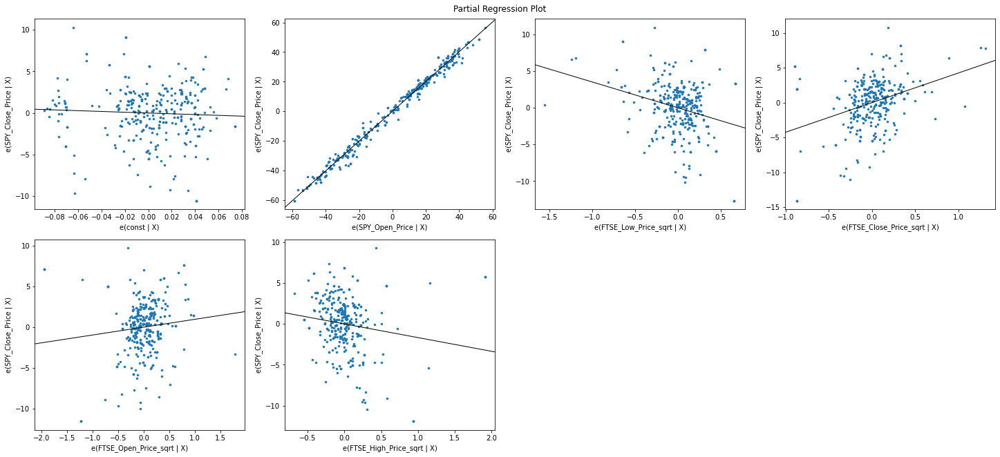


GLM Gaussian fit using reproducible random 80% (x_train & y_train) of data rows:

    Mean Absolute Residual = 2.428283384639719
Root Mean Squared Residual = 3.2526846704549124
                        R² = 0.9934117203807767

GLM Gaussian prediction using remaining 20% (x_test & y_test) of data rows:

    Mean Absolute Error = 2.2863983563103485
Root Mean Squared Error = 3.156815927725248
                     R² = 0.9927266968583087

Plots of train-set fit & test-set predict:


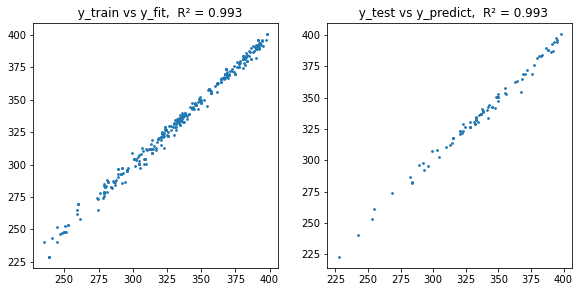


 
 
 
 
 
========================================================== Next GLM Model ==============================================================

 
 
 
 
 
counter =  10
GLM Model Fitted =  Normal
1 entered.

Assuming Normal error distribution.

X pairs with correlations > 0.995 :
(no more)

X pairs with correlations > 0.995 :
US_Covid_Cases_sqar , cumAdmissions_sqar
SPY_Open_Price_sqrt , SPY_Open_Price

2 variables considered for deletion:
US_Covid_Cases_sqar
SPY_Open_Price_sqrt

X pairs with correlations > 0.995 :
SPY_Open_Price_sqar , SPY_Open_Price

1 variables considered for deletion:
SPY_Open_Price_sqar

X pairs with correlations > 0.995 :
(no more)

3 transformed variables deleted.

Fit using reproducible random 80% (x_train & y_train) of data rows:

OLS fit including only 18 untransformed Xs:
                             Results: Ordinary least squares
Model:                      OLS                      Adj. R-squared:             0.994    
Dependent Variable:         SPY_C


Adjusted R² = 0.9932330127081226 , max(X p-value) = 0.9741794189239255 , rank deficiency = 17 , for 28 Xs.
Variable to drop: Min_Temperature_DegC_sqar

Adjusted R² = 0.9924005797407535 , max(X p-value) = 0.7460978702217127 , rank deficiency = 16 , for 27 Xs.
Variable to drop: Unnamed__0_sqar

Adjusted R² = 0.993329535996961 , max(X p-value) = 0.6035926731095812 , rank deficiency = 16 , for 26 Xs.
Variable to drop: FTSE_Open_Price

Adjusted R² = 0.9933387650872868 , max(X p-value) = 0.14398956469623952 , rank deficiency = 16 , for 25 Xs.
Variable to drop: FTSE_High_Price_sqar

Adjusted R² = 0.9934605156544192 , max(X p-value) = 0.3820228006915348 , rank deficiency = 16 , for 24 Xs.
Variable to drop: cumCasesByPublishDate_sqrt

Adjusted R² = 0.9929343040310185 , max(X p-value) = 0.6648212615623568 , rank deficiency = 16 , for 23 Xs.
Variable to drop: cumDailyNsoDeathsByDeathDate_sqrt

Adjusted R² = 0.9934190055744618 , max(X p-value) = 0.6902162438139163 , rank deficiency = 15 , for 22 

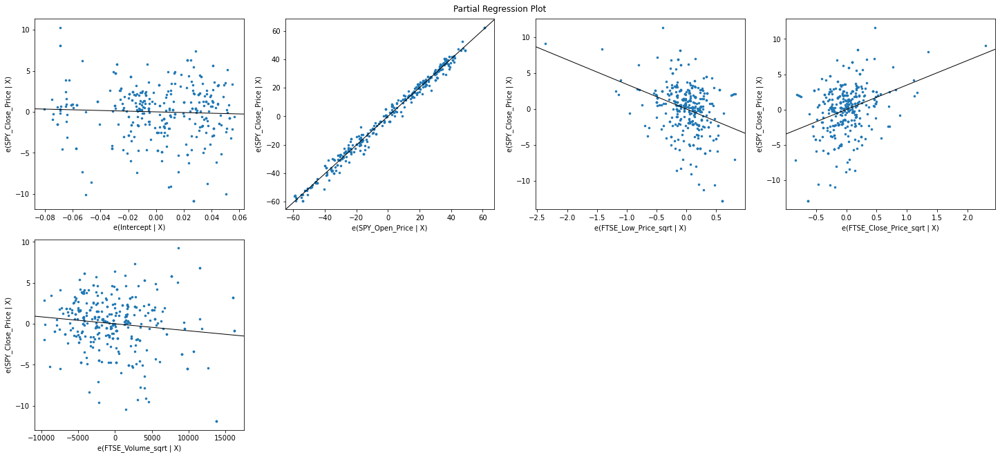


Normal fit using reproducible random 80% (x_train & y_train) of data rows:

    Mean Absolute Residual = 2.437777470045315
Root Mean Squared Residual = 3.2637168743878178
                        R² = 0.9933669533575931

Normal prediction using remaining 20% (x_test & y_test) of data rows:

    Mean Absolute Error = 2.278512896432442
Root Mean Squared Error = 3.282785931543249
                     R² = 0.9922985759558204

Plots of train-set fit & test-set predict:


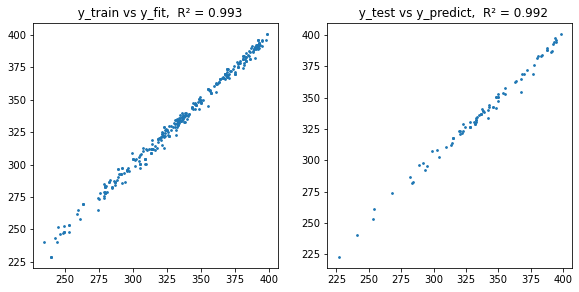

In [27]:
## Generalized Linear Model (GLM) with transformed variables & interaction variables (collinearity issue considered)

#For comparing Normal & GLM error distributions.

#algorithm is inefficient but clearer for instructional purposes
#favors fit with Xs' p-values < 0.05, and smaller rank-deficiency (number_of_Xs - Df_Model)

import warnings
warnings.filterwarnings('ignore')

import statsmodels.api as sm
import pandas as pd

#set maximum window width
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>")) #change code window width to max
pd.options.display.max_columns = 0 #change output window width to max

counter = 1

#Iterate through 0 to 10, iterate through the GLM models
for i in range(0,10):  
    
    print("\n \n \n \n \n ")
    print("========================================================== Next GLM Model ==============================================================")
    print("\n \n \n \n \n ")
    print("counter = ",counter)
    
    m2 = str(counter)
    counter += 1  
    
    # 1 out of the 2 following lines should be active:
    # d = '' #means nanes96 will be used
    d = 1 #means use specified dataset instead of the default nanes96: d=''

    if d == '':
        pass
    else:
        #d = 1 case:
        
        #Use cleaned_data
        dt = df_clean.copy() #specifying 1st column as row labels (called 'index')
        #handle special variabes

        yname = 'SPY_Close_Price' #target variable FTSE CLose Price

        import regex as re
        dt.rename(columns=lambda x: re.sub('\W', '_', x), inplace=True) #replace ' ' by '_' in variable names
        yname = re.sub('\W', '_', yname)

        #delete any row with any missing value
        dt.dropna(how='any', inplace=True)
        if yname != dt.columns[0]:
            dt = dt[[yname] + list(dt.columns.drop(yname))]

        #m2 = input('1: OLS (default), 2: Poisson, 3: Logit, 4: Probit, 5: Gamma, 6: InverseGaussian, 7: NegativeBinomial,' +
                   #' 8: Tweedie, 9: Gaussian? ').strip()
        if m2 == '2':
            #https://www.statsmodels.org/stable/glm.html
            m = 'Poisson'
            dist = sm.families.Poisson()
        elif m2 == '3':
            m = 'Logit'
            dist = sm.families.Binomial()
        elif m2 == '4':
            m = 'Probit'
            #http://web.pdx.edu/~crkl/ceR/Python/example8_1.py
            dist = sm.families.Binomial(sm.genmod.families.links.probit)
        elif m2 == '5':
            m = 'Gamma'
            dist = sm.families.Gamma()
        elif m2 == '6':
            m = 'InverseGaussian'
            dist = sm.families.InverseGaussian()
        elif m2 == '7':
            m = 'NegativeBinomial'
            dist = sm.families.NegativeBinomial()
        elif m2 == '8':
            m = 'Tweedie'
            dist = sm.families.Tweedie()
        elif m2 == '9':
            m = 'GLM Gaussian'
            dist = sm.families.Gaussian()
        else:
            # m2 == 1 or ''
            m = 'Normal'
            
        print('GLM Model Fitted = ',m)

    ytype = type('a')
    if m == 'Normal':
        #there is a version of OLS that also requires endog and exog like GLM:
        #http://statsmodels.org/dev/generated/statsmodels.regression.linear_model.OLS.html
        #df has y followed by Xs:
        if d == '':
            df = pd.concat([dt.endog, dt.exog], axis=1) #a DataFrame
        else:
            df = dt
        y = yname
    else:
        #df will not have y, but a column of 1s:
        if d == '':
            df = sm.add_constant(dt.exog) #add column of 1 to the left of dt.exog to form DataFrame
            y = dt.endog #PID: 0 to 6: Party IDentification of respondent (shades of Democrat or Republican)
        else:
            df = sm.add_constant(dt.iloc[:, 1:])
            y = dt.iloc[:, 0]
        ytype = type(y)

    #m3 = input('1: Reproducible output (input any integer except 2), 2: Random train-test data split [default: 1]? ').strip()
    m3 = 1
    if m3 != '2':
        try:
            if m3 == '':
                m3 = 1
            else:
                m3 = int(m3)
            print(m3, 'entered.')
        except:
            m3 = 1 #can be changed to any integer for reproducible randomization
            print(m3, 'assumed.')

    print('\nAssuming', m, 'error distribution.')

    def delcorr(df):
        #delete any x too highly correlated with another x, to avoid collinearity

        #corr(Xs, y) ranked:

    #     corv = pd.DataFrame() #start empty dataframe for corr(Xs, y) to come
    #     for x in list(df)[1:]:
    #         #during 1st time thru loop: new column, with label, created in empty dataframe:
    #         #during subsequent time thru loop: new row, with row label, added to dataframe:
    #         corv.loc[x, yname] = df[x].corr(df[yname] if m == 'Normal' else y)

    #     corv = corv.loc[abs(corv).sort_values([yname]).index, :] #corr(Xs, y) ranked

        corv = df.iloc[:, 1:].corrwith(df[yname] if m == 'Normal' else y).rename(yname).sort_values(key=abs).to_frame()

        delta = 0.005 #corr difference lower limit
        dl2 = []
        icorr = True
        while icorr:
            a = abs(corv).diff() <= delta #adjacent rows with similar abs(corr(Xs, y))
            colname = list(df)[1:]
            dl = []
            print('\nX pairs with correlations >', 1 - delta, ':')
            for b in range(1, a.shape[0]):
                if a.iloc[b, 0]:
                    if abs(df[a.index[b - 1]].corr(df[a.index[b]])) > 1 - delta:
                        #deleting 1 X from correlated pair:
                        dv0 = a.index[b - 1]
                        dv1 = a.index[b]

                        #neither should already be deleted:
                        if not (dv0 in dl) and not (dv1 in dl):
                            #delete x with rather lower corr(x, y):
                            if abs(corv.loc[dv0, y if type(y) == type('a') else y.name]
                                  ) - abs(corv.loc[dv1, y if type(y) == type('a') else y.name]) >= delta:
                                d = dv1
                            elif len(dv0) < len(dv1): #delete x with longer name:
                                d = dv1
                            else:
                                d = dv0

                            dl.append(d) #for en masse deletion later
                            corv.drop([d], axis=0, inplace=True) #delete from column of corr with y

                            print(dv0,',',dv1)

            if len(dl) > 0:
                df.drop(axis=1, columns=dl, inplace=True) #variables deleted en masse
                dl2 = dl2 + dl #keep for real deletion later
                print('\n' + str(len(dl)), 'variables considered for deletion:')
                print('\n'.join([str(x) for x in dl]))
            else:
                print('(no more)')
                icorr = False
        return dl2

    #delete collinear Xs:
    dl2 = delcorr(df)
    #df.drop(axis=1, columns=dl2, inplace=True) #collinear Xs deleted en masse #not necessary since df operated on directly
    if len(dl2) > 0:
        print('\n' + str(len(dl2)) + ' variables deleted.')

    #transform all Xs into either square & square-root or cube & cube-root using np.cbrt()

    trf = ['_sqar', '_sqrt', '_cube', '_cbrt']

    import numpy as np

    for i in list(df)[1:]:
        #excluded either y or column of 1s
        failed = False
        try:
            #searching for -ve values:
            df[i + trf[1]] = np.sqrt(df[i])
            if df[i + trf[1]].isnull().any():
                #bug reported by Sharifah
                failed = True
                del df[i + trf[1]]
            else:    
                df[i + trf[0]] = df[i] ** 2.
        except:
            failed = True
        if failed:
            try:
                #searching for non-numeric
                df[i + trf[2]] = df[i] ** 3.
                df[i + trf[3]] = np.cbrt(df[i])
            except:
                #column cannot be transformed
                #delete non-numeric column (with no questions asked!):
                df.drop(i, axis=1, inplace=True) #remove any row with any NaN

    #only numeric columns left

    #delete collinear Xs:
    df0 = df.copy()
    dl2 = delcorr(df0)
    dl2 = [x for x in dl2 if x[-5:] in trf]
    if len(dl2) > 0:
        df.drop(axis=1, columns=dl2, inplace=True) #collinear transformed variables deleted en masse
        print('\n' + str(len(dl2)) + ' transformed variables deleted.')

    from sklearn.model_selection import train_test_split
    #split into training & testing sets
    x_train, x_test, y_train, y_test = train_test_split(df.iloc[:, 1:] if m == 'Normal' else df,
                df[y] if m == 'Normal' else y, test_size=.2,
                random_state=(None if m3=='2' else m3)) #set to an integer (here m3) to get reproducible output

    #sort columns by absolute correlation with y, so may preferably delete last column if regression fails:
    x_train = x_train[x_train.corrwith(y_train).sort_values(ascending=False, na_position='first', key=abs).index]

    print('\nFit using', ('' if m3 == '2' else 'reproducible ') + 'random 80% (x_train & y_train) of data rows:')

    #first do OLS on untransformed Xs:
    df = pd.concat([y_train, x_train if m == 'Normal' else x_train.iloc[:, 1:]], axis=1)
    xpure = [x for x in list(df) if x[-5:] not in trf]
    numx = len(xpure) - 1
    print('\nOLS fit including only', numx, 'untransformed Xs:')

    #initialize for adj-R2:
    ddf = np.inf #deficiency in degree of freedom = rank deficiency
    maxR2 = -np.inf
    bmodeleq = ''

    bic0 = np.inf #bic kept by lowest overall rank deficiency
    bic5 = bic0   #bic kept by best model with p-values < 0.05
    bicd = bic0   #bic kept by lowest rank deficiency
    bbic = bic0   #best bic kept by adj-R2

    p05 = False #once found all Xs' p-values < 0.05

    modeleq = ' + '.join(list(xpure)).replace('+', '~', 1)
    from statsmodels.formula.api import ols
    try:
        out = ols(modeleq, df).fit()
        print(out.summary2())
        if numx > 1:
            print("\nDescending order of", numx, "X's significance, assuming Normal error distribution:")
            print('\n'.join(list(abs(out.tvalues[1:]).sort_values(0, ascending=False).index)))
            #if the single best variable isn't high in above ranking, collinearity might be an issue

        dfm = int(out.df_model)

        ddf = numx - dfm #rank deficiency
        maxR2 = out.rsquared_adj
        bmodeleq = modeleq
        print('\n' + 'Rank deficiency =', str(ddf) + ': Df Model (' + str(dfm) + ') is',
              ('less than' if ddf > 0 else 'same as'), 'number of Xs (' + str(numx) + ').')
    except:
        pass

    print('\n'+ m, 'fit including transformed Xs:')

    if m != 'Normal':
        #undo above ols:
        ddf = np.inf
        maxR2 = -np.inf
        bmodeleq = ''

        df = x_train
        y = y_train

    #initialize for rank deficiency:
    ddfd = ddf #best rank deficiency
    R2df = maxR2 #R2 for best rank deficiency
    modeleqdf = bmodeleq #modeleq for best rank deficiency

    #initialize for overall rank deficiency
    ddf0 = ddfd
    R2df0 = R2df
    modeleqdf0 = modeleqdf

    bddf = ddfd #rank deficiency for best adj-R2 model

    #initialize for z-stat p-values < 0.05:
    ddf5 = np.inf #rank deficiency for best model with p-values < 0.05
    R205 = -np.inf #adj-R2 for best model with p-values < 0.05
    modeleq05 = '' #modeleq for best model with p-values < 0.05

    df0 = df.copy() #kept for inclusion of interaction variables later

    #perform feature selection using adjusted R2

    #model equation actually not used by GLM:
    modeleq = ' + '.join(list(df)).replace('+', '~', 1)
    #print(modeleq)
    numx = df.shape[1] - 1

    x1x2 = False #interaction variables not yet included

    while True:
        if m == 'Normal':
            #https://www.statsmodels.org/stable/generated/statsmodels.formula.api.ols.html
            out = ols(modeleq, df).fit()
            R2 = out.rsquared_adj
        else:
            #GLM distribution
            try:
                #https://www.statsmodels.org/stable/generated/statsmodels.genmod.generalized_linear_model.GLM.html
                out = sm.GLM(y, df, family=dist).fit()
                R2 = 1 - (1 - y.corr(out.fittedvalues)**2) * (out.nobs - 1) / out.df_resid #pseudo adjusted r2
                if R2 != R2 and out.fittedvalues.isna().sum() == 0:
                    R2 = -np.inf
                    #R2 = -out.bic
            except:
                #GLM failed!  do ols for this round, just to delete 1 x:
                try:
                    out = ols(' + '.join(list(df)).replace('+', '~', 1), df).fit() #do OLS instead
                except:
                    pass
                R2 = -np.inf

        try:
            maxp = max(out.pvalues[1:])
            dfm = int(out.df_model)
        except:
            maxp = 1
            dfm = 0
        ddf = numx - dfm #rank deficiency

        #see if a better model is found:
        try:
            if R2 >= maxR2 and out.fittedvalues.isna().sum() == 0:
                maxR2 = R2
                bmodeleq = modeleq
                bddf = min(bddf, ddf)

                ddf0 = ddf #best overall rank deficiency

                if maxR2 == -np.inf:
                    bbic = out.bic

                if maxp >= 0.05 and not p05:
                    #reset z-stat p-value criterion:
                    R205 = -np.inf
                    modeleq05 = ''

                    #reset rank deficiency criterion:
                    R2df = R205
                    modeleqdf = ''
                    ddfd = bddf #reset deficient df
                else:
                    p05 = True
                #if m != 'Normal':
                #    df1 = df.copy()

            #see if a model is found with reduced overall rank deficiency:
            if ddf < ddf0 or (ddf == ddf0 and R2 > R2df0):
                R2df0 = R2
                modeleqdf0 = modeleq
                ddf0 = ddf #best overall rank deficiency
                if maxR2 == -np.inf:
                    bic0 = out.bic

            #see if a better model is found with max(z-stat p-value) < .05:
            if maxp < .05 and (R2 > R205 or modeleq05 == ''):
                R205 = R2
                modeleq05 = modeleq
                ddf5 = min(ddf5, ddf) #rank deficiency for best model with p-values < .05
                if maxR2 == -np.inf:
                    bic5 = out.bic

            #see if a model is found with reduced rank-deficiency:
            if ddf < ddfd or (ddf == ddfd and R2 > R2df):
                R2df = R2
                modeleqdf = modeleq
                ddfd = min(ddfd, ddf) #best rank deficiency
                if maxR2 == -np.inf:
                    bicd = out.bic
        except:
            pass

        print('\nAdjusted R² =', R2, ', max(X p-value) =', maxp, ', rank deficiency =', ddf, ', for', numx, 'Xs.')

        if numx == 1:
            print('Variable left:', modeleq[modeleq.find('~') + 2 :])
            if x1x2:
                #one xvar left
                #get out of 'while' loop:
                break

            else:
                if maxR2 == -np.inf and out.fittedvalues.isna().sum() > 0:
                    print('\n*** Y variable', yname if m == 'Normal' else y.name, 'might not work with', m, 'distribution.')
                    #use all Xs before deletion:
                    bmodeleq = ' + '.join(list(df0)).replace('+', '~', 1)
                else:
                    #see if best model with all z-stat p-values < 0.05 is smaller than best model by adjusted R2:
                    if (R205 > -np.inf and len(modeleq05) < len(bmodeleq)) or (
                        R205 == -np.inf and (maxR2 == -np.inf or (len(modeleq05) > 0 and len(modeleq05) < len(bmodeleq)))):
                        bmodeleq = modeleq05
                        maxR2 = R205
                        #bddf = min(bddf, ddf5)
                        bddf = ddf5

                        if maxR2 == -np.inf:
                            bmodeleq0 = bmodeleq
                            bddf0 = bddf
                            bbic = bic5 #best bic
                            bic5 = np.inf #re-initialize

                    #see if model with smallest rank-deficiency is smaller than best model so far:
                    if (R2df > -np.inf and len(modeleqdf) < len(bmodeleq)) or (
                        R2df == -np.inf and (maxR2 == -np.inf or (len(modeleqdf) > 0 and len(modeleqdf) < len(bmodeleq)))):
                        bmodeleq = modeleqdf
                        maxR2 = R2df
                        #bddf = min(bddf, ddfd)
                        bddf = ddfd

                        if maxR2 == -np.inf:
                            bmodeleq0 = bmodeleq
                            bddf0 = bddf
                            bbic = bicd #best bic
                            bicd = np.inf #re-initialize

                    if maxR2 == -np.inf:
                        #reset z-stat p-value criterion:
                        R205 = -np.inf
                        modeleq05 = ''

                        #reset rank deficiency criterion:
                        R2df = R205
                        modeleqdf = ''
                        ddfd = np.inf #reset deficient df

                #add interaction variables for original untransformed variables in best model so far

                numx = bmodeleq.count('+') + 1
                if numx == 1:
                    bmodeleq = ' + '.join(list(df0)).replace('+', '~', 1)
                    numx = bmodeleq.count('+') + 1
                print('\nRestarting from best model (with', numx, 'Xs & Adjusted R² =', str(maxR2) + ') found so far...')

                colname = bmodeleq.replace('~', '+').split(' + ')
                df = df0[colname]
                colname = colname[1:] #remove y or 'const'
                x_test = x_test[colname]

    #             for i in range(numx):
    #                 #look for 1st transformed variable:
    #                 if colname[i][-5:] in trf:
    #                     i = i - 1
    #                     #colname[i] is the last untransformed x
    #                     break

    #             #actually, nothing to do if i<=0
    #             print('\nAdding', int((i + 1) * i / 2), '2-way interactions among', i + 1,
    #                   'untransformed variables in best model found so far:')
    #             for j in range(i):
    #                 #untransformed x in colname up to [i]
    #                 for k in range(j + 1, i + 1):
    #                     a = colname[j] + '_x_' + colname[k]
    #                     print(a)
    #                     df[a] = df[colname[j]] * df[colname[k]]
    #                     x_test[a] = x_test[colname[j]] * x_test[colname[k]]

                xpure = [x for x in colname if x[-5:] not in trf] #untransformed x names
                i = len(xpure) - 1

                #actually, nothing to do if i<=0
                print('\nAdding', int((i + 1) * i / 2), '2-way interactions among', i + 1,
                      'untransformed variables in best model found so far:')
                for j in range(i):
                    #untransformed x in colname up to [i]
                    for k in range(j + 1, i + 1):
                        a = xpure[j] + '_x_' + xpure[k]
                        print(a)
                        df[a] = df[xpure[j]] * df[xpure[k]]
                        x_test[a] = x_test[xpure[j]] * x_test[xpure[k]]

                df0 = df.copy()

                #delete collinear Xs introduced:
                dl2 = delcorr(df)
                dl2 = [x for x in dl2 if x.find('_x_') != -1] #only interaction variables kept
                if len(dl2) > 0:
                    df0.drop(axis=1, columns=dl2, inplace=True) #collinear interaction variables deleted en masse, for real
                    x_test.drop(axis=1, columns=dl2, inplace=True)
                    #remaining Xs may be collinear
                    print('\n' + str(len(dl2)) + ' interaction variables deleted.')

                #potential collinearity issues handled

                #sort columns by absolute correlation with y, so may delete last column if regression fails:
                #df0 = df0[df0.corrwith(y_train).sort_values(ascending=False, na_position='first', key=abs).index]
                df0 = df0[[df0.columns[0]] + list(df0.iloc[:, 1:].corrwith(y_train)
                                                  .sort_values(ascending=False, na_position='first', key=abs).index)]

                modeleq = ' + '.join(list(df0)).replace('+', '~', 1)
                numx = df0.shape[1] - 1
                if maxR2 == -np.inf:
                    bddf = np.inf
                    ddf5 = bddf
                    ddfd = bddf
                    p05 = False
                x1x2 = True #interaction variables already included

                #beyond-pairwise collinearity may still be introduced with the interaction variables

                df = df0.copy() #ready for continuing deletion
                continue

        #identify X variable to delete by finding the one with smallest abs(t-stat):
        t = out.tvalues[1:]
        try:
            xdrop = list(t[abs(t) == min(abs(t))].index)[-1]
        except:
            xdrop = list(t.index)[-1]
        print('Variable to drop:', xdrop)

        try:
            df.drop(xdrop, axis=1, inplace=True)

        except:
            pass

        modeleq = ' + '.join(list(df)).replace('+', '~', 1)

        numx = numx - 1

    #see if best model with all z-stat p-values < 0.05 is smaller than best model by adjusted R2:
    if (R205 > -np.inf and len(modeleq05) < len(bmodeleq)) or (
        R205 == -np.inf and (maxR2 == -np.inf or (len(modeleq05) > 0 and len(modeleq05) < len(bmodeleq)))):
        bmodeleq = modeleq05
        maxR2 = R205
        bddf = ddf5

    #see if model with smallest rank-deficiency is smaller than best model so far:
    if (R2df > -np.inf and len(modeleqdf) < len(bmodeleq)) or (
        R2df == -np.inf and (maxR2 == -np.inf or (len(modeleqdf) > 0 and len(modeleqdf) < len(bmodeleq)))):
        bmodeleq = modeleqdf
        maxR2 = R2df
        bddf = ddfd

    if maxR2 == -np.inf and out.fittedvalues.isna().any():
        #some nan in y fit
        print('\n*** Y variable', yname if m == 'Normal' else y.name, 'might not work with', m, 'distribution.')
    else:
        try:
            if bddf >= ddf0 and ((maxR2 > -np.inf and R2df0 >= maxR2) or (maxR2 == -np.inf and bic0 <= bbic)):
                bmodeleq_0 = bmodeleq
                maxR2_0 = maxR2
                bddf_0 = bddf

                #prefer smaller rank deficiency
                if m == 'Normal':
                    out = ols(modeleqdf0, df0).fit()
                else:
                    out = sm.GLM(y, df0[modeleqdf0.replace('~', '+').split(' + ')], family=dist).fit()
                if max(out.pvalues[1:]) < 0.05:
                    #Xs' p-values < 0.05
                    bmodeleq = modeleqdf0
                    maxR2 = R2df0
                    bddf = ddf0
        except:
            bmodeleq = bmodeleq_0
            maxR2 = maxR2_0
            bddf = bddf_0

        try:
            if m == 'Normal':
                out = ols(bmodeleq, df0).fit()
                #collinearity is still entirely possible at this stage
                x_test = x_test[df0.columns[1:]]
            else:
                #out = sm.GLM(y, df1, family=dist).fit()
                #x_test = sm.add_constant(x_test)[df1.columns]
                df0 = df0[bmodeleq.replace('~', '+').split(' + ')]
                out = sm.GLM(y, df0, family=dist).fit()
                x_test = sm.add_constant(x_test)[df0.columns]

            numx = bmodeleq.count('+') + 1
            print('\nBest model has', numx, 'Xs (Adjusted R² =', str(maxR2), ', rank deficiency =', str(bddf) + '):\n')
            print(out.summary2())

            if m == 'Normal':
                print()

            if numx > 1:
                print("Descending order of", numx, "X's significance, assuming", m, 'error distribution:')
                #print('\n'.join(list(abs(out.tvalues[1:]).sort_values(0, ascending=False).index)))
                print(pd.concat([pd.concat([out.params[:1], out.tvalues[:1]], 1), pd.concat([out.params[1:], out.tvalues[1:]], 1
                       ).sort_values(1, key=abs, ascending=False)]).rename(columns={0:"Coefficient", 1:"z-stat"}))
                #if the single best variable isn't high in above ranking, collinearity might be an issue

            dfm = int(out.df_model)
            print('\n' + 'Rank deficiency =', str(bddf) + ': Df Model (' + str(dfm) + ') is',
                  ('less than' if bddf > 0 else 'same as'), 'number of Xs (' + str(numx) + ').')

            import matplotlib.pyplot as pl
            %matplotlib inline
            pl.rcParams['lines.markersize'] = 2.5
            pl.rcParams['lines.linewidth'] = 1

    #         if m == 'Normal':
            #partial leverage plots, partial regression plots, added-variable plots
            #https://r-bloggers.com/2021/03/partial-regression-plots-in-julia-python-and-r
            #https://www.statsmodels.org/stable/generated/statsmodels.graphics.regressionplots.plot_partregress.html
            #https://www.statsmodels.org/stable/generated/statsmodels.graphics.regressionplots.plot_partregress_grid.html

            from statsmodels.graphics.regressionplots import plot_partregress_grid
            import math
            #includes intercept; 4 plots to a row:
            nr = math.ceil((numx + 1) / 4) #number of rows of plots
            pl.rcParams["figure.figsize"] = (20.2, 14 / 3 * nr) #plot height depends on number of rows of plots
            print('\nPartial Leverage (or Partial Regression, or Added-Variable) diagnostic plots for fit:')
            #grid(rows, columns) for plots; fixed at 4 columns of plots per row:
            plot_partregress_grid(out, grid=(nr, 4))
            pl.show()

            y_fit = out.fittedvalues
            y_train = df.iloc[:, 0] if m == 'Normal' else y
            print('\n'+ m, 'fit using', ('' if m3 == '2' else 'reproducible ') + 'random 80% (x_train & y_train) of data rows:\n')
            print('    Mean Absolute Residual =', abs(y_train - y_fit).mean())
            print('Root Mean Squared Residual =', np.sqrt(((y_train - y_fit) ** 2.).mean()))
            r2_train = y_train.corr(y_fit) ** 2.
            print('                        R² =', r2_train)

            y_predict = out.predict(x_test) #forecast
            print('\n' + m, 'prediction using remaining 20% (x_test & y_test) of data rows:\n')
            print('    Mean Absolute Error =', abs(y_test - y_predict).mean())
            print('Root Mean Squared Error =', np.sqrt(((y_test - y_predict) ** 2.).mean()))
            r2_test = y_test.corr(y_predict) ** 2.
            print('                     R² =', r2_test)

            print('\nPlots of train-set fit & test-set predict:')

            #plot y_train vs y_fit
            #https://stackoverflow.com/questions/42818361/how-to-make-two-plots-side-by-side-using-python
    #         pl.rcParams["figure.figsize"] = (4.04, 4.04)
            pl.rcParams["figure.figsize"] = (20.2, 4.5)
    #         pl.rcParams['lines.markersize'] = 3
            pl.subplot(1, 4, 1) #1 row, 4 columns, plot 1
            pl.title('  y_train vs y_fit,  R² = ' + str(round(r2_train, 3)))
            pl.scatter(y_fit, y_train, s=3)
    #         pl.show()

            #plot y_test vs y_predict
            pl.subplot(1, 4, 2) #1 row, 4 columns, plot 2
            pl.title('  y_test vs y_predict,  R² = ' + str(round(r2_test, 3)))
    #         pl.scatter(y_predict, y_test, s=3);
            pl.scatter(y_predict, y_test, s=3)
            pl.show()
        except:
            print('\n*** Y variable', yname if m == 'Normal' else y.name, 'might not work with', m, 'distribution.')

## Random Forest Regression for FTSE Close Price

Regress 'FTSE_Close_Price' on ['Min_Temperature_DegC', 'FTSE_Open_Price', 'Max_Temperature_DegC', 'US_Covid_Cases', 'SPY_Open_Price', 'US_Covid_Deaths', 'FTSE_Volume', 'cumDailyNsoDeathsByDeathDate', 'cumAdmissions', 'FTSE_Low_Price', 'Rainfall_mm', 'SPY_Close_Price', 'cumPeopleVaccinatedCompleteByPublishDate', 'cumCasesByPublishDate', 'Sun_Hours', 'cumVirusTests', 'FTSE_High_Price'] 

Random Forest regression may take time...

Each end node will have at least 30 observations.

Randomly selected #94 of 100 trees in the Forest:


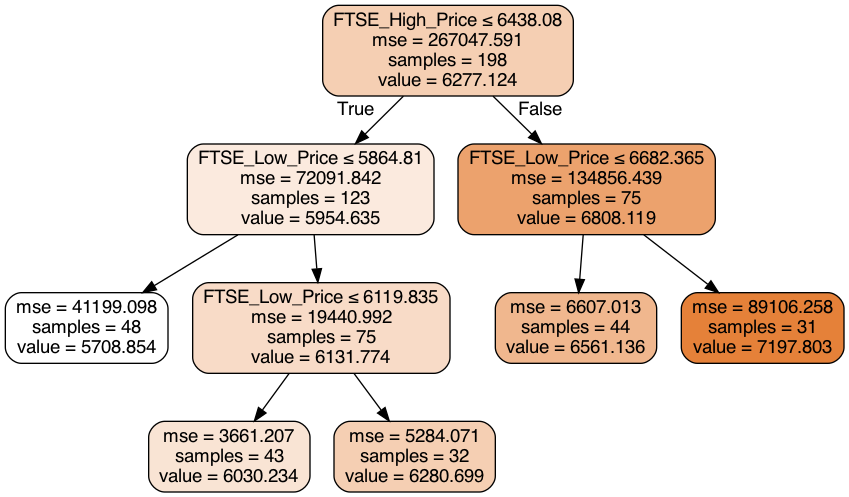

Coefficient-of-Determination of fit (could be better if tree display not needed) = 0.9076446521359514 


Refitting properly after displaying tree ...

Random forest validation  MAE = 33.22239772727328
Random forest validation RMSE = 58.0380914219514
Random forest validation   R² = 0.9825304539800646


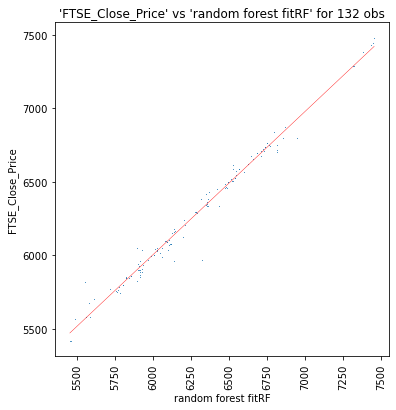


Random Forest regression for 307 rows and 17 columns, and prediction for 132 rows took 0.03 mins.


OLS with variable selection.

Full Model: FTSE_Close_Price ~ Min_Temperature_DegC + FTSE_Open_Price + Max_Temperature_DegC + US_Covid_Cases + SPY_Open_Price + US_Covid_Deaths + FTSE_Volume + cumDailyNsoDeathsByDeathDate + cumAdmissions + FTSE_Low_Price + Rainfall_mm + SPY_Close_Price + cumPeopleVaccinatedCompleteByPublishDate + cumCasesByPublishDate + Sun_Hours + cumVirusTests + FTSE_High_Price
Adj R² = 0.9945830997608046 

FTSE_Close_Price ~ Min_Temperature_DegC + FTSE_Open_Price + Max_Temperature_DegC + US_Covid_Cases + SPY_Open_Price + FTSE_Volume + cumDailyNsoDeathsByDeathDate + cumAdmissions + FTSE_Low_Price + Rainfall_mm + SPY_Close_Price + cumPeopleVaccinatedCompleteByPublishDate + cumCasesByPublishDate + Sun_Hours + cumVirusTests + FTSE_High_Price
Adj R² = 0.9946016609453648 

FTSE_Close_Price ~ Min_Temperature_DegC + FTSE_Open_Price + Max_Temperature_DegC + US_Covid_Cases + SPY

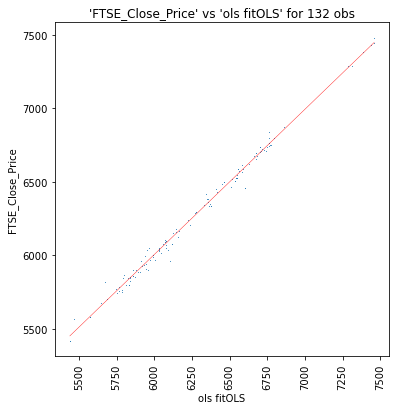


OLS variable selection for 307 rows and 17 columns, and prediction for 132 rows took 0.02 mins.


In [38]:
# Random Forest and OLS (with variable selection) Regressions

#https://data-flair.training/blogs/train-test-set-in-python-ml

import time
stm = time.time()
import numpy as np
import pandas as pd
import matplotlib.pyplot as pl
%matplotlib inline

import warnings 
warnings.filterwarnings('ignore')
#warnings.filterwarnings('ignore', category=DeprecationWarning)
warnings.simplefilter('ignore')

import os
try:
    os.chdir(os.environ['USERPROFILE'] + '\Documents' + r"\0_Teach\data") #change "\0_Teach\data" accordingly
except:
    try:
        os.chdir('/Users/' + os.environ['USER'] + '/Documents' + r"/0_Teach/data") #for Mac
    except:
        #assume data file in current folder
        pass

#read data and delete non-numeric columns
   
df_clean = pd.read_csv('cleaned_data.csv', index_col=0) #specifying 1st column as row labels (called 'index')
yname = 'FTSE_Close_Price'
# x = d.drop(['random_index','resale_price','town','flat_model','flat_type','block_letter','street_name','street_name_root',
#             'street_name_type','street_name_number','street_name_type_begin','no_of_rooms'], 1)

x = df_clean[set(df_clean.columns) - set([yname])].select_dtypes(include='number').dropna(axis=1)
y = df_clean[yname]

print("Regress '" + y.name + "' on", list(x),'\n')

#split into training & testing sets

from sklearn.model_selection import train_test_split
#x_train,x_test,y_train,y_test = train_test_split(x, y, train_size=0.7, test_size=0.3, random_state=123)
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3)


#fit random forest model on training set

from sklearn.ensemble import RandomForestRegressor
print('Random Forest regression may take time...\n')
part = .1
model = RandomForestRegressor(n_jobs=-1, min_samples_leaf=part) #for displaying tree
model.fit(x_train, y_train)
xnames = list(x_train)

print('Each end node will have at least', int(len(x_train) * part), 'observations.\n')
import pydot
from IPython.display import Image
from sklearn import tree
rint = np.random.randint(len(model.estimators_))
print('Randomly selected #' + str(rint + 1), 'of', len(model.estimators_), 'trees in the Forest:')
display(Image(pydot.graph_from_dot_data(tree.export_graphviz(model.estimators_[rint],
                   feature_names=xnames, class_names=[str(a) for a in sorted(list(df_clean[yname].unique()))],
                   filled=True, rounded=True, special_characters=True))[0].create_png()))
#https://scikit-learn.org/stable/modules/generated/sklearn.ensemble.RandomForestRegressor.html#sklearn.ensemble.RandomForestRegressor.score
print('Coefficient-of-Determination of fit (could be better if tree display not needed) =', model.score(df_clean[xnames], df_clean[yname]), '\n')

print('\nRefitting properly after displaying tree ...\n')
model = RandomForestRegressor(n_jobs=-1).fit(x_train, y_train)

#predict using test set

fitRF = model.predict(x_test)
from sklearn.metrics import mean_absolute_error
print('Random forest validation  MAE =', mean_absolute_error(y_test, fitRF))
from sklearn.metrics import mean_squared_error
print('Random forest validation RMSE =', np.sqrt(mean_squared_error(y_test, fitRF)))
print('Random forest validation   R² =',
      pd.concat([y_test, pd.Series(fitRF, index=y_test.index)], 1).corr().iloc[0, 1] ** 2)

#plot y vs y-hat

pl.rcParams["figure.figsize"] = [6.000, 6.143] #square plot

#plot pseudo regression line
s, i = np.polyfit(fitRF, y_test, 1) #s=slope, i=intercept
a, b = min(fitRF), max(fitRF)
pl.plot([a, b], i + [s * a, s * b], 'red', linewidth=0.4) #increase linewidth for darker line
del s, i, a, b

#scatter y vs y-hat
pl.scatter(fitRF, y_test, s=1, linewidths=0)
xn = 'random forest fitRF'
yn = y_test.name
pl.xlabel(xn)
pl.ylabel(yn)
pl.xticks(rotation=90)
pl.title("'" + yn + "' vs '" + xn + "' for " + str(len(y_test)) + ' obs')
pl.show()

print('\nRandom Forest regression for', len(x_train), 'rows and', x_train.shape[1], 'columns, and prediction for',
      len(x_test), 'rows took', '%.2f' % ((time.time() - stm) / 60), 'mins.')


#ols variable selection

stm = time.time()
print('\n\nOLS with variable selection.')

df = pd.concat([y_train, x_train], axis=1)

#model number-1, i.e. best; keep updating this:
#m1 = mod; #wrong if rerun in cell
m1 = ' + '.join(list(df)).replace('+', '~', 1)
print('\nFull Model:', m1)

import statsmodels.formula.api as sm
out = sm.ols(m1, df).fit()

#r² number-1, i.e. best
#r1 = out.rsquared_adj; #wrong if rerun in cell
r1 = out.rsquared_adj
print('Adj R² =', r1, '\n')

xs = list(df) #list of x variables, keep updating this

while len(xs) > 2: #(y and last x) make 2 variables
    
    tabs = abs(out.tvalues[1:]) #omit intercept at position 1
    xs.remove(tabs[tabs == min(tabs)].index[0]) #remove name of variable with smallest |t|
    
    mod = ' + '.join(xs).replace('+', '~', 1) #rebuild model equation
    print(mod)
    
    out = sm.ols(mod, df).fit()
    radj = out.rsquared_adj
    print('Adj R² =', radj, '\n')
    
    if radj > r1: #found model with larger Adjusted R²
        r1 = radj #update best Adjusted R²
        m1 = mod #update best model equation
        
print('Best Model:', m1)
print('Best Adj R² =', r1, '\n')

fitOLS = sm.ols(m1, df).fit().predict(x_test)

#print(sm.ols(m1, df).fit().summary2())

print('OLS validation  MAE =', mean_absolute_error(y_test, fitOLS))
print('OLS validation RMSE =', np.sqrt(mean_squared_error(y_test, fitOLS)))
print('OLS validation   R² =', pd.concat([y_test, fitOLS], 1).corr().iloc[0, 1] ** 2)

#plot pseudo regression line
s, i = np.polyfit(fitOLS, y_test, 1) #s=slope, i=intercept
a, b = min(fitOLS), max(fitOLS)
pl.plot([a, b], i + [s * a, s * b], 'red', linewidth=0.4) #increase linewidth for darker line
del s, i, a, b

#scatter y vs y-hat
pl.scatter(fitOLS, y_test, s=1, linewidths=0)
xn = 'ols fitOLS'
yn = y_test.name
pl.xlabel(xn)
pl.ylabel(yn)
pl.xticks(rotation=90)
pl.title("'" + yn + "' vs '" + xn + "' for " + str(len(y_test)) + ' obs')
pl.show()

print('\nOLS variable selection for', len(x_train), 'rows and', x_train.shape[1], 'columns, and prediction for',
      len(x_test), 'rows took', '%.2f' % ((time.time() - stm) / 60), 'mins.')

## Random Forest Regression for SPY Close Price

Regress 'SPY_Close_Price' on ['FTSE_Close_Price', 'Min_Temperature_DegC', 'FTSE_Open_Price', 'Max_Temperature_DegC', 'US_Covid_Cases', 'SPY_Open_Price', 'US_Covid_Deaths', 'FTSE_Volume', 'cumDailyNsoDeathsByDeathDate', 'cumAdmissions', 'FTSE_Low_Price', 'Rainfall_mm', 'cumPeopleVaccinatedCompleteByPublishDate', 'cumCasesByPublishDate', 'Sun_Hours', 'cumVirusTests', 'FTSE_High_Price'] 

Random Forest regression may take time...

Each end node will have at least 30 observations.

Randomly selected #99 of 100 trees in the Forest:


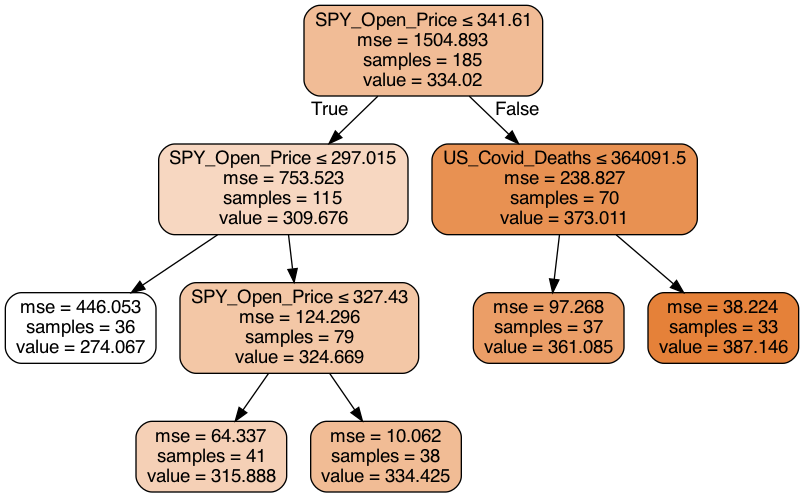

Coefficient-of-Determination of fit (could be better if tree display not needed) = 0.9450666620934312 


Refitting properly after displaying tree ...

Random forest validation  MAE = 2.22897158628792
Random forest validation RMSE = 3.255786663144385
Random forest validation   R² = 0.9931819000984742


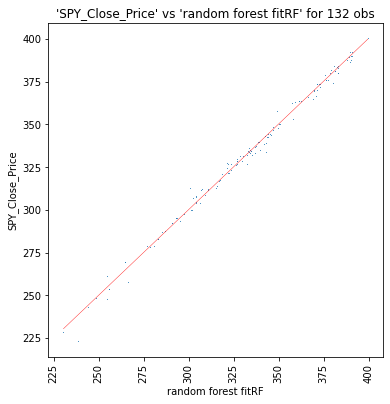


Random Forest regression for 307 rows and 17 columns, and prediction for 132 rows took 0.03 mins.


OLS with variable selection.

Full Model: SPY_Close_Price ~ FTSE_Close_Price + Min_Temperature_DegC + FTSE_Open_Price + Max_Temperature_DegC + US_Covid_Cases + SPY_Open_Price + US_Covid_Deaths + FTSE_Volume + cumDailyNsoDeathsByDeathDate + cumAdmissions + FTSE_Low_Price + Rainfall_mm + cumPeopleVaccinatedCompleteByPublishDate + cumCasesByPublishDate + Sun_Hours + cumVirusTests + FTSE_High_Price
Adj R² = 0.9935447264186372 

SPY_Close_Price ~ FTSE_Close_Price + Min_Temperature_DegC + FTSE_Open_Price + Max_Temperature_DegC + US_Covid_Cases + SPY_Open_Price + US_Covid_Deaths + FTSE_Volume + cumDailyNsoDeathsByDeathDate + cumAdmissions + FTSE_Low_Price + cumPeopleVaccinatedCompleteByPublishDate + cumCasesByPublishDate + Sun_Hours + cumVirusTests + FTSE_High_Price
Adj R² = 0.9935666776113403 

SPY_Close_Price ~ FTSE_Close_Price + Min_Temperature_DegC + FTSE_Open_Price + Max_Temperature_DegC 

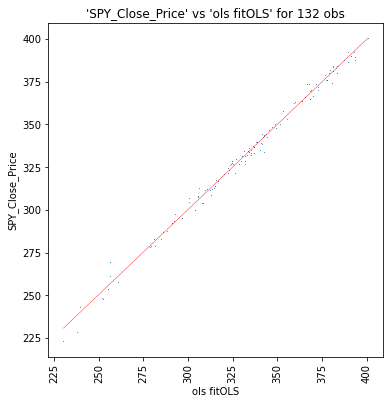


OLS variable selection for 307 rows and 17 columns, and prediction for 132 rows took 0.01 mins.


In [39]:
# Random Forest and OLS (with variable selection) Regressions

#https://data-flair.training/blogs/train-test-set-in-python-ml

import time
stm = time.time()
import numpy as np
import pandas as pd
import matplotlib.pyplot as pl
%matplotlib inline

import warnings 
warnings.filterwarnings('ignore')
#warnings.filterwarnings('ignore', category=DeprecationWarning)
warnings.simplefilter('ignore')

import os
try:
    os.chdir(os.environ['USERPROFILE'] + '\Documents' + r"\0_Teach\data") #change "\0_Teach\data" accordingly
except:
    try:
        os.chdir('/Users/' + os.environ['USER'] + '/Documents' + r"/0_Teach/data") #for Mac
    except:
        #assume data file in current folder
        pass

#read data and delete non-numeric columns
   
df_clean = pd.read_csv('cleaned_data.csv', index_col=0) #specifying 1st column as row labels (called 'index')
yname = 'SPY_Close_Price'
# x = d.drop(['random_index','resale_price','town','flat_model','flat_type','block_letter','street_name','street_name_root',
#             'street_name_type','street_name_number','street_name_type_begin','no_of_rooms'], 1)

x = df_clean[set(df_clean.columns) - set([yname])].select_dtypes(include='number').dropna(axis=1)
y = df_clean[yname]

print("Regress '" + y.name + "' on", list(x),'\n')

#split into training & testing sets

from sklearn.model_selection import train_test_split
#x_train,x_test,y_train,y_test = train_test_split(x, y, train_size=0.7, test_size=0.3, random_state=123)
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3)


#fit random forest model on training set

from sklearn.ensemble import RandomForestRegressor
print('Random Forest regression may take time...\n')
part = .1
model = RandomForestRegressor(n_jobs=-1, min_samples_leaf=part) #for displaying tree
model.fit(x_train, y_train)
xnames = list(x_train)

print('Each end node will have at least', int(len(x_train) * part), 'observations.\n')
import pydot
from IPython.display import Image
from sklearn import tree
rint = np.random.randint(len(model.estimators_))
print('Randomly selected #' + str(rint + 1), 'of', len(model.estimators_), 'trees in the Forest:')
display(Image(pydot.graph_from_dot_data(tree.export_graphviz(model.estimators_[rint],
                   feature_names=xnames, class_names=[str(a) for a in sorted(list(df_clean[yname].unique()))],
                   filled=True, rounded=True, special_characters=True))[0].create_png()))
#https://scikit-learn.org/stable/modules/generated/sklearn.ensemble.RandomForestRegressor.html#sklearn.ensemble.RandomForestRegressor.score
print('Coefficient-of-Determination of fit (could be better if tree display not needed) =', model.score(df_clean[xnames], df_clean[yname]), '\n')

print('\nRefitting properly after displaying tree ...\n')
model = RandomForestRegressor(n_jobs=-1).fit(x_train, y_train)

#predict using test set

fitRF = model.predict(x_test)
from sklearn.metrics import mean_absolute_error
print('Random forest validation  MAE =', mean_absolute_error(y_test, fitRF))
from sklearn.metrics import mean_squared_error
print('Random forest validation RMSE =', np.sqrt(mean_squared_error(y_test, fitRF)))
print('Random forest validation   R² =',
      pd.concat([y_test, pd.Series(fitRF, index=y_test.index)], 1).corr().iloc[0, 1] ** 2)

#plot y vs y-hat

pl.rcParams["figure.figsize"] = [6.000, 6.143] #square plot

#plot pseudo regression line
s, i = np.polyfit(fitRF, y_test, 1) #s=slope, i=intercept
a, b = min(fitRF), max(fitRF)
pl.plot([a, b], i + [s * a, s * b], 'red', linewidth=0.4) #increase linewidth for darker line
del s, i, a, b

#scatter y vs y-hat
pl.scatter(fitRF, y_test, s=1, linewidths=0)
xn = 'random forest fitRF'
yn = y_test.name
pl.xlabel(xn)
pl.ylabel(yn)
pl.xticks(rotation=90)
pl.title("'" + yn + "' vs '" + xn + "' for " + str(len(y_test)) + ' obs')
pl.show()

print('\nRandom Forest regression for', len(x_train), 'rows and', x_train.shape[1], 'columns, and prediction for',
      len(x_test), 'rows took', '%.2f' % ((time.time() - stm) / 60), 'mins.')


#ols variable selection

stm = time.time()
print('\n\nOLS with variable selection.')

df = pd.concat([y_train, x_train], axis=1)

#model number-1, i.e. best; keep updating this:
#m1 = mod; #wrong if rerun in cell
m1 = ' + '.join(list(df)).replace('+', '~', 1)
print('\nFull Model:', m1)

import statsmodels.formula.api as sm
out = sm.ols(m1, df).fit()

#r² number-1, i.e. best
#r1 = out.rsquared_adj; #wrong if rerun in cell
r1 = out.rsquared_adj
print('Adj R² =', r1, '\n')

xs = list(df) #list of x variables, keep updating this

while len(xs) > 2: #(y and last x) make 2 variables
    
    tabs = abs(out.tvalues[1:]) #omit intercept at position 1
    xs.remove(tabs[tabs == min(tabs)].index[0]) #remove name of variable with smallest |t|
    
    mod = ' + '.join(xs).replace('+', '~', 1) #rebuild model equation
    print(mod)
    
    out = sm.ols(mod, df).fit()
    radj = out.rsquared_adj
    print('Adj R² =', radj, '\n')
    
    if radj > r1: #found model with larger Adjusted R²
        r1 = radj #update best Adjusted R²
        m1 = mod #update best model equation
        
print('Best Model:', m1)
print('Best Adj R² =', r1, '\n')

fitOLS = sm.ols(m1, df).fit().predict(x_test)

#print(sm.ols(m1, df).fit().summary2())

print('OLS validation  MAE =', mean_absolute_error(y_test, fitOLS))
print('OLS validation RMSE =', np.sqrt(mean_squared_error(y_test, fitOLS)))
print('OLS validation   R² =', pd.concat([y_test, fitOLS], 1).corr().iloc[0, 1] ** 2)

#plot pseudo regression line
s, i = np.polyfit(fitOLS, y_test, 1) #s=slope, i=intercept
a, b = min(fitOLS), max(fitOLS)
pl.plot([a, b], i + [s * a, s * b], 'red', linewidth=0.4) #increase linewidth for darker line
del s, i, a, b

#scatter y vs y-hat
pl.scatter(fitOLS, y_test, s=1, linewidths=0)
xn = 'ols fitOLS'
yn = y_test.name
pl.xlabel(xn)
pl.ylabel(yn)
pl.xticks(rotation=90)
pl.title("'" + yn + "' vs '" + xn + "' for " + str(len(y_test)) + ' obs')
pl.show()

print('\nOLS variable selection for', len(x_train), 'rows and', x_train.shape[1], 'columns, and prediction for',
      len(x_test), 'rows took', '%.2f' % ((time.time() - stm) / 60), 'mins.')

## Decision Tree Boosting

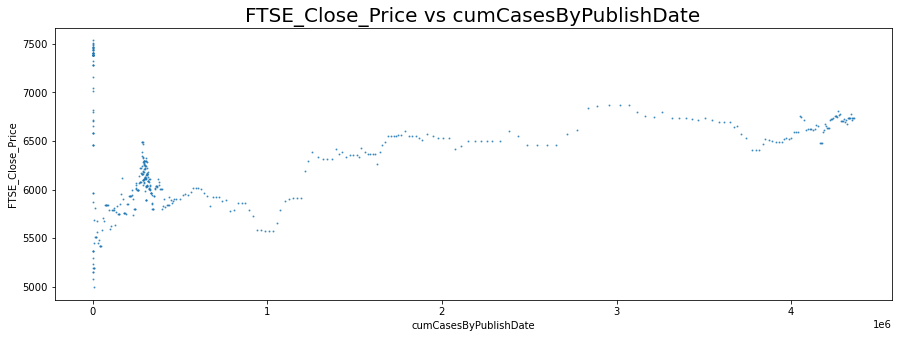

First of 30 decision trees of 1-deep:


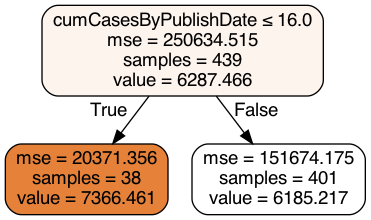

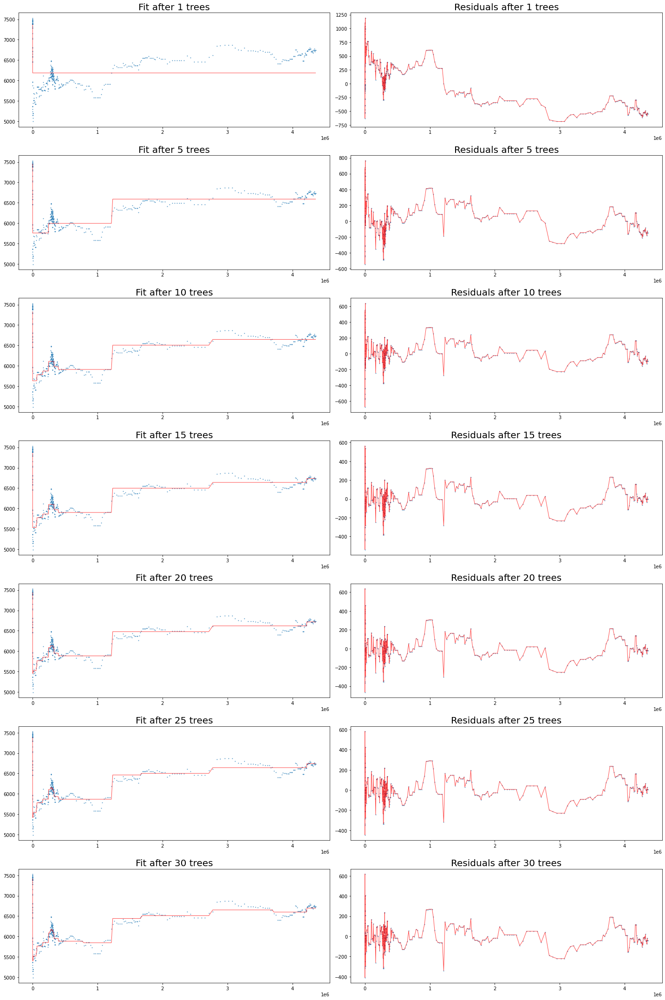

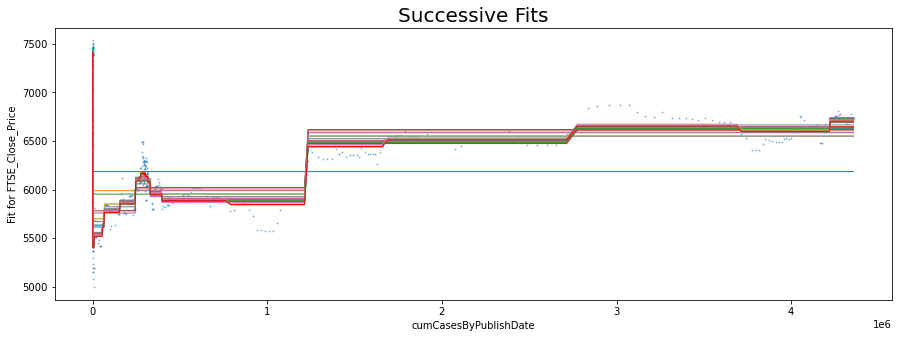

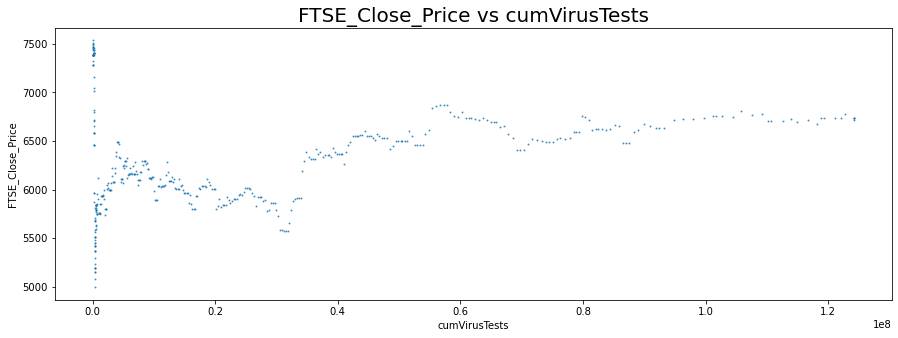

First of 30 decision trees of 1-deep:


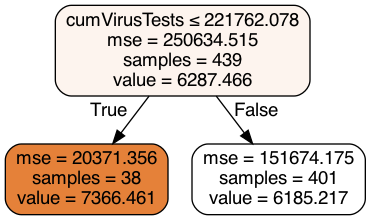

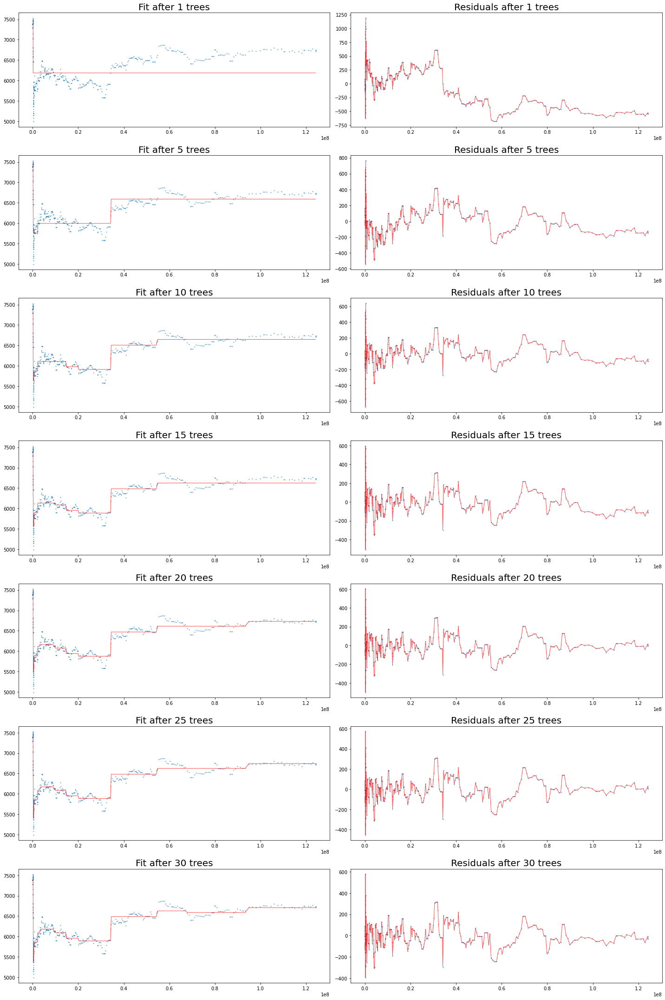

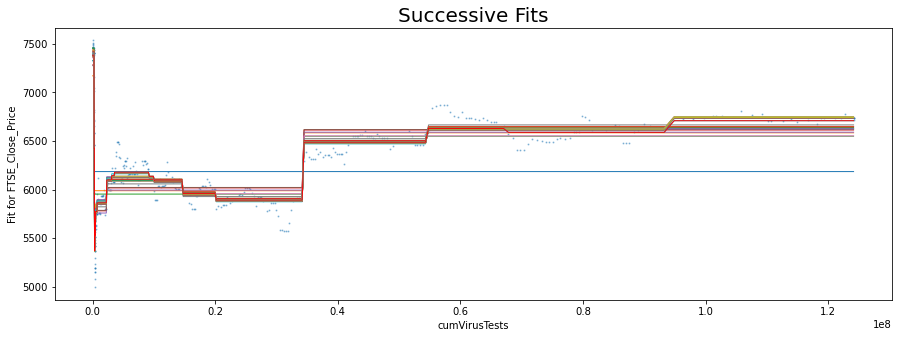

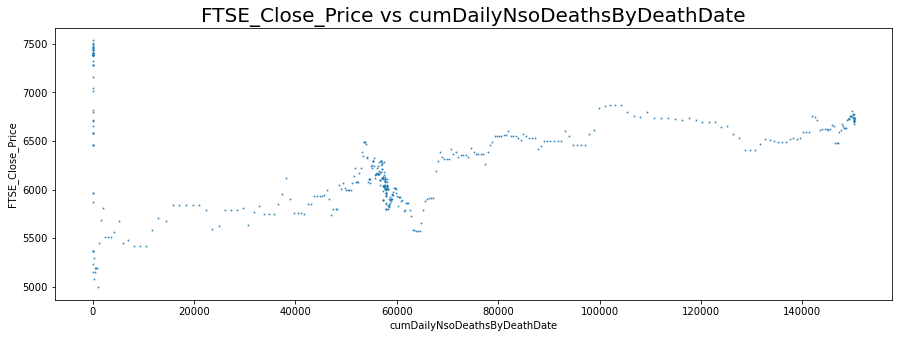

First of 30 decision trees of 1-deep:


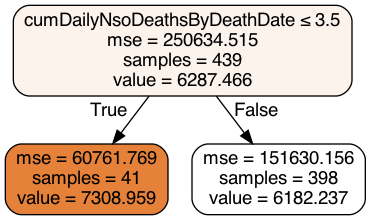

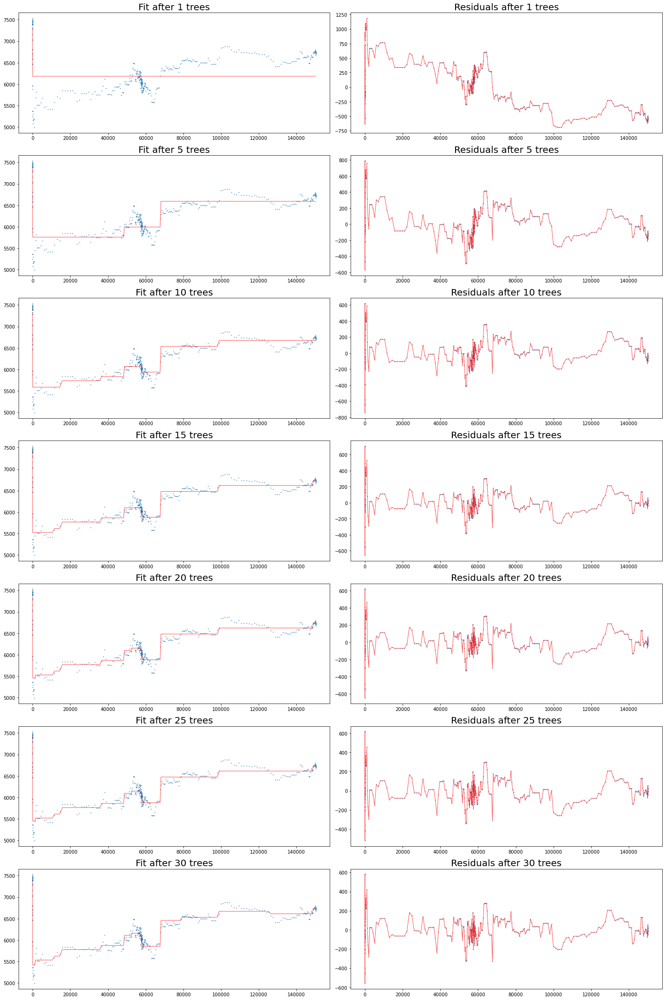

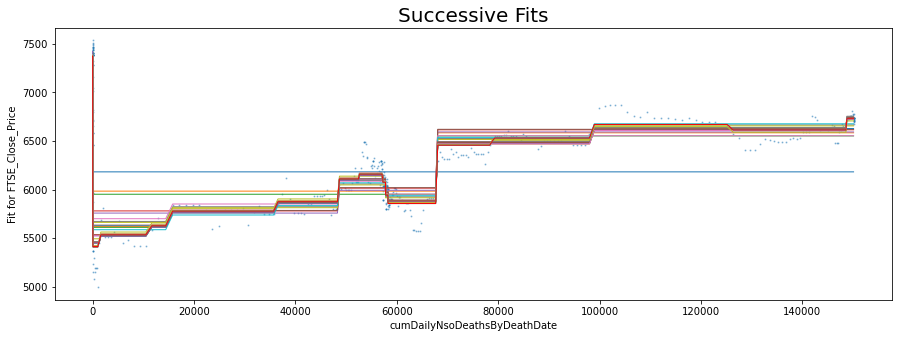

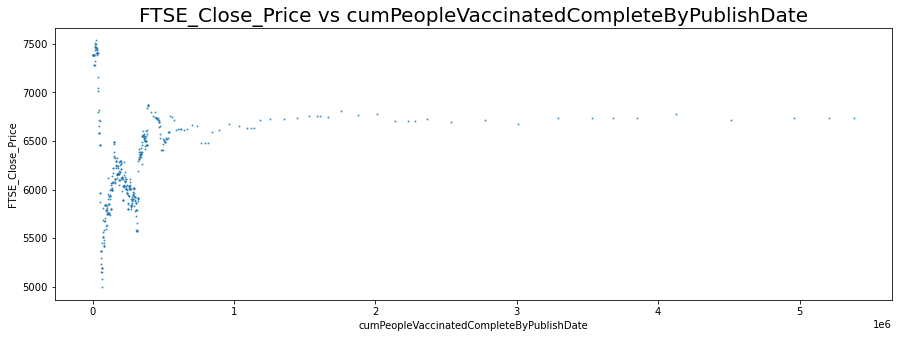

First of 30 decision trees of 1-deep:


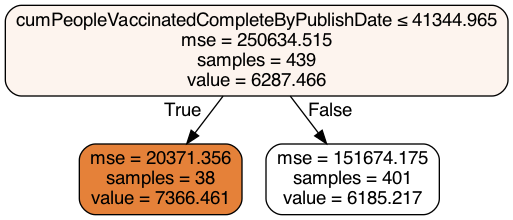

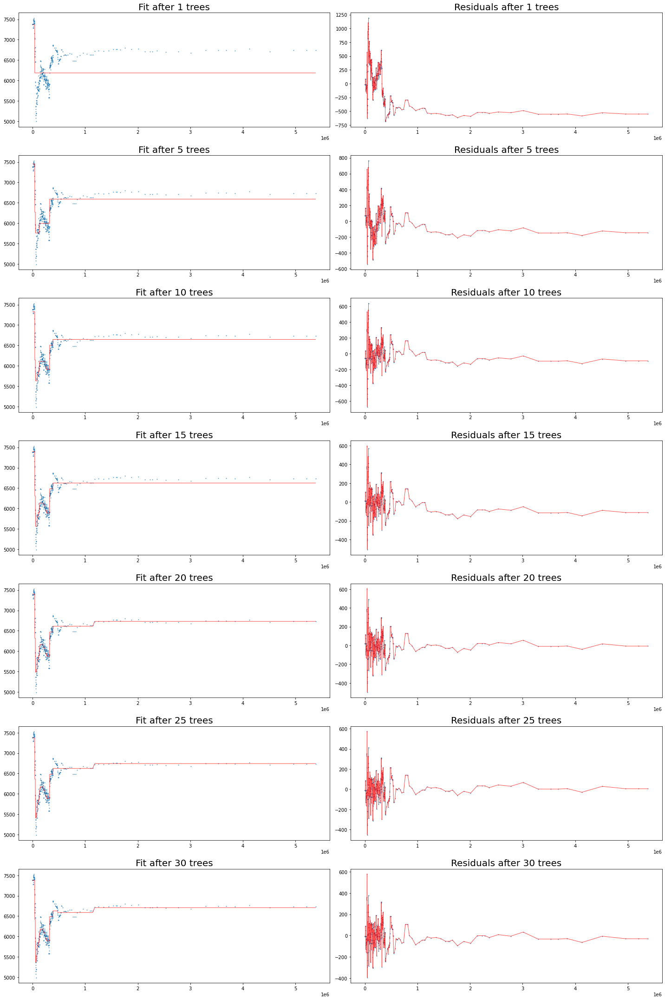

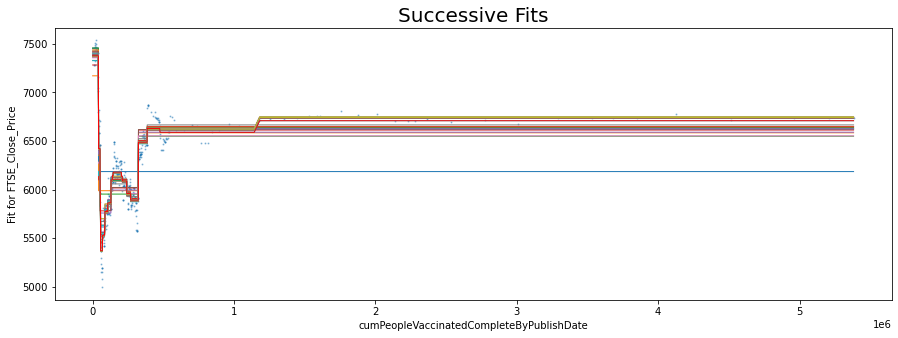

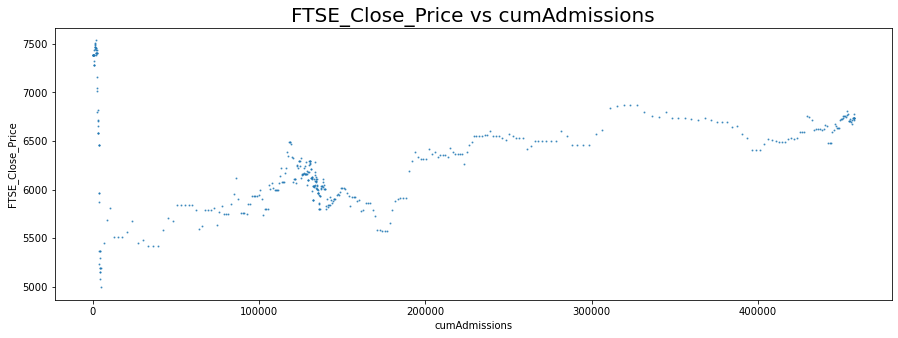

First of 30 decision trees of 1-deep:


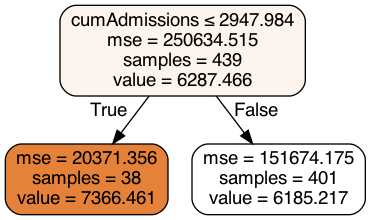

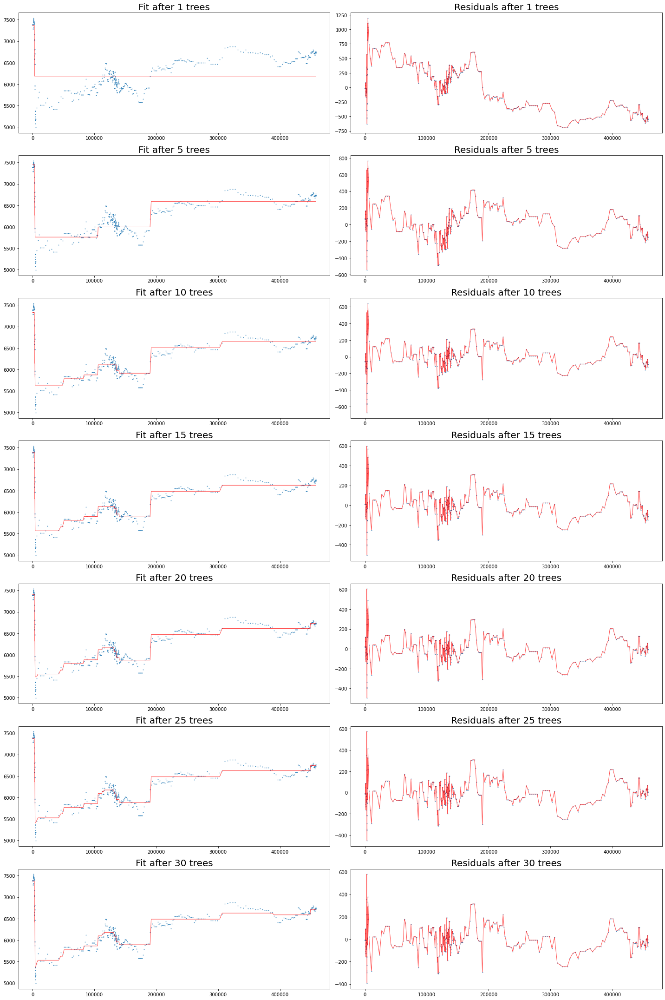

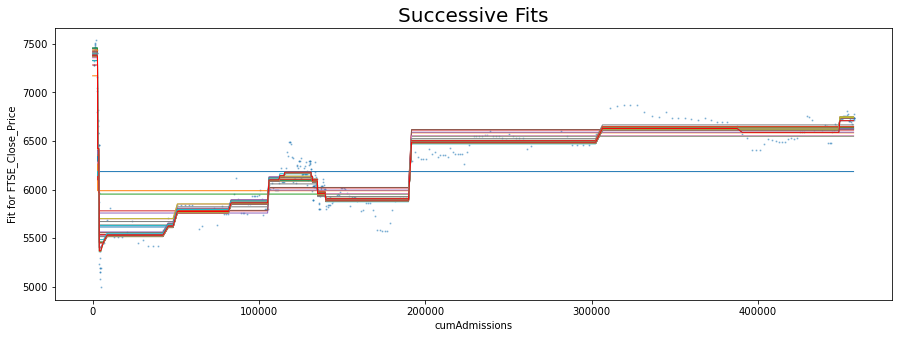

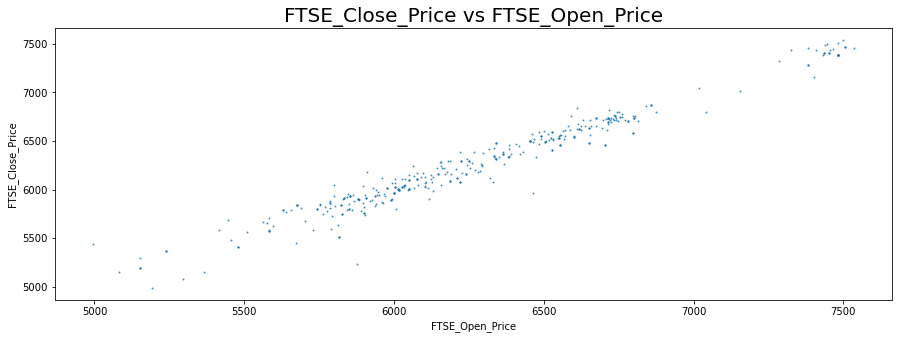

First of 30 decision trees of 1-deep:


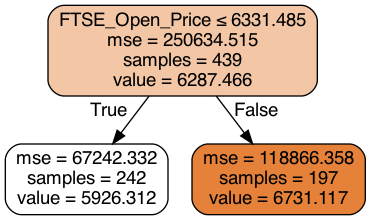

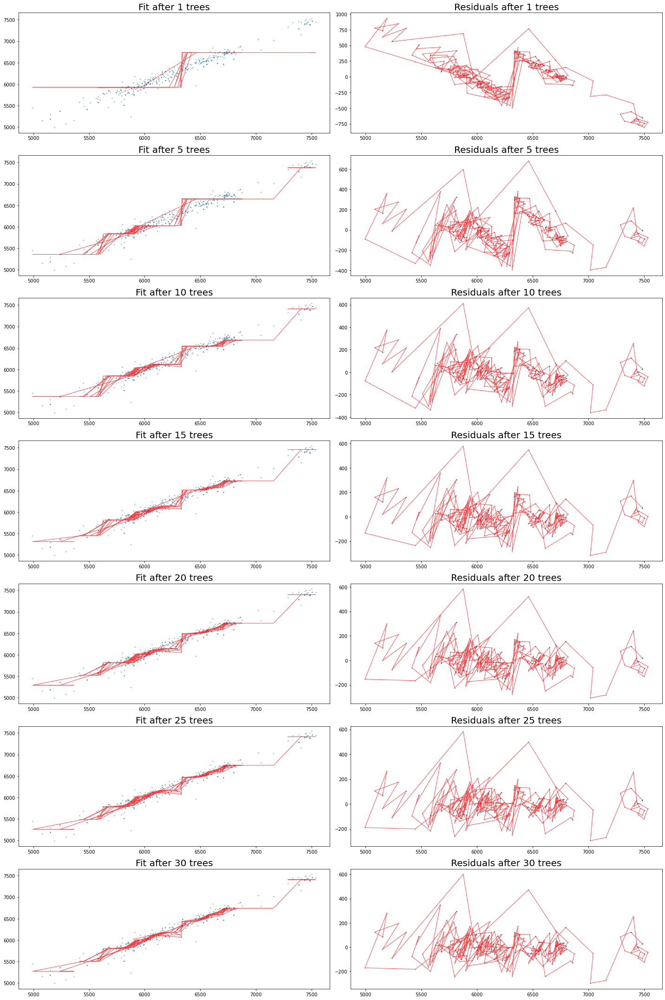

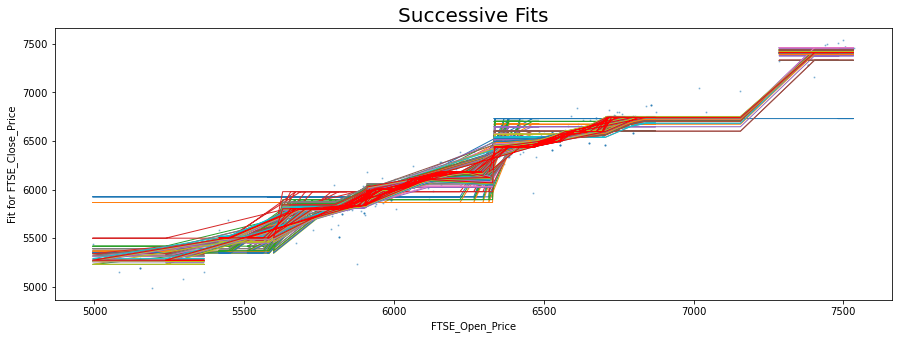

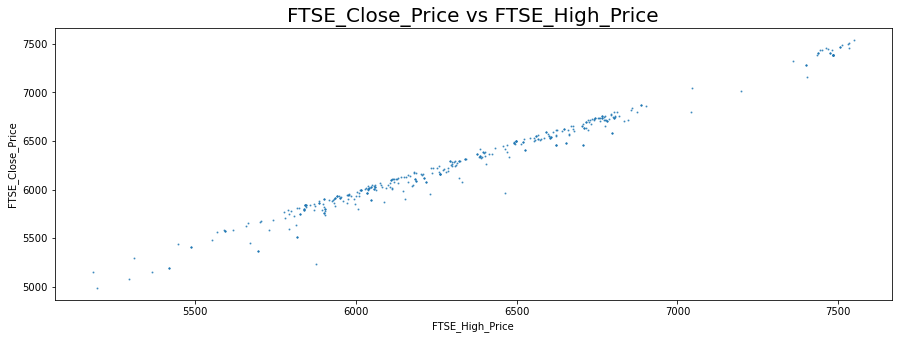

First of 30 decision trees of 1-deep:


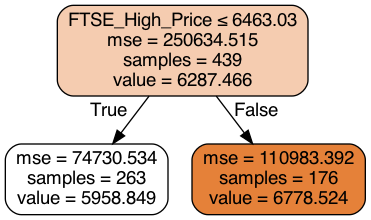

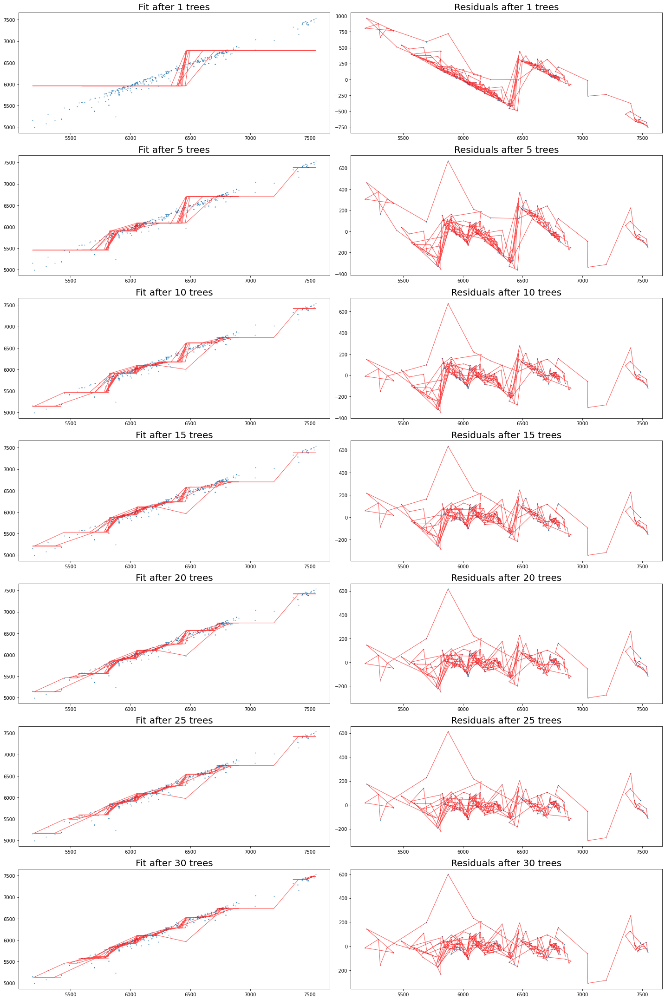

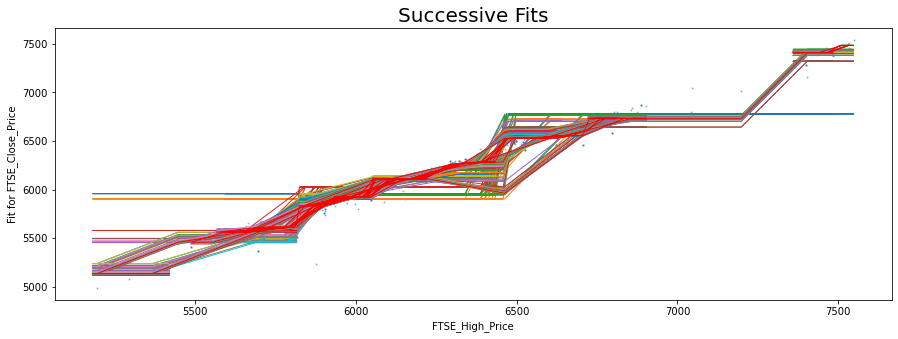

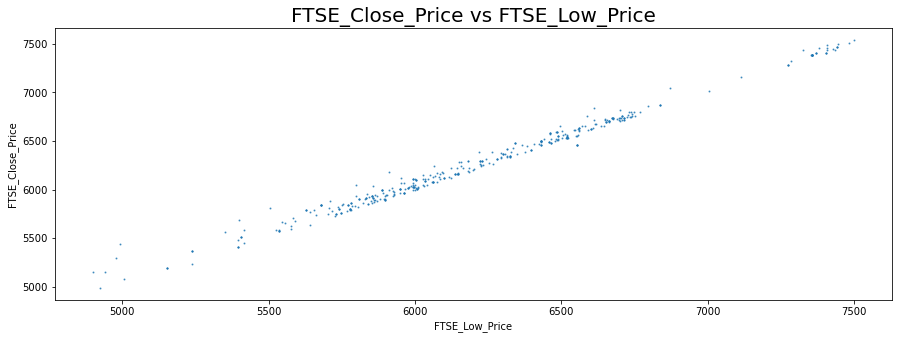

First of 30 decision trees of 1-deep:


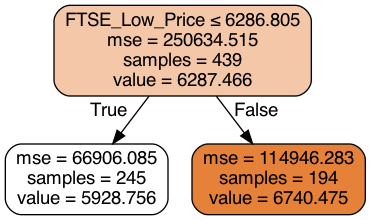

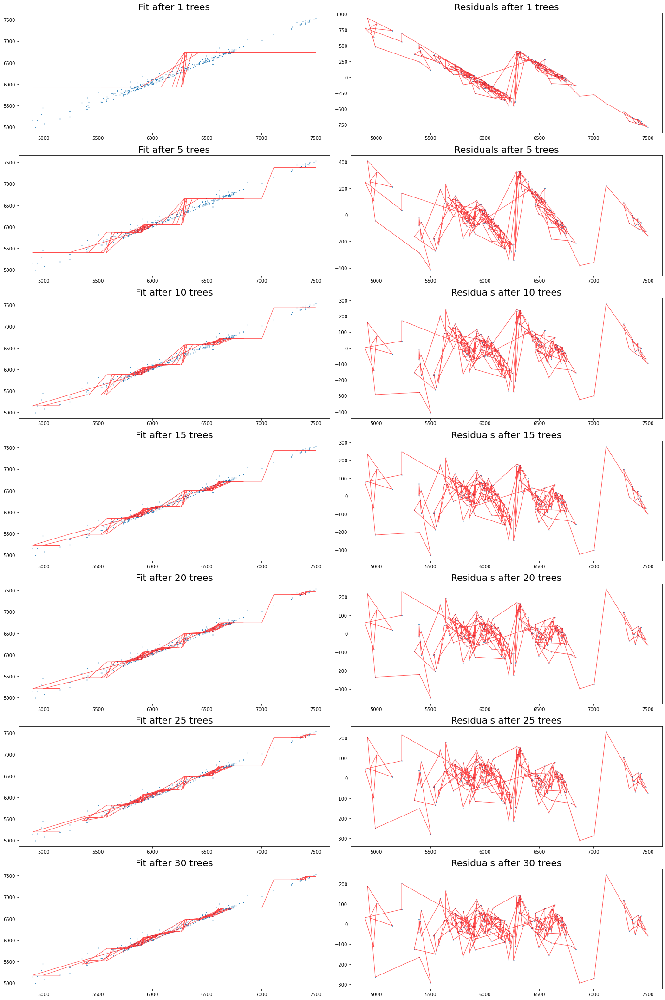

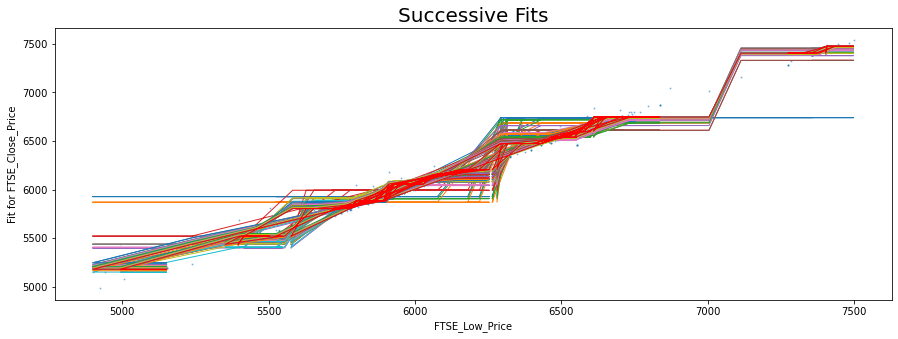

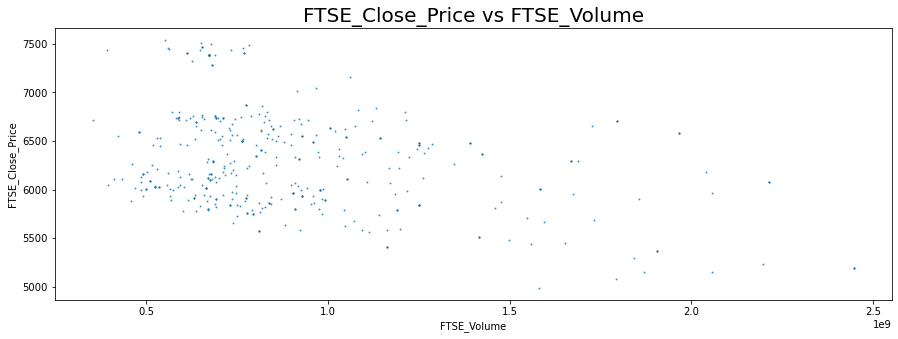

First of 30 decision trees of 1-deep:


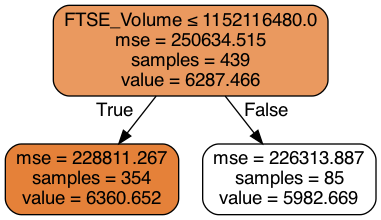

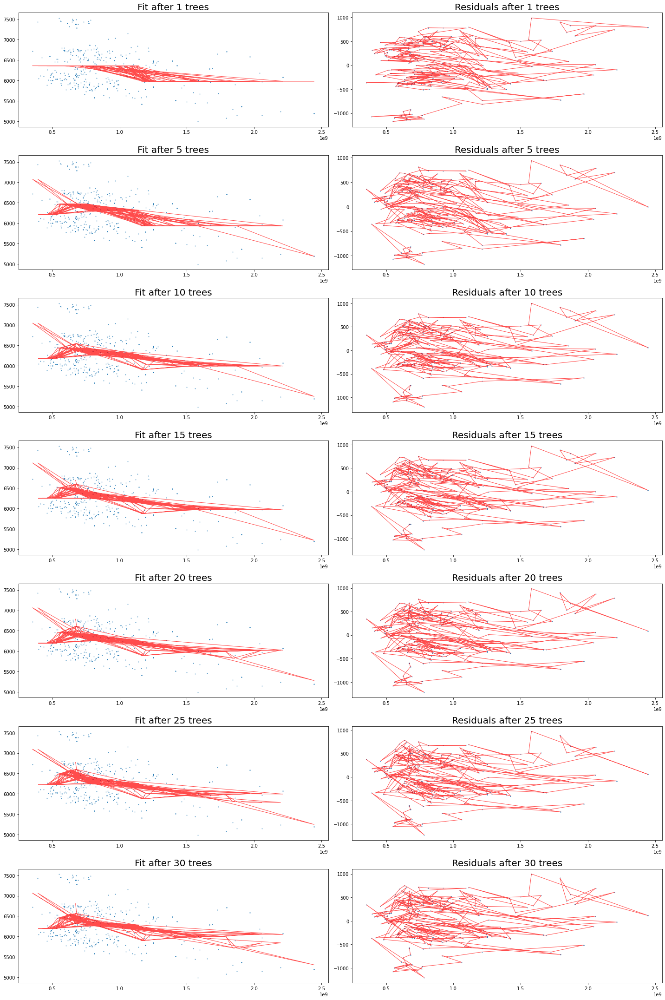

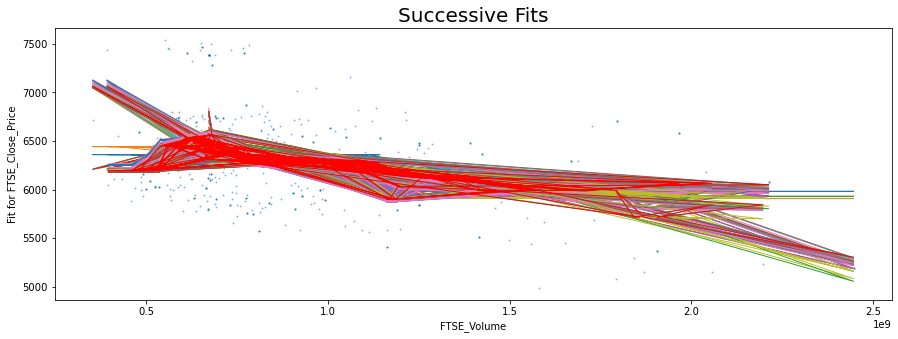

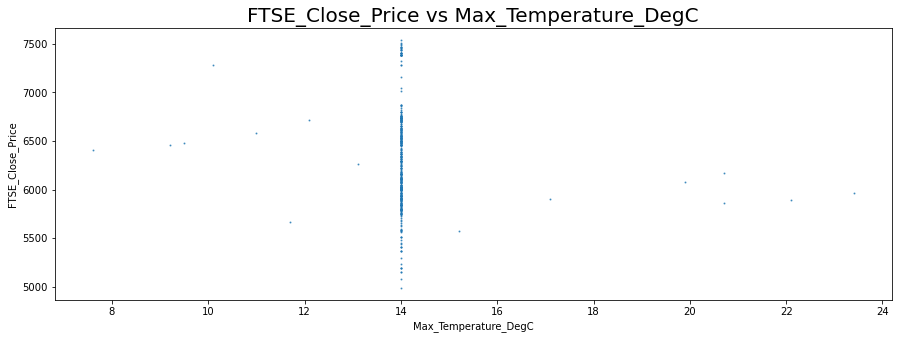

First of 30 decision trees of 1-deep:


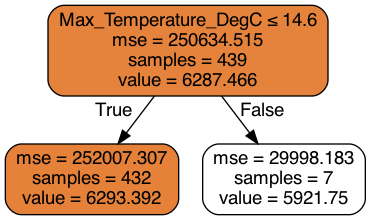

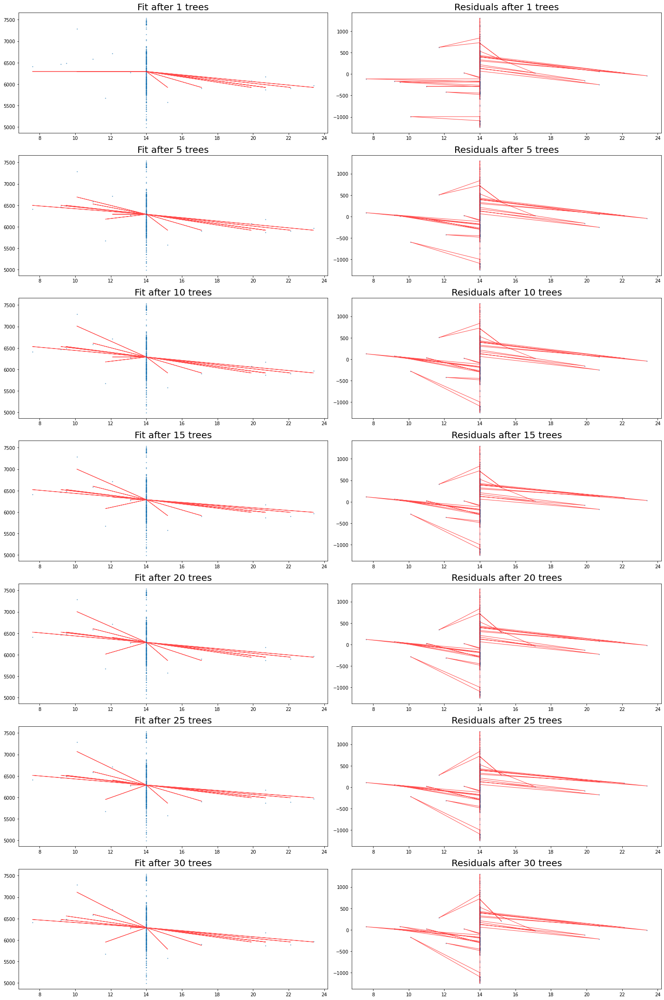

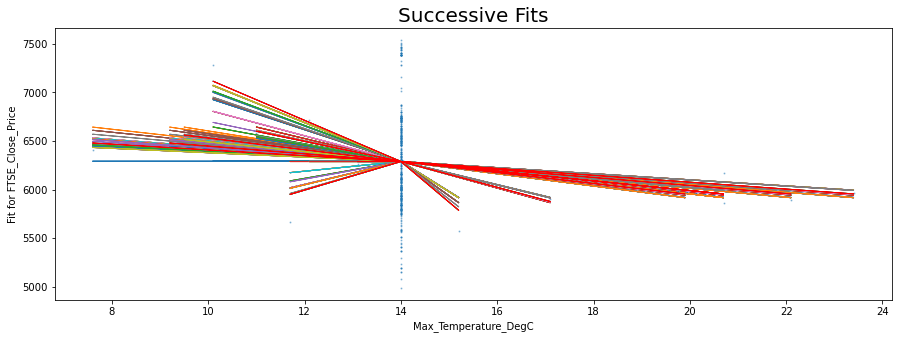

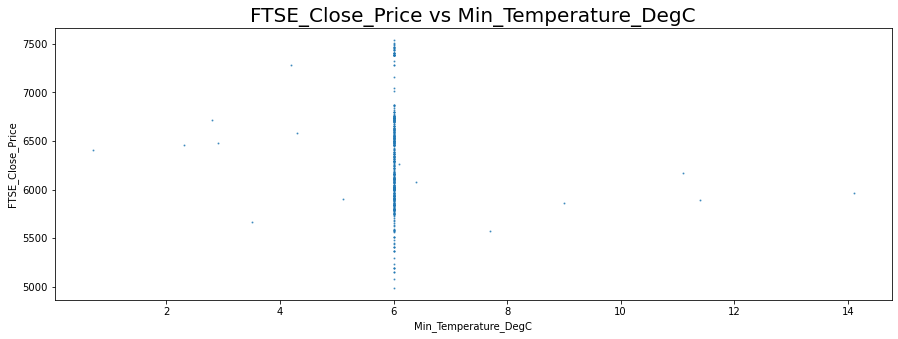

First of 30 decision trees of 1-deep:


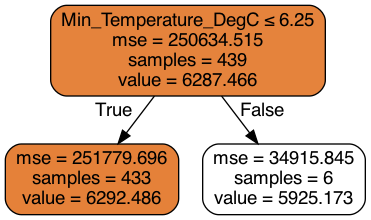

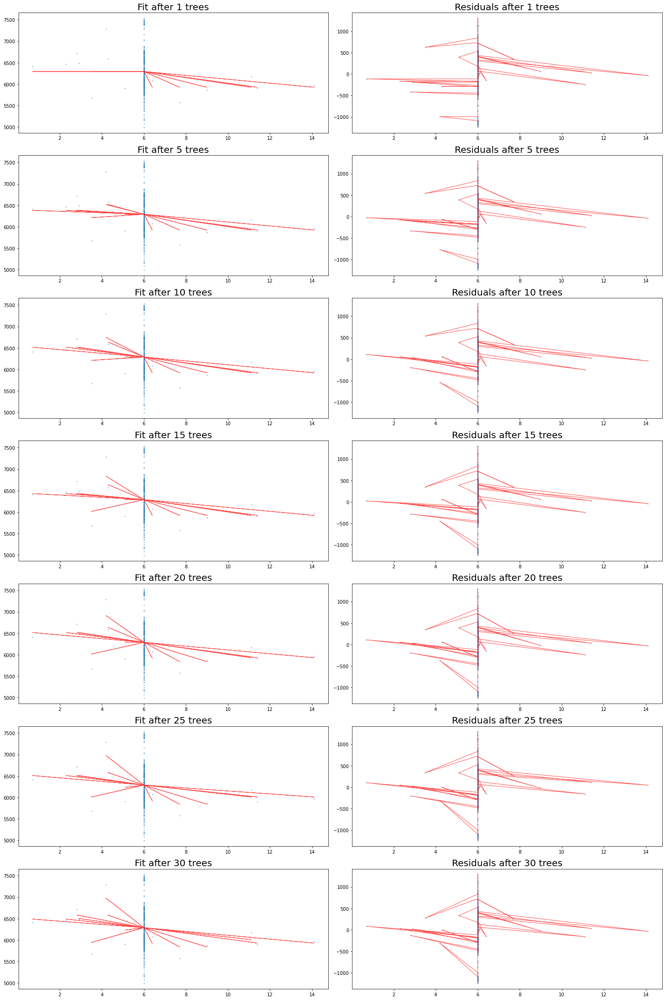

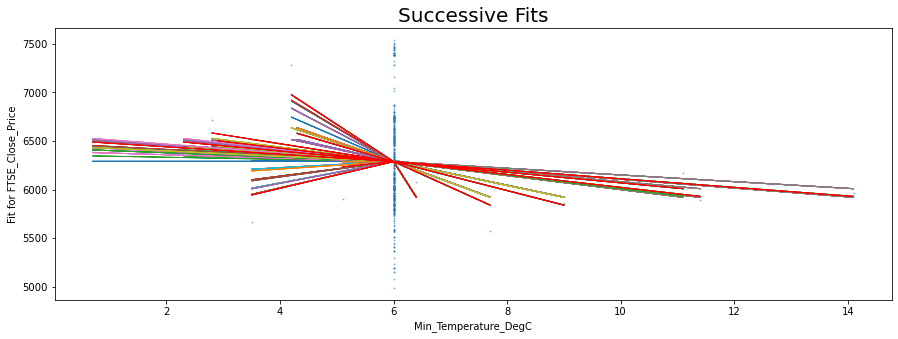

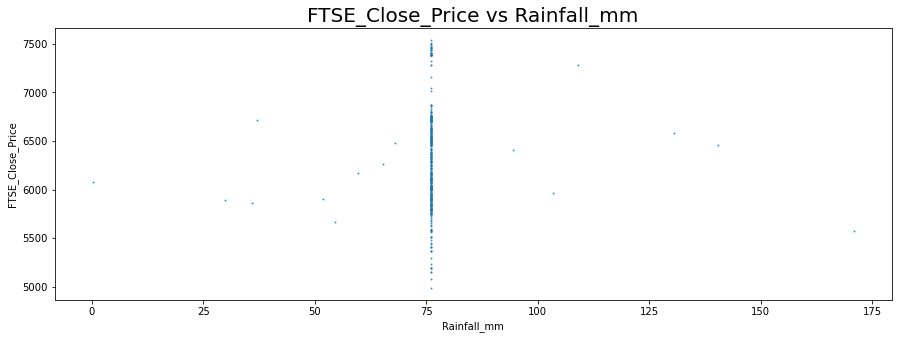

First of 30 decision trees of 1-deep:


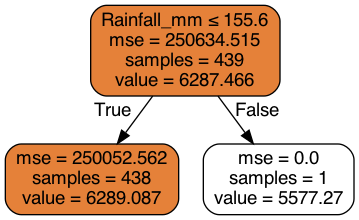

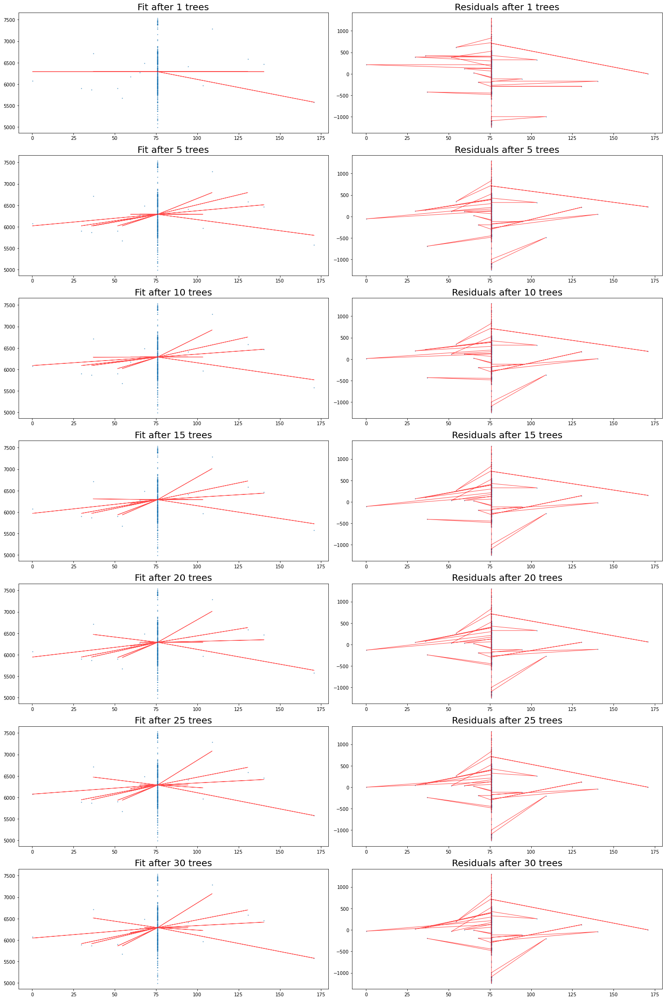

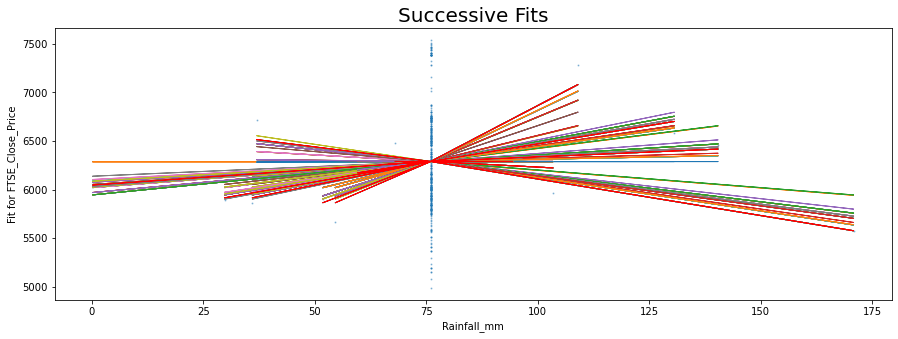

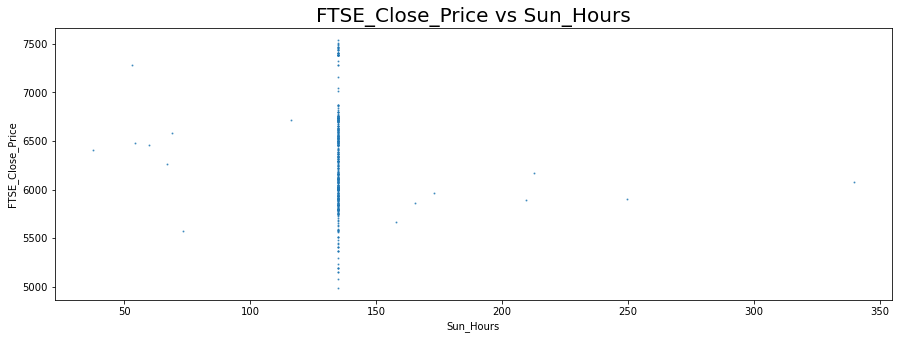

First of 30 decision trees of 1-deep:


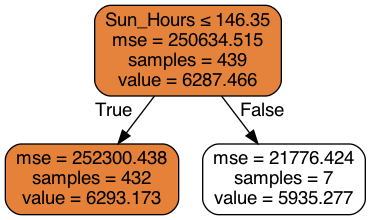

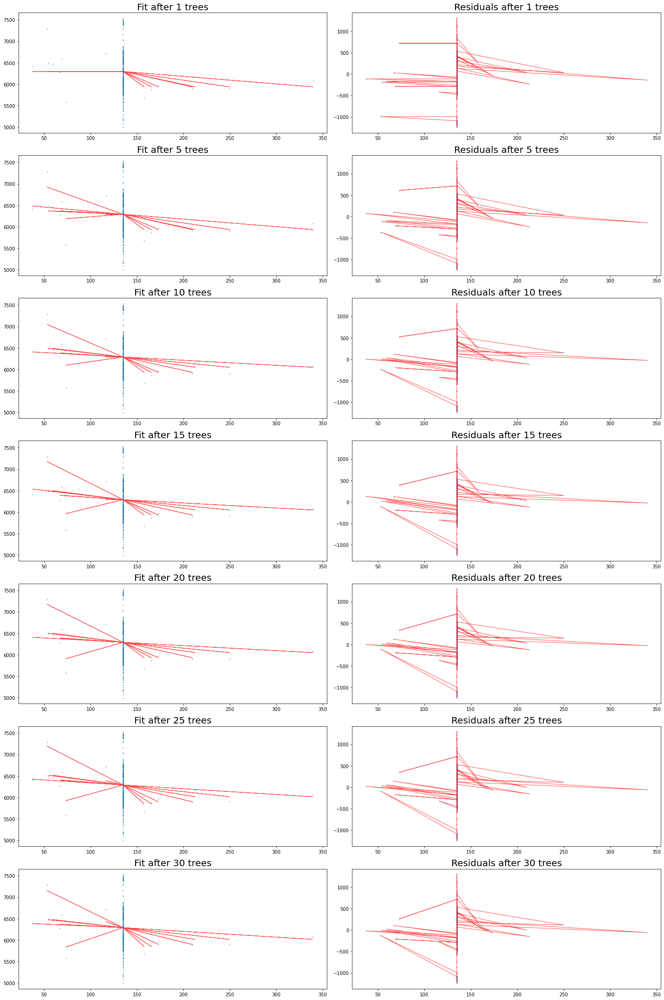

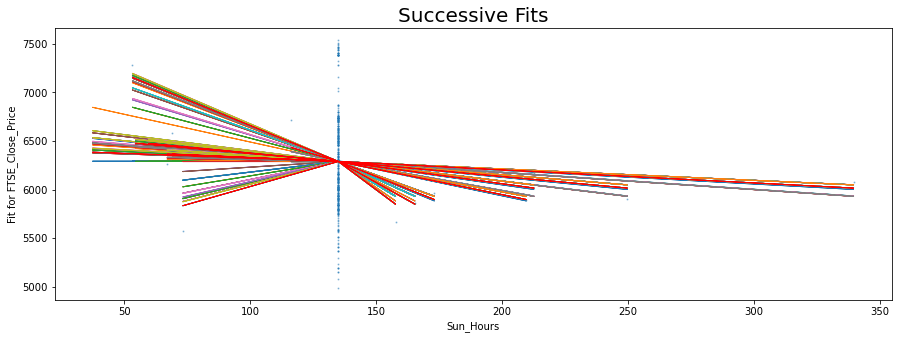

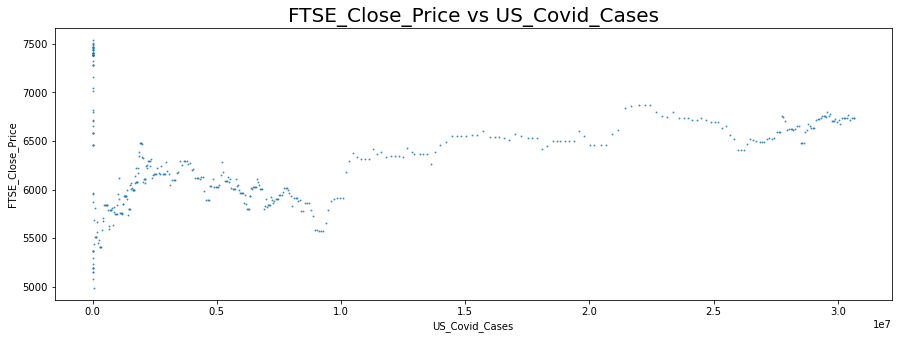

First of 30 decision trees of 1-deep:


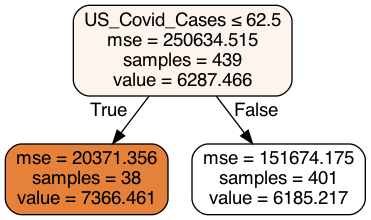

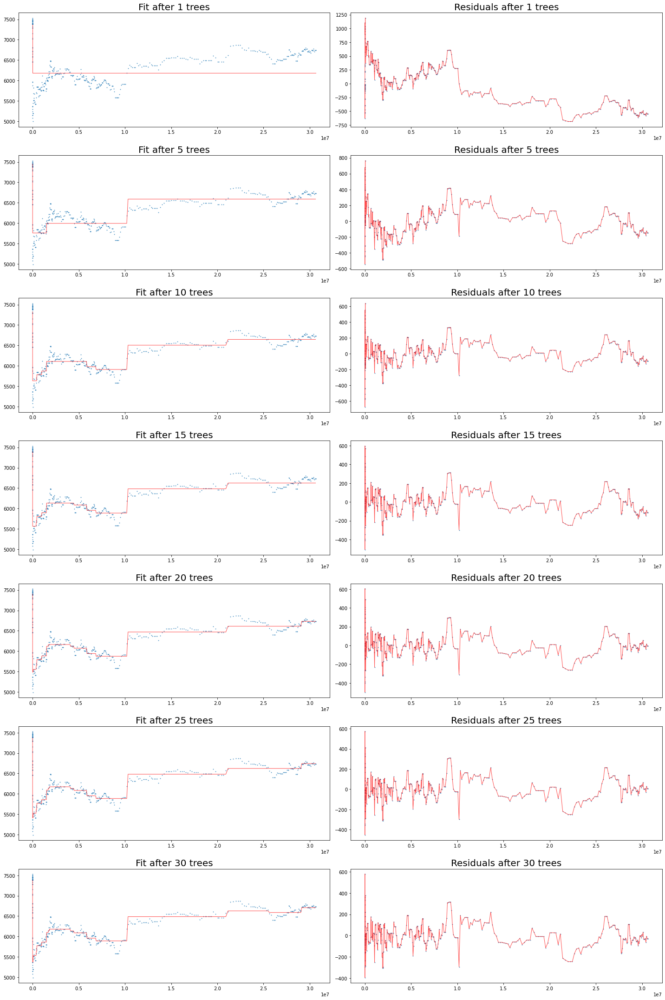

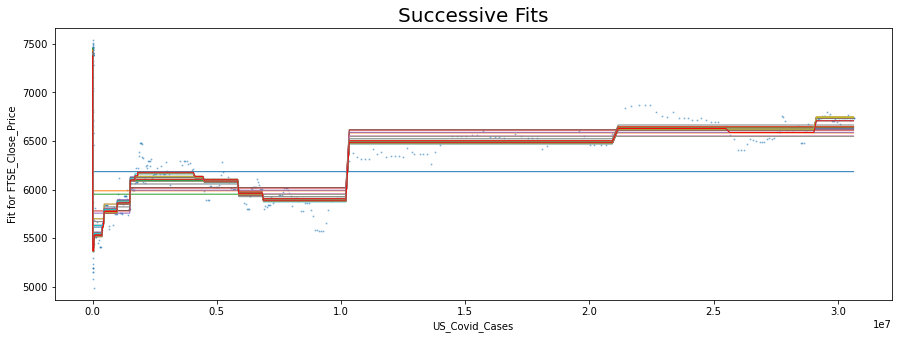

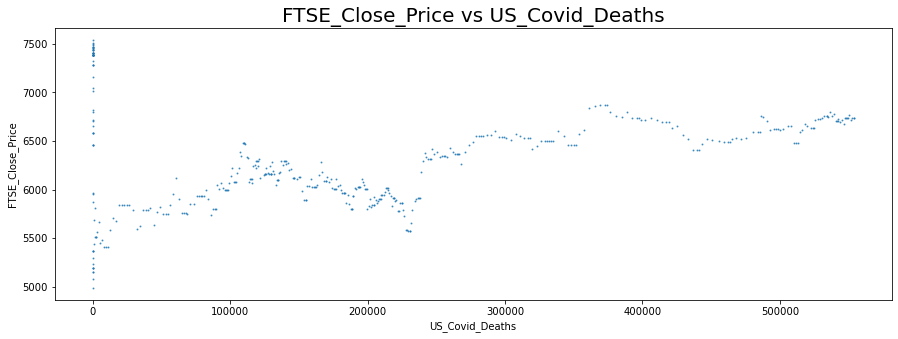

First of 30 decision trees of 1-deep:


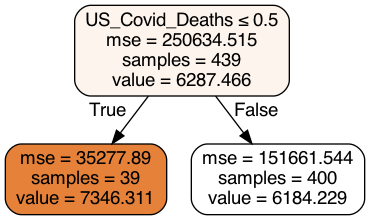

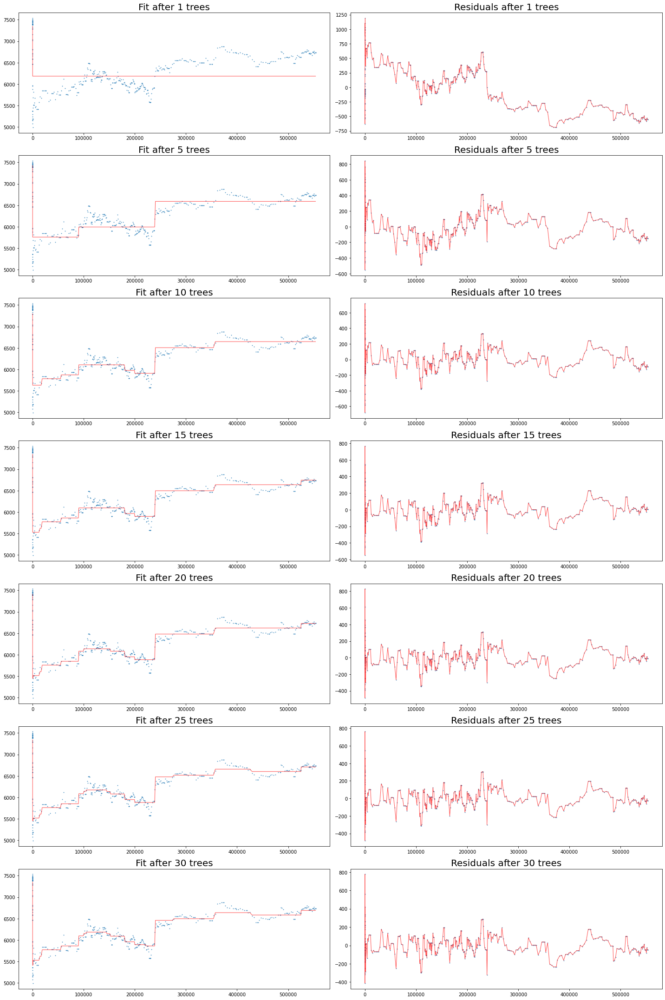

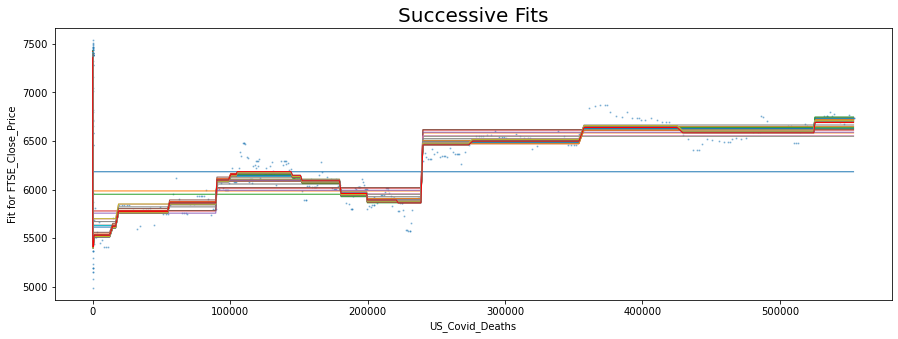

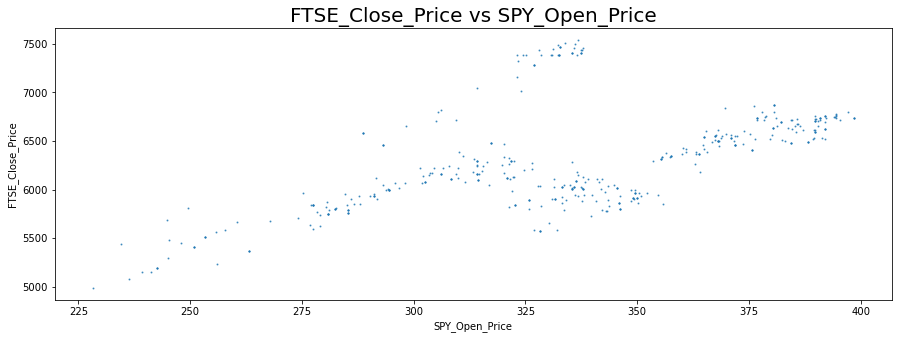

First of 30 decision trees of 1-deep:


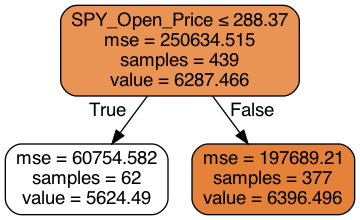

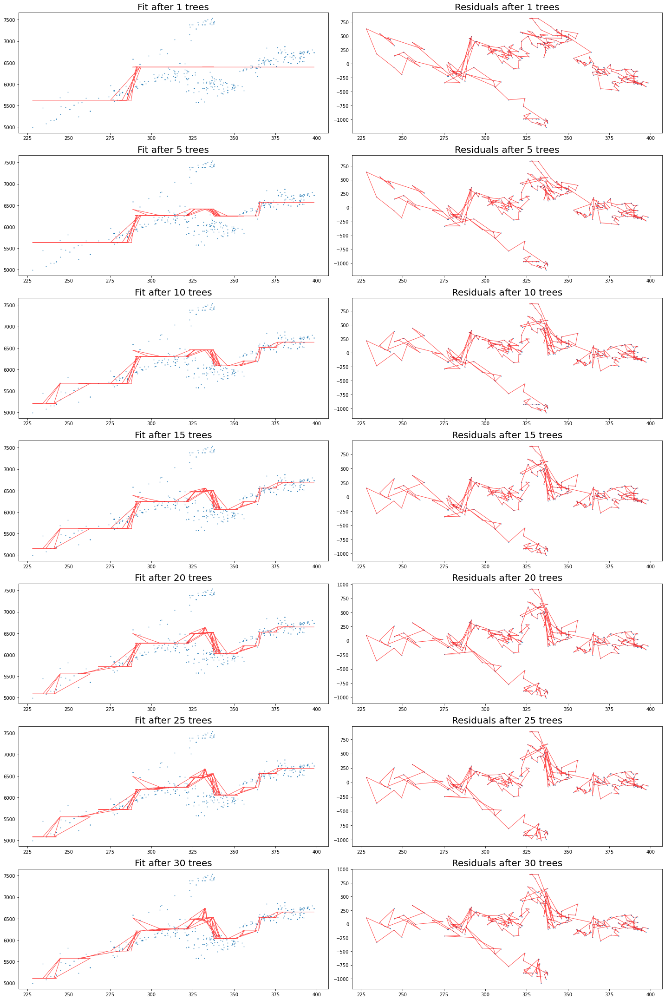

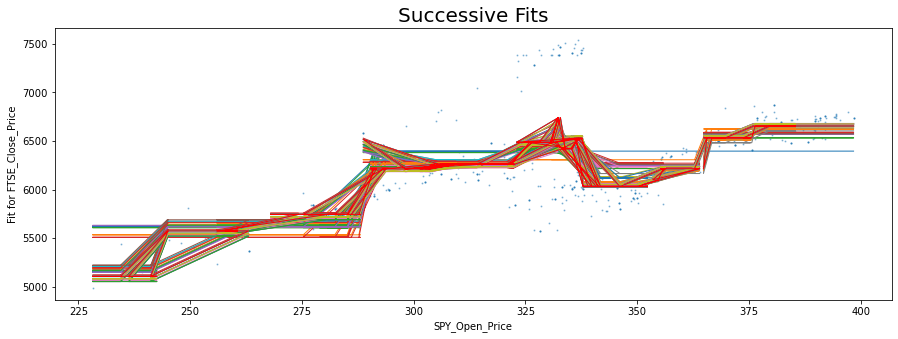

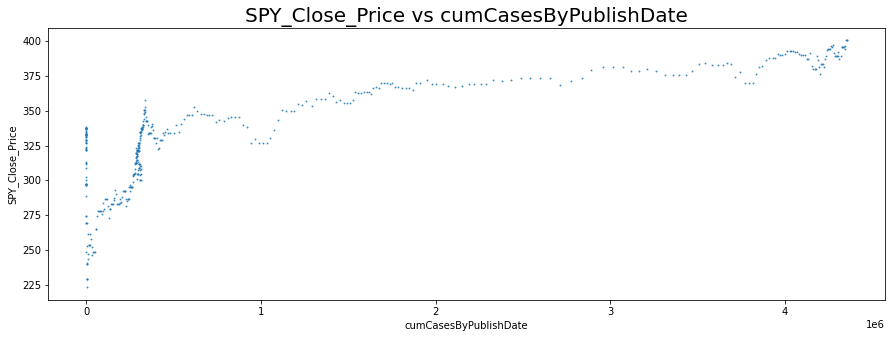

First of 30 decision trees of 1-deep:


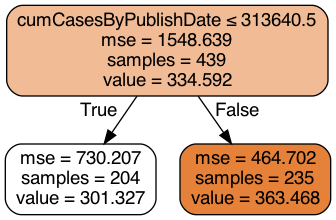

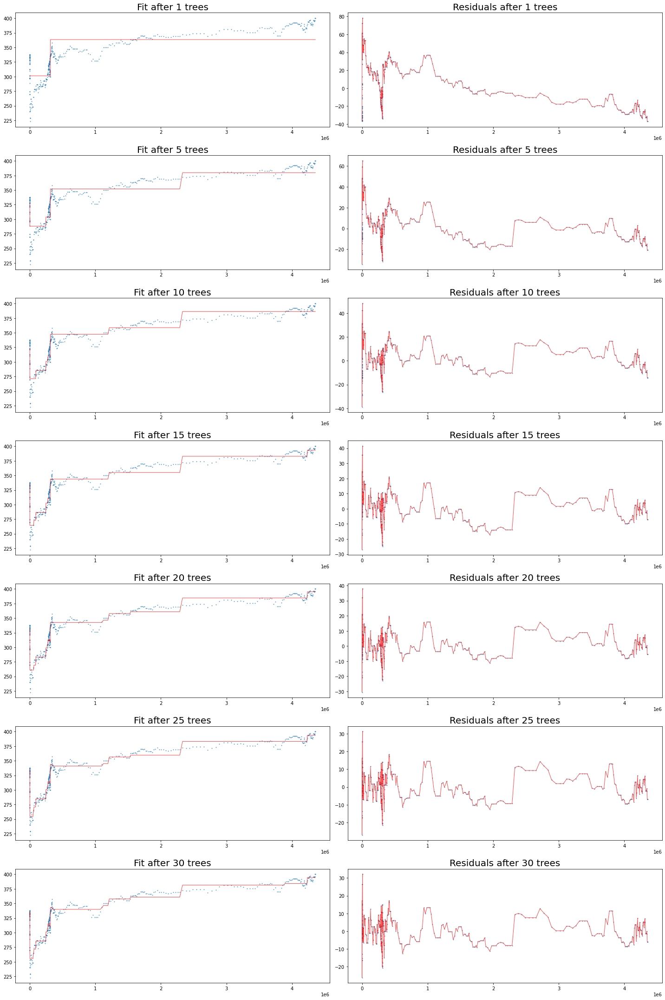

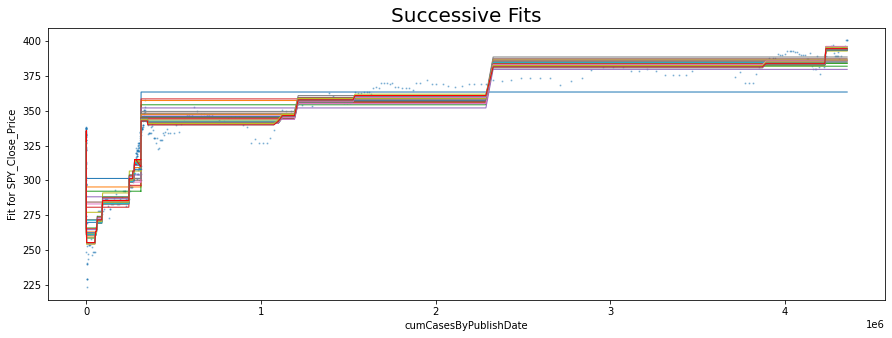

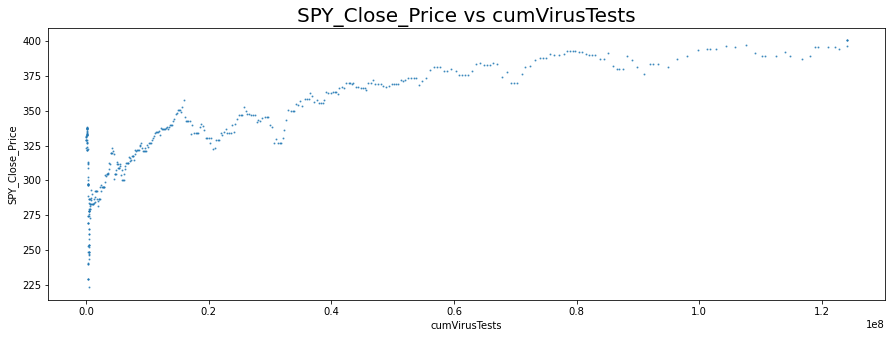

First of 30 decision trees of 1-deep:


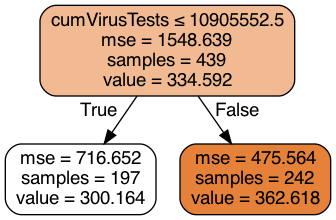

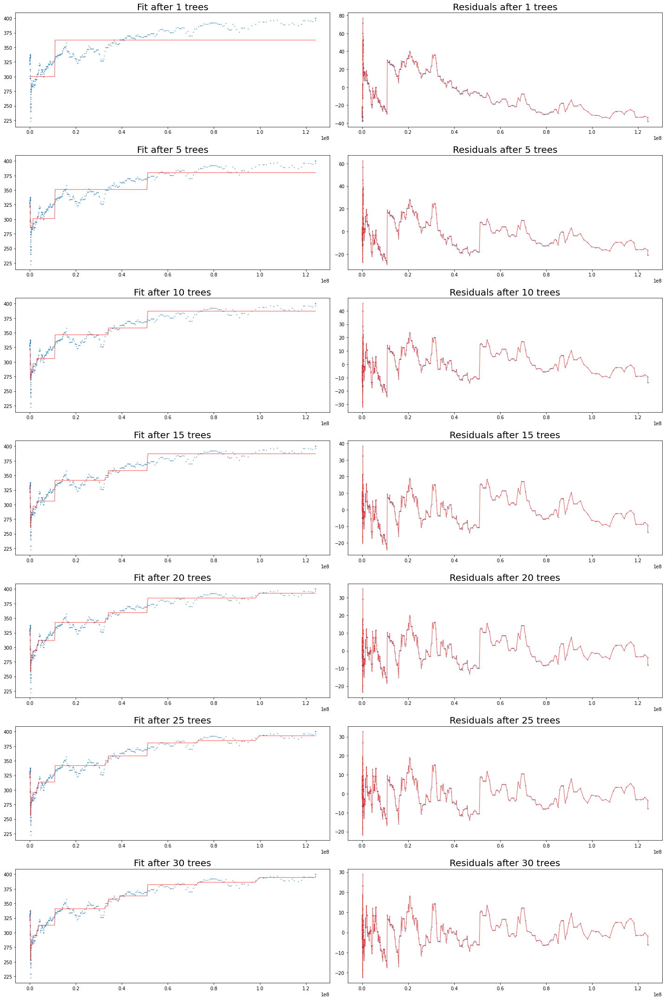

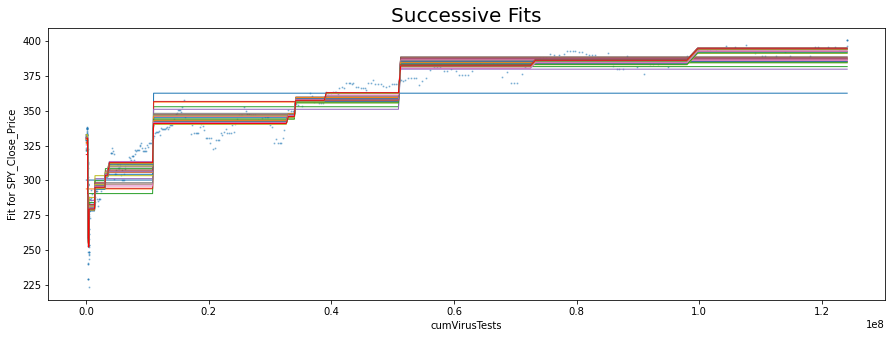

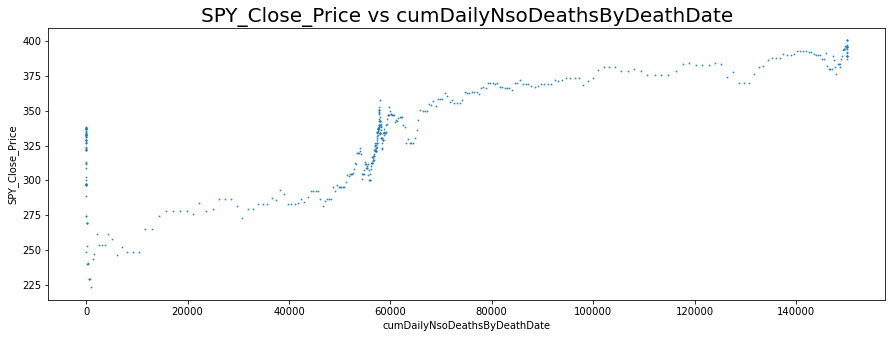

First of 30 decision trees of 1-deep:


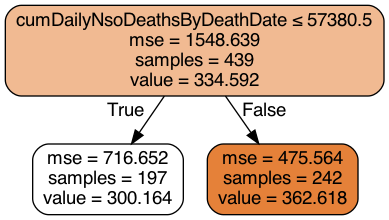

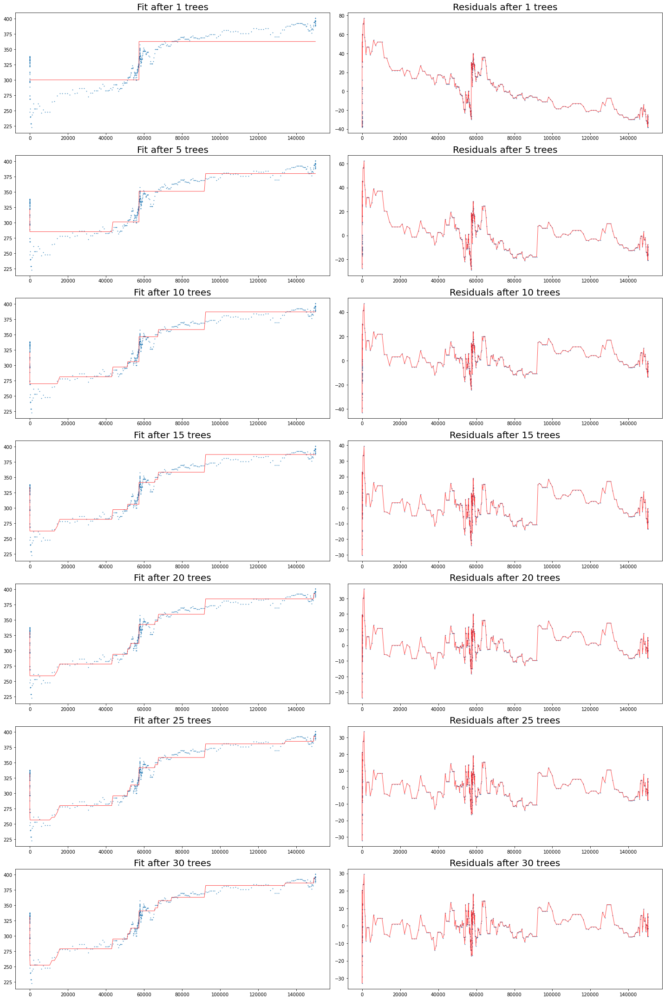

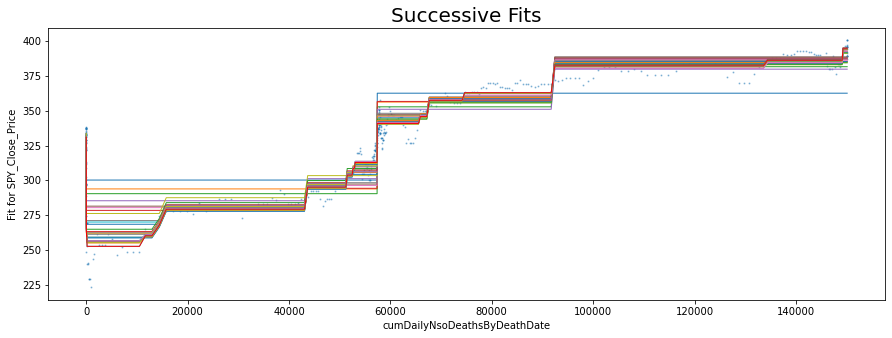

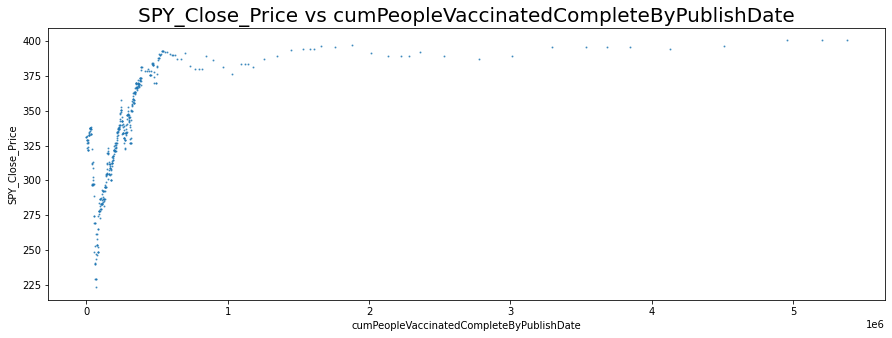

First of 30 decision trees of 1-deep:


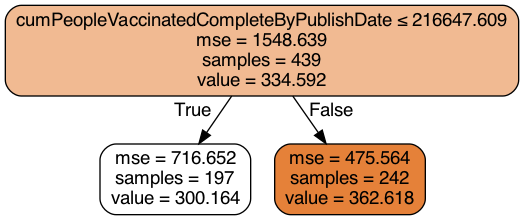

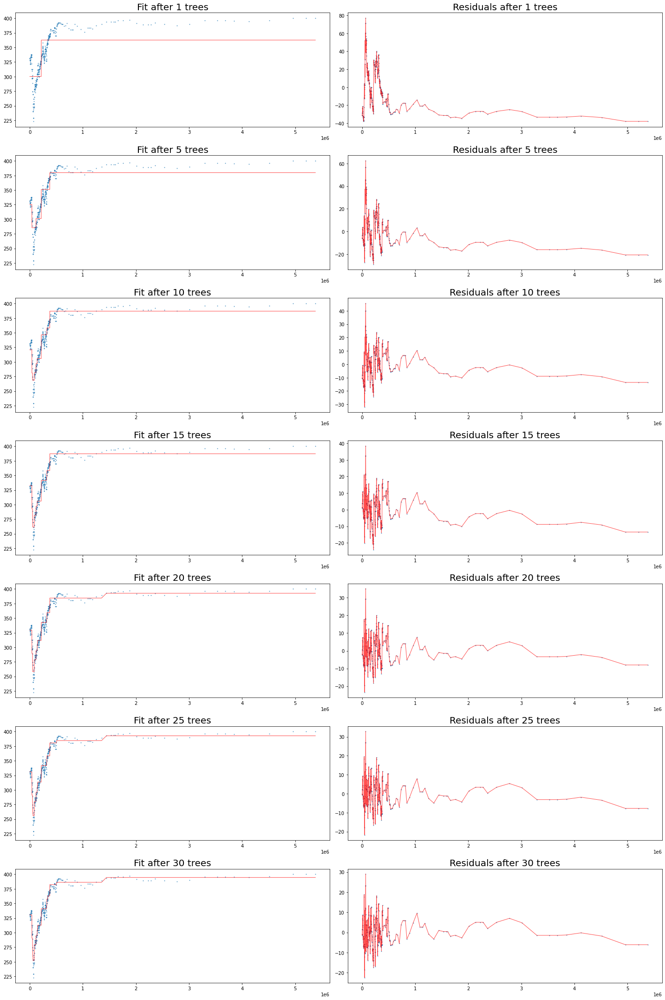

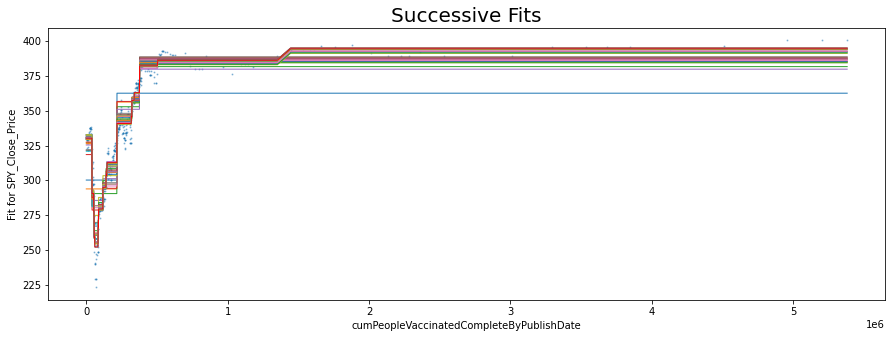

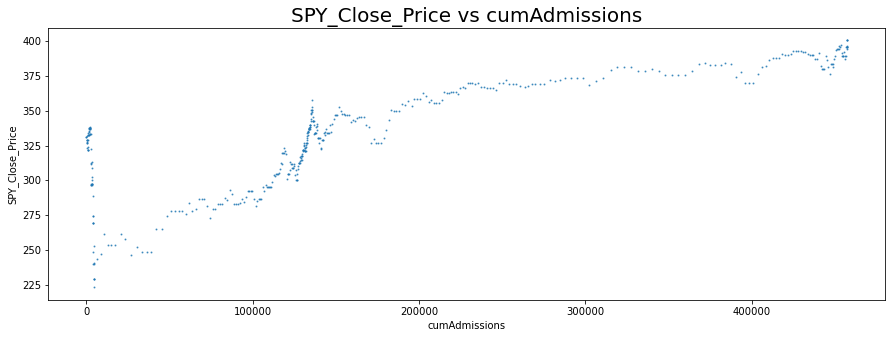

First of 30 decision trees of 1-deep:


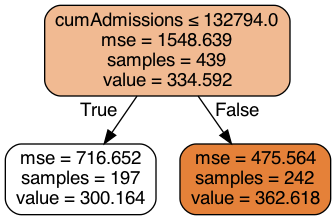

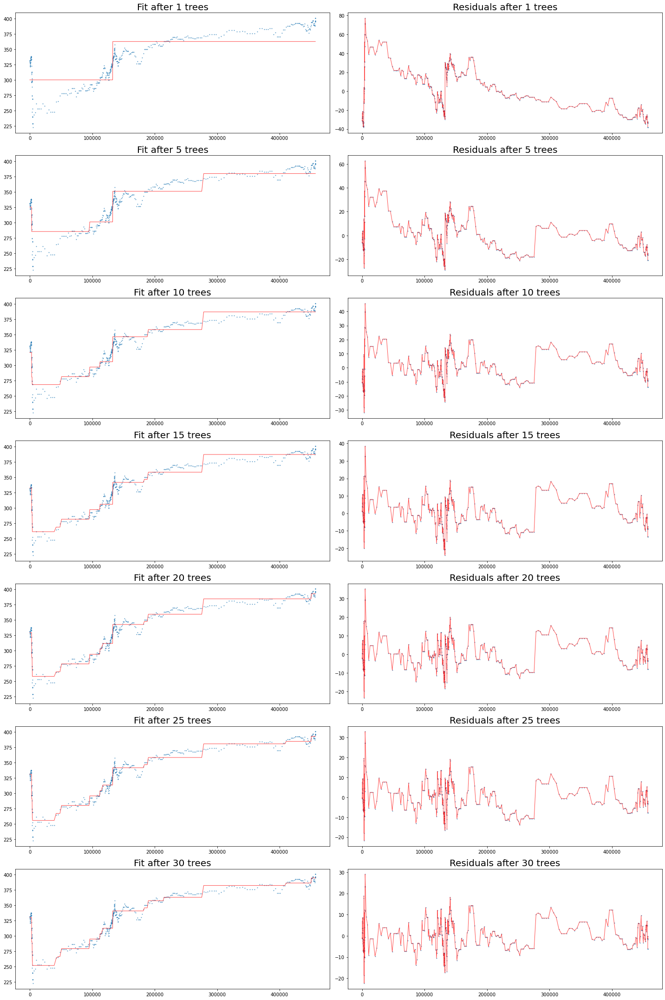

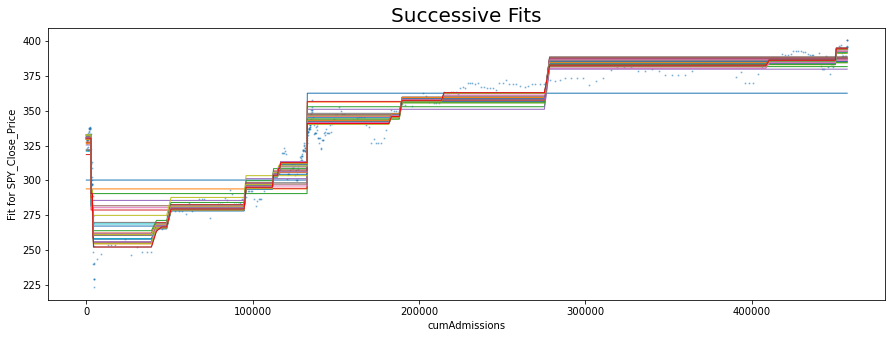

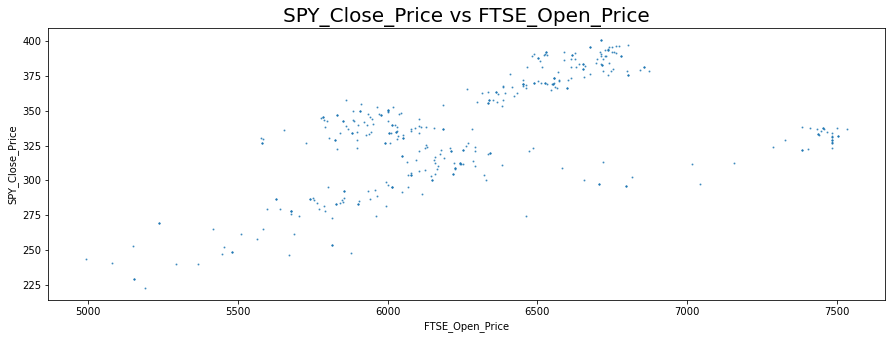

First of 30 decision trees of 1-deep:


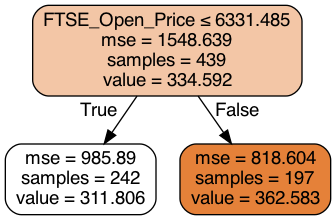

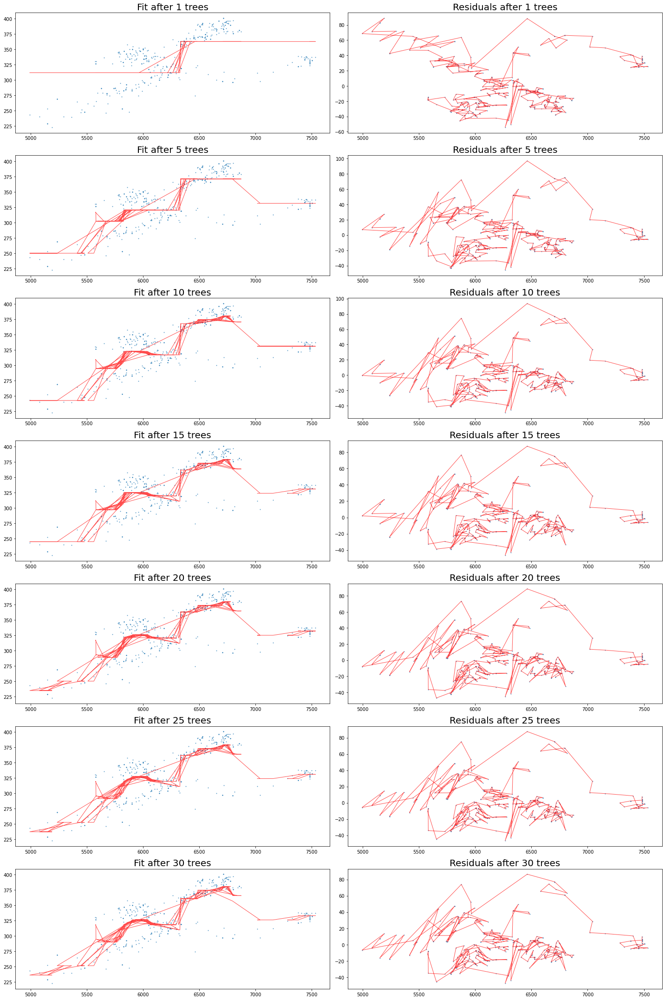

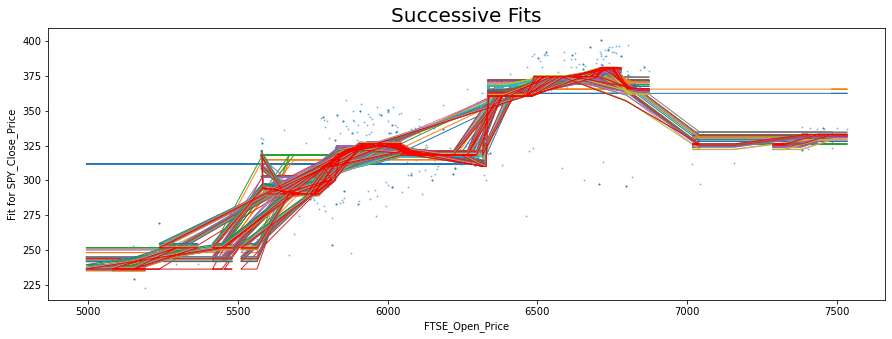

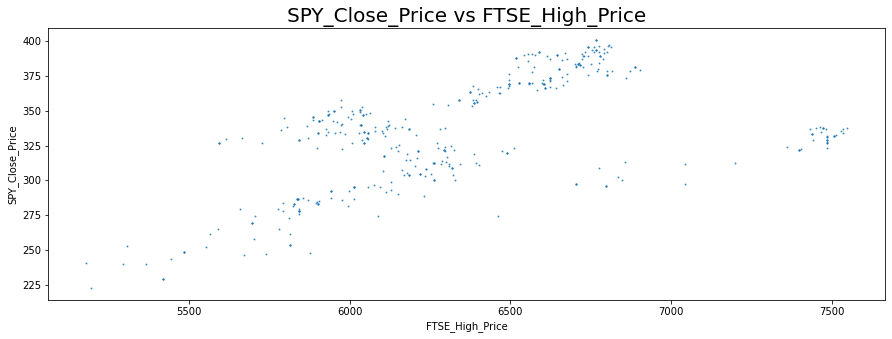

First of 30 decision trees of 1-deep:


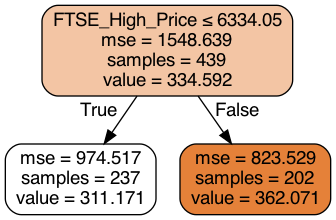

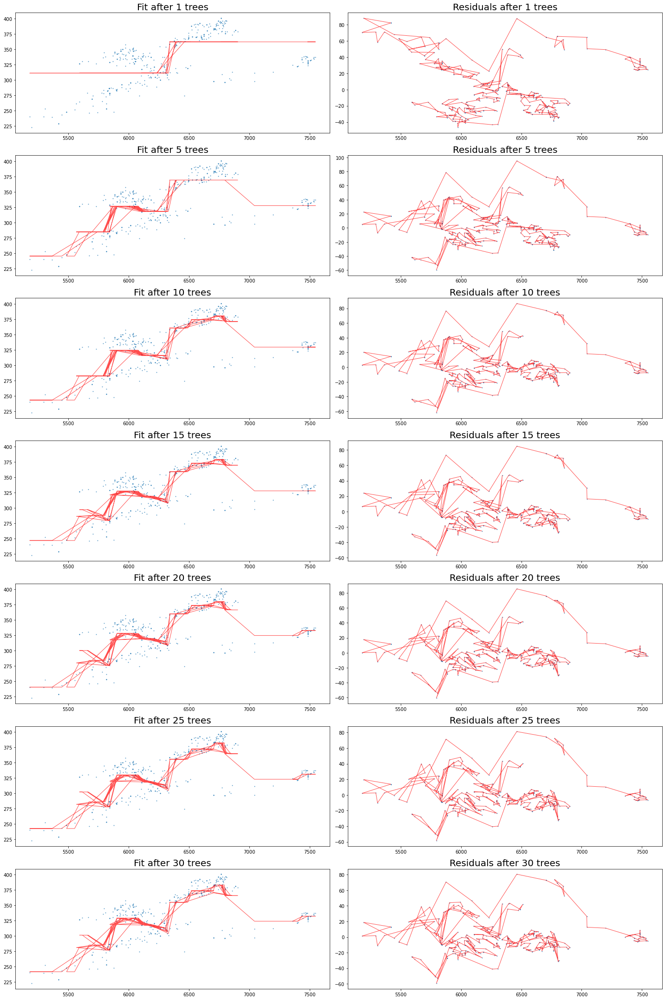

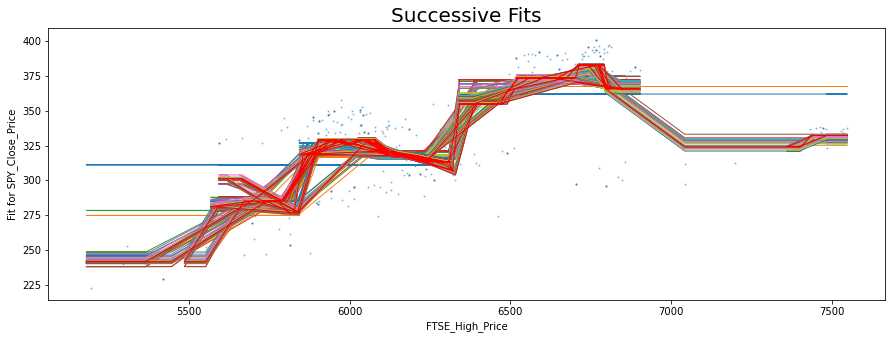

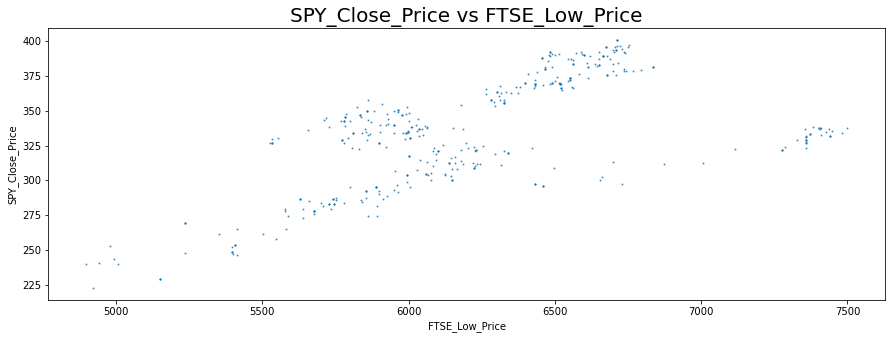

First of 30 decision trees of 1-deep:


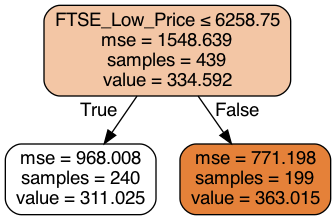

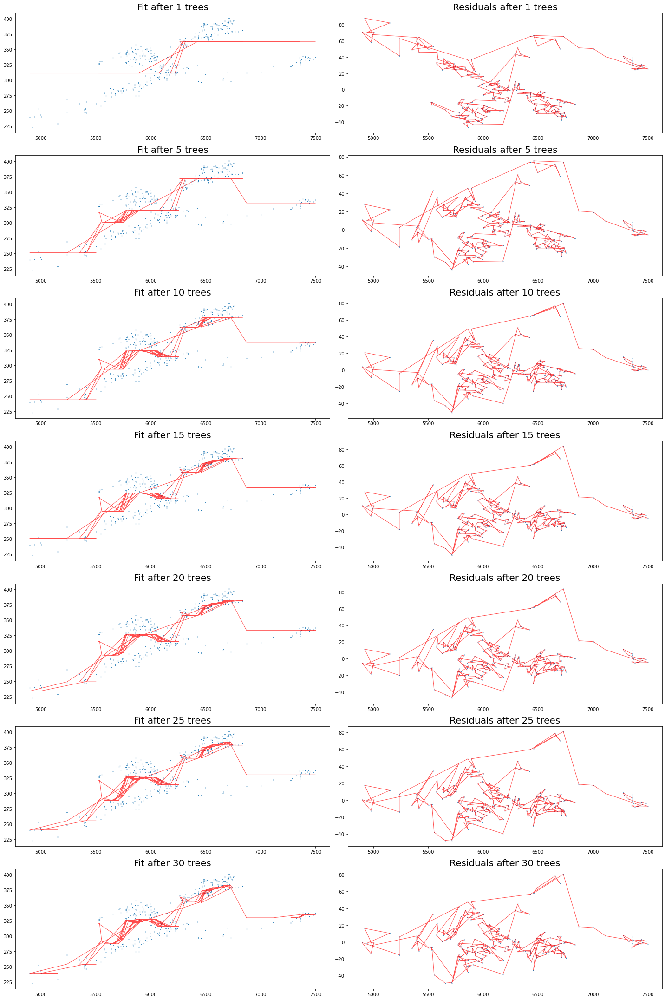

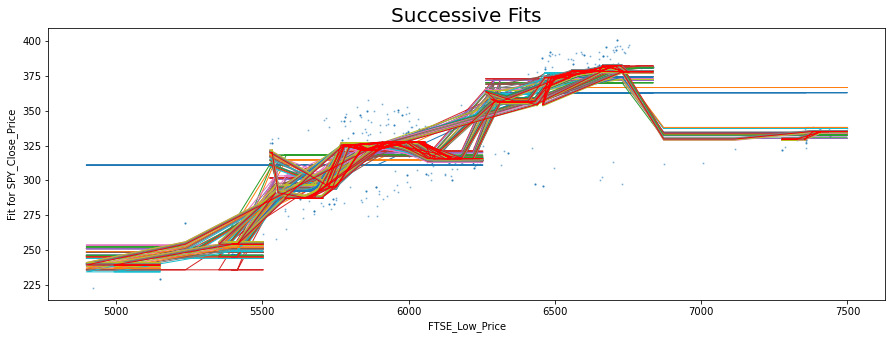

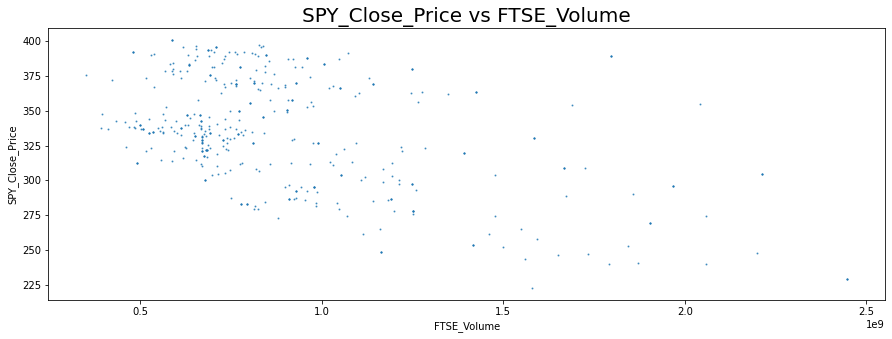

First of 30 decision trees of 1-deep:


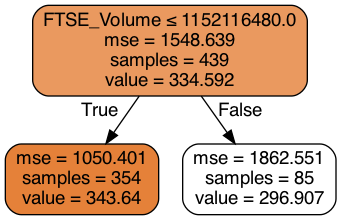

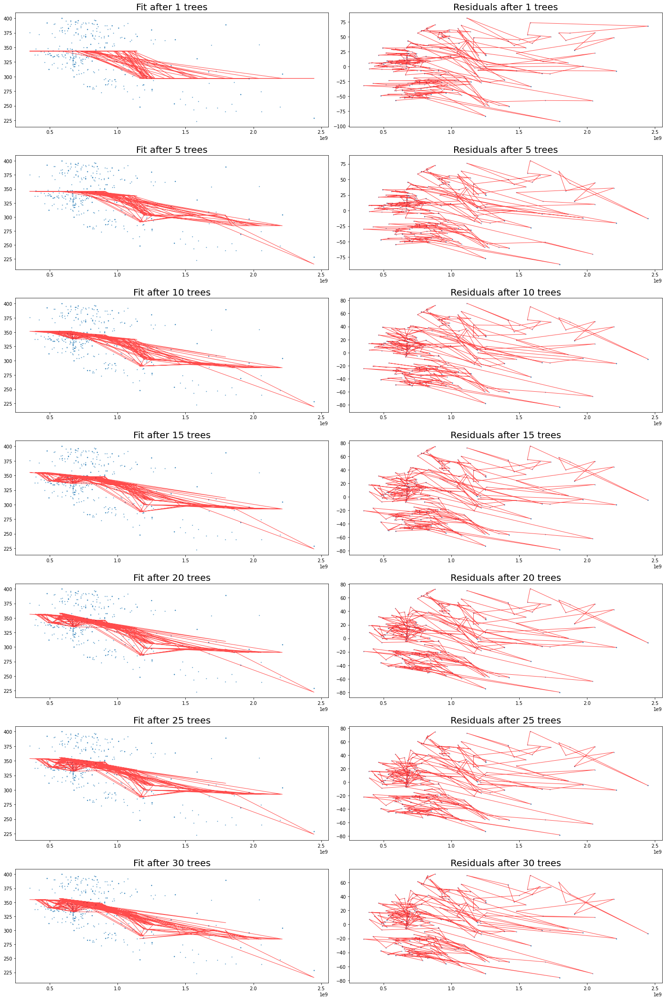

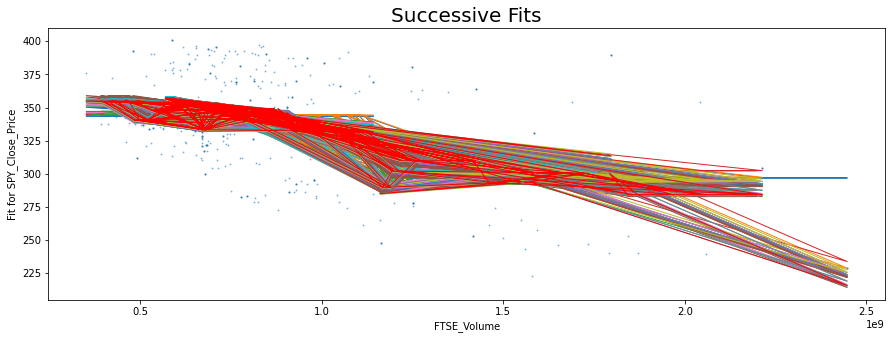

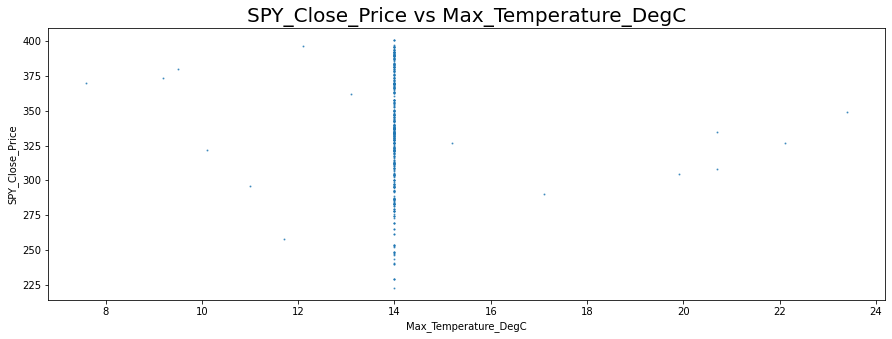

First of 30 decision trees of 1-deep:


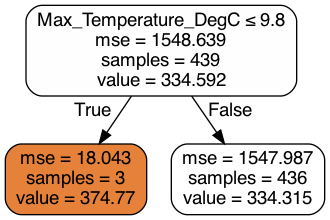

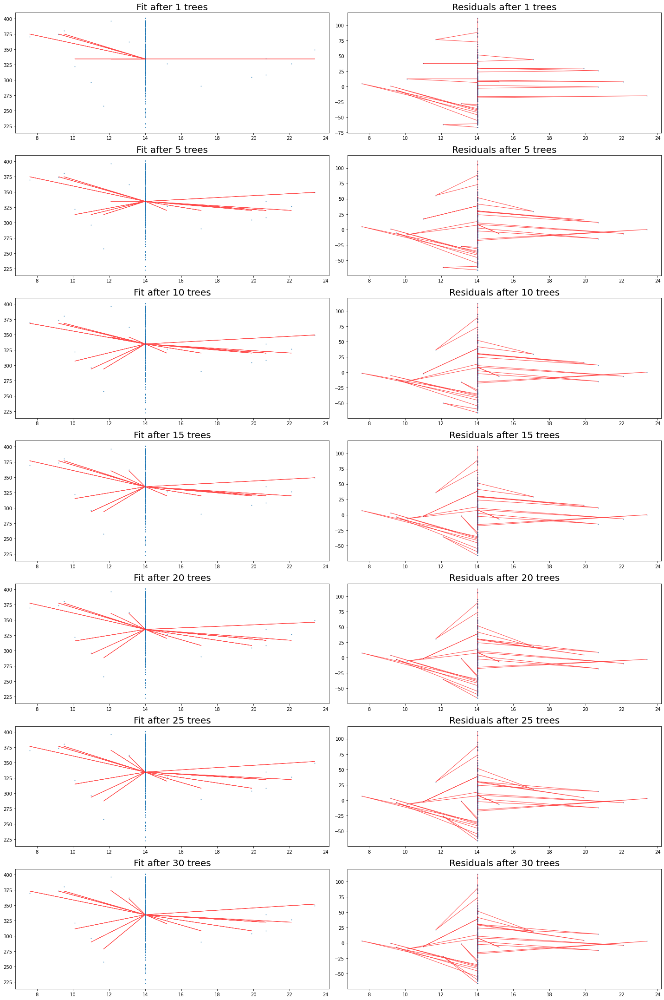

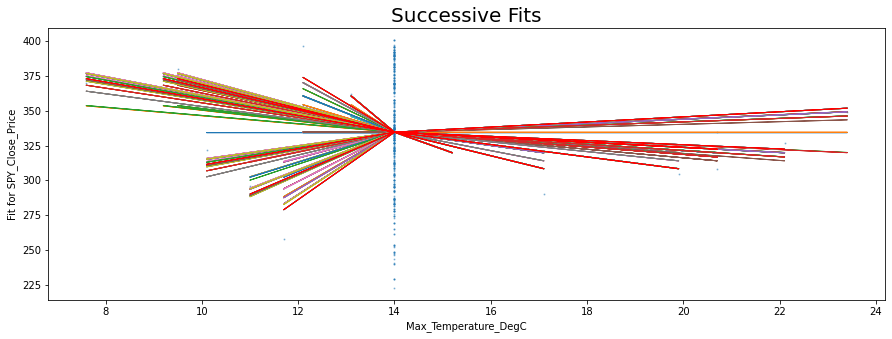

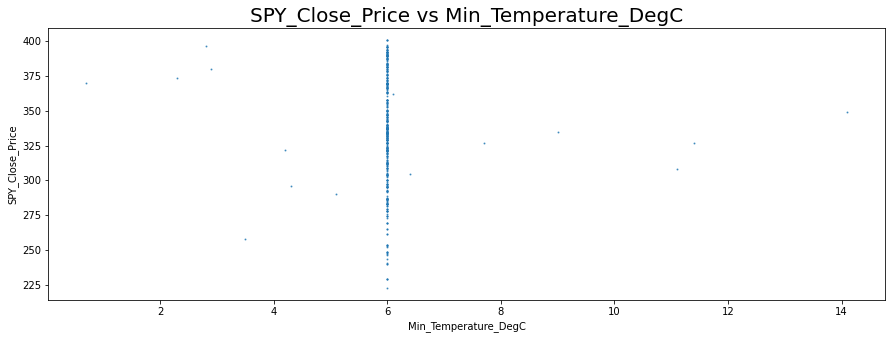

First of 30 decision trees of 1-deep:


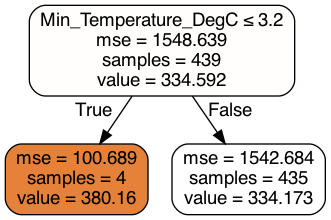

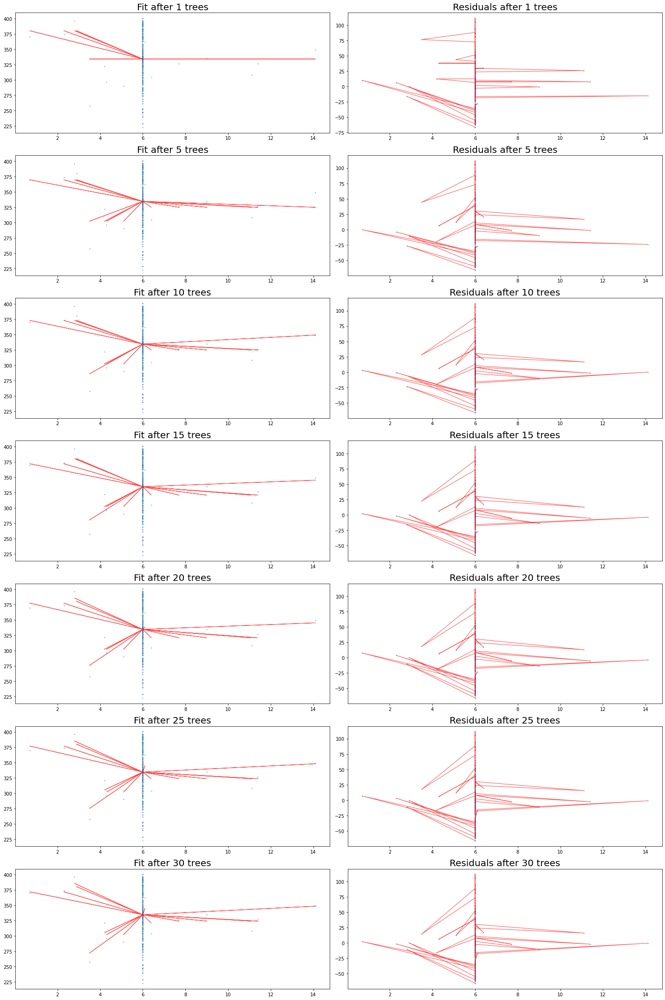

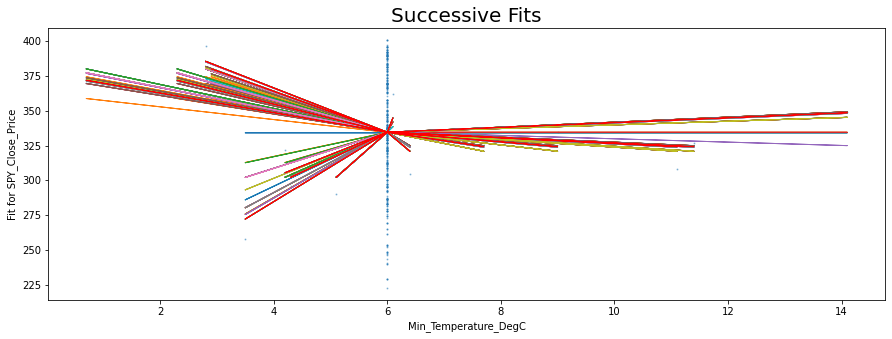

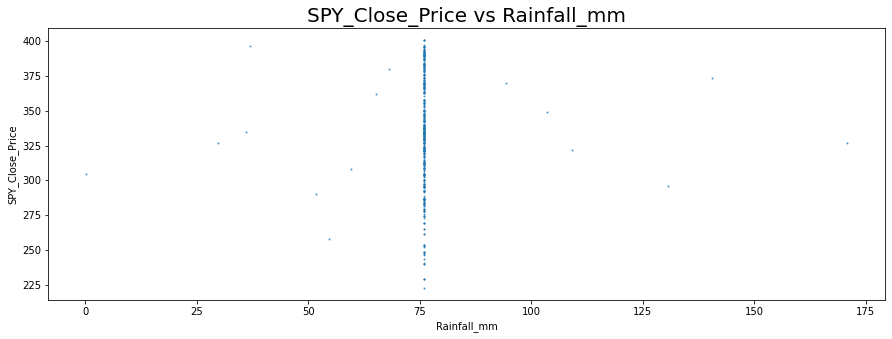

First of 30 decision trees of 1-deep:


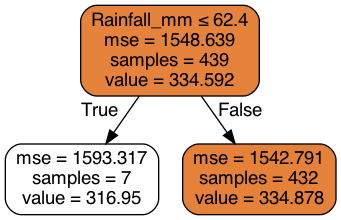

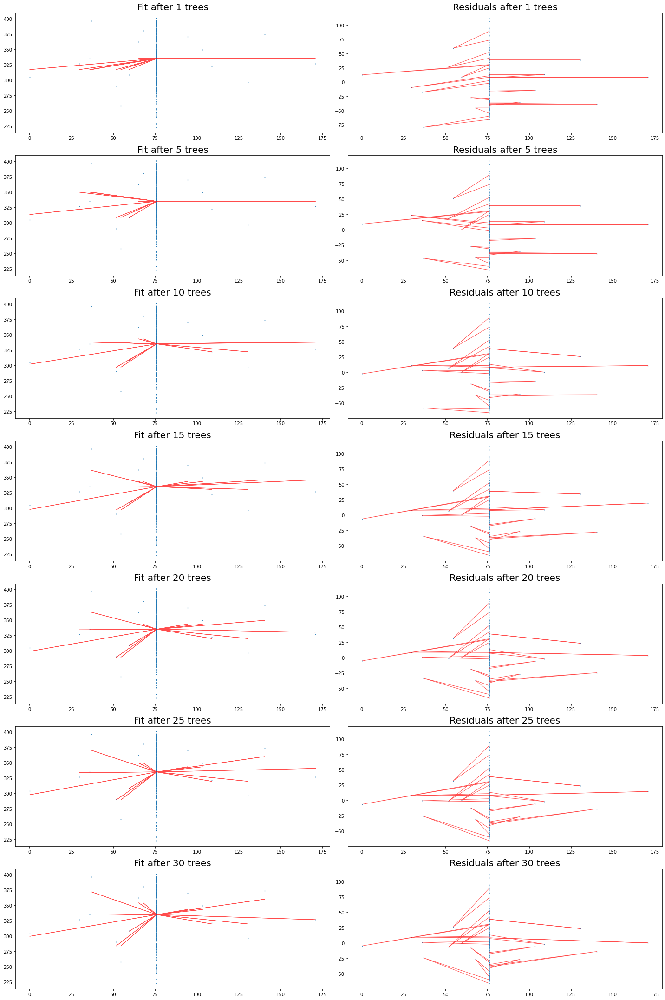

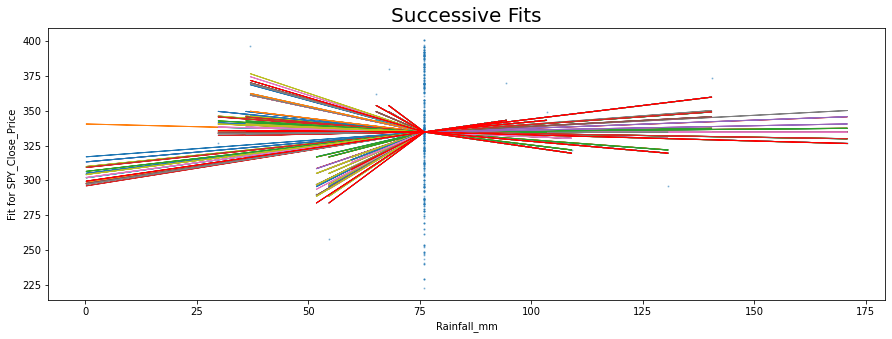

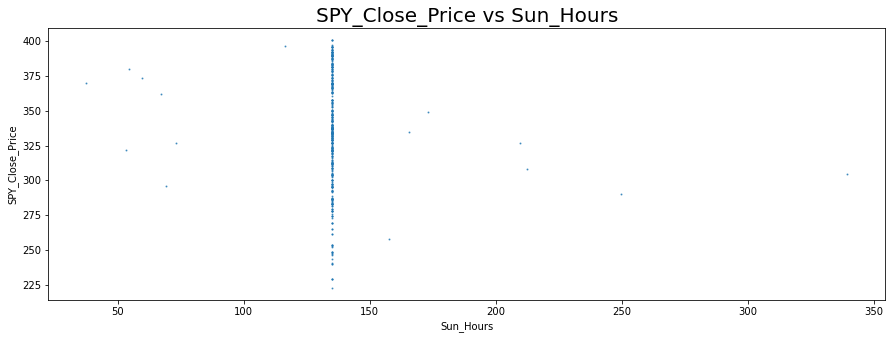

First of 30 decision trees of 1-deep:


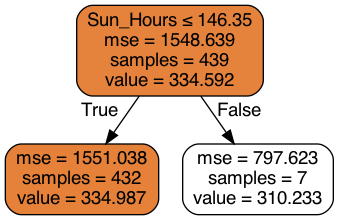

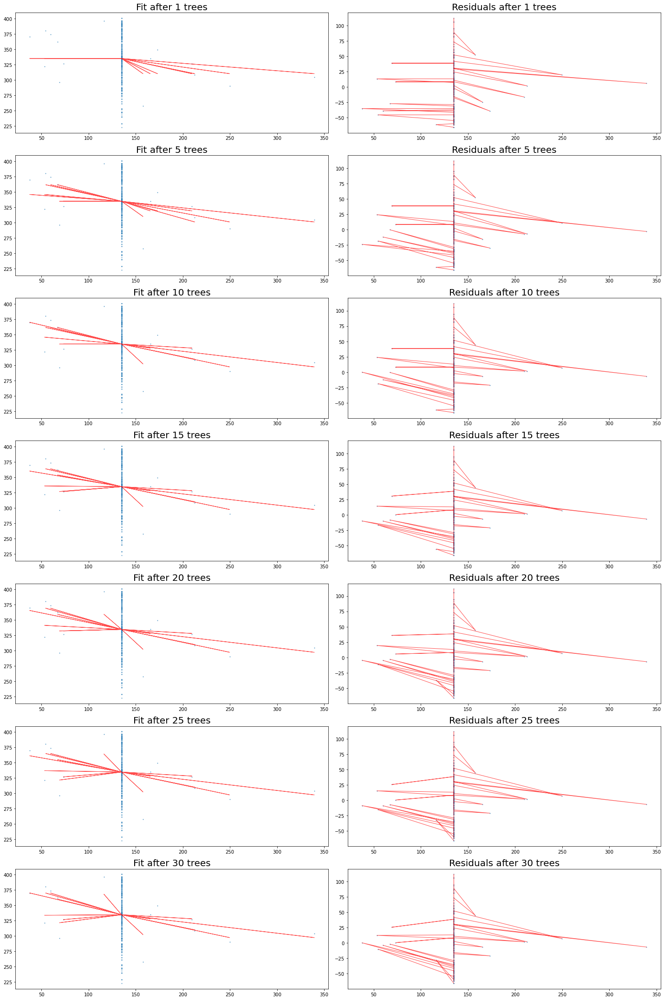

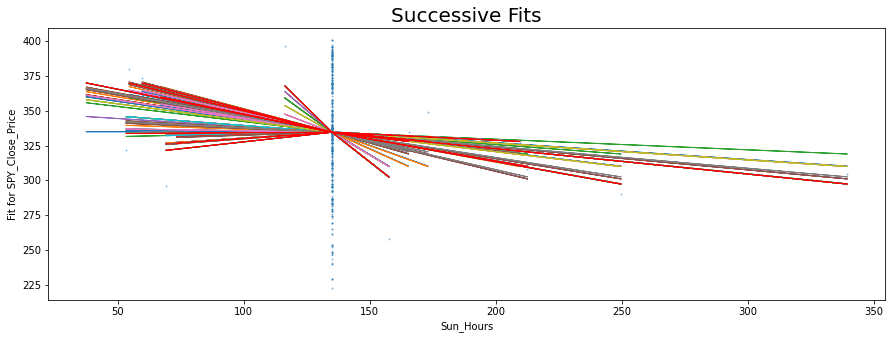

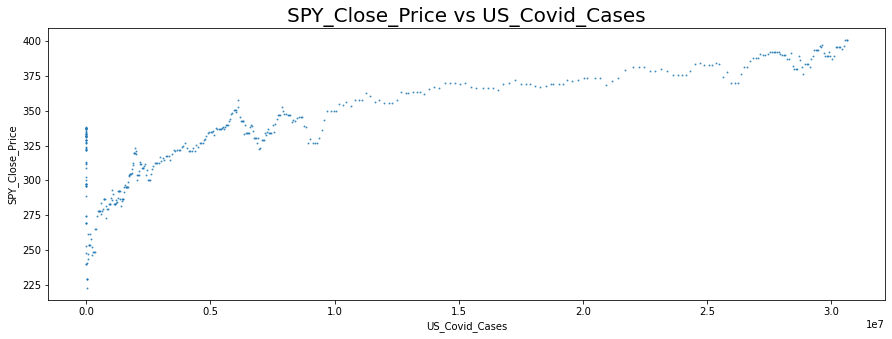

First of 30 decision trees of 1-deep:


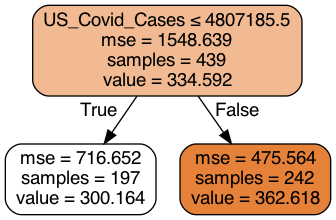

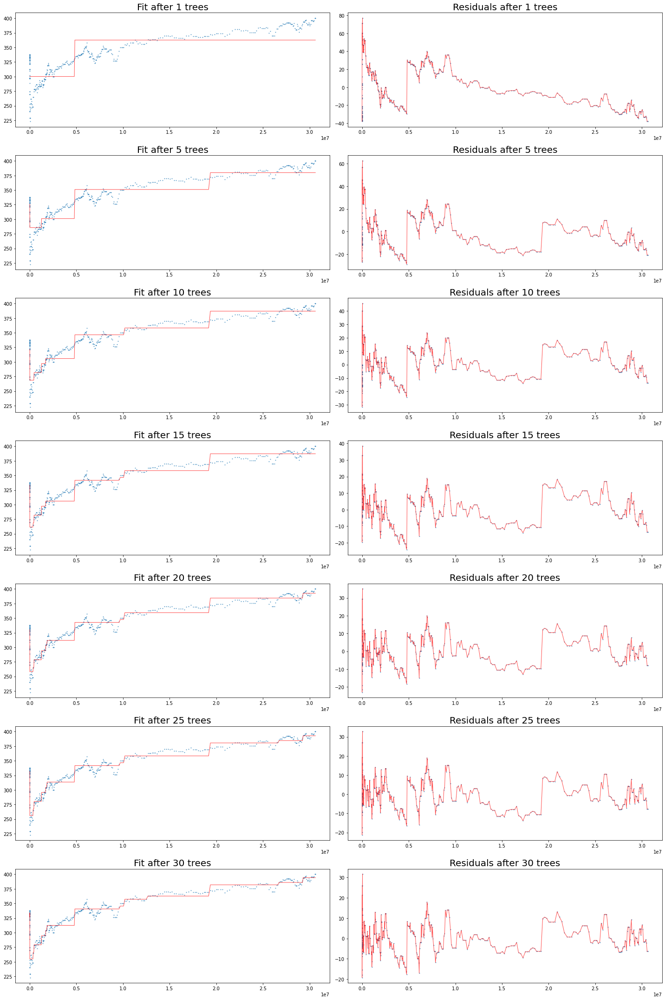

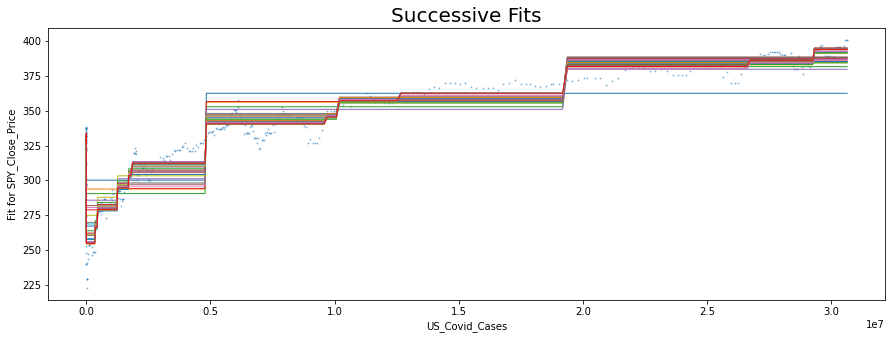

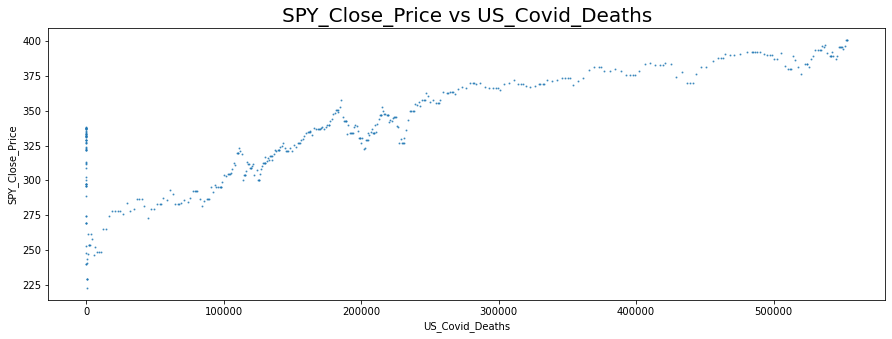

First of 30 decision trees of 1-deep:


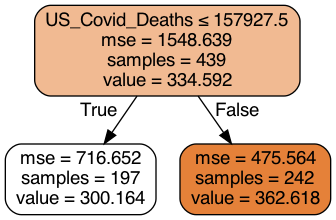

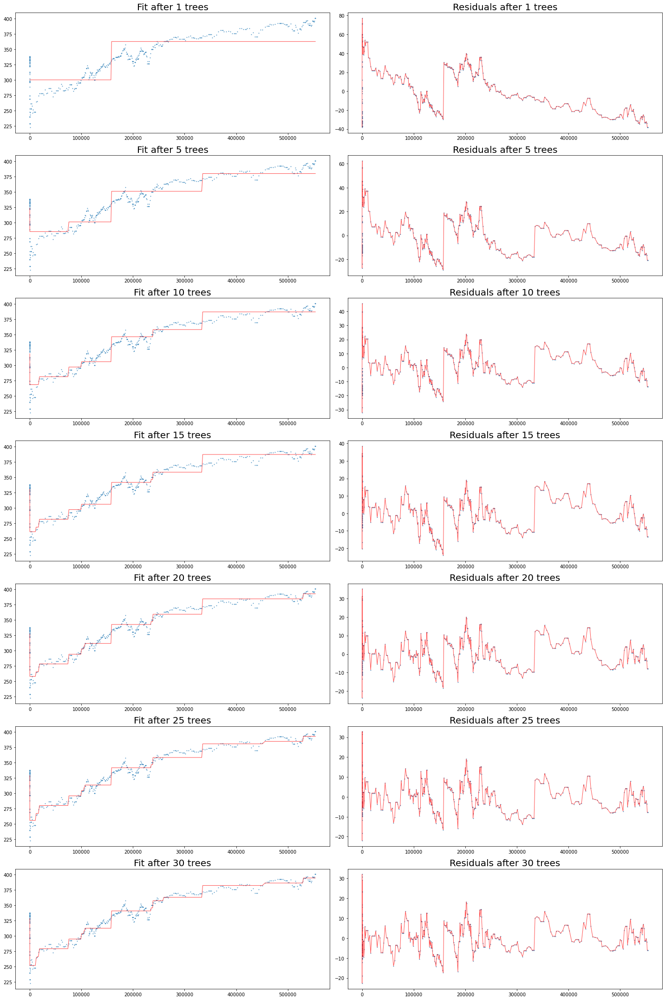

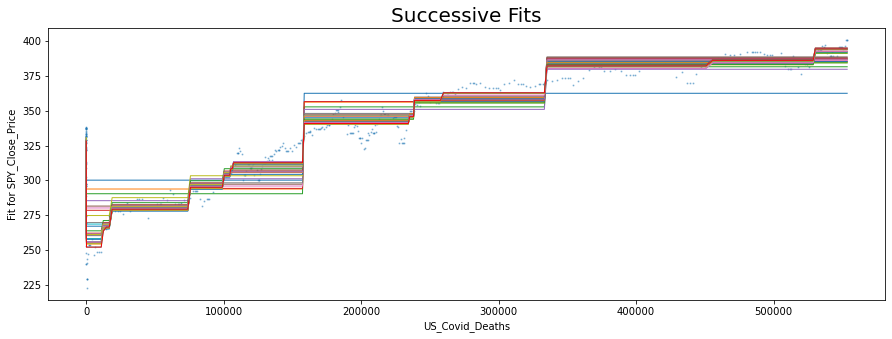

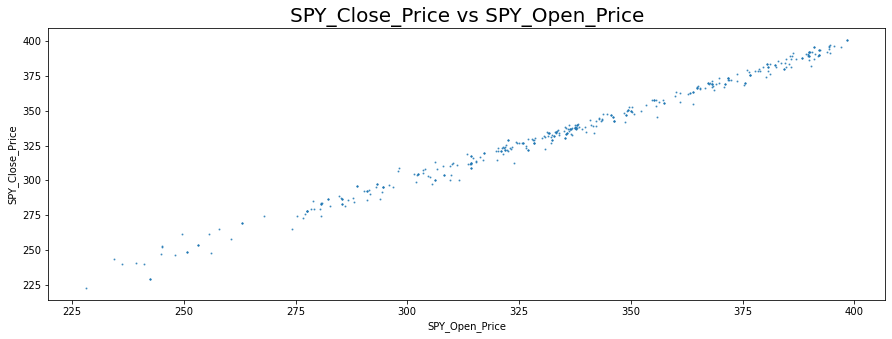

First of 30 decision trees of 1-deep:


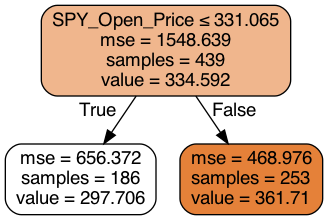

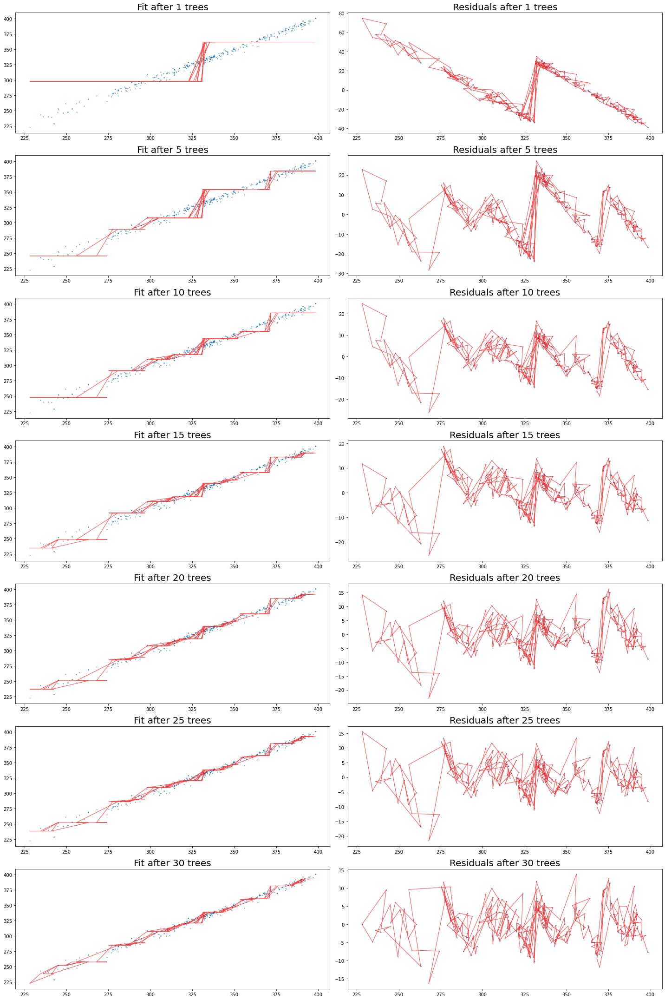

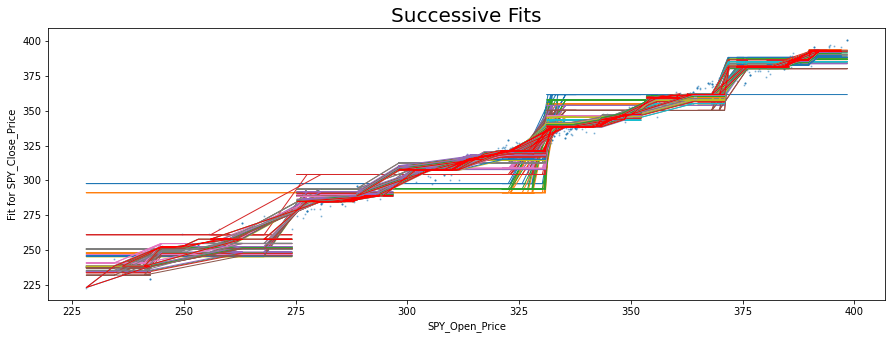

In [40]:
#Decision Tree Boosting explanation

#Boosting corrects the mistakes of previous learners by fitting patterns in residuals

#https://towardsdatascience.com/gradient-boosting-is-one-of-the-most-effective-ml-techniques-out-there-af6bfd0df342

from sklearn.tree import DecisionTreeRegressor
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
from IPython.core.display import display, HTML
display(HTML('<style>.container { width:100% !important; }</style>'))
display(HTML('<style>div.output_scroll { height: 31em; }</style>'))
import numpy as np

columns = ['cumCasesByPublishDate', 'cumVirusTests',
       'cumDailyNsoDeathsByDeathDate',
       'cumPeopleVaccinatedCompleteByPublishDate', 'cumAdmissions',
       'FTSE_Open_Price', 'FTSE_High_Price',
       'FTSE_Low_Price', 'FTSE_Volume', 'Max_Temperature_DegC',
       'Min_Temperature_DegC', 'Rainfall_mm', 'Sun_Hours', 'US_Covid_Cases',
       'US_Covid_Deaths', 'SPY_Open_Price']

variables = ['FTSE_Close_Price', 'SPY_Close_Price']

df_clean = pd.read_csv('cleaned_data.csv', index_col=0)

for variable in variables:
    for column in columns:
        #X is evenly spaced between 0 & 10:
        X = df_clean[column]
        X = X[:, np.newaxis]
        y = df_clean[variable]
        #change X from 1 to 2 dimensional:
        Xnames = ['{0}'.format(column)]

        #plot y vs X:

        plt.figure(figsize=(15, 5))
        plt.title('{0} vs {1}'.format(variable, column), fontsize=20)
        plt.xlabel('{0}'.format(column))
        plt.ylabel('{0}'.format(variable));
        plt.scatter(X, y, alpha=.7);
        plt.show()

        def many_trees(n_trees, **kwargs):
            #returns a list of n_trees 'empty' decision trees
            #**kwargs allows passing of any number of keyword arguments
            trees = [DecisionTreeRegressor(**kwargs) for i in range(n_trees)]
            return trees

        def learners_for_residuals(trees, X, y):
            #trains the decision trees sequentially
            #    first fitting the target outcome y with tree_0
            #    then from tree_1 to tree_(n-1) fits the residuals
            boosters = []
            for tree in trees:
                tree.fit(X, y)
                yhat = tree.predict(X)
                #set next y as residual of current y
                y = y - yhat
                boosters.append(tree)
            return boosters

        def many_fits(trees, X):
            #iterates through the list of learner decision trees and returns each tree's fit for common X
            #each learner has its own y (different stages of residuals)
            return np.array([tree.predict(X) for tree in trees]).T

        #make the learners extremely week by setting the max-depth of each tree to 1
        #    limits each tree to one split of X when fitting y:
        learners = many_trees(30, max_depth=1)
        #more generally, could also limit number of Xs (by regularization)

        #fits the decision trees sequentially:
        boosters = learners_for_residuals(learners, X, y)
        boosted_yhat = many_fits(boosters, X)

        #plot 1st tree:
        print('First of', len(boosters) , 'decision trees of 1-deep:')
        from sklearn import tree
        import pydot
        from IPython.display import Image
        display(Image(pydot.graph_from_dot_data(tree.export_graphviz(boosters[0], feature_names=Xnames,
                                   filled=True, rounded=True, special_characters=True))[0].create_png()))

        def plot_fits(n_trees, plt_row, X, boosted_yhat):
            #sums the fits of n trees and returns plots of the fitted line and the residuals
            boosted_fit = boosted_yhat[:, :n_trees].sum(1)
            res = boosted_fit - y
            axes[plt_row, 0].scatter(X, y, alpha=0.7)
            axes[plt_row, 0].plot(X, boosted_fit, c='red', alpha=0.7)
            axes[plt_row, 0].set_title(f'Fit after {n_trees} trees', fontsize=20)
            axes[plt_row, 1].scatter(X, res, alpha=0.7)
            axes[plt_row, 1].plot(X, res, color='r', alpha=0.7)
            axes[plt_row, 1].set_title(f'Residuals after {n_trees} trees', fontsize=20)

        #plot boosting progress:

        fig, axes = plt.subplots(nrows=7, ncols=2, figsize=(20,30))
        plot_fits(1, 0, X, boosted_yhat)
        plot_fits(5, 1, X, boosted_yhat)
        plot_fits(10, 2, X, boosted_yhat)
        plot_fits(15, 3, X, boosted_yhat)
        plot_fits(20, 4, X, boosted_yhat)
        plot_fits(25, 5, X, boosted_yhat)
        plot_fits(30, 6, X, boosted_yhat)
        #the line appears to be a decent fit for the data, and residuals finally looked quite random

        fig.tight_layout()
        plt.show()

        #plot successive fits together:

        plt.figure(figsize=(15, 5))

        sumfits = 0
        for i in range(len(learners)):
            #plot each fit across the data by adding each succesive set of fits and plotting the line
            sumfits += boosted_yhat[:, i]
            plt.plot(X, sumfits)
        #add final fit in red:
        plt.plot(X, many_fits(learners, X).sum(1), c='red', alpha=1)
        plt.title('Successive Fits', fontsize=20)
        plt.xlabel('{0}'.format(column))
        plt.ylabel('Fit for {0}'.format(variable));

        plt.scatter(X, y, alpha=.4)
        plt.show()

## K Nearest Neighbour Regression for FTSE Close Price


Below numbers change for each run:

Accuracy of  fit     , R² = 1.0
Accuracy for forecast, R² = 0.778683198771275 

Forecast root mean squared error = 223.71722960756247


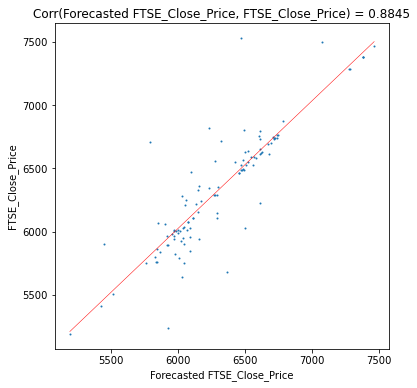

In [51]:
#K-Nearest Neighbor Regression

#import
import os
from sklearn.neighbors import KNeighborsRegressor
from sklearn.metrics import mean_squared_error
%matplotlib inline

from IPython.core.display import display, HTML
display(HTML("<style>div.output_scroll { height: 31em; }</style>")) #set height of output window below
#plt.rcParams['figure.figsize'] = 18, 8 #width & height for time-series plot
plt.rcParams['figure.figsize'] = 6.000, 6.000
plt.rcParams['lines.linewidth'] = 1
plt.rcParams['lines.markersize'] = 1

df_clean = pd.read_csv('cleaned_data.csv', index_col=0) #read csv file
df_clean["date"] = pd.to_numeric(df_clean["date"], errors="coerce", downcast="integer")

df_knnr = df_clean.copy()
y=df_knnr.pop('FTSE_Close_Price')
df_knnr.insert(0,'FTSE_Close_Price',y)
X = df_knnr.iloc[:,2:]

#Split into random train and test subsets, for cross validation:
X_train, X_test, y_train, y_test = train_test_split(X, y)

mod = KNeighborsRegressor(11, weights='distance') # k=11 neighbors; weights are inverse of distances
mod.fit(X_train, y_train)
y_pred = mod.predict(X_test)

print('\nBelow numbers change for each run:') #because test dataset randomly selected
#unlike OLS, this R² is not corr(y_pred, y_test)**2 :
print('\nAccuracy of  fit     , R² =', mod.score(X_train, y_train)) #must have called .fit()
print('Accuracy for forecast, R² =', mod.score(X_test, y_test), '\n')

print('Forecast root mean squared error =', mean_squared_error(y_pred, y_test,squared=False))

s, i = np.polyfit(y_pred, y_test, 1) #s=slope, i=intercept; for best-fit 1-degree polynomial
a, b = min(y_pred), max(y_pred)

#line drawn below is theoretically misleading when used for multiple regression,
#    as it doesn't represent the fitting process:
#plot 'best-fit' line; increase linewidth for darker line:
plt.plot([a, b], i + [s * a, s * b], color='red', linewidth=0.5)
del s, i, a, b
    
plt.scatter(y_pred, y_test)
xname = 'Forecasted ' + y.name
plt.xlabel(xname)
plt.ylabel(y.name)
plt.title('Corr(' + xname + ', ' + y.name + ') = ' + str(round(pd.concat([y_test,
                 pd.Series(y_pred, index=y_test.index)], 1).corr().iloc[0, 1], 4)))
plt.show()

## K Nearest Neighbour Regression for SPY Close Price


Below numbers change for each run:

Accuracy of  fit     , R² = 1.0
Accuracy for forecast, R² = 0.8703707132600846 

Forecast root mean squared error = 14.862118730954258


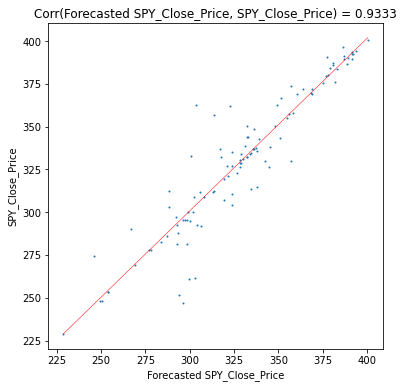

In [52]:
#K-Nearest Neighbor Regression

#import
import os
from sklearn.neighbors import KNeighborsRegressor
from sklearn.metrics import mean_squared_error
%matplotlib inline

from IPython.core.display import display, HTML
display(HTML("<style>div.output_scroll { height: 31em; }</style>")) #set height of output window below
#plt.rcParams['figure.figsize'] = 18, 8 #width & height for time-series plot
plt.rcParams['figure.figsize'] = 6.000, 6.000
plt.rcParams['lines.linewidth'] = 1
plt.rcParams['lines.markersize'] = 1

df_clean = pd.read_csv('cleaned_data.csv', index_col=0) #read csv file
df_clean["date"] = pd.to_numeric(df_clean["date"], errors="coerce", downcast="integer")

df_knnr = df_clean.copy()
y=df_knnr.pop('SPY_Close_Price')
df_knnr.insert(0,'SPY_Close_Price',y)
X = df_knnr.iloc[:,2:]

#Split into random train and test subsets, for cross validation:
X_train, X_test, y_train, y_test = train_test_split(X, y)

mod = KNeighborsRegressor(11, weights='distance') # k=11 neighbors; weights are inverse of distances
mod.fit(X_train, y_train)
y_pred = mod.predict(X_test)

print('\nBelow numbers change for each run:') #because test dataset randomly selected
#unlike OLS, this R² is not corr(y_pred, y_test)**2 :
print('\nAccuracy of  fit     , R² =', mod.score(X_train, y_train)) #must have called .fit()
print('Accuracy for forecast, R² =', mod.score(X_test, y_test), '\n')

print('Forecast root mean squared error =', mean_squared_error(y_pred, y_test,squared=False))

s, i = np.polyfit(y_pred, y_test, 1) #s=slope, i=intercept; for best-fit 1-degree polynomial
a, b = min(y_pred), max(y_pred)

#line drawn below is theoretically misleading when used for multiple regression,
#    as it doesn't represent the fitting process:
#plot 'best-fit' line; increase linewidth for darker line:
plt.plot([a, b], i + [s * a, s * b], color='red', linewidth=0.5)
del s, i, a, b
    
plt.scatter(y_pred, y_test)
xname = 'Forecasted ' + y.name
plt.xlabel(xname)
plt.ylabel(y.name)
plt.title('Corr(' + xname + ', ' + y.name + ') = ' + str(round(pd.concat([y_test,
                 pd.Series(y_pred, index=y_test.index)], 1).corr().iloc[0, 1], 4)))
plt.show()

In [43]:
## import os

import math
import numpy as np
import pandas as pd
import time
import matplotlib.pyplot as plt
%matplotlib inline
from sklearn import metrics
from scipy import stats as st
from scipy.stats import linregress
import scipy.optimize as optimize
import scipy.sparse as sparse
import scipy.special as special
import scipy.stats
from sklearn.model_selection import train_test_split
from sklearn import datasets, linear_model
import warnings
warnings.filterwarnings('ignore')  #suppress warning messages (those with peach background)
import statsmodels.api as sm
from statsmodels.formula.api import ols
#read csv file as a pandas dataframe
df_clean = pd.read_csv('cleaned_data.csv', index_col=None) #read csv file

print('Imported Dataset from cleaned_data.csv:')
df_clean #show dataframe

Imported Dataset from cleaned_data.csv:


,Unnamed: 0,date,cumCasesByPublishDate,cumVirusTests,cumDailyNsoDeathsByDeathDate,cumPeopleVaccinatedCompleteByPublishDate,cumAdmissions,FTSE_Open_Price,FTSE_Close_Price,FTSE_High_Price,FTSE_Low_Price,FTSE_Volume,Max_Temperature_DegC,Min_Temperature_DegC,Rainfall_mm,Sun_Hours,US_Covid_Cases,US_Covid_Deaths,SPY_Open_Price,SPY_Close_Price
0,0,2020-01-21,0.0,0.000000e+00,0.0,0.000000e+00,0.000000,7483.57,7381.96,7483.57,7357.62,672044352.0,14.0,6.0,76.0,135.0,1.0,0.0,330.899994,331.299988
1,1,2020-01-22,0.0,5.913656e+03,0.0,1.102532e+03,78.612903,7483.57,7381.96,7483.57,7357.62,672044352.0,14.0,6.0,76.0,135.0,1.0,0.0,332.239990,331.339996
2,2,2020-01-23,0.0,1.182731e+04,0.0,2.205065e+03,157.225806,7483.57,7381.96,7483.57,7357.62,672044352.0,14.0,6.0,76.0,135.0,1.0,0.0,330.630005,331.720001
3,3,2020-01-24,0.0,1.774097e+04,0.0,3.307597e+03,235.838710,7483.57,7381.96,7483.57,7357.62,672044352.0,14.0,6.0,76.0,135.0,2.0,0.0,332.440002,328.769989
4,4,2020-01-25,0.0,2.365462e+04,0.0,4.410130e+03,314.451613,7483.57,7381.96,7483.57,7357.62,672044352.0,14.0,6.0,76.0,135.0,3.0,0.0,332.440002,328.769989
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
434,434,2021-03-30,4341736.0,1.228242e+08,150116.0,4.125884e+06,457398.000000,6736.17,6772.12,6792.23,6729.46,654363968.0,14.0,6.0,76.0,135.0,30416970.0,550500.0,394.420013,394.730011
435,435,2021-03-31,4345788.0,1.241472e+08,150116.0,4.513458e+06,457398.000000,6772.12,6713.63,6775.67,6713.63,837940608.0,12.1,2.8,37.0,116.3,30485232.0,551638.0,395.339996,396.329987
436,436,2021-04-01,4350266.0,1.241472e+08,150116.0,4.958874e+06,457398.000000,6713.63,6737.30,6766.52,6713.63,588526528.0,14.0,6.0,76.0,135.0,30562856.0,552593.0,398.399994,400.609985
437,437,2021-04-02,4353668.0,1.241472e+08,150116.0,5.205505e+06,457398.000000,6713.63,6737.30,6766.52,6713.63,588526528.0,14.0,6.0,76.0,135.0,30631700.0,553554.0,398.399994,400.609985


## Ridge Lasso ElasticNet Regression for FTSE Close Price

Positive number for regularization strength (i.e., alpha or lambda) [default: 1.0]? 
1.0 assumed.

ElasticNet mixing parameter (0 ≤, ≤ 1) [default: 0.5]? 
0.5 assumed.

1: Reproducible output (input any integer except 2), 2: Random train-test data split [default: 1]? 
1 entered.

     Unnamed: 0        date  ...  SPY_Open_Price  SPY_Close_Price
0             0  2020-01-21  ...      330.899994       331.299988
1             1  2020-01-22  ...      332.239990       331.339996
2             2  2020-01-23  ...      330.630005       331.720001
3             3  2020-01-24  ...      332.440002       328.769989
4             4  2020-01-25  ...      332.440002       328.769989
..          ...         ...  ...             ...              ...
434         434  2021-03-30  ...      394.420013       394.730011
435         435  2021-03-31  ...      395.339996       396.329987
436         436  2021-04-01  ...      398.399994       400.609985
437         437  2021-04-02  ...      398.399994       400.

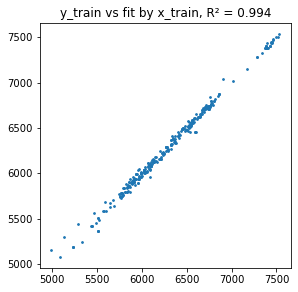

                                                   OLS
'coef'                                                
cumCasesByPublishDate                    -3.533093e-05
cumVirusTests                             1.812631e-06
cumDailyNsoDeathsByDeathDate             -3.419427e-03
cumPeopleVaccinatedCompleteByPublishDate -2.191563e-05
cumAdmissions                             1.976120e-03
FTSE_Open_Price                          -3.428070e-01
FTSE_High_Price                           5.734527e-01
FTSE_Low_Price                            7.816263e-01
FTSE_Volume                              -1.479742e-08
Max_Temperature_DegC                     -2.957246e+01
Min_Temperature_DegC                      3.320196e+01
Rainfall_mm                              -8.090846e-01
Sun_Hours                                 4.152645e-01
US_Covid_Cases                           -1.293807e-05
US_Covid_Deaths                           1.070164e-04
SPY_Open_Price                           -4.549301e+00
SPY_Close_

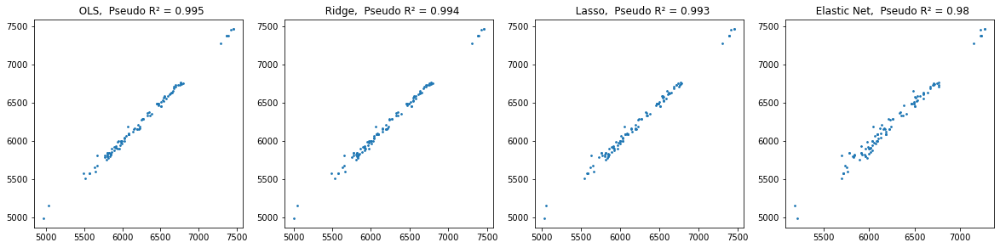

In [44]:
'''
Regression Regularization: balance optimization of fit and simplicity

https://www.pluralsight.com/guides/linear-lasso-ridge-regression-scikit-learn
https://fred.stlouisfed.org #federal reserve bank of st. louis

Linear Regression
Ridge Regression
Lasso Regression
Elastic Net Regression
'''
from sklearn.tree import DecisionTreeRegressor
from sklearn.svm import SVR
from sklearn.ensemble import RandomForestRegressor

df_rl = df_clean.copy()

#set maximum window width
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>")) #change code window width to max
pd.options.display.max_columns = 0 #change output window width to max

a = input('Positive number for regularization strength (i.e., alpha or lambda) [default: 1.0]? ').strip()
try:
    a = float(a)
except:
    a = 1.0
    print(a, 'assumed.')

mr = input('\nElasticNet mixing parameter (0 ≤, ≤ 1) [default: 0.5]? ').strip()
try:
    mr = float(mr)
    if mr < 0 or mr > 1:
        mr = 0.5
        print(mr, 'assumed.')
    else:
        print(mr, 'entered.')
except:
    mr = 0.5
    print(mr, 'assumed.')

rs = input('\n1: Reproducible output (input any integer except 2), 2: Random train-test data split [default: 1]? ').strip()
if rs == '2':
    rs = int(rs)
else:
    try:
        if rs == '':
            rs = 1
        else:
            rs = int(rs)
        print(rs, 'entered.')
    except:
        rs = 1 #can be changed to any integer for reproducible randomization
        print(rs, 'assumed.')

print()
print(df_rl)

#print(df.shape)
#print(df.describe())


y=df_rl.pop('FTSE_Close_Price')
df_rl.insert(0,'FTSE_Close_Price',y)
target = ['FTSE_Close_Price']

df_rl = df_rl.select_dtypes(include='number').replace([float('inf'), float('-inf')], float('nan')).dropna(
    0, subset=target).dropna(1)

print()
print(df_rl.drop(target[0], 1).corrwith(df_rl[target[0]]), '\n')

predictors = list(df_rl)
predictors=predictors[2:]
#predictors = list(set(list(df.columns)) - set(target)) #but ordering for columns can change

#scale the x variables by SIQR to make betas (coefficients) 'comparable' in penalty function (could instead use normalize=True but more affected by outliers):

from scipy.stats import iqr, norm
# df[predictors] = df[predictors] / df[predictors].max() #simpler scaling but not ideal
# df[predictors] = df[predictors].apply(lambda x: (x  - x.median()) / iqr(x) * (norm.ppf(0.75) * 2)) #no need to center

print('predictors:',df_rl[predictors])

siqr = df_rl[predictors].apply(lambda x: iqr(x) / (norm.ppf(0.75) * 2)).rename('siqr')

#####
if (siqr == 0).any():
    from statistics import stdev
    siqr.loc[siqr.index[siqr == 0]] = df_rl[siqr.index[siqr == 0]].apply(lambda x: stdev(x))

df_rl[predictors] = df_rl[predictors] / siqr
#could instead have, e.g., Ridge(normalize=True)

print('\nXs scaled  by SIQR:')
print(df_rl.describe())

X = df_rl[predictors].values
y = df_rl[target].values


#random state for train_test_split

# rs = 1 #any integer; =None for random

from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=rs) #random sampling for each run

print('\nTrain set:', X_train.shape); print('Test set :', X_test.shape)

print('\n                   Pseudo R² = (correlation(y, (fit or prediction)))**2')
print('Coefficient of Determination = 1 - ((y-(fit or prediction)**2).sum()/((y-y.mean())**2).sum() = 1 - SSResidual/SSTotal [can be <0]\n')

#Linear Regression

print('\nOLS Regression:\n')
#https://scikit-learn.org/stable/modules/generated/sklearn.linear_model.LinearRegression.html
from sklearn.linear_model import LinearRegression

lr = LinearRegression(n_jobs=-1) #use all CPU threads

print(lr.fit(X_train, y_train))

pred_train_lr = lr.predict(X_train)

#just 1 peep at train-set fit:
import matplotlib.pyplot as pl
%matplotlib inline
plt.rcParams["figure.figsize"] = (4.5, 4.5)
plt.scatter(pred_train_lr, y_train, s=3)

from sklearn.metrics import r2_score #Coefficient of Determination (can be negative), not (corr(y, y_fit))**2
def r2(y, x, cor=1):
    if cor == 1:
        #most reliable correlation; works even with nan
        x = pd.DataFrame(x).squeeze() #x is now a Series
        return (pd.concat([pd.DataFrame(y), x], 1).corr().iloc[0, 1] ** 2 if len(x.dropna().unique()) > 1 else 0)
    else:
        #coefficient of determination, which can be negative
        return r2_score(y, x)

plt.title('y_train vs fit by x_train, R² = ' + str(round(r2(y_train, pred_train_lr), 3)))
plt.show()

# print(pd.DataFrame(lr.coef_[0] / siqr).rename(columns={0: 'OLS'}))
cfOLS = pd.Series(lr.coef_[0] / siqr, predictors).rename('OLS').to_frame()
cfOLS.index.name = "'coef'"
print(cfOLS)

print('\nTrain set:')
import numpy as np
from sklearn.metrics import mean_squared_error
print('OLS Regression                  RMSE =', np.sqrt(mean_squared_error(y_train, pred_train_lr)))
print('OLS Regression                    R² =', r2(y_train, pred_train_lr))
print('OLS Regression Coef of Determination =', r2(y_train, pred_train_lr, 0))

pred_test_lr = lr.predict(X_test)
print('\nTest set:')
print('OLS Regression                  RMSE =', np.sqrt(mean_squared_error(y_test, pred_test_lr))) 
r2_ols = r2(y_test, pred_test_lr)
print('OLS Regression             Pseudo R² =', r2_ols)
print('OLS Regression Coef of Determination =', r2(y_test, pred_test_lr, 0))

#alpha/lambda parameter for ridge, lasso & elastic net:

# a = 1.0 #any positive float

#Ridge Regression

print('\n\nRidge Regression:\n')
#https://scikit-learn.org/stable/modules/generated/sklearn.linear_model.Ridge.html
from sklearn.linear_model import Ridge
#minimize ||y - Xw||^2_2 + alpha * ||w||^2_2
rr = Ridge(alpha=a, normalize=False, max_iter=10000) #increase max_iter to 10000 for comparison with later methods
print(rr.fit(X_train, y_train), '\n')
cfRidge = pd.Series(rr.coef_[0] / siqr, predictors).rename('Ridge').to_frame()
cfRidge.index.name = "'coef'"
print(cfRidge)

print('\nTrain set:')
pred_train_rr = rr.predict(X_train)
print('Ridge Regression                  RMSE =', np.sqrt(mean_squared_error(y_train, pred_train_rr)))
print('Ridge Regression             Pseudo R² =', r2(y_train, pred_train_rr))
print('Ridge Regression Coef of Determination =', r2(y_train, pred_train_rr, 0))

print('\nTest set:')
pred_test_rr = rr.predict(X_test)
print('Ridge Regression                  RMSE =', np.sqrt(mean_squared_error(y_test, pred_test_rr)))
r2_ridge = r2(y_test, pred_test_rr)
print('Ridge Regression             Pseudo R² =', r2_ridge)
print('Ridge Regression Coef of Determination =', r2(y_test, pred_test_rr, 0))

#Lasso Regression

print('\n\nLasso Regression:\n')
#https://scikit-learn.org/stable/modules/generated/sklearn.linear_model.Lasso.html
from sklearn.linear_model import Lasso
#minimize (1 / (2 * n_samples)) * ||y - Xw||^2_2 + alpha * ||w||_1
model_lasso = Lasso(alpha=a, normalize=False, max_iter=10000) #increase max_iter to 10000 for convergence
print(model_lasso.fit(X_train, y_train), '\n')
cfLasso = pd.Series(model_lasso.coef_ / siqr, predictors).rename('Lasso').to_frame()
cfLasso.index.name = "'coef'"
print(cfLasso)

print('\nTrain set:')
pred_train_lasso = model_lasso.predict(X_train)
print('Lasso Regression                  RMSE =', np.sqrt(mean_squared_error(y_train, pred_train_lasso)))
print('Lasso Regression             Pseudo R² =', r2(y_train, pred_train_lasso))
print('Lasso Regression Coef of Determination =', r2(y_train, pred_train_lasso, 0))

print('\nTest set:')
pred_test_lasso = model_lasso.predict(X_test)
print('Lasso Regression                  RMSE =', np.sqrt(mean_squared_error(y_test, pred_test_lasso)))
r2_lasso = r2(y_test, pred_test_lasso)
print('Lasso Regression             Pseudo R² =', r2_lasso)
print('Lasso Regression Coef of Determination =', r2(y_test, pred_test_lasso, 0))

#Elastic Net Regression

# mr = l1-norm/l2-norm ratio, [0, 1], default 0.5

print('\n\nElastic Net Regression:\n')
#https://scikit-learn.org/stable/modules/generated/sklearn.linear_model.ElasticNet.html
from sklearn.linear_model import ElasticNet
#minimize 1 / (2 * n_samples) * ||y - Xw||^2_2 + alpha * l1_ratio * ||w||_1 + 0.5 * alpha * (1 - l1_ratio) * ||w||^2_2

#https://stackoverflow.com/questions/47365978/scikit-learn-elastic-net-approaching-ridge
#the weights for ridge & lasso sum to alpha and not 1
#l1_ratio=1 yeilds lasso, but l1_ratio=0 does not yield ridge
#increase max_iter to 10000 (default 1000) for convergence:
# model_enet = ElasticNet(alpha=a, max_iter=1000)
model_enet = ElasticNet(alpha=a, normalize=False, l1_ratio=mr, max_iter=10000, warm_start=True, selection='random')
print(model_enet.fit(X_train, y_train), '\n')
cfElNet = pd.Series(model_enet.coef_ / siqr, predictors).rename('El-Net').to_frame()
cfElNet.index.name = "'coef'"
print(cfElNet)

print('\nTrain set:')
pred_train_enet = model_enet.predict(X_train)
print('Elastic Net Regression                  RMSE =', np.sqrt(mean_squared_error(y_train, pred_train_enet)))
print('Elastic Net Regression             Pseudo R² =', r2(y_train, pred_train_enet))
print('Elastic Net Regression Coef of Determination =', r2(y_train, pred_train_enet, 0))

print('\nTest set:')
pred_test_enet = model_enet.predict(X_test)
print('Elastic Net Regression                  RMSE =', np.sqrt(mean_squared_error(y_test, pred_test_enet)))
r2_enet = r2(y_test, pred_test_enet)
print('Elastic Net Regression             Pseudo R² =', r2_enet)
print('Elastic Net Regression Coef of Determination =', r2(y_test, pred_test_enet, 0))

#compare coefs

print('\n\nTrain-set coefficients comparison:')
print(pd.concat([cfOLS, cfRidge, cfLasso, cfElNet], 1))

#compare r2s

print('\n\nTest-set Pseudo R² scores comparison:')
print('OLS         =', r2_ols)
print('Ridge       =', r2_ridge)
print('Lasso       =', r2_lasso)
print('Elastic Net =', r2_enet)

#https://stackoverflow.com/questions/42818361/how-to-make-two-plots-side-by-side-using-python
plt.rcParams["figure.figsize"] = (20.2, 4.5)
# pl.tight_layout()

#plot y_test vs y_predict

print('\ny_test vs its prediction by x_test:')

plt.subplot(1, 4, 1) #1 row, 4 columns, plot 1
plt.title('  OLS,  Pseudo R² = ' + str(round(r2_ols, 3)))
plt.scatter(pred_test_lr, y_test, s=3)

plt.subplot(1, 4, 2) #1 row, 4 columns, plot 2
plt.title('  Ridge,  Pseudo R² = ' + str(round(r2_ridge, 3)))
plt.scatter(pred_test_rr, y_test, s=3)

plt.subplot(1, 4, 3) #1 row, 4 columns, plot 3
plt.title('  Lasso,  Pseudo R² = ' + str(round(r2_lasso, 3)))
plt.scatter(pred_test_lasso, y_test, s=3)

plt.subplot(1, 4, 4) #1 row, 4 columns, plot 4
plt.title('  Elastic Net,  Pseudo R² = ' + str(round(r2_enet, 3)))
plt.scatter(pred_test_enet, y_test, s=3)

plt.show()

## Ridge Lasso ElasticNet Regression for SPY Close Price

Positive number for regularization strength (i.e., alpha or lambda) [default: 1.0]? 
1.0 assumed.

ElasticNet mixing parameter (0 ≤, ≤ 1) [default: 0.5]? 
0.5 assumed.

1: Reproducible output (input any integer except 2), 2: Random train-test data split [default: 1]? 
1 entered.

     date  cumCasesByPublishDate  ...  SPY_Open_Price  SPY_Close_Price
0     NaN                    0.0  ...      330.899994       331.299988
1     NaN                    0.0  ...      332.239990       331.339996
2     NaN                    0.0  ...      330.630005       331.720001
3     NaN                    0.0  ...      332.440002       328.769989
4     NaN                    0.0  ...      332.440002       328.769989
..    ...                    ...  ...             ...              ...
434   NaN              4341736.0  ...      394.420013       394.730011
435   NaN              4345788.0  ...      395.339996       396.329987
436   NaN              4350266.0  ...      398.399994       400.609985
437   NaN

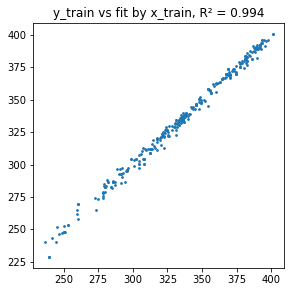

                                                   OLS
'coef'                                                
cumVirusTests                            -2.908311e-08
cumDailyNsoDeathsByDeathDate              1.328169e-04
cumPeopleVaccinatedCompleteByPublishDate  7.853936e-07
cumAdmissions                            -7.793278e-05
FTSE_Open_Price                           5.229964e-03
FTSE_Close_Price                          2.732435e-02
FTSE_High_Price                          -1.090251e-02
FTSE_Low_Price                           -2.114003e-02
FTSE_Volume                              -1.433910e-09
Max_Temperature_DegC                      1.411623e+00
Min_Temperature_DegC                     -1.481270e+00
Rainfall_mm                               7.359586e-02
Sun_Hours                                 4.796993e-03
US_Covid_Cases                            6.842855e-07
US_Covid_Deaths                          -6.834192e-07
SPY_Open_Price                            9.675029e-01

Train set

AttributeError: 'DataFrame' object has no attribute 'summary2'

In [55]:
'''
Regression Regularization: balance optimization of fit and simplicity

https://www.pluralsight.com/guides/linear-lasso-ridge-regression-scikit-learn
https://fred.stlouisfed.org #federal reserve bank of st. louis

Linear Regression
Ridge Regression
Lasso Regression
Elastic Net Regression
'''
from sklearn.tree import DecisionTreeRegressor
from sklearn.svm import SVR
from sklearn.ensemble import RandomForestRegressor

df_rl = df_clean.copy()

#set maximum window width
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>")) #change code window width to max
pd.options.display.max_columns = 0 #change output window width to max

a = input('Positive number for regularization strength (i.e., alpha or lambda) [default: 1.0]? ').strip()
try:
    a = float(a)
except:
    a = 1.0
    print(a, 'assumed.')

mr = input('\nElasticNet mixing parameter (0 ≤, ≤ 1) [default: 0.5]? ').strip()
try:
    mr = float(mr)
    if mr < 0 or mr > 1:
        mr = 0.5
        print(mr, 'assumed.')
    else:
        print(mr, 'entered.')
except:
    mr = 0.5
    print(mr, 'assumed.')

rs = input('\n1: Reproducible output (input any integer except 2), 2: Random train-test data split [default: 1]? ').strip()
if rs == '2':
    rs = int(rs)
else:
    try:
        if rs == '':
            rs = 1
        else:
            rs = int(rs)
        print(rs, 'entered.')
    except:
        rs = 1 #can be changed to any integer for reproducible randomization
        print(rs, 'assumed.')

print()
print(df_rl)

#print(df.shape)
#print(df.describe())


y=df_rl.pop('SPY_Close_Price')
df_rl.insert(0,'SPY_Close_Price',y)
target = ['SPY_Close_Price']

df_rl = df_rl.select_dtypes(include='number').replace([float('inf'), float('-inf')], float('nan')).dropna(
    0, subset=target).dropna(1)

print()
print(df_rl.drop(target[0], 1).corrwith(df_rl[target[0]]), '\n')

predictors = list(df_rl)
predictors=predictors[2:]
#predictors = list(set(list(df.columns)) - set(target)) #but ordering for columns can change

#scale the x variables by SIQR to make betas (coefficients) 'comparable' in penalty function (could instead use normalize=True but more affected by outliers):

from scipy.stats import iqr, norm
# df[predictors] = df[predictors] / df[predictors].max() #simpler scaling but not ideal
# df[predictors] = df[predictors].apply(lambda x: (x  - x.median()) / iqr(x) * (norm.ppf(0.75) * 2)) #no need to center

print('predictors:',df_rl[predictors])

siqr = df_rl[predictors].apply(lambda x: iqr(x) / (norm.ppf(0.75) * 2)).rename('siqr')

#####
if (siqr == 0).any():
    from statistics import stdev
    siqr.loc[siqr.index[siqr == 0]] = df_rl[siqr.index[siqr == 0]].apply(lambda x: stdev(x))

df_rl[predictors] = df_rl[predictors] / siqr
#could instead have, e.g., Ridge(normalize=True)

print('\nXs scaled  by SIQR:')
print(df_rl.describe())

X = df_rl[predictors].values
y = df_rl[target].values


#random state for train_test_split

# rs = 1 #any integer; =None for random

from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=rs) #random sampling for each run

print('\nTrain set:', X_train.shape); print('Test set :', X_test.shape)

print('\n                   Pseudo R² = (correlation(y, (fit or prediction)))**2')
print('Coefficient of Determination = 1 - ((y-(fit or prediction)**2).sum()/((y-y.mean())**2).sum() = 1 - SSResidual/SSTotal [can be <0]\n')

#Linear Regression

print('\nOLS Regression:\n')
#https://scikit-learn.org/stable/modules/generated/sklearn.linear_model.LinearRegression.html
from sklearn.linear_model import LinearRegression

lr = LinearRegression(n_jobs=-1) #use all CPU threads

print(lr.fit(X_train, y_train))

pred_train_lr = lr.predict(X_train)

#just 1 peep at train-set fit:
import matplotlib.pyplot as pl
%matplotlib inline
plt.rcParams["figure.figsize"] = (4.5, 4.5)
plt.scatter(pred_train_lr, y_train, s=3)

from sklearn.metrics import r2_score #Coefficient of Determination (can be negative), not (corr(y, y_fit))**2
def r2(y, x, cor=1):
    if cor == 1:
        #most reliable correlation; works even with nan
        x = pd.DataFrame(x).squeeze() #x is now a Series
        return (pd.concat([pd.DataFrame(y), x], 1).corr().iloc[0, 1] ** 2 if len(x.dropna().unique()) > 1 else 0)
    else:
        #coefficient of determination, which can be negative
        return r2_score(y, x)

plt.title('y_train vs fit by x_train, R² = ' + str(round(r2(y_train, pred_train_lr), 3)))
plt.show()

# print(pd.DataFrame(lr.coef_[0] / siqr).rename(columns={0: 'OLS'}))
cfOLS = pd.Series(lr.coef_[0] / siqr, predictors).rename('OLS').to_frame()
cfOLS.index.name = "'coef'"
print(cfOLS)

print('\nTrain set:')
import numpy as np
from sklearn.metrics import mean_squared_error
print('OLS Regression                  RMSE =', np.sqrt(mean_squared_error(y_train, pred_train_lr)))
print('OLS Regression                    R² =', r2(y_train, pred_train_lr))
print('OLS Regression Coef of Determination =', r2(y_train, pred_train_lr, 0))

pred_test_lr = lr.predict(X_test)
print('\nTest set:')
print('OLS Regression                  RMSE =', np.sqrt(mean_squared_error(y_test, pred_test_lr))) 
r2_ols = r2(y_test, pred_test_lr)
print('OLS Regression             Pseudo R² =', r2_ols)
print('OLS Regression Coef of Determination =', r2(y_test, pred_test_lr, 0))

#alpha/lambda parameter for ridge, lasso & elastic net:

# a = 1.0 #any positive float

#Ridge Regression

print('\n\nRidge Regression:\n')
#https://scikit-learn.org/stable/modules/generated/sklearn.linear_model.Ridge.html
from sklearn.linear_model import Ridge
#minimize ||y - Xw||^2_2 + alpha * ||w||^2_2
rr = Ridge(alpha=a, normalize=False, max_iter=10000) #increase max_iter to 10000 for comparison with later methods
print(rr.fit(X_train, y_train), '\n')

cfRidge = pd.Series(rr.coef_[0] / siqr, predictors).rename('Ridge').to_frame()
cfRidge.index.name = "'coef'"
print(cfRidge)

print('\nTrain set:')
pred_train_rr = rr.predict(X_train)
print('Ridge Regression                  RMSE =', np.sqrt(mean_squared_error(y_train, pred_train_rr)))
print('Ridge Regression             Pseudo R² =', r2(y_train, pred_train_rr))
print('Ridge Regression Coef of Determination =', r2(y_train, pred_train_rr, 0))

print('\nTest set:')
pred_test_rr = rr.predict(X_test)
print('Ridge Regression                  RMSE =', np.sqrt(mean_squared_error(y_test, pred_test_rr)))
r2_ridge = r2(y_test, pred_test_rr)
print('Ridge Regression             Pseudo R² =', r2_ridge)
print('Ridge Regression Coef of Determination =', r2(y_test, pred_test_rr, 0))

#Lasso Regression

print('\n\nLasso Regression:\n')
#https://scikit-learn.org/stable/modules/generated/sklearn.linear_model.Lasso.html
from sklearn.linear_model import Lasso
#minimize (1 / (2 * n_samples)) * ||y - Xw||^2_2 + alpha * ||w||_1
model_lasso = Lasso(alpha=a, normalize=False, max_iter=10000) #increase max_iter to 10000 for convergence
print(model_lasso.fit(X_train, y_train), '\n')
cfLasso = pd.Series(model_lasso.coef_ / siqr, predictors).rename('Lasso').to_frame()
cfLasso.index.name = "'coef'"
print(cfLasso)

print('\nTrain set:')
pred_train_lasso = model_lasso.predict(X_train)
print('Lasso Regression                  RMSE =', np.sqrt(mean_squared_error(y_train, pred_train_lasso)))
print('Lasso Regression             Pseudo R² =', r2(y_train, pred_train_lasso))
print('Lasso Regression Coef of Determination =', r2(y_train, pred_train_lasso, 0))

print('\nTest set:')
pred_test_lasso = model_lasso.predict(X_test)
print('Lasso Regression                  RMSE =', np.sqrt(mean_squared_error(y_test, pred_test_lasso)))
r2_lasso = r2(y_test, pred_test_lasso)
print('Lasso Regression             Pseudo R² =', r2_lasso)
print('Lasso Regression Coef of Determination =', r2(y_test, pred_test_lasso, 0))

#Elastic Net Regression

# mr = l1-norm/l2-norm ratio, [0, 1], default 0.5

print('\n\nElastic Net Regression:\n')
#https://scikit-learn.org/stable/modules/generated/sklearn.linear_model.ElasticNet.html
from sklearn.linear_model import ElasticNet
#minimize 1 / (2 * n_samples) * ||y - Xw||^2_2 + alpha * l1_ratio * ||w||_1 + 0.5 * alpha * (1 - l1_ratio) * ||w||^2_2

#https://stackoverflow.com/questions/47365978/scikit-learn-elastic-net-approaching-ridge
#the weights for ridge & lasso sum to alpha and not 1
#l1_ratio=1 yeilds lasso, but l1_ratio=0 does not yield ridge
#increase max_iter to 10000 (default 1000) for convergence:
# model_enet = ElasticNet(alpha=a, max_iter=1000)
model_enet = ElasticNet(alpha=a, normalize=False, l1_ratio=mr, max_iter=10000, warm_start=True, selection='random')
print(model_enet.fit(X_train, y_train), '\n')
cfElNet = pd.Series(model_enet.coef_ / siqr, predictors).rename('El-Net').to_frame()
cfElNet.index.name = "'coef'"
print(cfElNet)

print('\nTrain set:')
pred_train_enet = model_enet.predict(X_train)
print('Elastic Net Regression                  RMSE =', np.sqrt(mean_squared_error(y_train, pred_train_enet)))
print('Elastic Net Regression             Pseudo R² =', r2(y_train, pred_train_enet))
print('Elastic Net Regression Coef of Determination =', r2(y_train, pred_train_enet, 0))

print('\nTest set:')
pred_test_enet = model_enet.predict(X_test)
print('Elastic Net Regression                  RMSE =', np.sqrt(mean_squared_error(y_test, pred_test_enet)))
r2_enet = r2(y_test, pred_test_enet)
print('Elastic Net Regression             Pseudo R² =', r2_enet)
print('Elastic Net Regression Coef of Determination =', r2(y_test, pred_test_enet, 0))

#compare coefs

print('\n\nTrain-set coefficients comparison:')
print(pd.concat([cfOLS, cfRidge, cfLasso, cfElNet], 1))

#compare r2s

print('\n\nTest-set Pseudo R² scores comparison:')
print('OLS         =', r2_ols)
print('Ridge       =', r2_ridge)
print('Lasso       =', r2_lasso)
print('Elastic Net =', r2_enet)

#https://stackoverflow.com/questions/42818361/how-to-make-two-plots-side-by-side-using-python
plt.rcParams["figure.figsize"] = (20.2, 4.5)
# pl.tight_layout()

#plot y_test vs y_predict

print('\ny_test vs its prediction by x_test:')

plt.subplot(1, 4, 1) #1 row, 4 columns, plot 1
plt.title('  OLS,  Pseudo R² = ' + str(round(r2_ols, 3)))
plt.scatter(pred_test_lr, y_test, s=3)

plt.subplot(1, 4, 2) #1 row, 4 columns, plot 2
plt.title('  Ridge,  Pseudo R² = ' + str(round(r2_ridge, 3)))
plt.scatter(pred_test_rr, y_test, s=3)

plt.subplot(1, 4, 3) #1 row, 4 columns, plot 3
plt.title('  Lasso,  Pseudo R² = ' + str(round(r2_lasso, 3)))
plt.scatter(pred_test_lasso, y_test, s=3)

plt.subplot(1, 4, 4) #1 row, 4 columns, plot 4
plt.title('  Elastic Net,  Pseudo R² = ' + str(round(r2_enet, 3)))
plt.scatter(pred_test_enet, y_test, s=3)

plt.show()

## SARIMAX Auto Time Series for UK and US COVID-19

In [28]:
# Variable Selection Function
def variableSelection(df, yvar):
    data = df.copy()
    flag = True;
    y = data[yvar]
    initm = True;
    initial_model = None;
    count = 0;
    
    while flag:
        # Build model
        cols = [i for i in data.columns if i != yvar]
        x = data[cols]
        exog, endog = sm.add_constant(x), y
        mod = sm.OLS(endog, exog).fit()
        # Save the initial model
        if initm:
            initial_model = mod;
            initm = False;
        # Get the p-values for all the params
        pvals = dict(mod.pvalues)
        max_val = 0;
        max_key = "";
        # Iterate through keys to find max p-value param
        for key in pvals.keys():
            if key == "const":
                continue;
            if pvals[key] > max_val:
                max_val = pvals[key];
                max_key = key
        # Drop the param with the largest p-value (for variable selection)
        data.drop(max_key, axis=1, inplace=True)
        count += 1;
        # Terminate after 6 params reached (this is to create an explainable model for biz users)
        if len(mod.params) == 6:
            break;
    # Return both final and initial models --> For comparison
    return mod, initial_model;


In [29]:
df = pd.read_csv('cleaned_data.csv')
df["date"] = pd.to_datetime(df["date"])

initvar = [i for i in list(df.columns) if i != "date"]
cdf = df[initvar]

a,b = variableSelection(cdf,"cumCasesByPublishDate")

a.summary2()

var_list = list(dict(a.pvalues).keys())
var_list.insert(0, "date")
var_list.append("cumCasesByPublishDate")
var_list.remove("const")
df = df[var_list]

Dataset has 439 rows and the following columns:
['date', 'Unnamed: 0', 'cumDailyNsoDeathsByDeathDate', 'cumAdmissions', 'FTSE_High_Price', 'US_Covid_Cases', 'cumCasesByPublishDate'] 

                 date  Unnamed: 0  ...  US_Covid_Cases  cumCasesByPublishDate
date                               ...                                       
2020-01-21 2020-01-21           0  ...             1.0                    0.0
2020-01-22 2020-01-22           1  ...             1.0                    0.0
2020-01-23 2020-01-23           2  ...             1.0                    0.0

[3 rows x 7 columns]
                 date  Unnamed: 0  ...  US_Covid_Cases  cumCasesByPublishDate
date                               ...                                       
2021-04-01 2021-04-01         436  ...      30562856.0              4350266.0
2021-04-02 2021-04-02         437  ...      30631700.0              4353668.0
2021-04-03 2021-04-03         438  ...      30631700.0              4357091.0

[3 rows x 7 c


Fitting ARIMAX(1,1,1) for the last 425 obs of 'cumCasesByPublishDate' using 5 X-variables: ['Unnamed: 0', 'cumDailyNsoDeathsByDeathDate', 'cumAdmissions', 'FTSE_High_Price', 'US_Covid_Cases']...

                                ARIMA Model Results                                
Dep. Variable:     D.cumCasesByPublishDate   No. Observations:                  424
Model:                      ARIMA(1, 1, 1)   Log Likelihood               -4010.121
Method:                            css-mle   S.D. of innovations           3090.117
Date:                     Thu, 22 Apr 2021   AIC                           8038.242
Time:                             13:48:21   BIC                           8074.690
Sample:                         01-22-2020   HQIC                          8052.643
                              - 03-20-2021                                         
                                    coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------

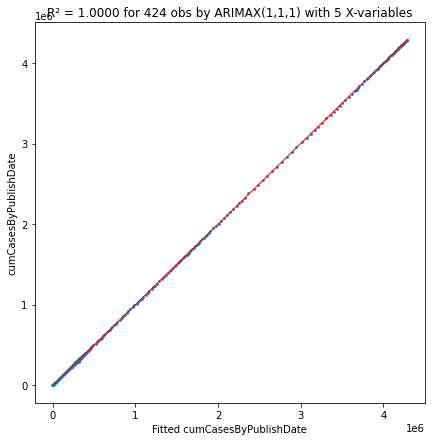

StdErr(Fitted) = 3090.1165059668942 (same as for 1st forecast value below)


ARIMA forecast for 14 future values of 'cumCasesByPublishDate' using 5 X-variables...

                Forecast     Std Error
2021-03-21  4.297564e+06   3090.116506
2021-03-22  4.304153e+06   5786.837930
2021-03-23  4.311204e+06   8824.287614
2021-03-24  4.318688e+06  12181.870015
2021-03-25  4.326658e+06  15825.771087
2021-03-26  4.335107e+06  19725.663371
2021-03-27  4.343987e+06  23855.801165
2021-03-28  4.353320e+06  28194.327247
2021-03-29  4.363027e+06  32722.490906
2021-03-30  4.373189e+06  37424.015096
2021-03-31  4.383580e+06  42284.613801
2021-04-01  4.394216e+06  47291.626298
2021-04-02  4.405146e+06  52433.737498
2021-04-03  4.416462e+06  57700.761195


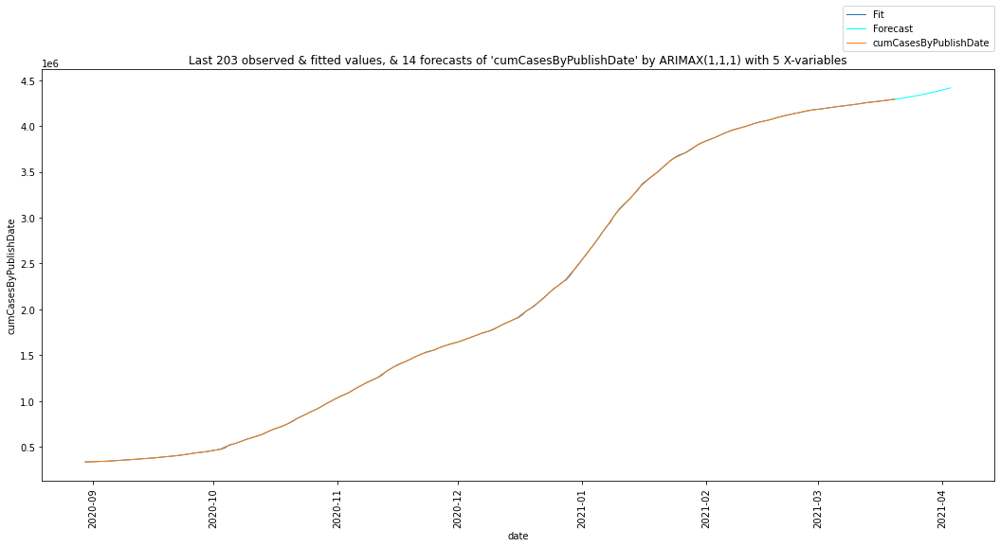


Fitting Auto SARIMA(X) for the last 425 obs of 'cumCasesByPublishDate' using 5 X-variables: ['Unnamed: 0', 'cumDailyNsoDeathsByDeathDate', 'cumAdmissions', 'FTSE_High_Price', 'US_Covid_Cases']... (this may take time)

                               SARIMAX Results                                
Dep. Variable:                      y   No. Observations:                  425
Model:               SARIMAX(3, 0, 0)   Log Likelihood               -4055.586
Date:                Thu, 22 Apr 2021   AIC                           8131.173
Time:                        13:49:35   BIC                           8171.694
Sample:                    01-21-2020   HQIC                          8147.181
                         - 03-20-2021                                         
Covariance Type:                  opg                                         
                                   coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------

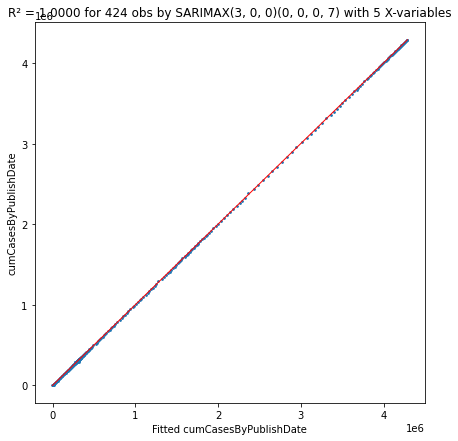

SARIMA forecast for 14 future values of 'cumCasesByPublishDate' using 5 X-variables...

2021-03-21    4.294246e+06
2021-03-22    4.297884e+06
2021-03-23    4.300882e+06
2021-03-24    4.304423e+06
2021-03-25    4.306797e+06
2021-03-26    4.308775e+06
2021-03-27    4.309409e+06
2021-03-28    4.308707e+06
2021-03-29    4.308266e+06
2021-03-30    4.306871e+06
2021-03-31    4.305313e+06
2021-04-01    4.303762e+06
2021-04-02    4.301311e+06
2021-04-03    4.294918e+06
Freq: D, Name: Forecast, dtype: float64


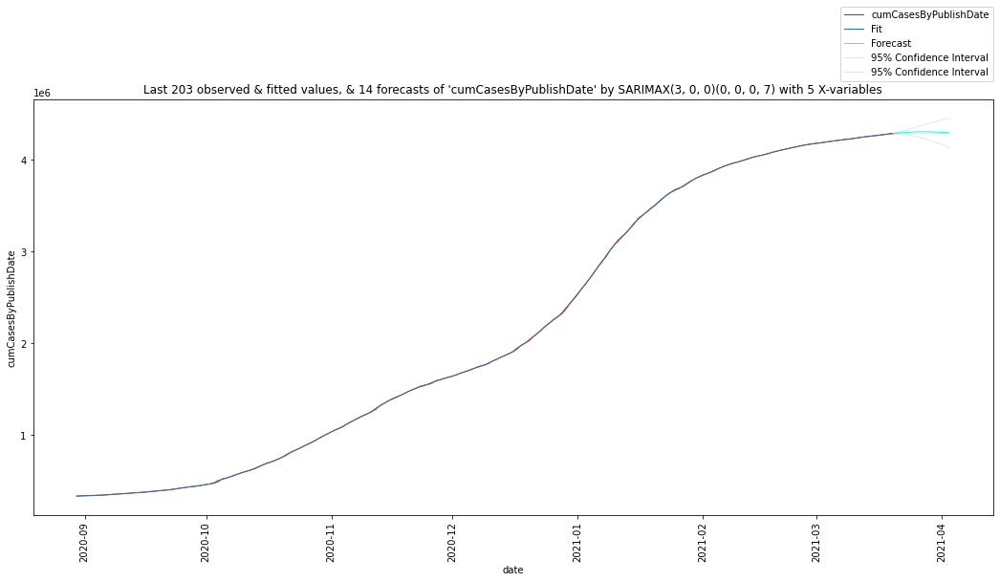

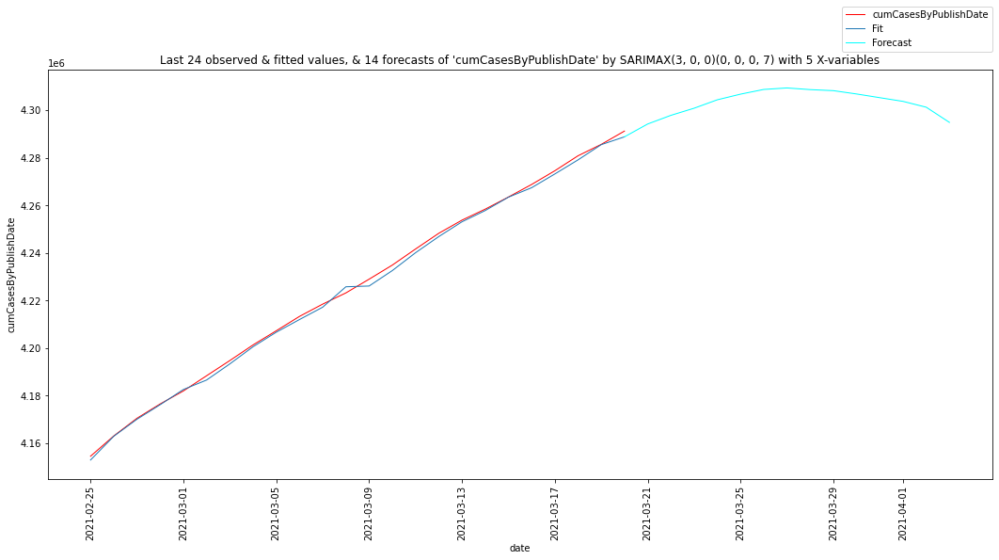

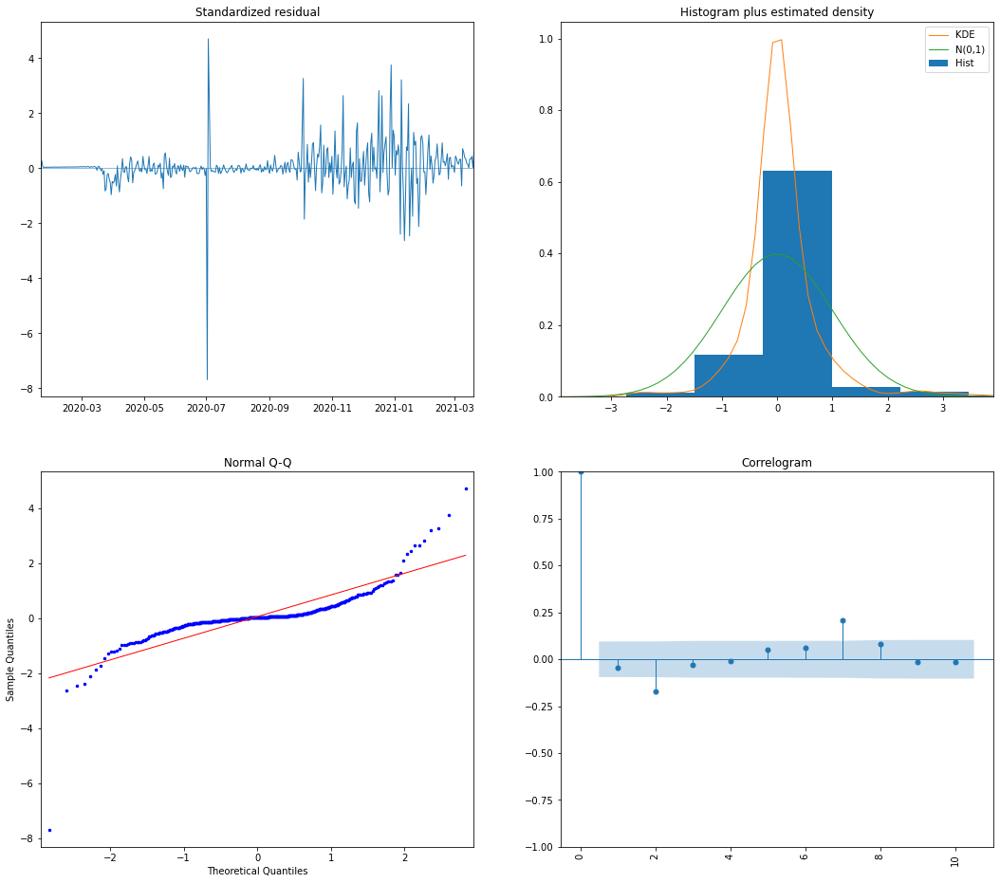

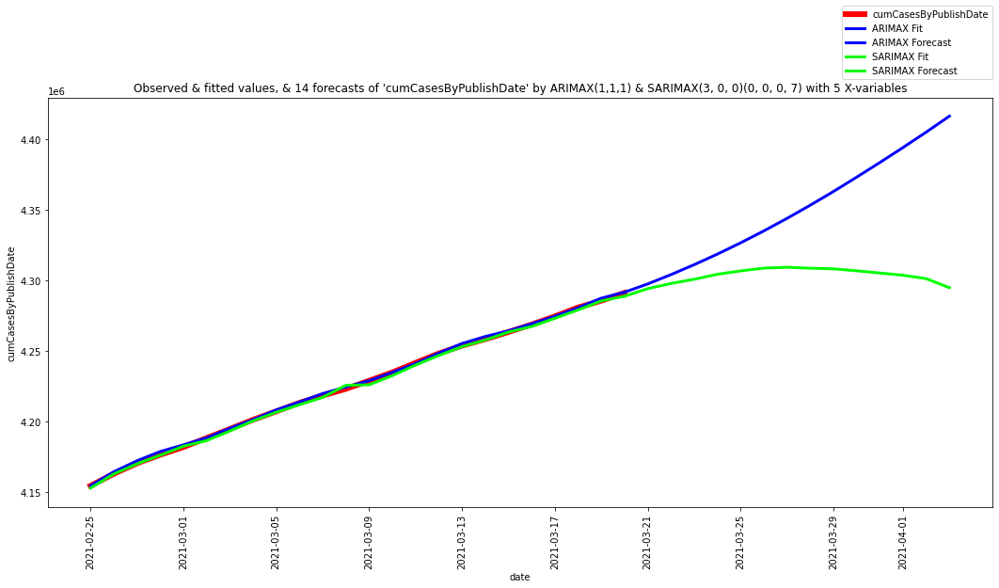

Analysis for time series "cumCasesByPublishDate" took 1.29 mins.


In [30]:
## Time Series ARIMA, ARIMAX or auto SARIMAX Forecast

#only have to specify filename, yname & timestamp-name; all other columns will be taken as Xs
#Xs should first go through regression variable selection

#categorical variables will be deleted
#missing values are automatically handled

#processed input data may be written to disk, just before analysis, using the parameter writedata

#warning messages only appears for first run

#SARIMAX Seasonal AutoRegressive Integrated Moving Average with eXogenous regressors
#https://www.statsmodels.org/dev/examples/notebooks/generated/statespace_sarimax_stata.html

import time
stm = time.time()
import os
try:
    os.chdir(os.environ['USERPROFILE'] + '\Documents' + r"\0_Teach\data") #change "\0_Teach\data" accordingly
except:
    try:
        os.chdir('/Users/' + os.environ['USER'] + '/Documents' + r"/0_Teach/data") #for Mac
    except:
        #assume data file in current folder
        pass

import pandas as pd
#df = pd.read_excel(r"COE_TimeSeries_lag5.xlsx", index_col=0) #ARIMAX

#in the target (y) column, leave tail periods to be forecasted blank
#older python does not read .xlsx:

# #df = pd.read_excel(r"COE_TimeSeries_lag5.xlsx").iloc[:, :2] #ARIMA, only 2 columns needed
# df = pd.read_excel(r"COE_TimeSeries_lag5.xlsx") #ARIMAX
# tn = 'Date' #time-stamp column, for index (row labels)
# #the index (row labels) must not have any NaN
# yn = 'CatECOE'#time series column
# pc = 24 #periodicity; randomly assumed here; e.g. weekly data would be 7, monthly 12, quarterly 4
# #input y2 for testing set if available; else, comment out next 3 lines:
# y2 = [44000, 39903, 38801, 39000, 38000] #n2 actual future values kept for comparing with forecasts

# df = pd.read_csv('SARIMAX_grid-search_prepared_data.csv')

# df.drop(['FTSE100 Close', 'Bitcoin Price', 'Crude Oil Price'], axis=1, inplace=True)
tn = 'date' #time serial column name
yn = "cumCasesByPublishDate"
pc = 7
# y2 = [1643, 1875, 1938, 1986, 1944, 1982, 1592] #n2 actual future values kept for comparing with forecasts

#if frequency not inferred correctly, then freq=None :
df.index = pd.to_datetime(df[tn], infer_datetime_format=True)
#df.index = pd.DatetimeIndex(df[tn], freq=pd.infer_freq(df[tn]))
# f = 'SMS-16' #frequency specified; might be changed by inference
# if df.index.freq == None:
#     #reset freq to inferred if possible
#     #warning: this frequently fails!
#     z = pd.infer_freq(df.index)
#     #print('Inferred freq =', z, '\n')
#     if z != None:
#         if f != 'SMS-16' or z != '15D':
#             print('Setting freq to inferred "' + z + '".\n')
#             f = z
#     elif f == '':
#         f = z
# else:
#     f = df.index.freq
# df.index.freq = f

print('Dataset has', len(df), 'rows and the following columns:')
print(list(df), '\n')

import numpy as np

# #artificially set some NaNs at the start and in the middle for y:
# df.iloc[:4, list(df).index(yn)] = np.nan
# df.iloc[10:14, list(df).index(yn)] = np.nan
# print(df.iloc[:15, list(df).index(yn)])

y = pd.DataFrame(df[yn])

s = list(y.index).index(y.isnull().ne(True).idxmax()[0]) + 1 #position of first non-missing at the start
print(df.head(max(s, 3))) #show all of any missing at the start
y.interpolate(limit_area='inside', inplace=True) #fill in missing in the middle
e = max((len(y) - y.count())[0] - s + 2, 3)
print(df.tail(e)) #shows all of any missing at the end

#if not time series, to remove any row with NaN, inf or -inf: df[~df.isin([np.nan, np.inf, -np.inf]).any(1)]

#delete any row with missing y at the start:
df = df.select_dtypes(include='number').iloc[s - 1:, :] #only use numeric columns
df.interpolate(limit_area='inside', inplace=True) #interpolate, but not extrapolate for either end

# x = df.drop(yn, 1)
# df.drop(yn, 1).interpolate(limit_direction='both', inplace=True) #fill in missing at the beginning & the end
#fill in missing at the beginning & the end:
df = pd.concat([y.iloc[s - 1:, :], df.drop(yn, 1).interpolate(limit_direction='both')], 1)
#also df.bfill() & df.ffill()

writedata = False #write processed data to disk
if writedata:
    kname = 'auto_SARIMAX_prepared_data.csv'
    if os.path.exists(kname):
        os.remove(kname)
    pd.concat([y, x], 1).to_csv(kname)
    print('\n' + kname, 'written to disk.')
    del kname
del os, writedata

if 'y2' in vars():
    #using df.index was inspired by Ong Jun Hong:
    y2 = pd.Series(y2, index=pd.date_range(df.index[-(len(df[yn]) - df[yn].count() + 1)], periods=len(y2)+1,
                                           freq=df.index.freq)[1:]).rename(yn + ' (unused)')

#done preparing time series

n0 = int(df[yn].count()) #number of non-Nan values; type(df[yn].count())=<class 'numpy.int32'>
n2 = len(df) - n0 #periods to forecast ahead
### CHanged 
n2 = 14
n2 = pc if n2 == 0 else n2
n = min(3653, n0) #use only the last 3653 observations
if n != n0:
    print('Only the last', n, 'of', n0, 'observations will be used for fitting.\n')
n1 = min(len(df[yn]), n + n2)
y = df[yn][-n1:-n2] #last 5 rows have no row labels
x =  df.iloc[-n1:-n2, 1:] #for fitting in-sample values
x2 = df.iloc[-n2:, 1:] #for forecasting future values
xc = x.shape[1] #number of X variables


#fit ARIMA to time series

from IPython.core.display import display, HTML
display(HTML("<style>div.output_scroll { height: 31em; }</style>"))

p, d, q = 1, 1, 1
print(f'\033[1m' + '\nFitting ARIMA' + ('X' if xc > 0 else '') + '(' + str(p) + ',' + str(d) + ',' + str(q)
      + ') for the last', len(y), "obs of '" + yn + ("' using " + str(xc) + ' X-variables: '
                                             + str(list(x)) if xc > 0 else "'")
      + '...\n' + f'\033[0m') #in bold

from statsmodels.tsa.arima_model import ARIMA
# from statsmodels.tsa.arima.model import ARIMA
#https://www.statsmodels.org/stable/generated/statsmodels.tsa.arima.model.ARIMA.html

#https://statsmodels.org/stable/generated/statsmodels.tsa.arima_model.ARIMA.fit.html
#out = ARIMA(y, order=(1,1,1), missing='raise').fit(trend='c', transparams=True)
out = ARIMA(y, (p,d,q), x).fit() if xc > 0 else ARIMA(y, (p,d,q)).fit()
# out = ARIMA(y, x, (p,d,q)).fit() if xc > 0 else ARIMA(y, (p,d,q)).fit()
#(p,d,q)=(1,1,1) is only as an example here
#print(dir(out))

print(out.summary(), '\n')

#check reliability of model:
tt  = out.tvalues #z-values
if min(tt) > -np.inf and max(tt) < np.inf:
    tt = out.summary().as_text()
    tt = tt[tt.find('Kurtosis') - 7:][:4] #Prob(H) (two-sided)
    if tt == ' nan' or tt == '1.00' or tt == '0.00':
        iss = True
    else:
        iss = False
else:
    iss = True
if iss:
    print('This model is not reliable!\n')
del tt, iss

#https://statsmodels.org/stable/generated/statsmodels.tsa.arima_model.ARIMAResults.predict.html
#ft = out.fittedvalues #fitted values for d-integrated(differenced) series, not original series
ft = out.predict(typ='levels') #without 'levels', fitted output will be for d-differenced series
yh = pd.concat((y, ft.rename('Fitted')), 1) #y & yhat
print(yh)

#plot time series vs fit and its 'line'

#plot 'regression' line

mm = np.array([min(ft), max(ft)])
y0 = y[len(y)-len(ft):] #y & ft can have different lengths

import matplotlib.pyplot as pl
%matplotlib inline
pl.rcParams['figure.figsize'] = 7, 7 #square plot

# pl.rcParams['lines.linewidth'] = 1.0
# pl.plot(mm, sum(np.polyfit(ft, y0, 1) * [mm, 1]), 'red') #increase linewidth for darker line
pl.plot(mm, sum(np.polyfit(ft, y0, 1) * [mm, 1]), 'r', lw=1) #increase linewidth for darker line

#scatter time series vs fit

# pl.rcParams['lines.markersize'] = 2.0
# pl.scatter(ft, y0)
pl.scatter(ft, y0, s=3)

pl.ylabel(yn)
pl.xlabel('Fitted ' + yn)
pl.title('R² = ' + str('%.4f' % yh.corr().iloc[1, 0]**2) + ' for ' + str(len(y0)) +
         ' obs by ARIMA' + ('X(' if xc > 0 else '(') + str(p) + ',' + str(d) + ','
         + str(q) + ')' + (' with ' + str(xc) + ' X-variables' if xc > 0 else ''))
pl.show()

#print('forecast error:', out._forecast_error) #doesn't work
# out.sigma2 is a bit different from sum((y-ft).dropna()**2)/len(ft)
print('StdErr(Fitted) =', np.sqrt(out.sigma2), '(same as for 1st forecast value below)' '\n\n')
# print('StdErr(Fitted) =', np.sqrt(out.mse), '(same as for 1st forecast value below)' '\n\n')

#forecast future values

#future 2.5% or 5 periods of time series:
#stnd = pd.date_range(y.index[-1], periods=max(1, min(n2, len(y)//40)) + 1, freq=y.index.freq)

stnd = pd.date_range(y.index[-1], periods=n2+1, freq=y.index.freq)
print(f'\033[1m' + 'ARIMA forecast for', n2, "future values of '" + yn
      + ("' using " + str(xc) + ' X-variables' if xc > 0 else "'") + '...\n' + f'\033[0m')

#https://statsmodels.org/stable/generated/statsmodels.tsa.arima_model.ARIMAResults.forecast.html
fc, stderr, confint = out.forecast(n2, x2) if xc > 0 else out.forecast(n2)
# print(pd.concat((pd.Series(fc).rename('Forecast'), pd.Series(stderr).rename('Std Error')), 1
#                ).set_index(stnd[1:])) #also works
# print(pd.concat((pd.Series(fc, name='Forecast'), pd.Series(stderr, name='Std Error')), 1
#                ).set_index(stnd[1:])) #also works
print(pd.concat((pd.Series(fc), pd.Series(stderr)), 1, keys=['Forecast', 'Std Error']
               ).set_index(stnd[1:]))
fc = pd.Series(fc, index=pd.date_range(ft.index[-1], periods=len(fc)+1,
                                    freq=ft.index.freq)[1:]).rename('Forecast')

#plot last 200+ training periods' observed & fitted, & forecast

nb = -(-200 // pc * pc) if pc > 1 else 200 #last training periods to plot

pl.rcParams['figure.figsize'] = 18, 8 #use the whole width of window
#https://matplotlib.org/api/_as_gen/matplotlib.pyplot.plot.html
pl.title('Last ' + str(nb) + ' observed & fitted values, & ' + str(n2) + " forecasts of '"
         + yn + "' by ARIMA" + ('X(' if xc > 0 else '(') + str(p) + ',' + str(d) + ','
         + str(q) + ')' + (' with ' + str(xc) + ' X-variables' if xc > 0 else ''))
pl.plot(ft[-nb:], label='Fit')
pl.plot(ft[-1:].append(fc), c='cyan', label=fc.name)

pl.plot(y[-nb:], label=yn)

#https://matplotlib.org/api/_as_gen/matplotlib.pyplot.legend.html
# #place legend precisely for 18x8 plot & 2 series; might cover title
# pl.legend(bbox_to_anchor=(1.005, 1.087))
pl.legend(bbox_to_anchor=(1.005, 1.165))
#pl.legend(loc='best') #avoid plotted space within the frame, but cpu-intensive
#pl.legend(loc='upper left')

pl.xticks(rotation=90)
pl.xlabel(y.index.name)
pl.ylabel(yn)
pl.show()

#plot last few training periods' observed & fitted, & forecast

#last 10% or 24 periods of time series:
lt = max(2, min(max(2 * pc, 24), (len(y) - 1) // 10))
start = y.index[-lt]
#future 2.5% or 5 periods of time series:
end = stnd[-1]

# #https://statsmodels.org/stable/generated/statsmodels.tsa.arima_model.ARMAResults.plot_predict.html
# out.plot_predict(start, end, x2) if xc > 0 else out.plot_predict(start, end)
# pl.plot(ft[-1:].append(fc), c='cyan')

# pl.legend(bbox_to_anchor=(1.005, 1.180)) #place legend precisely for 18x8 plot to avoid title
# #pl.legend(loc='upper left') #relocate the legend

# #pl.xticks(rotation=90, ha='center', rotation_mode='anchor') #center labels at tick marks
# pl.xticks(rotation=90, ha='center') #center labels at tick marks

# pl.xlabel(y.index.name)
# pl.ylabel(yn)
# pl.title('Last ' +  str(lt) + ' observed & fitted values, & ' + str(n2) + " forecasts of '"
#          + yn + "' by ARIMA" + ('X(' if xc > 0 else '(') + str(p) + ',' + str(d) + ','
#          + str(q) + ')' + (' with ' + str(xc) + ' X-variables' if xc > 0 else ''))
# pl.show()


#Fit SARIMAX Seasonal AutoRegressive Integrated Moving Average with X variables

import warnings
#suppress warning messages (those with peach background)
warnings.simplefilter('ignore')
warnings.filterwarnings('ignore')
warnings.filterwarnings('ignore', 'statsmodels.tsa.arima_model.ARMA',
                        FutureWarning)
warnings.filterwarnings('ignore', 'statsmodels.tsa.arima_model.ARIMA',
                        FutureWarning)

#do below only once, to install pmdarima

#alkaline-ml no longer available:
#!conda install -c alkaline-ml pmdarima --y

#for python before 3.8:
#!conda install -c Saravji pmdarima --y

#as last resort:
#pip install pmdarima 

#https://www.statsmodels.org/stable/generated/statsmodels.tsa.statespace.sarimax.SARIMAX.html
#https://www.statsmodels.org/devel/examples/notebooks/generated/statespace_sarimax_pymc3.html
#https://stackoverflow.com/questions/22770352/auto-arima-equivalent-for-python
#https://iprokin.github.io/posts/2017-01-08-idARIMA.html

try:
    #https://alkaline-ml.com/pmdarima/modules/generated/pmdarima.arima.auto_arima.html
    from pmdarima.arima import auto_arima #wrapper around statsmodels arima
except:
    import six
    import sys
    sys.modules['sklearn.externals.six'] = six
    import joblib
    sys.modules['sklearn.externals.joblib'] = joblib
    from pmdarima.arima import auto_arima #wrapper around statsmodels arima

print(f'\033[1m' + '\nFitting Auto SARIMA(X) for the last', len(y), "obs of '" + yn +
      ("' using " + str(xc) + ' X-variables: ' + str(list(x)) if xc > 0 else "'")
      + '...' + f'\033[0m', '(this may take time)\n') #in bold

#o = auto_arima(y) #auto ARIMA; not SARIMA

#1 = no seasonality; 7 for daily, 4 for quarterly, 12 for monthly:

if xc > 0:
    #auto SARIMAX
    o = auto_arima(y, x, start_p=0, start_q=0, max_p=pc, max_d=3, max_q=pc, #for y
                         start_P=0, start_Q=0, max_P=pc, max_D=3, max_Q=pc, #for seasonal
                         max_order=None, #p+q+P+Q; None means no constraints on maximum order
    #o = auto_arima(y, x,
#                    m=1 if pc == 24 else pc, #'m != 1' makes this code run for longer
                   m=pc, #'m != 1' makes this code run for longer
                   suppress_warnings=True, error_action='ignore', n_jobs=-1)
                   #n_jobs=-1 above tries to use all CPU threads
    fit = o.predict_in_sample(x)
    if type(fit) == np.ndarray:
        fit = pd.Series(fit, index=y.index)
else:
    #auto SARIMA
    o = auto_arima(y, start_p=0, start_q=0, max_p=pc, max_d=3, max_q=pc, #for y
                      start_P=0, start_Q=0, max_P=pc, max_D=3, max_Q=pc, #for seasonal
                      max_order=None, #p+q+P+Q; None means no constraints on maximum order
    #o = auto_arima(y,
#                    m=1 if pc == 24 else pc, #'m != 1' makes this code run for longer
                   m=pc, #'m != 1' makes this code run for longer
                   suppress_warnings=True, error_action='ignore', n_jobs=-1)
    fit = o.predict_in_sample() #fit
    #fit is numpy array when no x
    fit = pd.Series(fit, index=pd.date_range(y.index[-len(fit)], periods=len(fit),
                                   freq=y.index.freq))

# print(dir(o), '\n')
# ['__abstractmethods__', '__class__', '__delattr__', '__dict__', '__dir__', '__doc__',
#  '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__',
#  '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__',
#  '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__setstate__',
#  '__sizeof__', '__str__', '__subclasshook__', '__weakref__', '_abc_impl', '_check_exog',
#  '_clear_cached_state', '_fit', '_get_param_names', '_get_tags', '_legacy_set_state',
#  '_more_tags', '_warn_for_older_version', 'aic', 'aicc', 'arima_res_', 'arparams',
#  'arroots', 'bic', 'bse', 'conf_int', 'df_model', 'df_resid', 'fit', 'fit_predict',
#  'fit_with_exog_', 'get_params', 'hqic', 'maparams', 'maroots', 'maxiter', 'method',
#  'nobs_', 'oob', 'oob_', 'oob_preds_', 'order', 'out_of_sample_size', 'params',
#  'pkg_version_', 'plot_diagnostics', 'predict', 'predict_in_sample', 'pvalues', 'resid',
#  'sarimax_kwargs', 'scoring', 'scoring_args', 'seasonal_order', 'set_params',
#  'start_params', 'summary', 'suppress_warnings', 'to_dict', 'trend', 'update',
#  'with_intercept']
# print(o.scoring, '\n')

print(o.summary(), '\n')
#http://medium.com/@josemarcialportilla/using-python-and-auto-arima-to-forecast-seasonal-time-series-90877adff03c

#check reliability of model:
try:
    tt  = o.params()/o.bse() #z-values
    if min(tt) > -np.inf and max(tt) < np.inf:
        tt = o.summary().as_text()
        tt = tt[tt.find('Kurtosis') - 7:][:4] #Prob(H) (two-sided)
        if tt == ' nan' or tt == '1.00' or tt == '0.00':
            iss = True
        else:
            iss = False
    else:
        iss = True
    del tt
except:
    iss = True
if iss:
    print('This model is not reliable!\n')
del iss

yhs = pd.concat((y, fit.rename('Fitted')), 1) #y & yhat #this works with updated pmdarima
# yhs = pd.concat((y, pd.Series(fit, index=y.index).rename('Fitted')), 1) #y & yhat
print(yhs) #y-hat for SARIMA/X

#plot time series vs fit and its 'line'

#plot 'regression' line
mm = np.array([min(fit.iloc[1:]), max(fit.iloc[1:])])
y0 = y[len(y)-len(fit):] #y & fit can have different lengths

pl.rcParams['figure.figsize'] = 7, 7 #square plot

# pl.rcParams['lines.linewidth'] = 1.0
# pl.plot(mm, sum(np.polyfit(fit, y0, 1) * [mm, 1]), 'red') #increase linewidth for darker line
pl.plot(mm, sum(np.polyfit(fit.iloc[1:], y0.iloc[1:], 1) * [mm, 1]), 'r', lw=1) #increase linewidth for darker line

#scatter time series vs fit

# pl.rcParams['lines.markersize'] = 2.0
# pl.scatter(ft, y0)
pl.scatter(fit.iloc[1:], y0.iloc[1:], s=3)

pl.ylabel(yn)
pl.xlabel('Fitted ' + yn)
pl.title('R² = ' + str('%.4f' % yhs.iloc[1:, :].corr().iloc[1, 0]**2) + ' for ' + str(len(y0) - 1) +
         ' obs by SARIMA' + ('X' if xc > 0 else '') + str(o.order) + str(o.seasonal_order)
         + (' with ' + str(xc) + ' X-variables' if xc > 0 else ''))
pl.show()

print(f'\033[1m' + 'SARIMA forecast for', n2, "future values of '" + yn
      + ("' using " + str(xc) + ' X-variables' if xc > 0 else "'") + '...\n' + f'\033[0m')

# yf = o.predict(n2, x2) if xc > 0 else o.predict(n2) #forecast
yf, ci = o.predict(n2, x2, return_conf_int=True) if xc > 0 else o.predict(n2, return_conf_int=True) #forecast
cs = ci[:, 0] #95% confidence interval lower limit
ce = ci[:, 1] #95% confidence interval upper limit

yf = pd.Series(yf, index=pd.date_range(y.index[-1], periods=len(yf)+1, freq=y.index.freq)[1:]).rename('Forecast')
cs = pd.Series(cs, index=pd.date_range(y.index[-1], periods=len(yf)+1, freq=y.index.freq)[1:]
              ).rename('95% Confidence Interval')
ce = pd.Series(ce, index=pd.date_range(y.index[-1], periods=len(yf)+1, freq=y.index.freq)[1:]
              ).rename('95% Confidence Interval')

if 'y2' in vars():
    print(pd.concat((y2, yf), axis=1))
else:
    print(yf)

pl.rcParams["figure.figsize"] = 18, 8

#plot for last 200+ training periods
nb = min(nb, len(fit) - 1)
pl.plot(y[-nb:], c='r', label=yn)

pl.plot(fit[-nb:], label='Fit')
pl.plot(fit[-1:].append(yf), c='cyan', label=yf.name)
pl.plot(fit[-1:].append(cs), c='grey', alpha=0.2, label=cs.name)
pl.plot(fit[-1:].append(ce), c='grey', alpha=0.2, label=ce.name)
# pl.legend(bbox_to_anchor=(1.005, 1.165))
pl.legend(bbox_to_anchor=(1.005, 1.235))
pl.xticks(rotation=90)
pl.xlabel(y.index.name)
pl.ylabel(yn)
pl.title('Last ' + str(nb) + ' observed & fitted values, & ' + str(n2) + " forecasts of '"
         + yn + "' by SARIMA" + ('X' if xc > 0 else '') + str(o.order)
         + str(o.seasonal_order) + (' with ' + str(xc) + ' X-variables' if xc > 0 else ''))
pl.show()

#plot for last few training periods
pl.plot(y[-lt:], c='r', label=yn)
if 'y2' in vars():
    pl.plot(y[-1:].append(y2), c='r', alpha=.2)
pl.plot(fit[-lt:], label='Fit')
pl.plot(fit[-1:].append(yf), c='cyan', label=yf.name)
pl.legend(bbox_to_anchor=(1.005, 1.165))
pl.xticks(rotation=90)
pl.xlabel(y.index.name)
pl.ylabel(yn)
pl.title('Last ' + str(lt) + ' observed & fitted values, & ' + str(n2) + " forecasts of '" + yn
         + "' by SARIMA" + ('X' if xc > 0 else '') + str(o.order) + str(o.seasonal_order)
         + (' with ' + str(xc) + ' X-variables' if xc > 0 else ''))
pl.show()

#diagnostic plots
try:
    #error message could be "'Rectangle' object has no property 'normed'":
    o.plot_diagnostics(figsize=(18, 16))
    pl.xticks(rotation=90)
    pl.show()
except:
    #pmdarima probably not installed by pip
    #clean up
    fig = pl.gcf()
    fig.clear()
    pl.close(fig)

#plot ARIMAX & SARIMAX for last few training periods & forecasts

pl.plot(y[-lt:], c='r', lw=6, label=yn)
if 'y2' in vars():
    pl.plot(y[-1:].append(y2), c='r', lw=6, alpha=.075)
    del y2

pl.plot(ft[-lt:], c='b', lw=3, label='ARIMAX Fit')
pl.plot(ft[-1:].append(fc), c='b', lw=3, label='ARIMAX '+fc.name)

pl.plot(fit[-lt:], c='lime', lw=3, label='SARIMAX Fit')
pl.plot(fit[-1:].append(yf), c='lime', lw=3, label='SARIMAX '+yf.name)

pl.legend(bbox_to_anchor=(1.005, 1.235))
pl.xticks(rotation=90)
pl.xlabel(y.index.name)
pl.ylabel(yn)
pl.title('Observed & fitted values, & ' + str(n2) + " forecasts of '" + yn
         + "' by ARIMA" + ('X(' if xc > 0 else '(') + str(p) + ',' + str(d) + ','
         + str(q) + ') & SARIMA' + ('X' if xc > 0 else '') + str(o.order)
         + str(o.seasonal_order) + (' with ' + str(xc) + ' X-variables' if xc > 0 else ''))
pl.show()

print('Analysis for time series "' + yn + '" took',
      '%.2f' % ((time.time() - stm) / 60), 'mins.')

In [31]:
df = pd.read_csv('cleaned_data.csv')
df["date"] = pd.to_datetime(df["date"])

initvar = [i for i in list(df.columns) if i != "date"]
cdf = df[initvar]

a,b = variableSelection(cdf,"US_Covid_Cases")

a.summary2()

var_list = list(dict(a.pvalues).keys())
var_list.insert(0, "date")
var_list.append("US_Covid_Cases")
var_list.remove("const")
df = df[var_list]

Dataset has 439 rows and the following columns:
['date', 'cumCasesByPublishDate', 'cumVirusTests', 'cumDailyNsoDeathsByDeathDate', 'cumAdmissions', 'US_Covid_Deaths', 'US_Covid_Cases'] 

                 date  cumCasesByPublishDate  ...  US_Covid_Deaths  US_Covid_Cases
date                                          ...                                 
2020-01-21 2020-01-21                    0.0  ...              0.0             1.0
2020-01-22 2020-01-22                    0.0  ...              0.0             1.0
2020-01-23 2020-01-23                    0.0  ...              0.0             1.0

[3 rows x 7 columns]
                 date  cumCasesByPublishDate  ...  US_Covid_Deaths  US_Covid_Cases
date                                          ...                                 
2021-04-01 2021-04-01              4350266.0  ...         552593.0      30562856.0
2021-04-02 2021-04-02              4353668.0  ...         553554.0      30631700.0
2021-04-03 2021-04-03              4357091.0


Fitting ARIMAX(1,1,1) for the last 425 obs of 'US_Covid_Cases' using 5 X-variables: ['cumCasesByPublishDate', 'cumVirusTests', 'cumDailyNsoDeathsByDeathDate', 'cumAdmissions', 'US_Covid_Deaths']...

                             ARIMA Model Results                              
Dep. Variable:       D.US_Covid_Cases   No. Observations:                  424
Model:                 ARIMA(1, 1, 1)   Log Likelihood               -4708.848
Method:                       css-mle   S.D. of innovations          16058.461
Date:                Thu, 22 Apr 2021   AIC                           9435.697
Time:                        13:49:38   BIC                           9472.144
Sample:                    01-22-2020   HQIC                          9450.097
                         - 03-20-2021                                         
                                   coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------

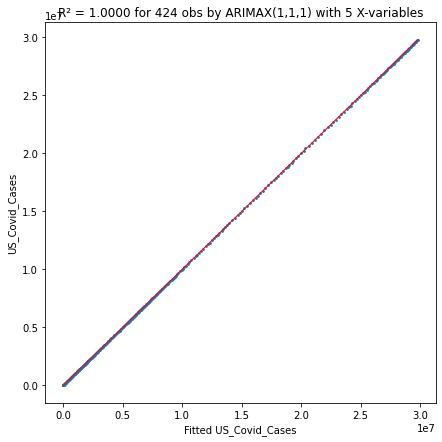

StdErr(Fitted) = 16058.461379398015 (same as for 1st forecast value below)


ARIMA forecast for 14 future values of 'US_Covid_Cases' using 5 X-variables...

                Forecast      Std Error
2021-03-21  2.985858e+07   16058.461379
2021-03-22  2.990536e+07   27658.741557
2021-03-23  2.995118e+07   40004.069274
2021-03-24  2.999342e+07   53289.891554
2021-03-25  3.003306e+07   67502.446253
2021-03-26  3.007256e+07   82589.089302
2021-03-27  3.011228e+07   98491.468265
2021-03-28  3.014720e+07  115153.866658
2021-03-29  3.017888e+07  132525.226135
2021-03-30  3.020896e+07  150559.312561
2021-03-31  3.023545e+07  169214.332487
2021-04-01  3.026315e+07  188452.422241
2021-04-02  3.029219e+07  208239.149370
2021-04-03  3.032095e+07  228543.068650


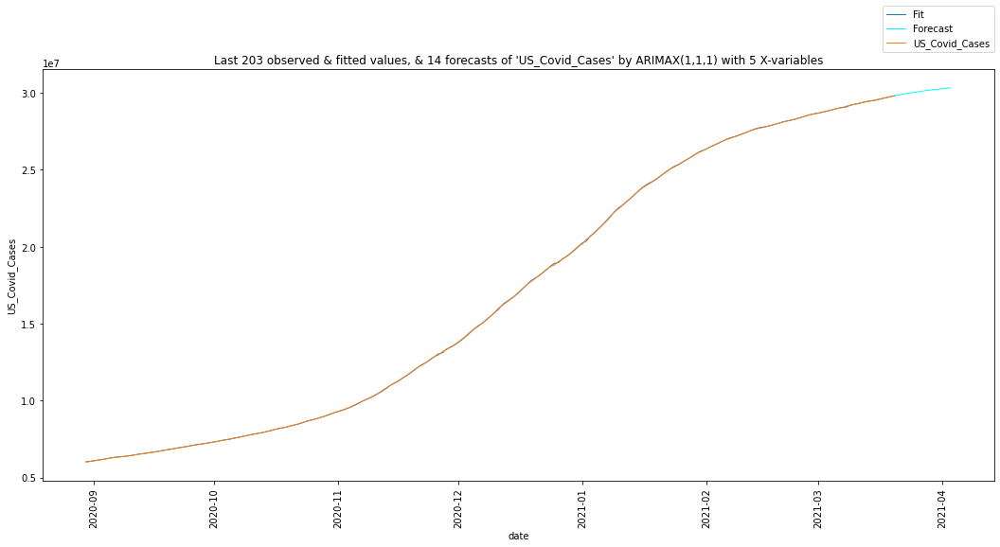


Fitting Auto SARIMA(X) for the last 425 obs of 'US_Covid_Cases' using 5 X-variables: ['cumCasesByPublishDate', 'cumVirusTests', 'cumDailyNsoDeathsByDeathDate', 'cumAdmissions', 'US_Covid_Deaths']... (this may take time)

                                       SARIMAX Results                                        
Dep. Variable:                                      y   No. Observations:                  425
Model:             SARIMAX(2, 0, 1)x(2, 0, [1, 2], 7)   Log Likelihood               -4860.703
Date:                                Thu, 22 Apr 2021   AIC                           9749.407
Time:                                        13:50:58   BIC                           9806.136
Sample:                                    01-21-2020   HQIC                          9771.818
                                         - 03-20-2021                                         
Covariance Type:                                  opg                                         
                  

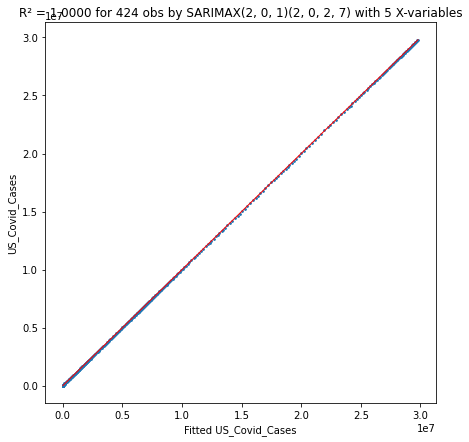

SARIMA forecast for 14 future values of 'US_Covid_Cases' using 5 X-variables...

2021-03-21    2.988318e+07
2021-03-22    2.993875e+07
2021-03-23    2.997752e+07
2021-03-24    3.004819e+07
2021-03-25    3.010050e+07
2021-03-26    3.013435e+07
2021-03-27    3.015370e+07
2021-03-28    3.019156e+07
2021-03-29    3.020105e+07
2021-03-30    3.019103e+07
2021-03-31    3.019656e+07
2021-04-01    3.015919e+07
2021-04-02    3.012228e+07
2021-04-03    3.007486e+07
Freq: D, Name: Forecast, dtype: float64


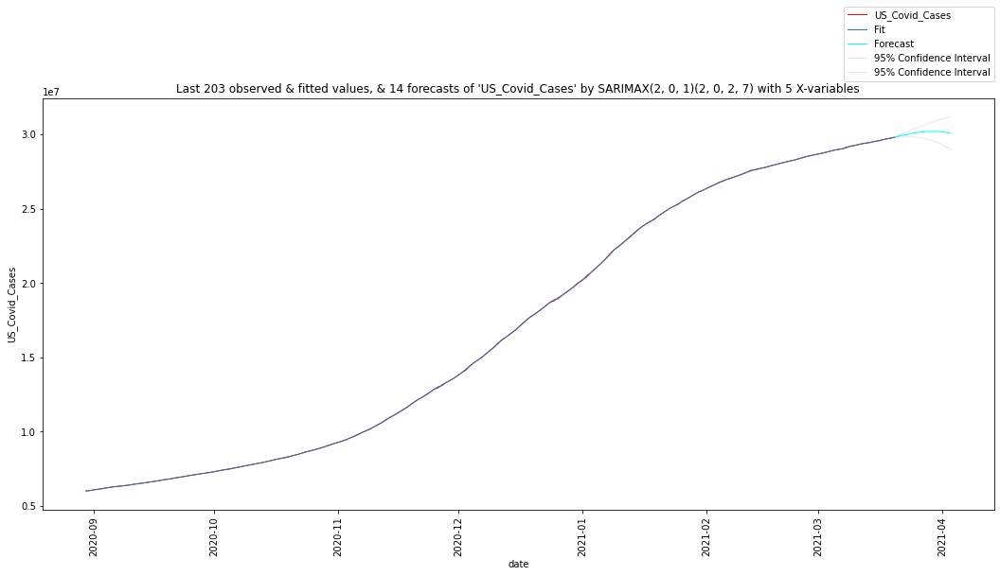

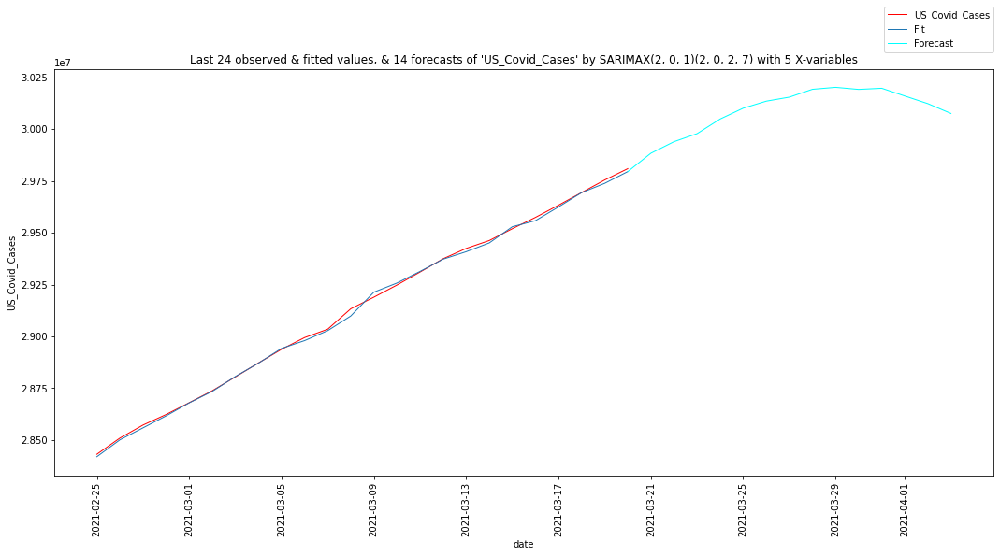

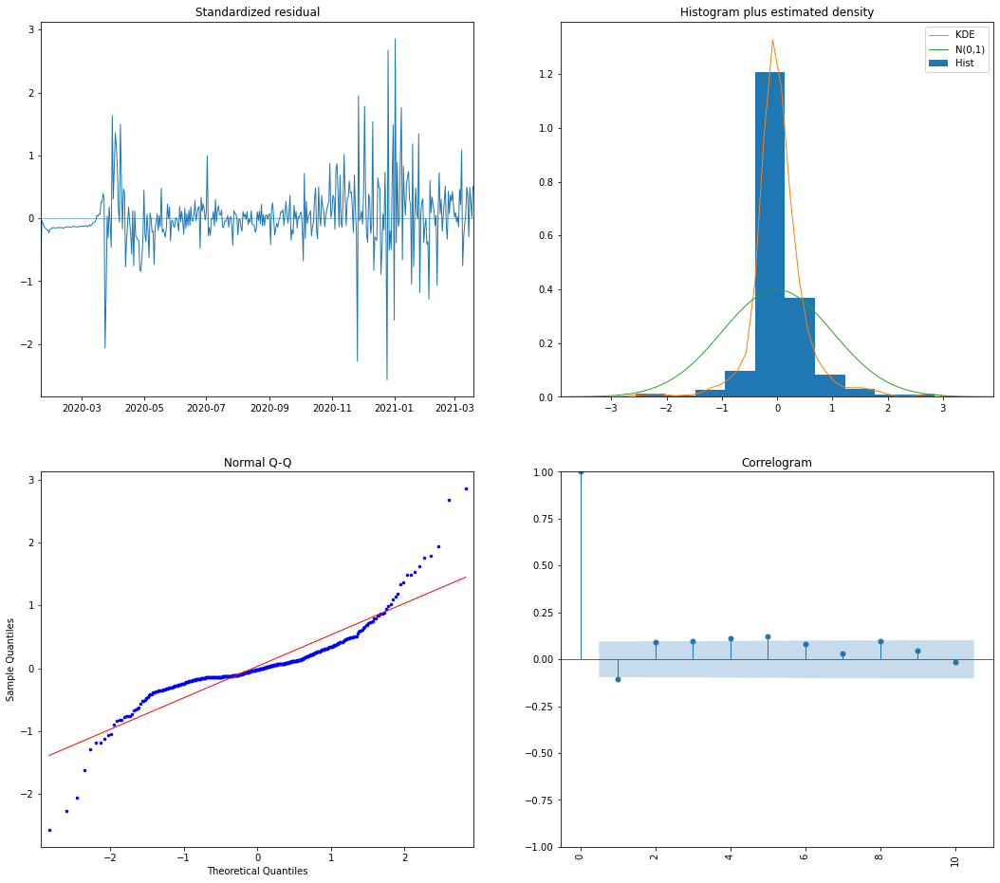

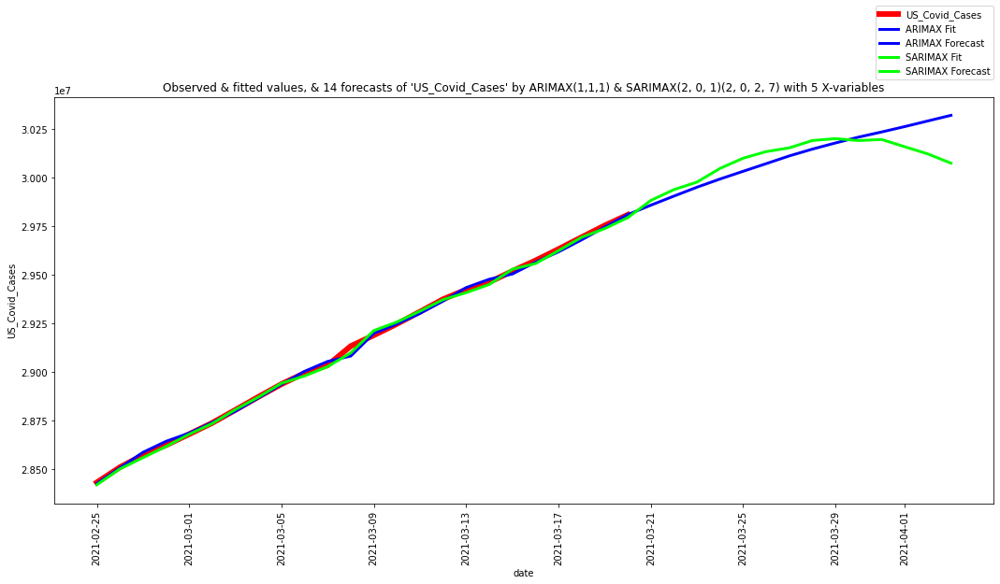

Analysis for time series "US_Covid_Cases" took 1.38 mins.


In [32]:
## Time Series ARIMA, ARIMAX or auto SARIMAX Forecast

#only have to specify filename, yname & timestamp-name; all other columns will be taken as Xs
#Xs should first go through regression variable selection

#categorical variables will be deleted
#missing values are automatically handled

#processed input data may be written to disk, just before analysis, using the parameter writedata

#warning messages only appears for first run

#SARIMAX Seasonal AutoRegressive Integrated Moving Average with eXogenous regressors
#https://www.statsmodels.org/dev/examples/notebooks/generated/statespace_sarimax_stata.html

import time
stm = time.time()
import os
try:
    os.chdir(os.environ['USERPROFILE'] + '\Documents' + r"\0_Teach\data") #change "\0_Teach\data" accordingly
except:
    try:
        os.chdir('/Users/' + os.environ['USER'] + '/Documents' + r"/0_Teach/data") #for Mac
    except:
        #assume data file in current folder
        pass

import pandas as pd
#df = pd.read_excel(r"COE_TimeSeries_lag5.xlsx", index_col=0) #ARIMAX

#in the target (y) column, leave tail periods to be forecasted blank
#older python does not read .xlsx:

# #df = pd.read_excel(r"COE_TimeSeries_lag5.xlsx").iloc[:, :2] #ARIMA, only 2 columns needed
# df = pd.read_excel(r"COE_TimeSeries_lag5.xlsx") #ARIMAX
# tn = 'Date' #time-stamp column, for index (row labels)
# #the index (row labels) must not have any NaN
# yn = 'CatECOE'#time series column
# pc = 24 #periodicity; randomly assumed here; e.g. weekly data would be 7, monthly 12, quarterly 4
# #input y2 for testing set if available; else, comment out next 3 lines:
# y2 = [44000, 39903, 38801, 39000, 38000] #n2 actual future values kept for comparing with forecasts

# df = pd.read_csv('SARIMAX_grid-search_prepared_data.csv')

# df.drop(['FTSE100 Close', 'Bitcoin Price', 'Crude Oil Price'], axis=1, inplace=True)
tn = 'date' #time serial column name
yn = "US_Covid_Cases"
pc = 7
# y2 = [1643, 1875, 1938, 1986, 1944, 1982, 1592] #n2 actual future values kept for comparing with forecasts

#if frequency not inferred correctly, then freq=None :
df.index = pd.to_datetime(df[tn], infer_datetime_format=True)
#df.index = pd.DatetimeIndex(df[tn], freq=pd.infer_freq(df[tn]))
# f = 'SMS-16' #frequency specified; might be changed by inference
# if df.index.freq == None:
#     #reset freq to inferred if possible
#     #warning: this frequently fails!
#     z = pd.infer_freq(df.index)
#     #print('Inferred freq =', z, '\n')
#     if z != None:
#         if f != 'SMS-16' or z != '15D':
#             print('Setting freq to inferred "' + z + '".\n')
#             f = z
#     elif f == '':
#         f = z
# else:
#     f = df.index.freq
# df.index.freq = f

print('Dataset has', len(df), 'rows and the following columns:')
print(list(df), '\n')

import numpy as np

# #artificially set some NaNs at the start and in the middle for y:
# df.iloc[:4, list(df).index(yn)] = np.nan
# df.iloc[10:14, list(df).index(yn)] = np.nan
# print(df.iloc[:15, list(df).index(yn)])

y = pd.DataFrame(df[yn])

s = list(y.index).index(y.isnull().ne(True).idxmax()[0]) + 1 #position of first non-missing at the start
print(df.head(max(s, 3))) #show all of any missing at the start
y.interpolate(limit_area='inside', inplace=True) #fill in missing in the middle
e = max((len(y) - y.count())[0] - s + 2, 3)
print(df.tail(e)) #shows all of any missing at the end

#if not time series, to remove any row with NaN, inf or -inf: df[~df.isin([np.nan, np.inf, -np.inf]).any(1)]

#delete any row with missing y at the start:
df = df.select_dtypes(include='number').iloc[s - 1:, :] #only use numeric columns
df.interpolate(limit_area='inside', inplace=True) #interpolate, but not extrapolate for either end

# x = df.drop(yn, 1)
# df.drop(yn, 1).interpolate(limit_direction='both', inplace=True) #fill in missing at the beginning & the end
#fill in missing at the beginning & the end:
df = pd.concat([y.iloc[s - 1:, :], df.drop(yn, 1).interpolate(limit_direction='both')], 1)
#also df.bfill() & df.ffill()

writedata = False #write processed data to disk
if writedata:
    kname = 'auto_SARIMAX_prepared_data.csv'
    if os.path.exists(kname):
        os.remove(kname)
    pd.concat([y, x], 1).to_csv(kname)
    print('\n' + kname, 'written to disk.')
    del kname
del os, writedata

if 'y2' in vars():
    #using df.index was inspired by Ong Jun Hong:
    y2 = pd.Series(y2, index=pd.date_range(df.index[-(len(df[yn]) - df[yn].count() + 1)], periods=len(y2)+1,
                                           freq=df.index.freq)[1:]).rename(yn + ' (unused)')

#done preparing time series

n0 = int(df[yn].count()) #number of non-Nan values; type(df[yn].count())=<class 'numpy.int32'>
n2 = len(df) - n0 #periods to forecast ahead
### CHanged 
n2 = 14
n2 = pc if n2 == 0 else n2
n = min(3653, n0) #use only the last 3653 observations
if n != n0:
    print('Only the last', n, 'of', n0, 'observations will be used for fitting.\n')
n1 = min(len(df[yn]), n + n2)
y = df[yn][-n1:-n2] #last 5 rows have no row labels
x =  df.iloc[-n1:-n2, 1:] #for fitting in-sample values
x2 = df.iloc[-n2:, 1:] #for forecasting future values
xc = x.shape[1] #number of X variables


#fit ARIMA to time series

from IPython.core.display import display, HTML
display(HTML("<style>div.output_scroll { height: 31em; }</style>"))

p, d, q = 1, 1, 1
print(f'\033[1m' + '\nFitting ARIMA' + ('X' if xc > 0 else '') + '(' + str(p) + ',' + str(d) + ',' + str(q)
      + ') for the last', len(y), "obs of '" + yn + ("' using " + str(xc) + ' X-variables: '
                                             + str(list(x)) if xc > 0 else "'")
      + '...\n' + f'\033[0m') #in bold

from statsmodels.tsa.arima_model import ARIMA
# from statsmodels.tsa.arima.model import ARIMA
#https://www.statsmodels.org/stable/generated/statsmodels.tsa.arima.model.ARIMA.html

#https://statsmodels.org/stable/generated/statsmodels.tsa.arima_model.ARIMA.fit.html
#out = ARIMA(y, order=(1,1,1), missing='raise').fit(trend='c', transparams=True)
out = ARIMA(y, (p,d,q), x).fit() if xc > 0 else ARIMA(y, (p,d,q)).fit()
# out = ARIMA(y, x, (p,d,q)).fit() if xc > 0 else ARIMA(y, (p,d,q)).fit()
#(p,d,q)=(1,1,1) is only as an example here
#print(dir(out))

print(out.summary(), '\n')

#check reliability of model:
tt  = out.tvalues #z-values
if min(tt) > -np.inf and max(tt) < np.inf:
    tt = out.summary().as_text()
    tt = tt[tt.find('Kurtosis') - 7:][:4] #Prob(H) (two-sided)
    if tt == ' nan' or tt == '1.00' or tt == '0.00':
        iss = True
    else:
        iss = False
else:
    iss = True
if iss:
    print('This model is not reliable!\n')
del tt, iss

#https://statsmodels.org/stable/generated/statsmodels.tsa.arima_model.ARIMAResults.predict.html
#ft = out.fittedvalues #fitted values for d-integrated(differenced) series, not original series
ft = out.predict(typ='levels') #without 'levels', fitted output will be for d-differenced series
yh = pd.concat((y, ft.rename('Fitted')), 1) #y & yhat
print(yh)

#plot time series vs fit and its 'line'

#plot 'regression' line

mm = np.array([min(ft), max(ft)])
y0 = y[len(y)-len(ft):] #y & ft can have different lengths

import matplotlib.pyplot as pl
%matplotlib inline
pl.rcParams['figure.figsize'] = 7, 7 #square plot

# pl.rcParams['lines.linewidth'] = 1.0
# pl.plot(mm, sum(np.polyfit(ft, y0, 1) * [mm, 1]), 'red') #increase linewidth for darker line
pl.plot(mm, sum(np.polyfit(ft, y0, 1) * [mm, 1]), 'r', lw=1) #increase linewidth for darker line

#scatter time series vs fit

# pl.rcParams['lines.markersize'] = 2.0
# pl.scatter(ft, y0)
pl.scatter(ft, y0, s=3)

pl.ylabel(yn)
pl.xlabel('Fitted ' + yn)
pl.title('R² = ' + str('%.4f' % yh.corr().iloc[1, 0]**2) + ' for ' + str(len(y0)) +
         ' obs by ARIMA' + ('X(' if xc > 0 else '(') + str(p) + ',' + str(d) + ','
         + str(q) + ')' + (' with ' + str(xc) + ' X-variables' if xc > 0 else ''))
pl.show()

#print('forecast error:', out._forecast_error) #doesn't work
# out.sigma2 is a bit different from sum((y-ft).dropna()**2)/len(ft)
print('StdErr(Fitted) =', np.sqrt(out.sigma2), '(same as for 1st forecast value below)' '\n\n')
# print('StdErr(Fitted) =', np.sqrt(out.mse), '(same as for 1st forecast value below)' '\n\n')

#forecast future values

#future 2.5% or 5 periods of time series:
#stnd = pd.date_range(y.index[-1], periods=max(1, min(n2, len(y)//40)) + 1, freq=y.index.freq)

stnd = pd.date_range(y.index[-1], periods=n2+1, freq=y.index.freq)
print(f'\033[1m' + 'ARIMA forecast for', n2, "future values of '" + yn
      + ("' using " + str(xc) + ' X-variables' if xc > 0 else "'") + '...\n' + f'\033[0m')

#https://statsmodels.org/stable/generated/statsmodels.tsa.arima_model.ARIMAResults.forecast.html
fc, stderr, confint = out.forecast(n2, x2) if xc > 0 else out.forecast(n2)
# print(pd.concat((pd.Series(fc).rename('Forecast'), pd.Series(stderr).rename('Std Error')), 1
#                ).set_index(stnd[1:])) #also works
# print(pd.concat((pd.Series(fc, name='Forecast'), pd.Series(stderr, name='Std Error')), 1
#                ).set_index(stnd[1:])) #also works
print(pd.concat((pd.Series(fc), pd.Series(stderr)), 1, keys=['Forecast', 'Std Error']
               ).set_index(stnd[1:]))
fc = pd.Series(fc, index=pd.date_range(ft.index[-1], periods=len(fc)+1,
                                    freq=ft.index.freq)[1:]).rename('Forecast')

#plot last 200+ training periods' observed & fitted, & forecast

nb = -(-200 // pc * pc) if pc > 1 else 200 #last training periods to plot

pl.rcParams['figure.figsize'] = 18, 8 #use the whole width of window
#https://matplotlib.org/api/_as_gen/matplotlib.pyplot.plot.html
pl.title('Last ' + str(nb) + ' observed & fitted values, & ' + str(n2) + " forecasts of '"
         + yn + "' by ARIMA" + ('X(' if xc > 0 else '(') + str(p) + ',' + str(d) + ','
         + str(q) + ')' + (' with ' + str(xc) + ' X-variables' if xc > 0 else ''))
pl.plot(ft[-nb:], label='Fit')
pl.plot(ft[-1:].append(fc), c='cyan', label=fc.name)

pl.plot(y[-nb:], label=yn)

#https://matplotlib.org/api/_as_gen/matplotlib.pyplot.legend.html
# #place legend precisely for 18x8 plot & 2 series; might cover title
# pl.legend(bbox_to_anchor=(1.005, 1.087))
pl.legend(bbox_to_anchor=(1.005, 1.165))
#pl.legend(loc='best') #avoid plotted space within the frame, but cpu-intensive
#pl.legend(loc='upper left')

pl.xticks(rotation=90)
pl.xlabel(y.index.name)
pl.ylabel(yn)
pl.show()

#plot last few training periods' observed & fitted, & forecast

#last 10% or 24 periods of time series:
lt = max(2, min(max(2 * pc, 24), (len(y) - 1) // 10))
start = y.index[-lt]
#future 2.5% or 5 periods of time series:
end = stnd[-1]

# #https://statsmodels.org/stable/generated/statsmodels.tsa.arima_model.ARMAResults.plot_predict.html
# out.plot_predict(start, end, x2) if xc > 0 else out.plot_predict(start, end)
# pl.plot(ft[-1:].append(fc), c='cyan')

# pl.legend(bbox_to_anchor=(1.005, 1.180)) #place legend precisely for 18x8 plot to avoid title
# #pl.legend(loc='upper left') #relocate the legend

# #pl.xticks(rotation=90, ha='center', rotation_mode='anchor') #center labels at tick marks
# pl.xticks(rotation=90, ha='center') #center labels at tick marks

# pl.xlabel(y.index.name)
# pl.ylabel(yn)
# pl.title('Last ' +  str(lt) + ' observed & fitted values, & ' + str(n2) + " forecasts of '"
#          + yn + "' by ARIMA" + ('X(' if xc > 0 else '(') + str(p) + ',' + str(d) + ','
#          + str(q) + ')' + (' with ' + str(xc) + ' X-variables' if xc > 0 else ''))
# pl.show()


#Fit SARIMAX Seasonal AutoRegressive Integrated Moving Average with X variables

import warnings
#suppress warning messages (those with peach background)
warnings.simplefilter('ignore')
warnings.filterwarnings('ignore')
warnings.filterwarnings('ignore', 'statsmodels.tsa.arima_model.ARMA',
                        FutureWarning)
warnings.filterwarnings('ignore', 'statsmodels.tsa.arima_model.ARIMA',
                        FutureWarning)

#do below only once, to install pmdarima

#alkaline-ml no longer available:
#!conda install -c alkaline-ml pmdarima --y

#for python before 3.8:
#!conda install -c Saravji pmdarima --y

#as last resort:
#pip install pmdarima 

#https://www.statsmodels.org/stable/generated/statsmodels.tsa.statespace.sarimax.SARIMAX.html
#https://www.statsmodels.org/devel/examples/notebooks/generated/statespace_sarimax_pymc3.html
#https://stackoverflow.com/questions/22770352/auto-arima-equivalent-for-python
#https://iprokin.github.io/posts/2017-01-08-idARIMA.html

try:
    #https://alkaline-ml.com/pmdarima/modules/generated/pmdarima.arima.auto_arima.html
    from pmdarima.arima import auto_arima #wrapper around statsmodels arima
except:
    import six
    import sys
    sys.modules['sklearn.externals.six'] = six
    import joblib
    sys.modules['sklearn.externals.joblib'] = joblib
    from pmdarima.arima import auto_arima #wrapper around statsmodels arima

print(f'\033[1m' + '\nFitting Auto SARIMA(X) for the last', len(y), "obs of '" + yn +
      ("' using " + str(xc) + ' X-variables: ' + str(list(x)) if xc > 0 else "'")
      + '...' + f'\033[0m', '(this may take time)\n') #in bold

#o = auto_arima(y) #auto ARIMA; not SARIMA

#1 = no seasonality; 7 for daily, 4 for quarterly, 12 for monthly:

if xc > 0:
    #auto SARIMAX
    o = auto_arima(y, x, start_p=0, start_q=0, max_p=pc, max_d=3, max_q=pc, #for y
                         start_P=0, start_Q=0, max_P=pc, max_D=3, max_Q=pc, #for seasonal
                         max_order=None, #p+q+P+Q; None means no constraints on maximum order
    #o = auto_arima(y, x,
#                    m=1 if pc == 24 else pc, #'m != 1' makes this code run for longer
                   m=pc, #'m != 1' makes this code run for longer
                   suppress_warnings=True, error_action='ignore', n_jobs=-1)
                   #n_jobs=-1 above tries to use all CPU threads
    fit = o.predict_in_sample(x)
    if type(fit) == np.ndarray:
        fit = pd.Series(fit, index=y.index)
else:
    #auto SARIMA
    o = auto_arima(y, start_p=0, start_q=0, max_p=pc, max_d=3, max_q=pc, #for y
                      start_P=0, start_Q=0, max_P=pc, max_D=3, max_Q=pc, #for seasonal
                      max_order=None, #p+q+P+Q; None means no constraints on maximum order
    #o = auto_arima(y,
#                    m=1 if pc == 24 else pc, #'m != 1' makes this code run for longer
                   m=pc, #'m != 1' makes this code run for longer
                   suppress_warnings=True, error_action='ignore', n_jobs=-1)
    fit = o.predict_in_sample() #fit
    #fit is numpy array when no x
    fit = pd.Series(fit, index=pd.date_range(y.index[-len(fit)], periods=len(fit),
                                   freq=y.index.freq))

# print(dir(o), '\n')
# ['__abstractmethods__', '__class__', '__delattr__', '__dict__', '__dir__', '__doc__',
#  '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__',
#  '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__',
#  '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__setstate__',
#  '__sizeof__', '__str__', '__subclasshook__', '__weakref__', '_abc_impl', '_check_exog',
#  '_clear_cached_state', '_fit', '_get_param_names', '_get_tags', '_legacy_set_state',
#  '_more_tags', '_warn_for_older_version', 'aic', 'aicc', 'arima_res_', 'arparams',
#  'arroots', 'bic', 'bse', 'conf_int', 'df_model', 'df_resid', 'fit', 'fit_predict',
#  'fit_with_exog_', 'get_params', 'hqic', 'maparams', 'maroots', 'maxiter', 'method',
#  'nobs_', 'oob', 'oob_', 'oob_preds_', 'order', 'out_of_sample_size', 'params',
#  'pkg_version_', 'plot_diagnostics', 'predict', 'predict_in_sample', 'pvalues', 'resid',
#  'sarimax_kwargs', 'scoring', 'scoring_args', 'seasonal_order', 'set_params',
#  'start_params', 'summary', 'suppress_warnings', 'to_dict', 'trend', 'update',
#  'with_intercept']
# print(o.scoring, '\n')

print(o.summary(), '\n')
#http://medium.com/@josemarcialportilla/using-python-and-auto-arima-to-forecast-seasonal-time-series-90877adff03c

#check reliability of model:
try:
    tt  = o.params()/o.bse() #z-values
    if min(tt) > -np.inf and max(tt) < np.inf:
        tt = o.summary().as_text()
        tt = tt[tt.find('Kurtosis') - 7:][:4] #Prob(H) (two-sided)
        if tt == ' nan' or tt == '1.00' or tt == '0.00':
            iss = True
        else:
            iss = False
    else:
        iss = True
    del tt
except:
    iss = True
if iss:
    print('This model is not reliable!\n')
del iss

yhs = pd.concat((y, fit.rename('Fitted')), 1) #y & yhat #this works with updated pmdarima
# yhs = pd.concat((y, pd.Series(fit, index=y.index).rename('Fitted')), 1) #y & yhat
print(yhs) #y-hat for SARIMA/X

#plot time series vs fit and its 'line'

#plot 'regression' line
mm = np.array([min(fit.iloc[1:]), max(fit.iloc[1:])])
y0 = y[len(y)-len(fit):] #y & fit can have different lengths

pl.rcParams['figure.figsize'] = 7, 7 #square plot

# pl.rcParams['lines.linewidth'] = 1.0
# pl.plot(mm, sum(np.polyfit(fit, y0, 1) * [mm, 1]), 'red') #increase linewidth for darker line
pl.plot(mm, sum(np.polyfit(fit.iloc[1:], y0.iloc[1:], 1) * [mm, 1]), 'r', lw=1) #increase linewidth for darker line

#scatter time series vs fit

# pl.rcParams['lines.markersize'] = 2.0
# pl.scatter(ft, y0)
pl.scatter(fit.iloc[1:], y0.iloc[1:], s=3)

pl.ylabel(yn)
pl.xlabel('Fitted ' + yn)
pl.title('R² = ' + str('%.4f' % yhs.iloc[1:, :].corr().iloc[1, 0]**2) + ' for ' + str(len(y0) - 1) +
         ' obs by SARIMA' + ('X' if xc > 0 else '') + str(o.order) + str(o.seasonal_order)
         + (' with ' + str(xc) + ' X-variables' if xc > 0 else ''))
pl.show()

print(f'\033[1m' + 'SARIMA forecast for', n2, "future values of '" + yn
      + ("' using " + str(xc) + ' X-variables' if xc > 0 else "'") + '...\n' + f'\033[0m')

# yf = o.predict(n2, x2) if xc > 0 else o.predict(n2) #forecast
yf, ci = o.predict(n2, x2, return_conf_int=True) if xc > 0 else o.predict(n2, return_conf_int=True) #forecast
cs = ci[:, 0] #95% confidence interval lower limit
ce = ci[:, 1] #95% confidence interval upper limit

yf = pd.Series(yf, index=pd.date_range(y.index[-1], periods=len(yf)+1, freq=y.index.freq)[1:]).rename('Forecast')
cs = pd.Series(cs, index=pd.date_range(y.index[-1], periods=len(yf)+1, freq=y.index.freq)[1:]
              ).rename('95% Confidence Interval')
ce = pd.Series(ce, index=pd.date_range(y.index[-1], periods=len(yf)+1, freq=y.index.freq)[1:]
              ).rename('95% Confidence Interval')

if 'y2' in vars():
    print(pd.concat((y2, yf), axis=1))
else:
    print(yf)

pl.rcParams["figure.figsize"] = 18, 8

#plot for last 200+ training periods
nb = min(nb, len(fit) - 1)
pl.plot(y[-nb:], c='r', label=yn)

pl.plot(fit[-nb:], label='Fit')
pl.plot(fit[-1:].append(yf), c='cyan', label=yf.name)
pl.plot(fit[-1:].append(cs), c='grey', alpha=0.2, label=cs.name)
pl.plot(fit[-1:].append(ce), c='grey', alpha=0.2, label=ce.name)
# pl.legend(bbox_to_anchor=(1.005, 1.165))
pl.legend(bbox_to_anchor=(1.005, 1.235))
pl.xticks(rotation=90)
pl.xlabel(y.index.name)
pl.ylabel(yn)
pl.title('Last ' + str(nb) + ' observed & fitted values, & ' + str(n2) + " forecasts of '"
         + yn + "' by SARIMA" + ('X' if xc > 0 else '') + str(o.order)
         + str(o.seasonal_order) + (' with ' + str(xc) + ' X-variables' if xc > 0 else ''))
pl.show()

#plot for last few training periods
pl.plot(y[-lt:], c='r', label=yn)
if 'y2' in vars():
    pl.plot(y[-1:].append(y2), c='r', alpha=.2)
pl.plot(fit[-lt:], label='Fit')
pl.plot(fit[-1:].append(yf), c='cyan', label=yf.name)
pl.legend(bbox_to_anchor=(1.005, 1.165))
pl.xticks(rotation=90)
pl.xlabel(y.index.name)
pl.ylabel(yn)
pl.title('Last ' + str(lt) + ' observed & fitted values, & ' + str(n2) + " forecasts of '" + yn
         + "' by SARIMA" + ('X' if xc > 0 else '') + str(o.order) + str(o.seasonal_order)
         + (' with ' + str(xc) + ' X-variables' if xc > 0 else ''))
pl.show()

#diagnostic plots
try:
    #error message could be "'Rectangle' object has no property 'normed'":
    o.plot_diagnostics(figsize=(18, 16))
    pl.xticks(rotation=90)
    pl.show()
except:
    #pmdarima probably not installed by pip
    #clean up
    fig = pl.gcf()
    fig.clear()
    pl.close(fig)

#plot ARIMAX & SARIMAX for last few training periods & forecasts

pl.plot(y[-lt:], c='r', lw=6, label=yn)
if 'y2' in vars():
    pl.plot(y[-1:].append(y2), c='r', lw=6, alpha=.075)
    del y2

pl.plot(ft[-lt:], c='b', lw=3, label='ARIMAX Fit')
pl.plot(ft[-1:].append(fc), c='b', lw=3, label='ARIMAX '+fc.name)

pl.plot(fit[-lt:], c='lime', lw=3, label='SARIMAX Fit')
pl.plot(fit[-1:].append(yf), c='lime', lw=3, label='SARIMAX '+yf.name)

pl.legend(bbox_to_anchor=(1.005, 1.235))
pl.xticks(rotation=90)
pl.xlabel(y.index.name)
pl.ylabel(yn)
pl.title('Observed & fitted values, & ' + str(n2) + " forecasts of '" + yn
         + "' by ARIMA" + ('X(' if xc > 0 else '(') + str(p) + ',' + str(d) + ','
         + str(q) + ') & SARIMA' + ('X' if xc > 0 else '') + str(o.order)
         + str(o.seasonal_order) + (' with ' + str(xc) + ' X-variables' if xc > 0 else ''))
pl.show()

print('Analysis for time series "' + yn + '" took',
      '%.2f' % ((time.time() - stm) / 60), 'mins.')

## Exponential Model Time Series for UK COVID-19

Original dataset:

            date  cumCasesByPublishDate
0    2020-01-21                    0.0
1    2020-01-22                    0.0
2    2020-01-23                    0.0
3    2020-01-24                    0.0
4    2020-01-25                    0.0
..          ...                    ...
434  2021-03-30              4341736.0
435  2021-03-31              4345788.0
436  2021-04-01              4350266.0
437  2021-04-02              4353668.0
438  2021-04-03              4357091.0

[439 rows x 2 columns]

Inferred time series:

date
2020-01-21          0.0
2020-01-22          0.0
2020-01-23          0.0
2020-01-24          0.0
2020-01-25          0.0
                ...    
2021-03-30    4341736.0
2021-03-31    4345788.0
2021-04-01    4350266.0
2021-04-02    4353668.0
2021-04-03    4357091.0
Freq: D, Name: cumCasesByPublishDate, Length: 439, dtype: float64


 
Simple Exponential Forecast:  

                        ExponentialSmoothing Model Results                       
Dep. Variab

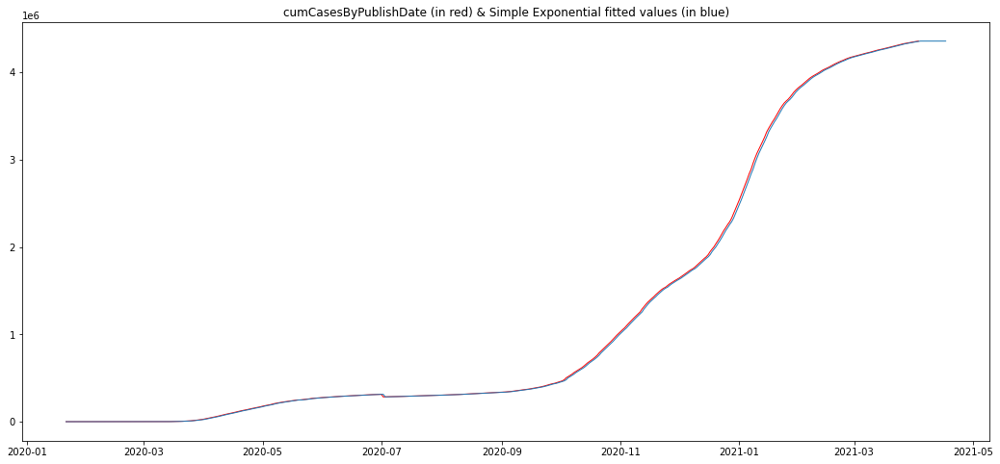



 
Holt's Forecast:  

                        ExponentialSmoothing Model Results                       
Dep. Variable:     cumCasesByPublishDate   No. Observations:                  439
Model:              ExponentialSmoothing   SSE                     4132883485.652
Optimized:                          True   AIC                           7057.349
Trend:                          Additive   BIC                           7073.687
Seasonal:                           None   AICC                          7057.543
Seasonal Periods:                   None   Date:                 Thu, 22 Apr 2021
Box-Cox:                           False   Time:                         17:01:37
Box-Cox Coeff.:                     None                                         
                       coeff                 code              optimized      
------------------------------------------------------------------------------
smoothing_level            0.9950000                alpha                 True
s

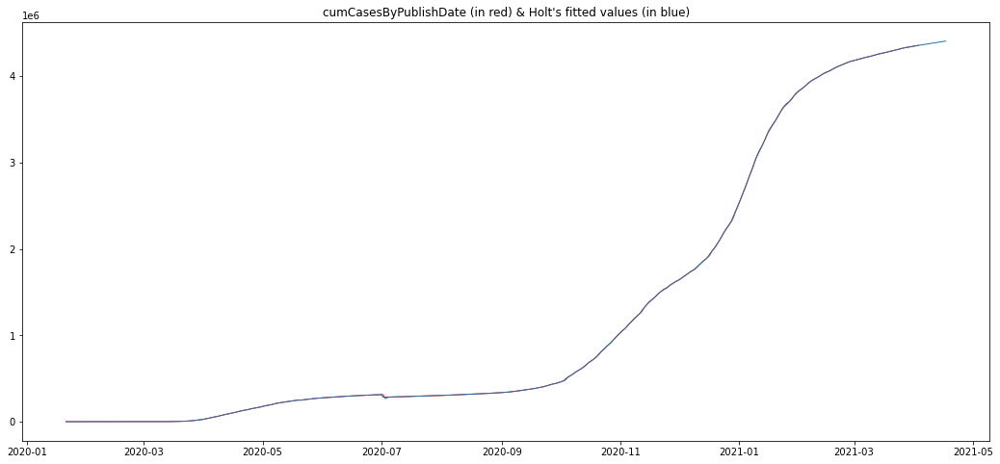



 
Winters' Forecast:  

                        ExponentialSmoothing Model Results                       
Dep. Variable:     cumCasesByPublishDate   No. Observations:                  439
Model:              ExponentialSmoothing   SSE                     4133855926.084
Optimized:                          True   AIC                           7085.452
Trend:                          Additive   BIC                           7158.973
Seasonal:                       Additive   AICC                          7087.461
Seasonal Periods:                     14   Date:                 Thu, 22 Apr 2021
Box-Cox:                           False   Time:                         17:01:38
Box-Cox Coeff.:                     None                                         
                          coeff                 code              optimized      
---------------------------------------------------------------------------------
smoothing_level               0.9950000                alpha            

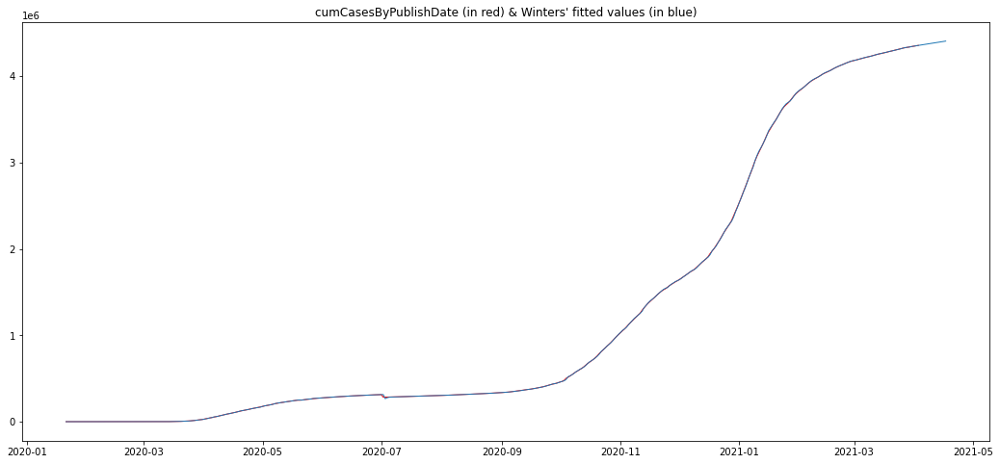

In [47]:
#Time Series Exponential, Holt's, Winters' Forecasts

import os
import pandas as pd
from statsmodels.tsa.api import ExponentialSmoothing

from IPython.core.display import display, HTML
display(HTML("<style>div.output_scroll { height: 31em; }</style>"))
import matplotlib.pyplot as pl
%matplotlib inline
#https://matplotlib.org/tutorials/introductory/customizing.html
pl.rcParams['figure.figsize'] = 18, 8
pl.rcParams['lines.linewidth'] = 1
pl.rcParams['lines.markersize'] = 1

import warnings
warnings.simplefilter('ignore')

# if os.name == 'nt':
#     #Windows:
#     os.chdir(os.environ['USERPROFILE'] + '\Documents' + r"\0_Teach\data")
# else:
#     #Mac:
#     os.chdir('/Users/' + os.environ['USER'] + '/Documents' + r"/0_Teach/data")

# d = pd.read_csv(r"airline-passengers.csv")
df = pd.read_csv("cleaned_data.csv")
d = df[["date", "cumCasesByPublishDate"]]

print('Original dataset:\n\n', d)

d.index = pd.DatetimeIndex(d.iloc[:, 0], freq='infer')
p = 14 #periodicity or period length
d = d.iloc[:, 1:] #remove row labels, i.e. index
y = d.iloc[:, 0] #keep only 1st column; here same as d
print('\nInferred time series:\n')
print(y)

def snf(m, o, p, y):
    # m=method, o=output from fit(), p=periodicity, y=time series
    #output summary & fit
    
    print(2 * '\n', f'\033[1m')
    print(m, 'Forecast:', f'\033[0m', '\n')
    print(o.summary())

    #ix = pd.DatetimeIndex(f.index.append(f2.index), freq=f.index.freqstr) #works but not used
    #ix = pd.date_range(f.index[0], f2.index[-1], freq=f.index.freqstr) #works identically but not used
    
    f = pd.concat([o.fittedvalues, o.forecast(p)], axis=0)
    f.index.name = y.index.name
    f.name = y.name
    print('\n' + m, 'last few fitted & forecast values:\n')
    print(f.tail(p + 3))
    
    pl.title(y.name + ' (in red) & ' + m + ' fitted values (in blue)')
    pl.plot(y, color='red')
    pl.plot(f)
    pl.show()
    
#o = ExponentialSmoothing(y.astype('double'), freq=y.index.freq, seasonal_periods=12, missing='raise')
o = ExponentialSmoothing(y, freq=y.index.freqstr, seasonal_periods=p).fit()
snf('Simple Exponential', o, p, y)

o = ExponentialSmoothing(y, freq=y.index.freqstr, trend='add', seasonal_periods=p).fit()
snf("Holt's", o, p, y)

# Use additive model as we have rows with 0 values!
o = ExponentialSmoothing(y, freq=y.index.freqstr, trend='add', seasonal='add', seasonal_periods=p).fit()
snf("Winters'", o, p, y)

## Exponential Model Time Series for US Covid-19

Original dataset:

            date  US_Covid_Cases
0    2020-01-21             1.0
1    2020-01-22             1.0
2    2020-01-23             1.0
3    2020-01-24             2.0
4    2020-01-25             3.0
..          ...             ...
434  2021-03-30      30416970.0
435  2021-03-31      30485232.0
436  2021-04-01      30562856.0
437  2021-04-02      30631700.0
438  2021-04-03      30631700.0

[439 rows x 2 columns]

Inferred time series:

date
2020-01-21           1.0
2020-01-22           1.0
2020-01-23           1.0
2020-01-24           2.0
2020-01-25           3.0
                 ...    
2021-03-30    30416970.0
2021-03-31    30485232.0
2021-04-01    30562856.0
2021-04-02    30631700.0
2021-04-03    30631700.0
Freq: D, Name: US_Covid_Cases, Length: 439, dtype: float64


 
Simple Exponential Forecast:  

                       ExponentialSmoothing Model Results                       
Dep. Variable:           US_Covid_Cases   No. Observations:                  439
Model:     

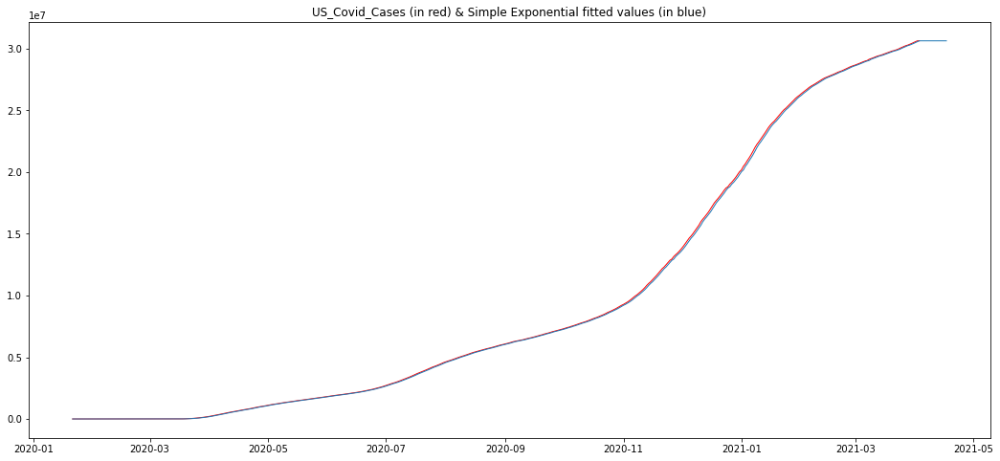



 
Holt's Forecast:  

                       ExponentialSmoothing Model Results                       
Dep. Variable:           US_Covid_Cases   No. Observations:                  439
Model:             ExponentialSmoothing   SSE                   122089594427.002
Optimized:                         True   AIC                           8543.706
Trend:                         Additive   BIC                           8560.044
Seasonal:                          None   AICC                          8543.900
Seasonal Periods:                  None   Date:                 Thu, 22 Apr 2021
Box-Cox:                          False   Time:                         17:02:27
Box-Cox Coeff.:                    None                                         
                       coeff                 code              optimized      
------------------------------------------------------------------------------
smoothing_level            0.9950000                alpha                 True
smoothing_

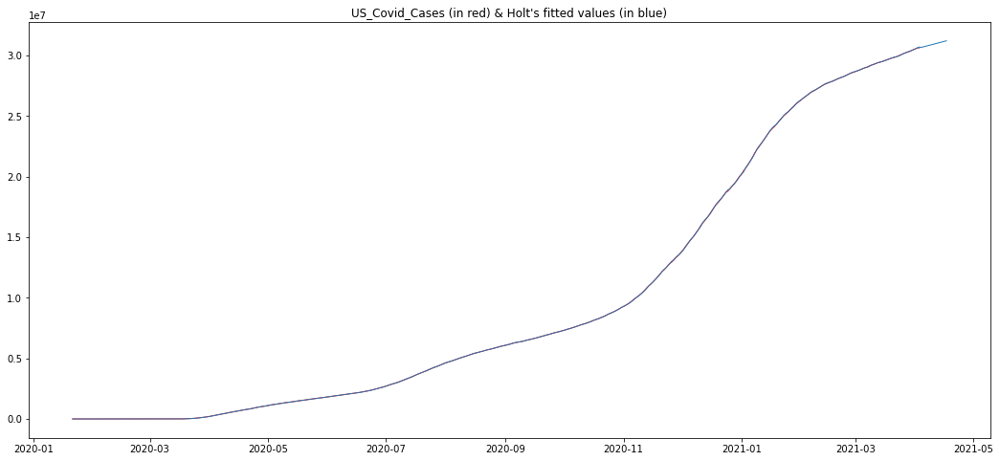



 
Winters' Forecast:  

                       ExponentialSmoothing Model Results                       
Dep. Variable:           US_Covid_Cases   No. Observations:                  439
Model:             ExponentialSmoothing   SSE                   110718824753.833
Optimized:                         True   AIC                           8528.789
Trend:                         Additive   BIC                           8602.310
Seasonal:                      Additive   AICC                          8530.798
Seasonal Periods:                    14   Date:                 Thu, 22 Apr 2021
Box-Cox:                          False   Time:                         17:02:27
Box-Cox Coeff.:                    None                                         
                          coeff                 code              optimized      
---------------------------------------------------------------------------------
smoothing_level               0.8182143                alpha                 True

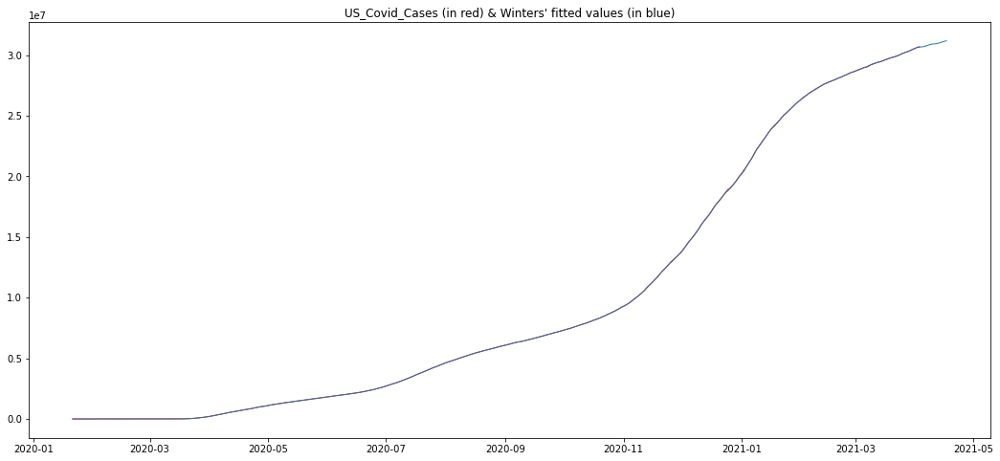

In [48]:
#Time Series Exponential, Holt's, Winters' Forecasts

import os
import pandas as pd
from statsmodels.tsa.api import ExponentialSmoothing

from IPython.core.display import display, HTML
display(HTML("<style>div.output_scroll { height: 31em; }</style>"))
import matplotlib.pyplot as pl
%matplotlib inline
#https://matplotlib.org/tutorials/introductory/customizing.html
pl.rcParams['figure.figsize'] = 18, 8
pl.rcParams['lines.linewidth'] = 1
pl.rcParams['lines.markersize'] = 1

import warnings
warnings.simplefilter('ignore')

# if os.name == 'nt':
#     #Windows:
#     os.chdir(os.environ['USERPROFILE'] + '\Documents' + r"\0_Teach\data")
# else:
#     #Mac:
#     os.chdir('/Users/' + os.environ['USER'] + '/Documents' + r"/0_Teach/data")

# d = pd.read_csv(r"airline-passengers.csv")
df = pd.read_csv("cleaned_data.csv")
# print(df)
d = df[["date", "US_Covid_Cases"]]

print('Original dataset:\n\n', d)

d.index = pd.DatetimeIndex(d.iloc[:, 0], freq='infer')
p = 14 #periodicity or period length
d = d.iloc[:, 1:] #remove row labels, i.e. index
y = d.iloc[:, 0] #keep only 1st column; here same as d
print('\nInferred time series:\n')
print(y)

def snf(m, o, p, y):
    # m=method, o=output from fit(), p=periodicity, y=time series
    #output summary & fit
    
    print(2 * '\n', f'\033[1m')
    print(m, 'Forecast:', f'\033[0m', '\n')
    print(o.summary())

    #ix = pd.DatetimeIndex(f.index.append(f2.index), freq=f.index.freqstr) #works but not used
    #ix = pd.date_range(f.index[0], f2.index[-1], freq=f.index.freqstr) #works identically but not used
    
    f = pd.concat([o.fittedvalues, o.forecast(p)], axis=0)
    f.index.name = y.index.name
    f.name = y.name
    print('\n' + m, 'last few fitted & forecast values:\n')
    print(f.tail(p + 3))
    
    pl.title(y.name + ' (in red) & ' + m + ' fitted values (in blue)')
    pl.plot(y, color='red')
    pl.plot(f)
    pl.show()
    
#o = ExponentialSmoothing(y.astype('double'), freq=y.index.freq, seasonal_periods=12, missing='raise')
o = ExponentialSmoothing(y, freq=y.index.freqstr, seasonal_periods=p).fit()
snf('Simple Exponential', o, p, y)

o = ExponentialSmoothing(y, freq=y.index.freqstr, trend='add', seasonal_periods=p).fit()
snf("Holt's", o, p, y)

# Use additive model as we have rows with 0 values!
o = ExponentialSmoothing(y, freq=y.index.freqstr, trend='add', seasonal='add', seasonal_periods=p).fit()
snf("Winters'", o, p, y)

## ARIMA UK COVID 19


Versions: conda 4.9.2 jupyter-notebook 6.1.6 IPython 7.19.0 Python 3.7.9 numpy 1.19.2 pandas 1.2.0 scipy 1.5.2
          statsmodels 0.12.1


            cumCasesByPublishDate
2020-01-21                    0.0
2020-01-22                    0.0
2020-01-23                    0.0
            cumCasesByPublishDate
2021-04-03              4357091.0
2021-04-04                    NaN
2021-04-05                    NaN
2021-04-06                    NaN
2021-04-07                    NaN
2021-04-08                    NaN
2021-04-09                    NaN
2021-04-10                    NaN
2021-04-11                    NaN
2021-04-12                    NaN
2021-04-13                    NaN
2021-04-14                    NaN
2021-04-15                    NaN
2021-04-16                    NaN
2021-04-17                    NaN

Fitting (p,d,q) = (14,0,1) ...   [p = any number of missing at the end, else 1]

                                ARMA Model Results                               
Dep. Variable:     cumCasesByPublishDate   No. Observations:                  439
Model:                       ARMA(14, 1)   Log Likelihood               -4

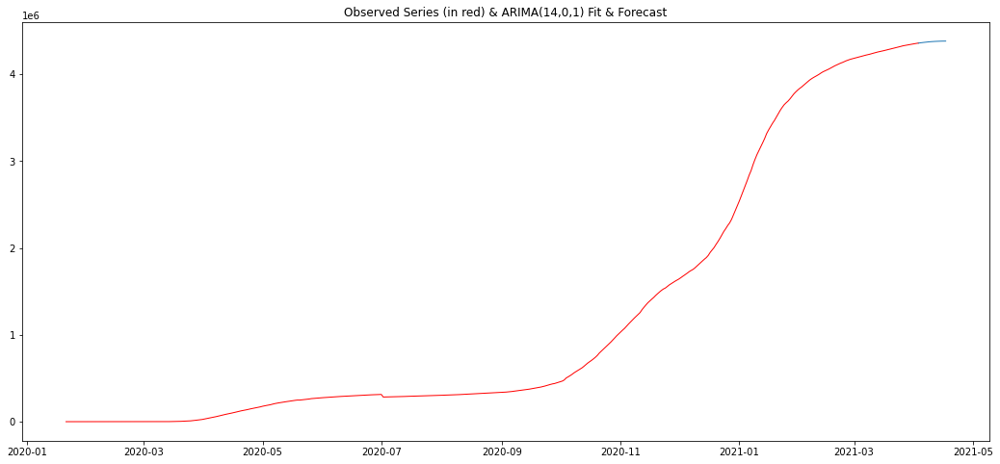

In [35]:
#Time Series ARIMA(p,d,q) Forecast

#p = any number of missing at the end, else 1

#delete any missing at the start,
#    leave any missing at the end,
#    interpolate in between,
#    add more missing at the end for forecast

#data file has only 2 columns: time-serial & y

#begin of standard header

import os
import IPython
import sys
import numpy as np
import pandas as pd
import scipy
import statsmodels as sm
import matplotlib.pyplot as pl
%matplotlib inline

#for debugging compatibility issues:
a = ! jupyter-notebook --version
v = ! conda --version
print('\nVersions:', str(v)[str(v).find('conda'):-2] + ' jupyter-notebook', str(a)[2:-2]
      + ' IPython', ".".join(map(str, IPython.version_info[:3])) + ' Python', ".".join(map(str, sys.version_info[:3]))
      + ' numpy', np.__version__ + ' pandas', pd.__version__ + ' scipy', scipy.__version__)
try:
    print(' ' * 9, 'statsmodels', sm.__version__)
except:
    #for Azure server (2019):
    print(' ' * 9, '...with older version of statsmodels')
del a, v
    
#!conda update --y --all #change #! to ! will update any of your older versions

from IPython.core.display import display, HTML
display(HTML("<style>div.output_scroll { height: 31em; }</style>")) #set height of output window below
pl.rcParams['figure.figsize'] = 18, 8 #width & height for time-series plot
#pl.rcParams['figure.figsize'] = 6.000, 6.143 #best for square plot np.arange(1,10) on screens of diff resolutions?
pl.rcParams['lines.linewidth'] = 1
pl.rcParams['lines.markersize'] = 1

import warnings
warnings.simplefilter('ignore')
warnings.filterwarnings('ignore')

if os.name == 'nt':
    #Windows:
    try:
        os.chdir(os.environ['USERPROFILE'] + '\Documents' + r"\0_Teach\data")
    except:
        #assume file is in current folder
        pass
else:
    #Mac:
    try:
        os.chdir('/Users/' + os.environ['USER'] + '/Documents' + r"/0_Teach/data")
    except:
        #assume file is in current folder
        pass

#end of standard header
    
try:
    #file has only 2 columns: time-serial & y:
#     y = pd.read_csv('daily-total-female-births.csv', index_col=0) #has 7 NaN(s) in the tail, for filling in forecasts
    y = pd.read_csv("cleaned_data.csv", index_col=0)
    y["date"] = pd.to_datetime(y["date"])
    y.index = y["date"]
    y = y["cumCasesByPublishDate"]
#     y = pd.read_csv('UKDeaths_1970-2018.csv', index_col=0) #has 7 NaN(s) in the tail, for filling in forecasts
except:
    print('"'+os.getcwd()+'" is the current folder in the', 'Windows' if os.name == 'nt' else os.name,
          'operating system:\n')
    print('\n'.join(os.listdir()), '\n') #see what's in current folder
    raise SystemExit
    
y.index = pd.to_datetime(y.index) #change index to DatetimeIndex; y is now a time series
r = pd.infer_freq(y.index) #infer frequency from index
start_idx = len(y) - 1
#some of the following 6 lines is not necessary for some datasets:
y = pd.DataFrame(y).iloc[:, :1] #just to make sure y is DataFrame of 1 column, instead of possibly a Series
y.interpolate(limit_area='inside', inplace=True) #interpolate, but not extrapolate for either end
#add in a random few more missing at the end, for further predictions:
a = [np.nan for i in range(0, 14)]
y = y.append(pd.DataFrame(a, index=pd.date_range(y.index[-1], periods=len(a)+1,
                                                 freq=r)[1:], columns=y.columns.values))

# y.iloc[:2, :] = np.nan #artificially create missing at the start

#https://stackoverflow.com/questions/18327624/find-elements-index-in-pandas-series
#y.isnull().ne(True).idxmax()[0] = index of first non-missing
b = list(y.index).index(y.isnull().ne(True).idxmax()[0]) + 1 #position of first non-missing at the start
print(y.head(max(b, 3))) #show all of any missing at the start
print(y.tail(max((len(y) - y.count())[0] - b + 2, 3))) #shows all of any missing at the end
y = y.iloc[b - 1:, :] #delete any missing at the start

from statsmodels.tsa.arima_model import ARIMA

#p=number of missing (NaN); also used as order of autoregression (can be set independently):
p = (len(y) - y.count())[0] if type(len(y) - y.count()) == type(pd.Series([])) else 1 #set to 1 if no missing at end
d = 0 #times to difference y: order of y's integration; max is 2
q = 1 #order of moving average
print('\nFitting (p,d,q) = (' + str(p) + ',' + str(d) + ',' + str(q)
      + ') ...   [p = any number of missing at the end, else 1]\n')

m = ARIMA(y[:-p], (p,d,q), freq=r).fit(transparams=True) #fits
print(m.summary())
print('\nbic =', m.bic) #smaller is better

#predict with start=y.index[d], end=y.index[-1]
# f = m.predict(y.index[d], y.index[-1], typ='levels') #forecasts

end_idx = start_idx + 14
f = m.predict(start=start_idx, end=end_idx)
#ARIMA always gives f a DatetimeIndex, even if y hasn't a DatetimeIndex

print('\nFits &', p, 'Forecasts:\n')
print(f.head(3))
print(f.tail(p + 1))

pl.plot(y, color='red')
pl.title('Observed Series (in red) & ARIMA('+str(p)+','+str(d)+','+str(q)+') Fit & Forecast')
pl.plot(f)
pl.show()

if len(f) > 400:
    pl.plot(y.iloc[-375:, :], color='red')
    pl.title('Observed Series (in red) & ARIMA('+str(p)+','+str(d)+','+str(q)+') Fit & Forecast')
    pl.plot(f[-375:])
    pl.show()

## ARIMA US COVID 19


Versions: conda 4.9.2 jupyter-notebook 6.1.6 IPython 7.19.0 Python 3.7.9 numpy 1.19.2 pandas 1.2.0 scipy 1.5.2
          statsmodels 0.12.1


            US_Covid_Cases
2020-01-21             1.0
2020-01-22             1.0
2020-01-23             1.0
            US_Covid_Cases
2021-04-03      30631700.0
2021-04-04             NaN
2021-04-05             NaN
2021-04-06             NaN
2021-04-07             NaN
2021-04-08             NaN
2021-04-09             NaN
2021-04-10             NaN
2021-04-11             NaN
2021-04-12             NaN
2021-04-13             NaN
2021-04-14             NaN
2021-04-15             NaN
2021-04-16             NaN
2021-04-17             NaN

Fitting (p,d,q) = (14,1,1) ...   [p = any number of missing at the end, else 1]

                             ARIMA Model Results                              
Dep. Variable:       D.US_Covid_Cases   No. Observations:                  438
Model:                ARIMA(14, 1, 1)   Log Likelihood               -4814.715
Method:                       css-mle   S.D. of innovations          14285.204
Date:                Thu, 22 Apr 2021   AIC                   

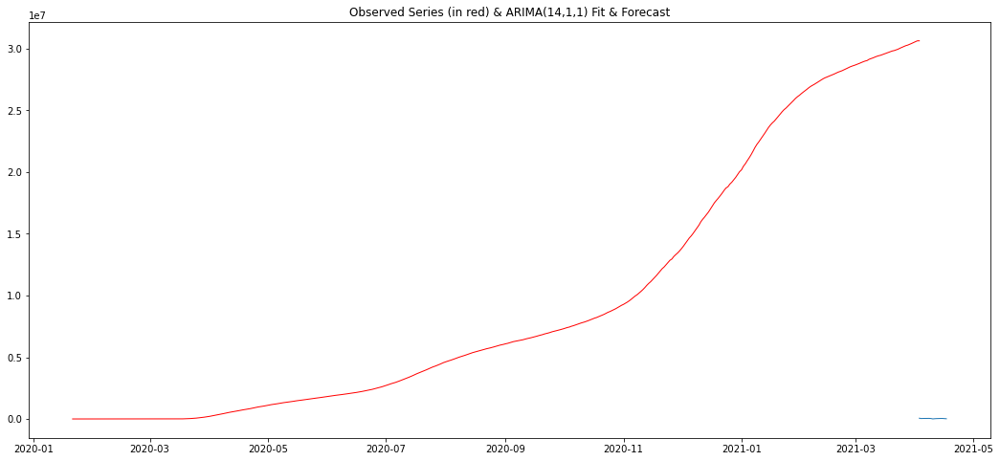

15


In [36]:
#Time Series ARIMA(p,d,q) Forecast

#p = any number of missing at the end, else 1

#delete any missing at the start,
#    leave any missing at the end,
#    interpolate in between,
#    add more missing at the end for forecast

#data file has only 2 columns: time-serial & y

#begin of standard header

import os
import IPython
import sys
import numpy as np
import pandas as pd
import scipy
import statsmodels as sm
import matplotlib.pyplot as pl
%matplotlib inline

#for debugging compatibility issues:
a = ! jupyter-notebook --version
v = ! conda --version
print('\nVersions:', str(v)[str(v).find('conda'):-2] + ' jupyter-notebook', str(a)[2:-2]
      + ' IPython', ".".join(map(str, IPython.version_info[:3])) + ' Python', ".".join(map(str, sys.version_info[:3]))
      + ' numpy', np.__version__ + ' pandas', pd.__version__ + ' scipy', scipy.__version__)
try:
    print(' ' * 9, 'statsmodels', sm.__version__)
except:
    #for Azure server (2019):
    print(' ' * 9, '...with older version of statsmodels')
del a, v
    
#!conda update --y --all #change #! to ! will update any of your older versions

from IPython.core.display import display, HTML
display(HTML("<style>div.output_scroll { height: 31em; }</style>")) #set height of output window below
pl.rcParams['figure.figsize'] = 18, 8 #width & height for time-series plot
#pl.rcParams['figure.figsize'] = 6.000, 6.143 #best for square plot np.arange(1,10) on screens of diff resolutions?
pl.rcParams['lines.linewidth'] = 1
pl.rcParams['lines.markersize'] = 1

import warnings
warnings.simplefilter('ignore')
warnings.filterwarnings('ignore')

if os.name == 'nt':
    #Windows:
    try:
        os.chdir(os.environ['USERPROFILE'] + '\Documents' + r"\0_Teach\data")
    except:
        #assume file is in current folder
        pass
else:
    #Mac:
    try:
        os.chdir('/Users/' + os.environ['USER'] + '/Documents' + r"/0_Teach/data")
    except:
        #assume file is in current folder
        pass

#end of standard header
    
try:
    #file has only 2 columns: time-serial & y:
#     y = pd.read_csv('daily-total-female-births.csv', index_col=0) #has 7 NaN(s) in the tail, for filling in forecasts
    y = pd.read_csv("cleaned_data.csv", index_col=0)
    y["date"] = pd.to_datetime(y["date"])
    y.index = y["date"]
    y = y["US_Covid_Cases"]
#     y = pd.read_csv('UKDeaths_1970-2018.csv', index_col=0) #has 7 NaN(s) in the tail, for filling in forecasts
except:
    print('"'+os.getcwd()+'" is the current folder in the', 'Windows' if os.name == 'nt' else os.name,
          'operating system:\n')
    print('\n'.join(os.listdir()), '\n') #see what's in current folder
    raise SystemExit
    
y.index = pd.to_datetime(y.index) #change index to DatetimeIndex; y is now a time series
r = pd.infer_freq(y.index) #infer frequency from index
start_idx = len(y) - 1
#some of the following 6 lines is not necessary for some datasets:
y = pd.DataFrame(y).iloc[:, :1] #just to make sure y is DataFrame of 1 column, instead of possibly a Series
y.interpolate(limit_area='inside', inplace=True) #interpolate, but not extrapolate for either end
#add in a random few more missing at the end, for further predictions:
a = [np.nan for i in range(0, 14)]
y = y.append(pd.DataFrame(a, index=pd.date_range(y.index[-1], periods=len(a)+1,
                                                 freq=r)[1:], columns=y.columns.values))

# y.iloc[:2, :] = np.nan #artificially create missing at the start

#https://stackoverflow.com/questions/18327624/find-elements-index-in-pandas-series
#y.isnull().ne(True).idxmax()[0] = index of first non-missing
b = list(y.index).index(y.isnull().ne(True).idxmax()[0]) + 1 #position of first non-missing at the start
print(y.head(max(b, 3))) #show all of any missing at the start
print(y.tail(max((len(y) - y.count())[0] - b + 2, 3))) #shows all of any missing at the end
y = y.iloc[b - 1:, :] #delete any missing at the start

from statsmodels.tsa.arima_model import ARIMA

#p=number of missing (NaN); also used as order of autoregression (can be set independently):
p = (len(y) - y.count())[0] if type(len(y) - y.count()) == type(pd.Series([])) else 1 #set to 1 if no missing at end
d = 1 #times to difference y: order of y's integration; max is 2
q = 1 #order of moving average
print('\nFitting (p,d,q) = (' + str(p) + ',' + str(d) + ',' + str(q)
      + ') ...   [p = any number of missing at the end, else 1]\n')

m = ARIMA(y[:-p], (p,d,q), freq=r).fit(transparams=True) #fits
print(m.summary())
print('\nbic =', m.bic) #smaller is better

#predict with start=y.index[d], end=y.index[-1]
# f = m.predict(y.index[d], y.index[-1], typ='levels') #forecasts

end_idx = start_idx + 14
f = m.predict(start=start_idx, end=end_idx)
#ARIMA always gives f a DatetimeIndex, even if y hasn't a DatetimeIndex

print('\nFits &', p, 'Forecasts:\n')
print(f.head(3))
print(f.tail(p + 1))

pl.plot(y, color='red')
pl.title('Observed Series (in red) & ARIMA('+str(p)+','+str(d)+','+str(q)+') Fit & Forecast')
pl.plot(f)
pl.show()

if len(f) > 400:
    pl.plot(y.iloc[-375:, :], color='red')
    pl.title('Observed Series (in red) & ARIMA('+str(p)+','+str(d)+','+str(q)+') Fit & Forecast')
    pl.plot(f[-375:])
    pl.show()
    
print(len(f))

In [37]:
# since we do 1 order of differencing, we must use this code to get the actual changes in COVID cases in the US
start_val = y.iloc[-15]["US_Covid_Cases"]
hval = start_val
qf = list(f)
for i in range(0, 14):
    q = hval + qf[i]
#     print(q)
    y.iloc[-14+i]["US_Covid_Cases"] = q
    hval = q
print(y.tail(15))


            US_Covid_Cases
2021-04-03    3.063170e+07
2021-04-04    3.069202e+07
2021-04-05    3.072468e+07
2021-04-06    3.076461e+07
2021-04-07    3.080658e+07
2021-04-08    3.084867e+07
2021-04-09    3.089461e+07
2021-04-10    3.092914e+07
2021-04-11    3.093428e+07
2021-04-12    3.095523e+07
2021-04-13    3.098493e+07
2021-04-14    3.101864e+07
2021-04-15    3.105783e+07
2021-04-16    3.109693e+07
2021-04-17    3.112494e+07
